# TFM: Clasificación automática de desordenes mentales

In [1]:
cd textflow-master

C:\Users\pablo\OneDrive\Escritorio\Master\TFM\textflow-master


C:\Users\pablo\anaconda3\envs\tmf_env\Lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [2]:
!(python -m pip install .)
import os
textflowPath = './textflow'
os.chdir(textflowPath)

Processing c:\users\pablo\onedrive\escritorio\master\tfm\textflow-master
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
  Created wheel for textflow: filename=textflow-0.1.0-py3-none-any.whl size=181602 sha256=3620985849f9823d07be99f088974292174191e1236eba86e1cd41b9fd93f0da
  Stored in directory: c:\users\pablo\appdata\local\pip\cache\wheels\f1\4b\55\499715b72812e35359e080278e641143ad59d0de141c873109
Successfully built textflow
  Attempting uninstall: textflow
    Found existing installation: textflow 0.1.0
    Uninstalling textflow-0.1.0:
      Successfully uninstalled textflow-0.1.0


In [1]:
import json
import re
import os
import nltk
import pandas as pd
import numpy as np
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import random
import statistics
import evaluate
import torch
from time import time
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer, WordPunctTokenizer
from nltk.stem import WordNetLemmatizer
from sklearn.impute import KNNImputer
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder, LabelEncoder
from sklearn.feature_selection import chi2, SelectKBest, RFE
from sklearn.ensemble import ExtraTreesClassifier, RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.model_selection import KFold, cross_val_score, train_test_split, StratifiedKFold, GridSearchCV
from sklearn.compose import make_column_transformer
from scipy.stats import shapiro, normaltest, kstest, mannwhitneyu, wilcoxon, kruskal
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, ConfusionMatrixDisplay, f1_score, recall_score, precision_score
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
from wordcloud import WordCloud
from nltk.tokenize import TreebankWordTokenizer
from torch import nn
from datasets import DatasetDict, Dataset
from transformers import AutoModelForSequenceClassification, AutoTokenizer, TrainingArguments, Trainer, DataCollatorWithPadding, EarlyStoppingCallback, Trainer, RobertaForSequenceClassification, RobertaTokenizer
from pysentimiento.preprocessing import preprocess_tweet
from nltk.tokenize import word_tokenize
from FuncionesMineria import *

sns.set_style("darkgrid")
warnings.filterwarnings('ignore')
nltk.download("wordnet")
nltk.download("omw-1.4")
nltk.download('punkt')
nltk.download('stopwords')

C:\Users\pablo\anaconda3\envs\tmf_env\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [4]:
from textflow.ComplexityAnalyzer import ComplexityAnalyzer
from textflow.IronyAnalyzer import IronyAnalyzer
from textflow.PerplexityAnalyzer import PerplexityAnalyzer
from textflow.PolarityAnalyzer import PolarityAnalyzer
from textflow.StylometryAnalyzer import StylometryAnalyzer
from textflow.VolumetryAnalyzer import VolumetryAnalyzer
from textflow.EmotionAnalyzer import EmotionAnalyzer
from textflow.SequenceString import SequenceString
from textflow.POSAnalyzer import POSAnalyzer

✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


In [5]:
cd C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM

C:\Users\pablo\OneDrive\Escritorio\Master\TFM


In [6]:
pwd

'C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM'

## Pre_procesado y generación de columnas numéricas

### Generación del dataset a partir del JSON

In [35]:
# Gathering each disorder file list and tags

# Anxiety
file_list_anx = os.listdir('.\\corpus\\raw\\Anxiety\\data')
anx_gold = pd.read_csv('.\\corpus\\raw\\Anxiety\\gold\\gold_label.csv', sep='\t')
anx_gold = anx_gold[['nick', 'bs']]
dict_anx = anx_gold.set_index('nick')['bs'].to_dict()

# Depression
file_list_depression = os.listdir('.\\corpus\\raw\\Depress\\data')
depression_gold = pd.read_csv('.\\corpus\\raw\\Depress\\gold\\gold_label.csv', sep='\t')
depression_gold = depression_gold[['nick', 'bs']]
dict_dep = depression_gold.set_index('nick')['bs'].to_dict()

# TCA
file_list_tca = os.listdir('.\\corpus\\raw\\ED\\data')
tca_gold = pd.read_csv('.\\corpus\\raw\\ED\\gold\\gold_label.csv', sep='\t')
tca_gold = tca_gold[['nick', 'bs']]
dict_tca = tca_gold.set_index('nick')['bs'].to_dict()

In [36]:
# Generation of DataFrames for each disorder
def get_data(path, st_save, folder):
    for file in folder:
        subject = file.split('.')[0]
        f_path = os.path.join(path, file)
        with open(f_path, 'r', encoding='utf-8') as file_json:
            data = json.load(file_json)
            for i in data:
                st_save.append({'subject':subject, 'id_message': i['id_message'], 'message': i['message'], 'date': i['date']})
    df = pd.DataFrame(st_save)
    return df

messages_anx = []
messages_tca = []
messages_dep = []

df_anx = get_data('.\\corpus\\raw\\Anxiety\\data', messages_anx, file_list_anx)
df_dep = get_data('.\\corpus\\raw\\Depress\\data', messages_dep, file_list_depression)
df_tca = get_data('.\\corpus\\raw\\ED\\data', messages_tca, file_list_tca)

In [37]:
def create_labels(label_dict, entry):
    label = label_dict[entry]
    return label
df_anx['label'] = df_anx['subject'].apply(lambda x: create_labels(dict_anx, x))
df_dep['label'] = df_dep['subject'].apply(lambda x: create_labels(dict_dep, x))
df_tca['label'] = df_tca['subject'].apply(lambda x: create_labels(dict_tca, x))

In [38]:
# Subject 104 from TCA is removed, it is a bot, not useful
df_tca.drop(df_tca[df_tca['subject'] == 'subject104'].index, inplace=True)

In [39]:
df_anx['disorder'] = 'Anxiety'
df_dep['disorder'] = 'Depression'
df_tca['disorder'] = 'Eating_disorder'

In [40]:
labels_dep = {0:0, 1:2}
labels_ed = {0:0, 1:3}
df_dep['label'] = df_dep['label'].map(labels_dep)
df_tca['label'] = df_tca['label'].map(labels_ed)

In [41]:
df_anx = df_anx[['subject', 'message', 'label', 'disorder']]
df_dep = df_dep[['subject', 'message', 'label', 'disorder']]
df_tca = df_tca[['subject', 'message', 'label', 'disorder']]

In [42]:
# Adding subset identificator to subject ID
def add_sufix(suf, elm):
    return f"{elm}{suf}"

df_anx['subject'] = df_anx['subject'].apply(lambda x: add_sufix('_anx', x))
df_dep['subject'] = df_dep['subject'].apply(lambda x: add_sufix('_dep', x))
df_tca['subject'] = df_tca['subject'].apply(lambda x: add_sufix('_ed', x))

In [43]:
merged_ng = pd.concat([df_anx, df_dep, df_tca], ignore_index = True)

In [ ]:
# A copy without message joining is stored for LLM experiments
merged_ng.to_csv('dataset_no_joined.csv', encoding = 'utf-8')

In [10]:
# Messages are grouped by user and joined with blank spaces
df_anx['message'] = df_anx.groupby(['subject'])['message'].transform(lambda x: (' '.join(x)).lower())
df_anx = df_anx.drop_duplicates(ignore_index = True)

df_dep['message'] = df_dep.groupby(['subject'])['message'].transform(lambda x: (' '.join(x)).lower())
df_dep = df_dep.drop_duplicates(ignore_index = True)

df_tca['message'] = df_tca.groupby(['subject'])['message'].transform(lambda x: (' '.join(x)).lower())
df_tca = df_tca.drop_duplicates(ignore_index = True)

In [11]:
df_anx

,subject,message,label,disorder
0,subject1_anx,buenos días a tod @s ! ! no sé si esta será la...,1,Anxiety
1,subject10_anx,ola soi nuebo como estn ? a ustds los entimdm ...,0,Anxiety
2,subject100_anx,de donde son .. yo de perú supongo q tb sigue ...,1,Anxiety
3,subject101_anx,es lo que necesitas ? aaah pues perdón por no ...,1,Anxiety
4,subject102_anx,ya perdí una xd siete seguidas no está mal . e...,1,Anxiety
...,...,...,...,...
495,subject95_anx,hola un saludo a todos mi nombre es oliver me ...,1,Anxiety
496,subject96_anx,gracias la verdad que no estoy pasando buen mo...,1,Anxiety
497,subject97_anx,más aburrida que una ostra sugaramente un buen...,0,Anxiety
498,subject98_anx,hola ! ! llevo un par de días leyendo algunos ...,1,Anxiety


In [12]:
df_anx['label'].value_counts()

label
1    443
0     57
Name: count, dtype: int64

In [13]:
df_dep

,subject,message,label,disorder
0,subject1_dep,bien ... técnicamente debería irme a dormir 😅 ...,0,Depression
1,subject10_dep,umm pues como te explico ... mal : ´ ( pues ja...,2,Depression
2,subject100_dep,"hola , estoy realmente mal , no se que hacer c...",2,Depression
3,subject101_dep,volvi me extrañaron ❓ y tu pareja ❓ todo el cr...,2,Depression
4,subject102_dep,"¿ cuanto tiempo duraron así ? sí , pero ya nos...",2,Depression
...,...,...,...,...
494,subject95_dep,"buenas gente ! soy de barcelona , alguien de p...",2,Depression
495,subject96_dep,como habéis pasado la noche me tengo q aceptar...,2,Depression
496,subject97_dep,"hola , no se casi del tema pero la verdad que ...",2,Depression
497,subject98_dep,yo no tengo ni ganas de vivir pues voy como vo...,2,Depression


In [14]:
df_dep['label'].value_counts()

label
2    333
0    166
Name: count, dtype: int64

In [15]:
df_tca

,subject,message,label,disorder
0,subject1_ed,hace cuanto lo crearon ? aa es re nuevito soy ...,3,Eating_disorder
1,subject10_ed,"woww , muy bien lo que decis gracias por la in...",3,Eating_disorder
2,subject100_ed,me llamo artemisa y me han diagnosticado bn te...,3,Eating_disorder
3,subject101_ed,jajaja bien y vos ? ? toca en donde dice ana y...,3,Eating_disorder
4,subject102_ed,"hoola , me presento me llamo cayetana , soy en...",3,Eating_disorder
...,...,...,...,...
329,subject95_ed,cuantoa kilos sr puede bajar vomitando ? ya vo...,3,Eating_disorder
330,subject96_ed,"holis grupo , porfis necesito perder 15 kilos ...",3,Eating_disorder
331,subject97_ed,quiero volver a bajar me pasan licuados detox ...,3,Eating_disorder
332,subject98_ed,hola . vengo de una dieta cetogenica xon la qu...,3,Eating_disorder


In [16]:
df_tca['label'].value_counts()

label
0    191
3    143
Name: count, dtype: int64

In [203]:
merged = pd.concat([df_anx, df_dep, df_tca], ignore_index = True)

In [205]:
merged

,subject,message,label,disorder
0,subject1_anx,buenos días a tod @s ! ! no sé si esta será la...,1,Anxiety
1,subject10_anx,ola soi nuebo como estn ? a ustds los entimdm ...,0,Anxiety
2,subject100_anx,de donde son .. yo de perú supongo q tb sigue ...,1,Anxiety
3,subject101_anx,es lo que necesitas ? aaah pues perdón por no ...,1,Anxiety
4,subject102_anx,ya perdí una xd siete seguidas no está mal . e...,1,Anxiety
...,...,...,...,...
1328,subject95_ed,cuantoa kilos sr puede bajar vomitando ? ya vo...,3,Eating_disorder
1329,subject96_ed,"holis grupo , porfis necesito perder 15 kilos ...",3,Eating_disorder
1330,subject97_ed,quiero volver a bajar me pasan licuados detox ...,3,Eating_disorder
1331,subject98_ed,hola . vengo de una dieta cetogenica xon la qu...,3,Eating_disorder


In [206]:
merged.to_csv('dataset.csv', encoding = 'utf-8')
merged.to_pickle('dataset_pkl.pickle')

### Limpieza del texto

In [7]:
df = pd.read_csv('dataset.csv', index_col = 0)
df

,subject,message,label,disorder
0,subject1_anx,buenos días a tod @s ! ! no sé si esta será la...,1,Anxiety
1,subject10_anx,ola soi nuebo como estn ? a ustds los entimdm ...,0,Anxiety
2,subject100_anx,de donde son .. yo de perú supongo q tb sigue ...,1,Anxiety
3,subject101_anx,es lo que necesitas ? aaah pues perdón por no ...,1,Anxiety
4,subject102_anx,ya perdí una xd siete seguidas no está mal . e...,1,Anxiety
...,...,...,...,...
1328,subject95_ed,cuantoa kilos sr puede bajar vomitando ? ya vo...,3,Eating_disorder
1329,subject96_ed,"holis grupo , porfis necesito perder 15 kilos ...",3,Eating_disorder
1330,subject97_ed,quiero volver a bajar me pasan licuados detox ...,3,Eating_disorder
1331,subject98_ed,hola . vengo de una dieta cetogenica xon la qu...,3,Eating_disorder


In [3]:
def remove_emoji(text):
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F"  # emoticons
                               u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                               u"\U0001F680-\U0001F6FF"  # transport & map symbols
                               u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                               u"\U00002500-\U00002BEF"  # chinese char
                               u"\U00002702-\U000027B0"
                               u"\U00002702-\U000027B0"
                               u"\U000024C2-\U0001F251"
                               u"\U0001f926-\U0001f937"
                               u"\U00010000-\U0010ffff"
                               u"\u2640-\u2642"
                               u"\u2600-\u2B55"
                               u"\u200d"
                               u"\u23cf"
                               u"\u23e9"
                               u"\u231a"
                               u"\ufe0f"  # dingbats
                               u"\u3030"
                               "]+", flags=re.UNICODE)
    text = emoji_pattern.sub(r'', text)
    text = re.sub(r'[^A-Za-z0-9\s.,¡!¿?;:()\'"áéíóúÁÉÍÓÚñÑ-]', '', text)
    text = re.sub(r'\s+', ' ', text)
    return text

In [26]:
df['message'].replace(np.nan, '', inplace=True)
df['message'] = [re.sub(r'^https?:\/\/.*[\r\n]*', '', text, flags=re.MULTILINE) for text in df['message']]
df['message'] = df['message'].apply(lambda x: remove_emoji(x))

#### Generación de columnas numéricas

In [8]:
# Analyzers declaring

complexity = ComplexityAnalyzer()
emotion = EmotionAnalyzer()
ironity = IronyAnalyzer()
perplexity = PerplexityAnalyzer(device="cuda")
polarity = PolarityAnalyzer()
stylometry = StylometryAnalyzer(stopwords.words('spanish'),tokenizer = WordPunctTokenizer())
volumetry = VolumetryAnalyzer()
pos = POSAnalyzer()

listSequence = []
for index, col in df.iterrows():
  s = SequenceString(col["message"])
  listSequence.append(s)

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
Hardware accelerator e.g. GPU is available in the environment, but no `device` argument is passed to the `Pipeline` object. Model will be on CPU.
Hardware accelerator e.g. GPU is available in the environment, but no `device` argument is passed to the `Pipeline` object. Model will be on CPU.
Hardware accelerator e.g. GPU is available in the environment, but no `device` argument is passed to the `Pipeline` object. Model will be on CPU.


In [9]:
# Application of analyzers over text

for s in listSequence:
  complexity.analyze(s,"complexity","text")
  emotion.analyze(s,"emotion","text")
  ironity.analyze(s,"irony","text")
  perplexity.analyze(s,"perplexity","text")
  polarity.analyze(s,"polarity","text")
  stylometry.analyze(s,"stylometry","text")
  volumetry.analyze(s,"volumetry","text")
  pos.analyze(s, "POS", "text")

  0%|          | 0/1 [00:00<?, ?it/s]


In [11]:
POStags = set()
for seq in listSequence:
  for tag in seq.metadata['POS'][0]['FreqPOS']:
    POStags.add(tag)

In [12]:
# Definition of a list with all the analyzer labels.
labels = ["complexity","emotion","irony","perplexity","polarity","stylometry","volumetry", 'POS']

dicTotal = {}
for seq in listSequence:
  for l in seq.metadata:
    if l in labels:
      if l in ["polarity", "emotion", "irony"]:
        for category in seq.metadata[l][0][0]:
          l_key = str(l+category['label'])
          dicTotal[l_key] = dicTotal.get(l_key, []) + [category['score']]
      elif l == 'POS':
        for cat in ['FreqPOS', 'RelFreqPOS']:
          for tag in POStags:
            dicTotal[cat+''+tag] = dicTotal.get(cat+''+tag, []) + [seq.metadata[l][0][cat].get(tag, 0)]
        l_key = str(l)+'POSTokens'
        dicTotal[l_key] = dicTotal.get(l_key, []) + [seq.metadata[l][0]['POSTokens']]
      elif l == 'perplexity':
        dicTotal[l] = dicTotal.get(l, []) + [seq.metadata[l][0]]
      else:
        for key in seq.metadata[l][0]:
          l_key = str(l+key)
          dicTotal[l_key] = dicTotal.get(l_key, []) + [seq.metadata[l][0][key]]

# Once we have a dictionary with all the information of the sequences, the DataFrame can be created.
for k in dicTotal:
  df[str(k)] = dicTotal[k]

# We show the columns of the DataFrame.
print(df.columns.to_list())

['subject', 'message', 'label', 'disorder', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironyNI', 'ironyI', 'perplexity', 'polarityNEG', 'polarityNEU', 'polarityPOS', 'stylometryuniqueWords', 'stylometryTTR', 'stylometryRTTR', 'stylometryHerdan', 'stylometryMass', 'stylometrySomers', 'stylometryDugast', 'stylometryHonore', 'stylometryFreqStopWords', 'stylometryFreqPuntuationMarks', 'stylometryFreqWords', 'volumetrywords

In [16]:
df.drop(['stylometryFreqStopWords',	'stylometryFreqPuntuationMarks', 'stylometryFreqWords'], axis = 1, inplace = True)
cols_to_drop = df.filter(regex='^(FreqPOS|RelFreqPOS|POSPOS)').columns
df.drop(columns=cols_to_drop, inplace=True)

In [17]:
df.columns

Index(['subject', 'message', 'label', 'disorder', 'complexitynSentences',
       'complexitynComplexSentence', 'complexityavglenSentence',
       'complexitynPuntuationMarks', 'complexitynWords',
       'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar',
       'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR',
       'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ',
       'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL',
       'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth',
       'complexitymean_depth', 'emotionothers', 'emotionjoy', 'emotionsadness',
       'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear',
       'ironyNI', 'ironyI', 'perplexity', 'polarityNEG', 'polarityNEU',
       'polarityPOS', 'stylometryuniqueWords', 'stylometryTTR',
       'stylometryRTTR', 'stylometryHerdan', 'stylometryMass',
       'stylometrySomers', 'stylometryDugast', 'stylometryHonore',
 

In [21]:
df.drop('disorder', inplace=True, axis = 1)

In [22]:
df

,subject,message,label,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,...,stylometryRTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen
0,subject1_anx,buenos días a tod @s ! ! no sé si esta será la...,1,53,12,25.603774,140,1357,303,2432,...,10.759723,0.824806,0.081067,0.833361,18.132287,1249.689964,1496,524,7430,5
1,subject10_anx,ola soi nuebo como estn ? a ustds los entimdm ...,0,15,0,5.266667,18,79,31,105,...,5.178265,0.859470,0.095755,0.779407,14.137679,1447.505121,97,67,406,4
2,subject100_anx,de donde son .. yo de perú supongo q tb sigue ...,1,17,3,22.647059,51,385,84,661,...,7.645096,0.834428,0.090025,0.813650,15.953629,2113.179288,436,226,2137,5
3,subject101_anx,es lo que necesitas ? aaah pues perdón por no ...,1,15,5,82.333333,66,1235,271,2106,...,11.838297,0.844635,0.069929,0.851364,20.044920,1356.935108,1301,519,6356,5
4,subject102_anx,ya perdí una xd siete seguidas no está mal . e...,1,113,5,10.584071,156,1196,290,2281,...,12.483154,0.850154,0.066217,0.857766,20.894644,1690.727413,1352,549,6885,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,subject95_ed,cuantoa kilos sr puede bajar vomitando ? ya vo...,3,3,2,80.000000,5,240,76,419,...,6.426476,0.837683,0.096676,0.796984,14.740882,779.556104,245,137,1225,5
1329,subject96_ed,"holis grupo , porfis necesito perder 15 kilos ...",3,5,4,73.200000,39,366,92,661,...,7.614810,0.837578,0.088648,0.815375,16.079814,1182.957028,405,205,1978,5
1330,subject97_ed,quiero volver a bajar me pasan licuados detox ...,3,3,2,29.000000,4,87,27,169,...,5.136596,0.862767,0.094108,0.780490,14.275284,1919.860564,91,71,493,5
1331,subject98_ed,hola . vengo de una dieta cetogenica xon la qu...,3,18,3,21.944444,33,395,109,693,...,8.942313,0.861570,0.070869,0.846001,19.009135,2212.804988,428,237,2086,5


In [23]:
df.to_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_tf_notrastcol.csv')

## Exploración de datos

### Preliminar

In [3]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_tf_notrastcol.csv', index_col = 0)

In [4]:
df

,subject,message,label,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,...,stylometryRTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen
0,subject1_anx,buenos días a tod @s ! ! no sé si esta será la...,1,53,12,25.603774,140,1357,303,2432,...,10.759723,0.824806,0.081067,0.833361,18.132287,1249.689964,1496,524,7430,5
1,subject10_anx,ola soi nuebo como estn ? a ustds los entimdm ...,0,15,0,5.266667,18,79,31,105,...,5.178265,0.859470,0.095755,0.779407,14.137679,1447.505121,97,67,406,4
2,subject100_anx,de donde son .. yo de perú supongo q tb sigue ...,1,17,3,22.647059,51,385,84,661,...,7.645096,0.834428,0.090025,0.813650,15.953629,2113.179288,436,226,2137,5
3,subject101_anx,es lo que necesitas ? aaah pues perdón por no ...,1,15,5,82.333333,66,1235,271,2106,...,11.838297,0.844635,0.069929,0.851364,20.044920,1356.935108,1301,519,6356,5
4,subject102_anx,ya perdí una xd siete seguidas no está mal . e...,1,113,5,10.584071,156,1196,290,2281,...,12.483154,0.850154,0.066217,0.857766,20.894644,1690.727413,1352,549,6885,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,subject95_ed,cuantoa kilos sr puede bajar vomitando ? ya vo...,3,3,2,80.000000,5,240,76,419,...,6.426476,0.837683,0.096676,0.796984,14.740882,779.556104,245,137,1225,5
1329,subject96_ed,"holis grupo , porfis necesito perder 15 kilos ...",3,5,4,73.200000,39,366,92,661,...,7.614810,0.837578,0.088648,0.815375,16.079814,1182.957028,405,205,1978,5
1330,subject97_ed,quiero volver a bajar me pasan licuados detox ...,3,3,2,29.000000,4,87,27,169,...,5.136596,0.862767,0.094108,0.780490,14.275284,1919.860564,91,71,493,5
1331,subject98_ed,hola . vengo de una dieta cetogenica xon la qu...,3,18,3,21.944444,33,395,109,693,...,8.942313,0.861570,0.070869,0.846001,19.009135,2212.804988,428,237,2086,5


In [17]:
df_visualization = df.drop(['subject', 'message'], axis = 1)

In [18]:
df_visualization

,label,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,complexitynChar,complexityILFW,...,stylometryRTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen
0,1,53,12,25.603774,140,1357,303,2432,5,0.364919,...,10.759723,0.824806,0.081067,0.833361,18.132287,1249.689964,1496,524,7430,5
1,0,15,0,5.266667,18,79,31,105,7,0.909091,...,5.178265,0.859470,0.095755,0.779407,14.137679,1447.505121,97,67,406,4
2,1,17,3,22.647059,51,385,84,661,8,0.364865,...,7.645096,0.834428,0.090025,0.813650,15.953629,2113.179288,436,226,2137,5
3,1,15,5,82.333333,66,1235,271,2106,5,0.365385,...,11.838297,0.844635,0.069929,0.851364,20.044920,1356.935108,1301,519,6356,5
4,1,113,5,10.584071,156,1196,290,2281,8,0.350495,...,12.483154,0.850154,0.066217,0.857766,20.894644,1690.727413,1352,549,6885,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,3,3,2,80.000000,5,240,76,419,6,0.469565,...,6.426476,0.837683,0.096676,0.796984,14.740882,779.556104,245,137,1225,5
1329,3,5,4,73.200000,39,366,92,661,6,0.322785,...,7.614810,0.837578,0.088648,0.815375,16.079814,1182.957028,405,205,1978,5
1330,3,3,2,29.000000,4,87,27,169,7,0.428571,...,5.136596,0.862767,0.094108,0.780490,14.275284,1919.860564,91,71,493,5
1331,3,18,3,21.944444,33,395,109,693,7,0.493590,...,8.942313,0.861570,0.070869,0.846001,19.009135,2212.804988,428,237,2086,5


In [19]:
df_visualization.shape

(1333, 50)

In [20]:
df_visualization.dtypes

label                           int64
complexitynSentences            int64
complexitynComplexSentence      int64
complexityavglenSentence      float64
complexitynPuntuationMarks      int64
complexitynWords                int64
complexitynRareWords            int64
complexitynSyllabes             int64
complexitynChar                 int64
complexityILFW                float64
complexityLDI                 float64
complexityLC                  float64
complexitySSR                 float64
complexitySCI                 float64
complexityARI                 float64
complexityhuerta              float64
complexityIFSZ                float64
complexitypolini              float64
complexitymu                  float64
complexityminage              float64
complexitySOL                 float64
complexitycrawford            float64
complexitymin_depth             int64
complexitymax_depth             int64
complexitymean_depth          float64
emotionothers                 float64
emotionjoy  

In [21]:
df_visualization.describe()

,label,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,complexitynChar,complexityILFW,...,stylometryRTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen
count,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,...,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000
mean,1.153788,13.750938,3.002251,70.583907,38.644411,475.990248,112.324081,840.501125,5.170293,0.389493,...,7.560781,0.832314,0.095867,0.800888,15.634514,1728.465772,513.617404,235.368342,2530.903976,4.982746
std,0.983144,19.952220,2.946341,82.590514,50.268823,430.440872,109.944362,762.055979,2.836160,0.090324,...,2.161991,0.017213,0.021241,0.041256,2.664526,863.736491,471.691890,149.274849,2334.256225,0.187049
min,0.000000,1.000000,0.000000,4.588235,0.000000,55.000000,9.000000,40.000000,1.000000,0.149123,...,2.988072,0.757651,0.043282,0.546909,7.613386,195.424251,64.000000,45.000000,268.000000,4.000000
25%,0.000000,4.000000,1.000000,24.600000,10.000000,215.000000,50.000000,375.000000,3.000000,0.330275,...,5.947367,0.821863,0.081150,0.779488,13.730079,1279.218669,228.000000,135.000000,1134.000000,5.000000
50%,1.000000,8.000000,2.000000,43.450000,24.000000,356.000000,83.000000,632.000000,5.000000,0.380282,...,7.289035,0.832908,0.091965,0.808235,15.608844,1513.815576,383.000000,199.000000,1891.000000,5.000000
75%,2.000000,16.000000,4.000000,80.333333,50.000000,590.000000,140.000000,1035.000000,7.000000,0.441270,...,8.869503,0.843522,0.106924,0.829650,17.457221,1891.434977,637.000000,293.000000,3129.000000,5.000000
max,3.000000,247.000000,40.000000,1167.500000,658.000000,6399.000000,1987.000000,10560.000000,15.000000,0.920354,...,22.479254,0.919708,0.228815,0.893421,27.314221,11468.798861,7038.000000,2041.000000,34853.000000,6.000000


In [22]:
df.isna().sum()

subject                       0
message                       0
label                         0
complexitynSentences          0
complexitynComplexSentence    0
complexityavglenSentence      0
complexitynPuntuationMarks    0
complexitynWords              0
complexitynRareWords          0
complexitynSyllabes           0
complexitynChar               0
complexityILFW                0
complexityLDI                 0
complexityLC                  0
complexitySSR                 0
complexitySCI                 0
complexityARI                 0
complexityhuerta              0
complexityIFSZ                0
complexitypolini              0
complexitymu                  0
complexityminage              0
complexitySOL                 0
complexitycrawford            0
complexitymin_depth           0
complexitymax_depth           0
complexitymean_depth          0
emotionothers                 0
emotionjoy                    0
emotionsadness                0
emotionanger                  0
emotions

In [23]:
cuentaDistintos(df_visualization)

,Columna,Distintos
0,label,4
1,complexitynSentences,82
2,complexitynComplexSentence,21
3,complexityavglenSentence,1105
4,complexitynPuntuationMarks,163
5,complexitynWords,701
6,complexitynRareWords,297
7,complexitynSyllabes,902
8,complexitynChar,15
9,complexityILFW,1056


In [12]:
df_visualization.corr(numeric_only=True)

,label,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,complexitynChar,complexityILFW,...,stylometryRTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen
label,1.000000,-0.064028,0.022688,0.085092,-0.046182,-0.029501,-0.042558,-0.030477,0.034488,-0.176810,...,-0.053161,-0.055368,0.035741,-0.027480,-0.062068,-0.084543,-0.030839,-0.038850,-0.032225,0.006275
complexitynSentences,-0.064028,1.000000,0.727542,-0.300374,0.879751,0.732302,0.741435,0.732160,-0.009996,0.025608,...,0.590321,0.033122,-0.316626,0.342646,0.428746,-0.142930,0.758978,0.721886,0.750208,0.005888
complexitynComplexSentence,0.022688,0.727542,1.000000,-0.200843,0.776126,0.802811,0.781900,0.803010,0.009837,-0.035559,...,0.715873,0.096708,-0.442990,0.475646,0.559695,-0.224329,0.812930,0.805482,0.808343,0.038214
complexityavglenSentence,0.085092,-0.300374,-0.200843,1.000000,-0.211589,0.043364,0.017678,0.040748,0.074438,-0.102170,...,0.044181,0.025114,-0.064438,0.073723,0.052177,-0.085114,0.017238,0.022144,0.025888,0.021659
complexitynPuntuationMarks,-0.046182,0.879751,0.776126,-0.211589,1.000000,0.840232,0.845025,0.841088,0.009035,0.006798,...,0.702321,0.045527,-0.392021,0.424841,0.519940,-0.186007,0.869552,0.837604,0.860822,0.016354
complexitynWords,-0.029501,0.732302,0.802811,0.043364,0.840232,1.000000,0.972555,0.996288,0.012973,-0.021892,...,0.865666,0.124931,-0.526914,0.564033,0.675430,-0.257081,0.998347,0.980826,0.997477,0.056738
complexitynRareWords,-0.042558,0.741435,0.781900,0.017678,0.845025,0.972555,1.000000,0.966488,0.006535,0.086652,...,0.847329,0.186445,-0.527522,0.554354,0.675669,-0.225546,0.972830,0.957758,0.974845,0.052403
complexitynSyllabes,-0.030477,0.732160,0.803010,0.040748,0.841088,0.996288,0.966488,1.000000,0.028576,-0.041551,...,0.869628,0.132141,-0.532774,0.569238,0.680503,-0.250444,0.995255,0.980626,0.998223,0.085732
complexitynChar,0.034488,-0.009996,0.009837,0.074438,0.009035,0.012973,0.006535,0.028576,1.000000,-0.103935,...,0.012654,0.026445,-0.029287,0.025834,0.016465,0.056618,0.013542,0.012916,0.021868,0.110266
complexityILFW,-0.176810,0.025608,-0.035559,-0.102170,0.006798,-0.021892,0.086652,-0.041551,-0.103935,1.000000,...,0.070905,0.318978,-0.142784,0.098865,0.170030,0.031123,-0.020944,-0.002693,-0.026376,-0.207154


In [14]:
df_visualization.groupby('label').size()

label
0    414
1    443
2    333
3    143
dtype: int64

### Visualización

In [ ]:
df_visualization['label'] = df_visualization['label'].replace({0: 'Sane', 1: 'Anxiety', 2: 'Depression', 3: 'ED'})

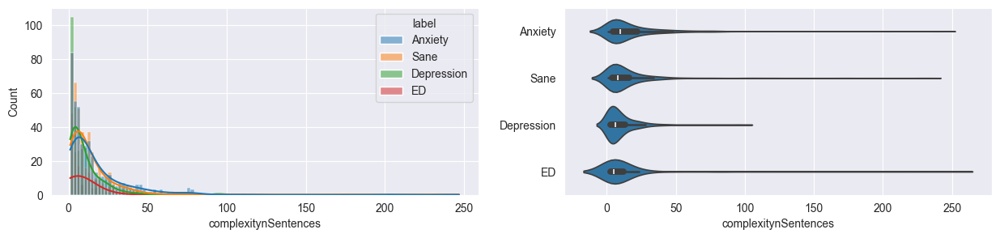

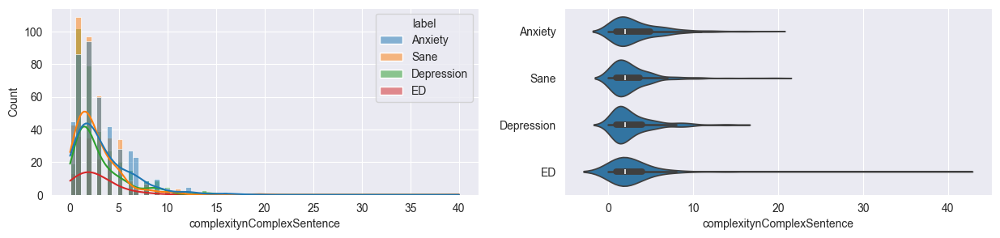

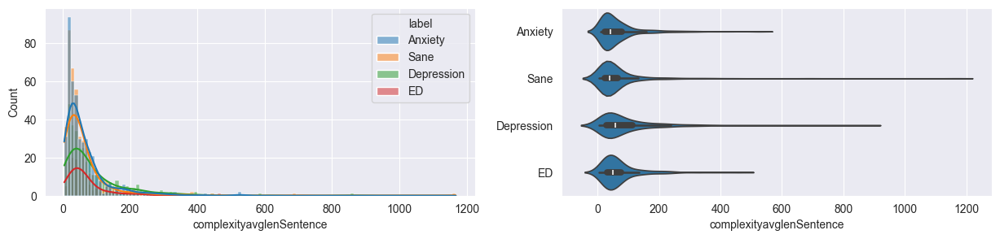

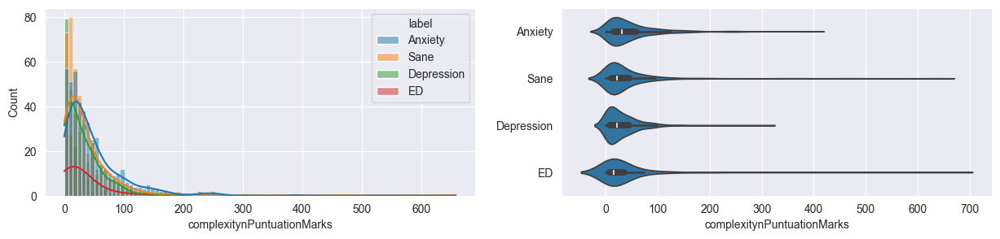

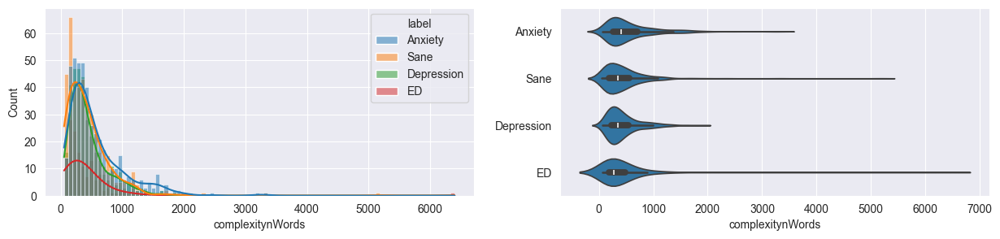

...

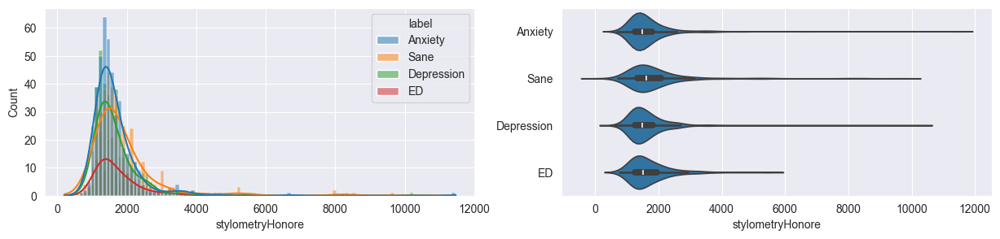

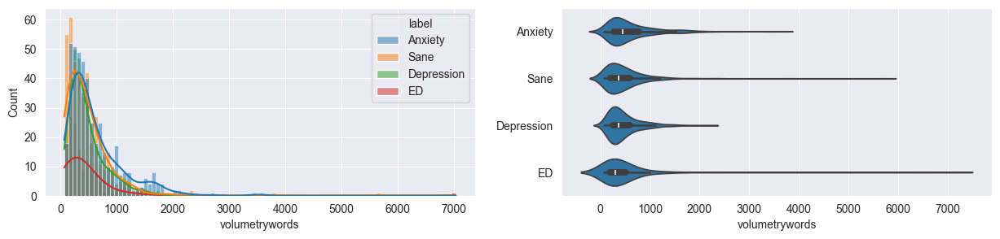

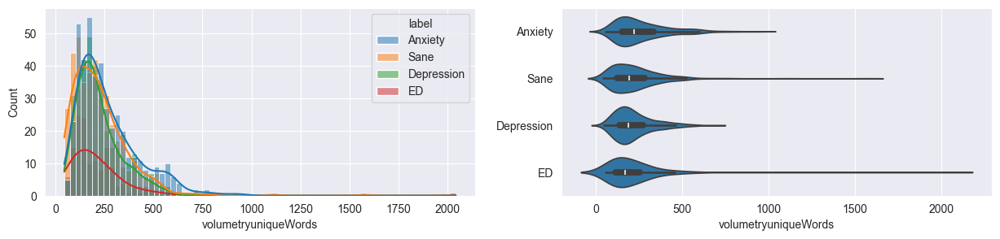

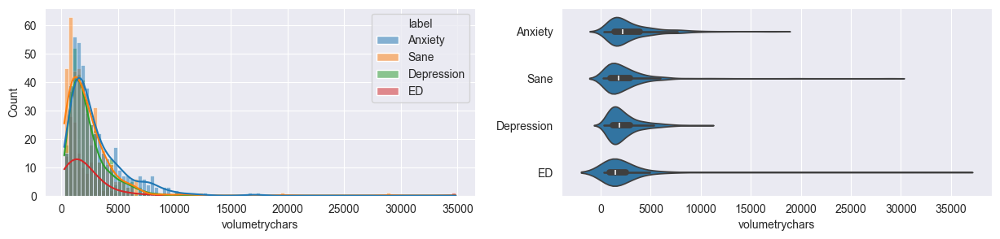

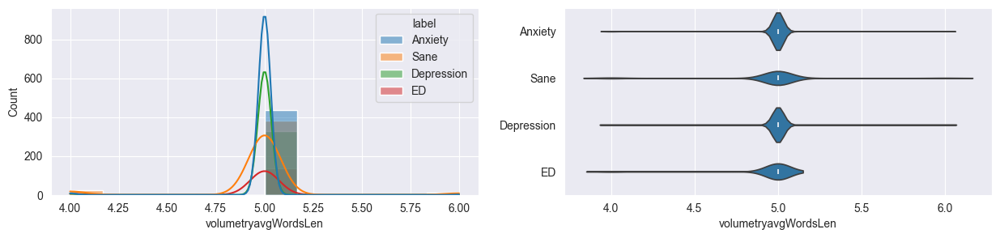

In [24]:
features = ['complexitynSentences', 'complexitynComplexSentence',
       'complexityavglenSentence', 'complexitynPuntuationMarks',
       'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes',
       'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC',
       'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta',
       'complexityIFSZ', 'complexitypolini', 'complexitymu',
       'complexityminage', 'complexitySOL', 'complexitycrawford',
       'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth',
       'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger',
       'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironyNI', 'ironyI',
       'perplexity', 'polarityNEG', 'polarityNEU', 'polarityPOS',
       'stylometryuniqueWords', 'stylometryTTR', 'stylometryRTTR',
       'stylometryHerdan', 'stylometryMass', 'stylometrySomers',
       'stylometryDugast', 'stylometryHonore', 'volumetrywords',
       'volumetryuniqueWords', 'volumetrychars', 'volumetryavgWordsLen']
for i in features:
  plt.figure(figsize=(15, 3))
  plt.subplot(1,2,1)
  sns.histplot(data=df_visualization, x=i, hue='label', kde=True)
  plt.subplot(1,2,2)
  sns.violinplot(data=df_visualization, x=i, y='label')
  plt.ylabel('', fontsize=15)
  plt.show()

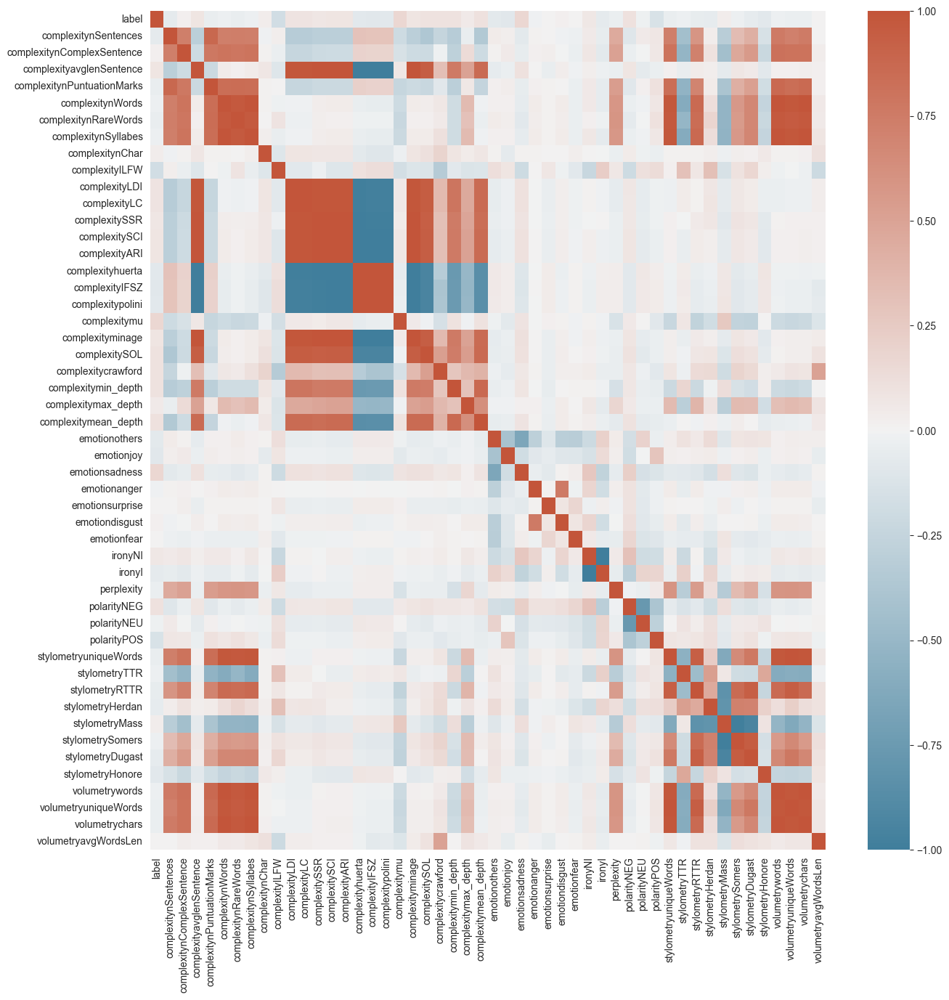

In [28]:
plt.figure(figsize=(15,15))
cmap = sns.diverging_palette(230,20, as_cmap=True)
sns.heatmap(df.corr(numeric_only=True), cmap=cmap, center=0)
plt.show()

Observamos correlación entre las métricas de complejidad y entre éstas y las de estilometría, realizamos diagramas de dispersión entre todas las features.

<Figure size 1000x300 with 0 Axes>

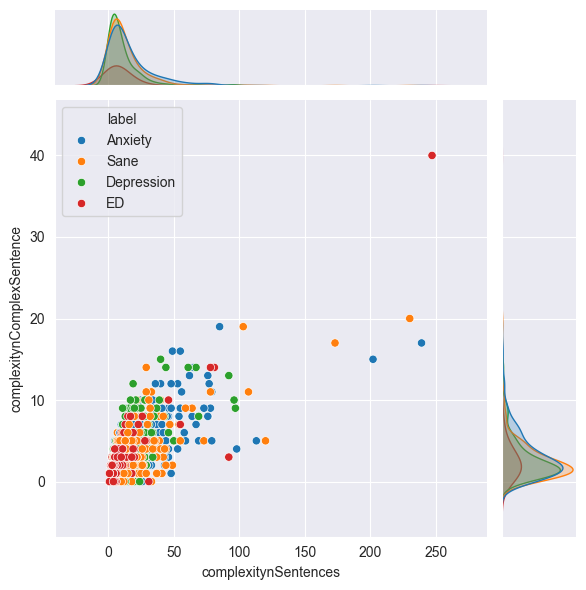

<Figure size 1000x300 with 0 Axes>

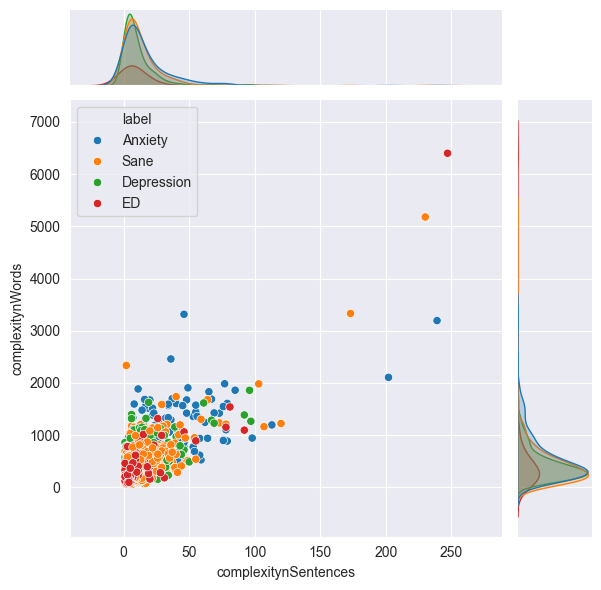

<Figure size 1000x300 with 0 Axes>

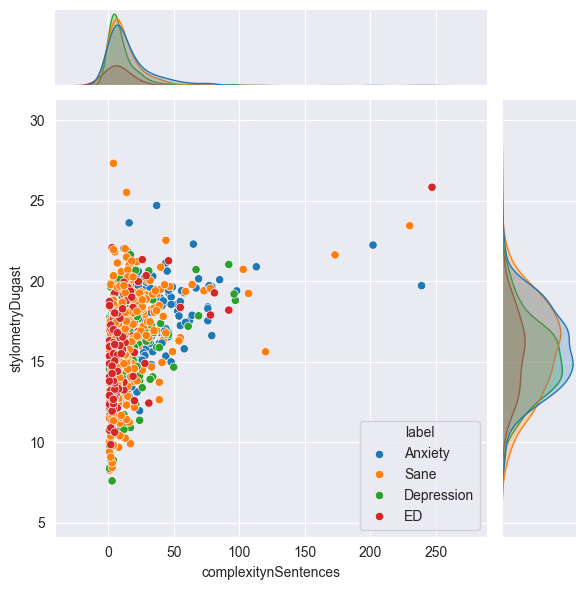

<Figure size 1000x300 with 0 Axes>

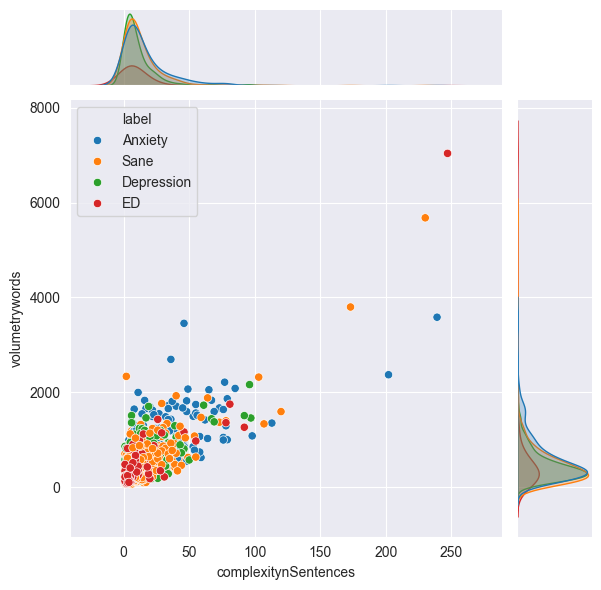

<Figure size 1000x300 with 0 Axes>

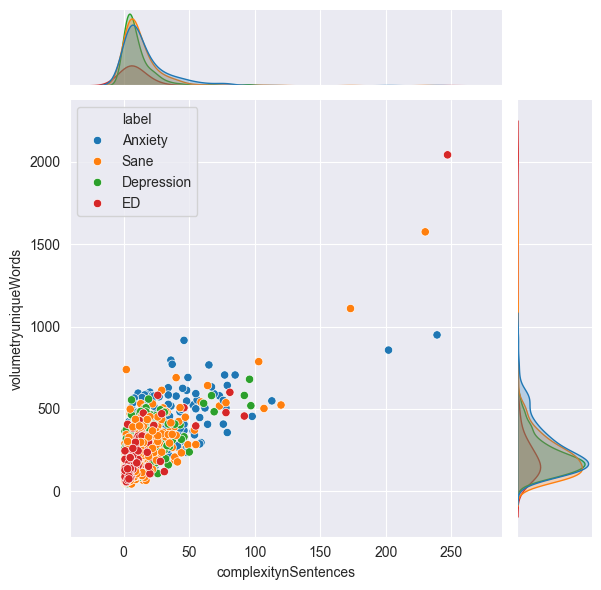

<Figure size 1000x300 with 0 Axes>

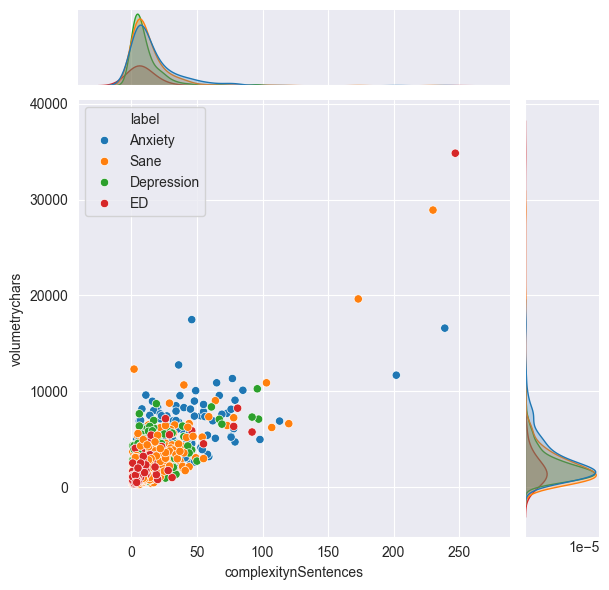

<Figure size 1000x300 with 0 Axes>

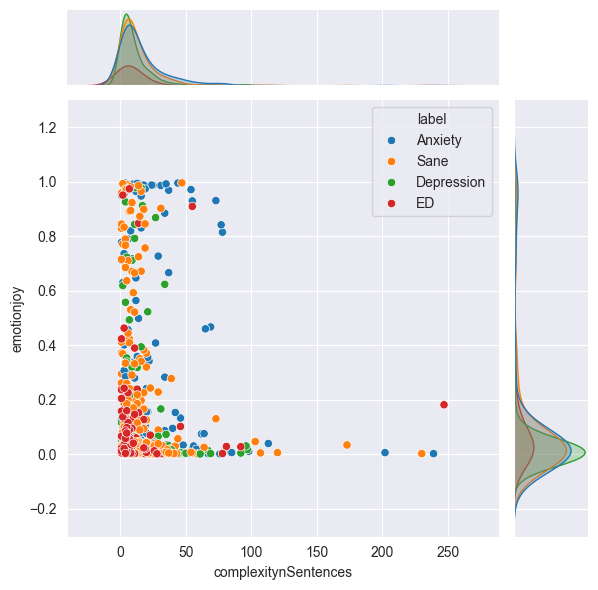

<Figure size 1000x300 with 0 Axes>

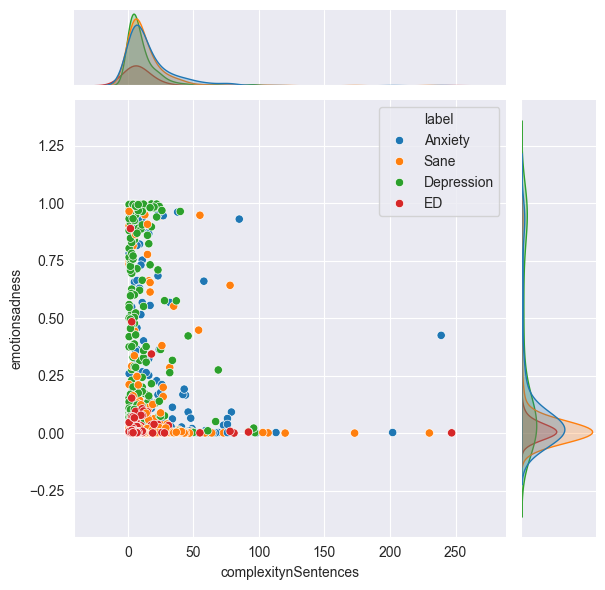

<Figure size 1000x300 with 0 Axes>

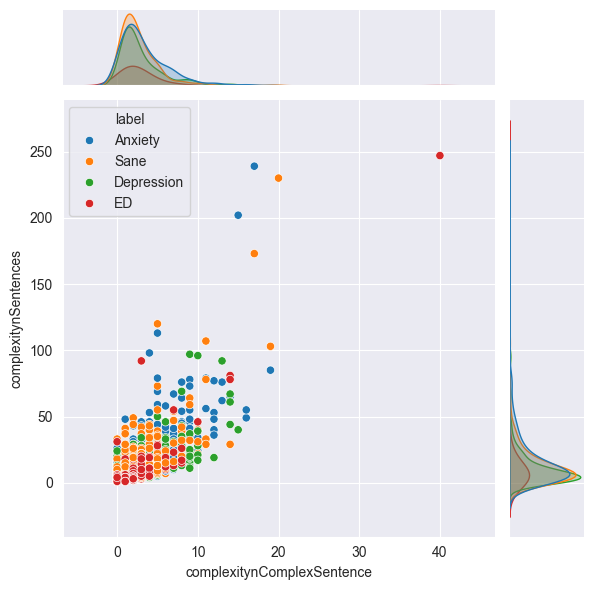

<Figure size 1000x300 with 0 Axes>

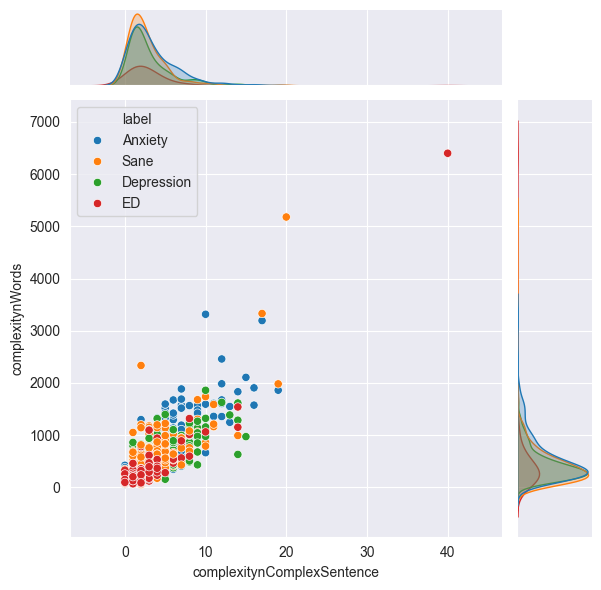

<Figure size 1000x300 with 0 Axes>

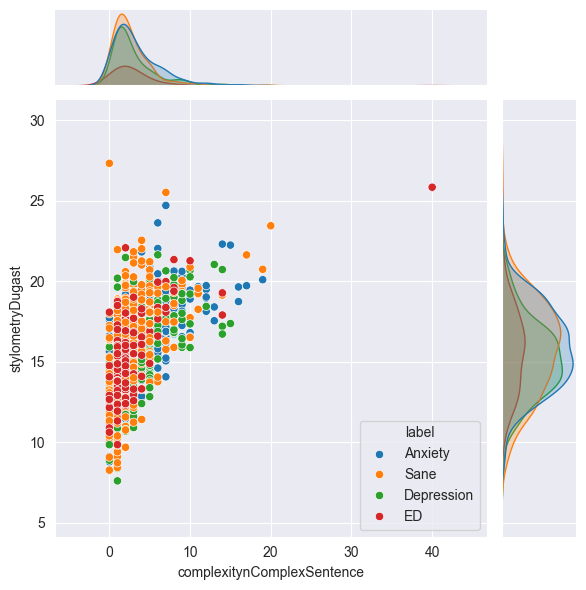

<Figure size 1000x300 with 0 Axes>

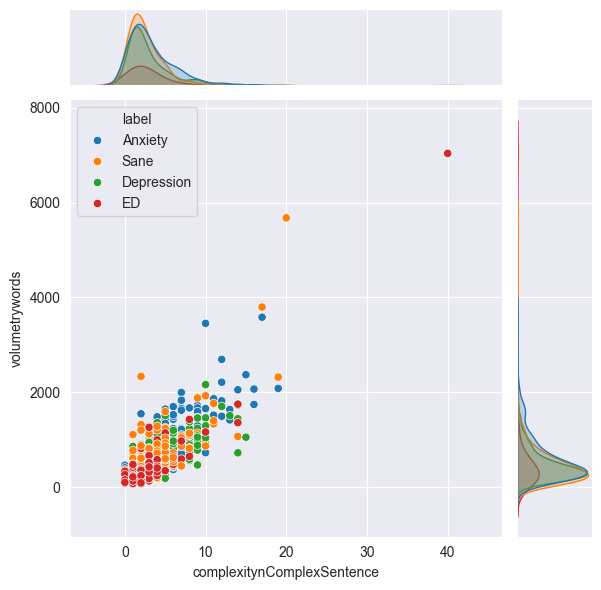

<Figure size 1000x300 with 0 Axes>

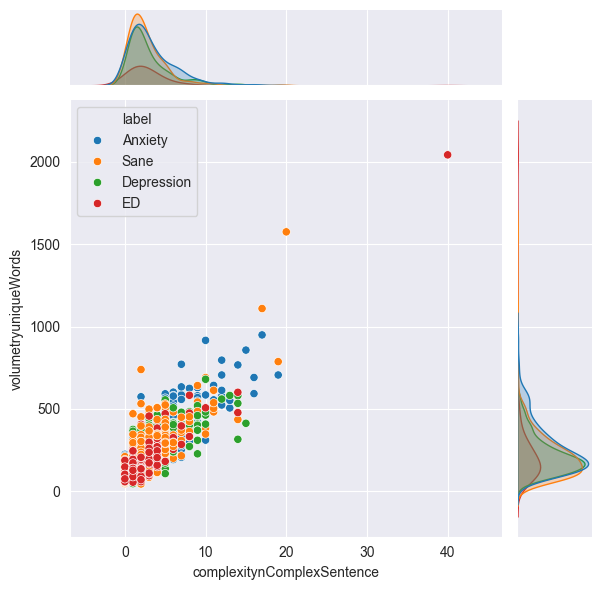

<Figure size 1000x300 with 0 Axes>

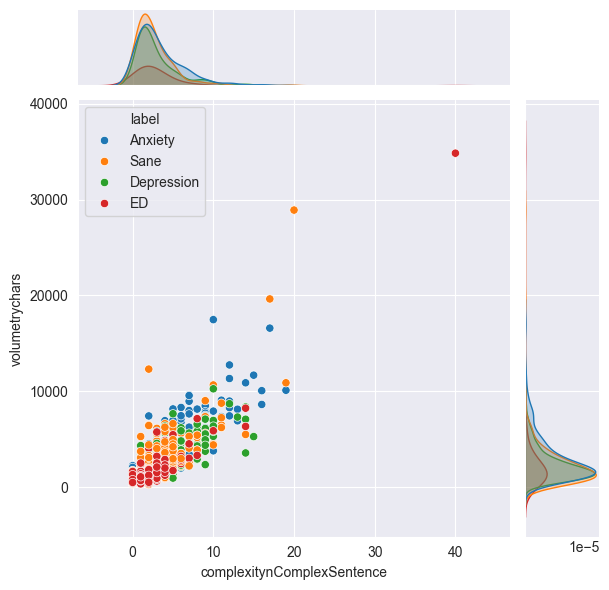

<Figure size 1000x300 with 0 Axes>

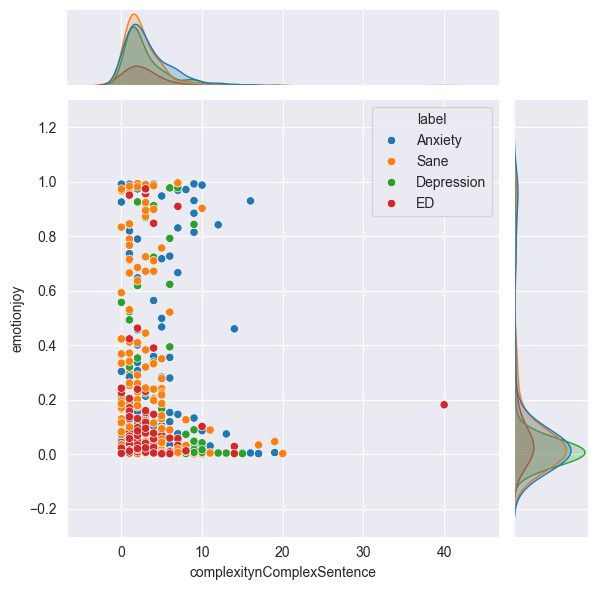

<Figure size 1000x300 with 0 Axes>

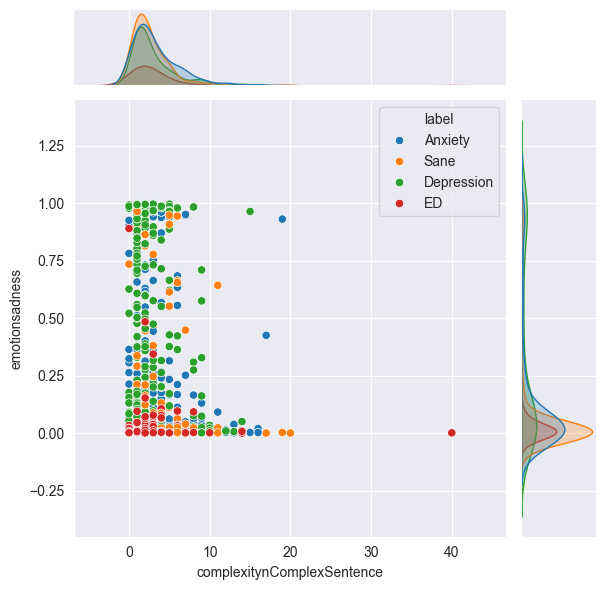

<Figure size 1000x300 with 0 Axes>

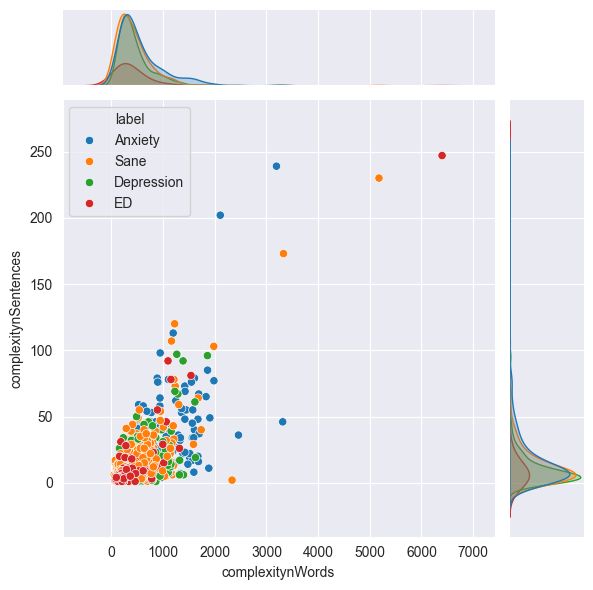

<Figure size 1000x300 with 0 Axes>

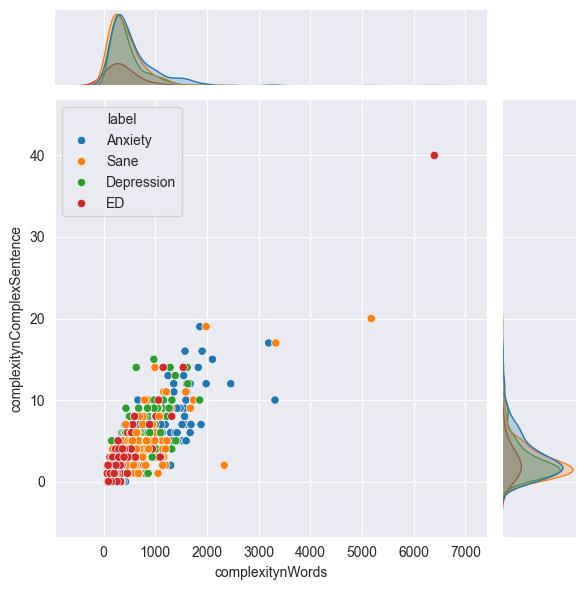

<Figure size 1000x300 with 0 Axes>

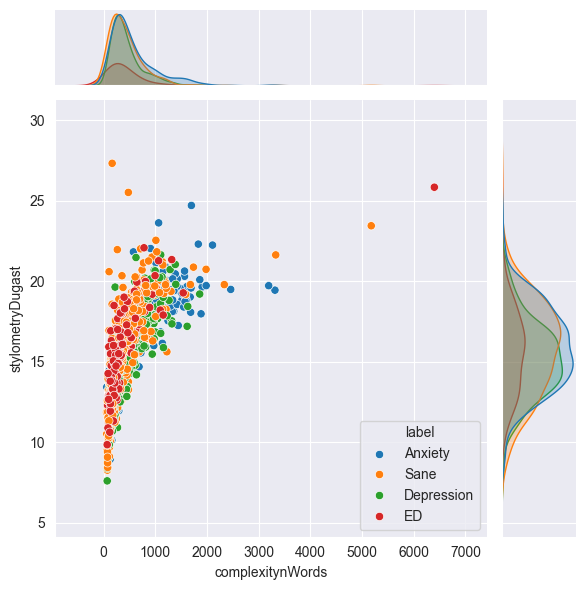

<Figure size 1000x300 with 0 Axes>

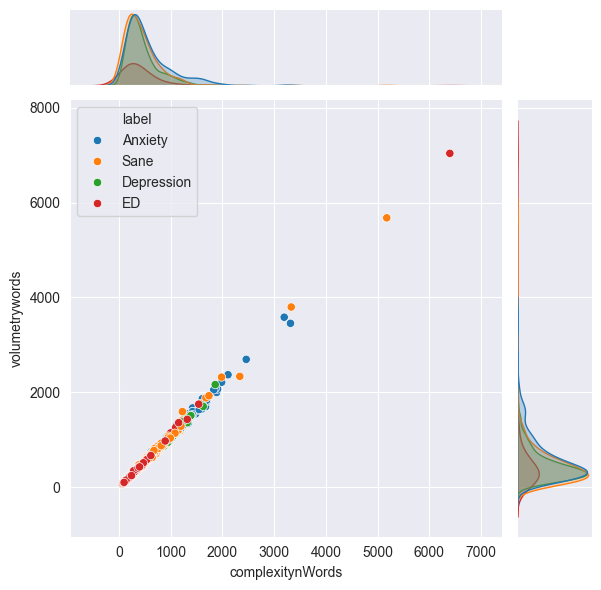

<Figure size 1000x300 with 0 Axes>

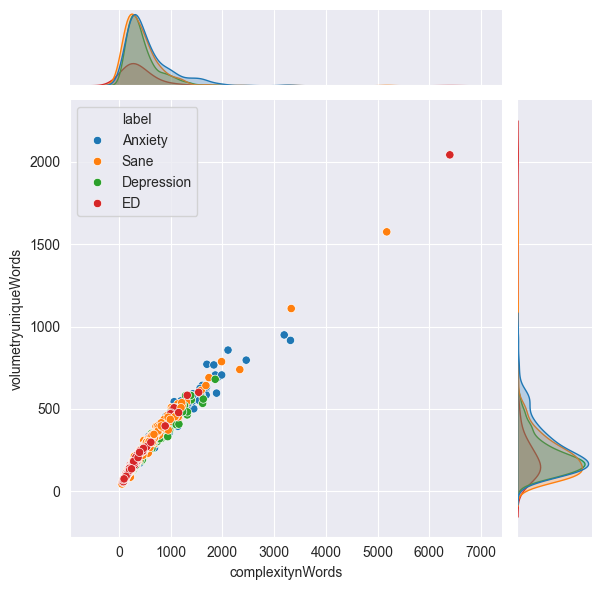

<Figure size 1000x300 with 0 Axes>

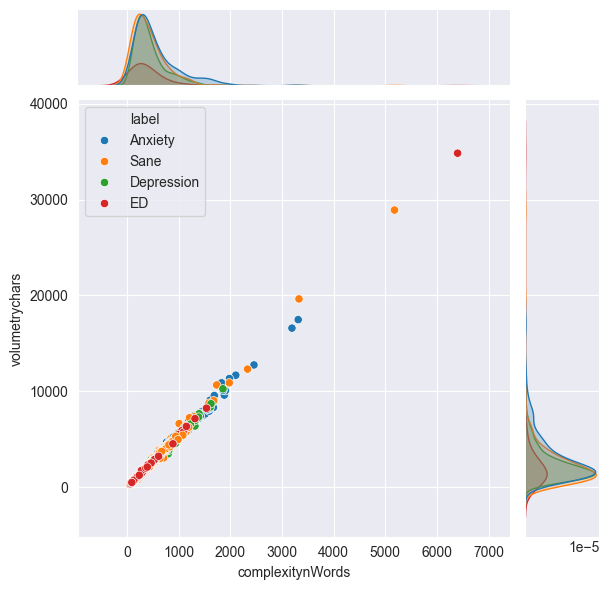

<Figure size 1000x300 with 0 Axes>

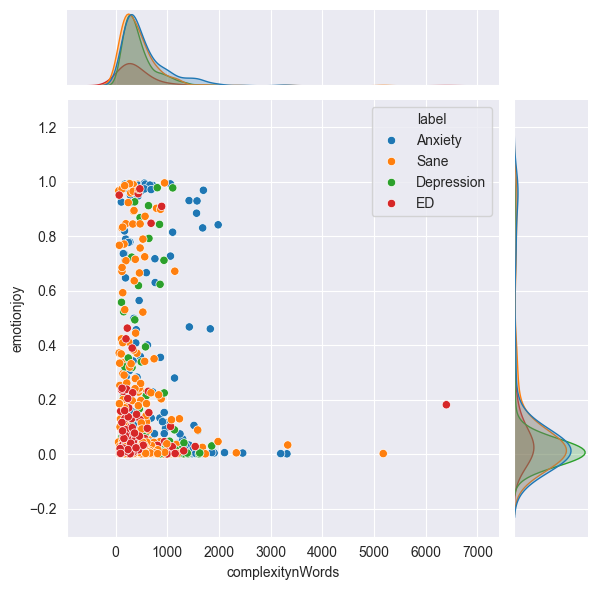

<Figure size 1000x300 with 0 Axes>

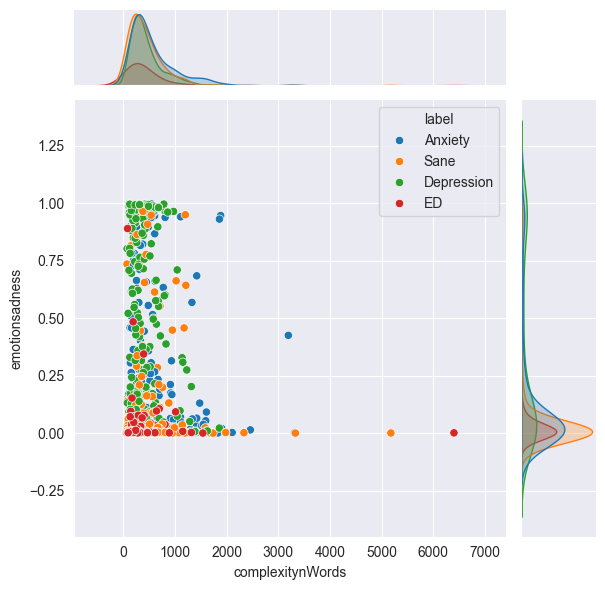

<Figure size 1000x300 with 0 Axes>

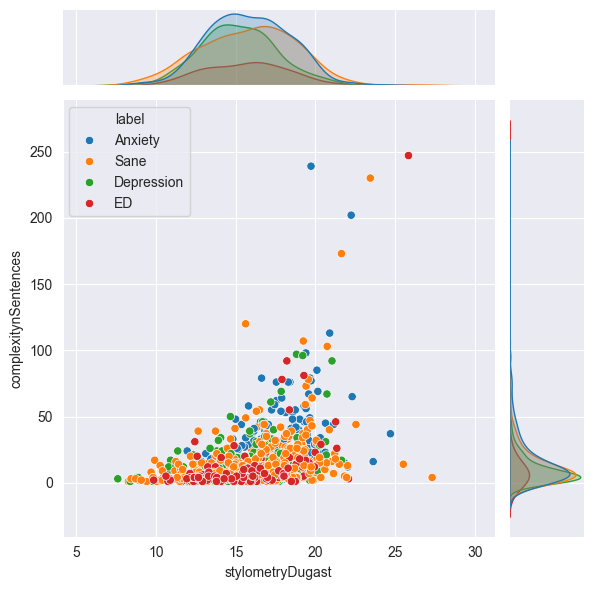

<Figure size 1000x300 with 0 Axes>

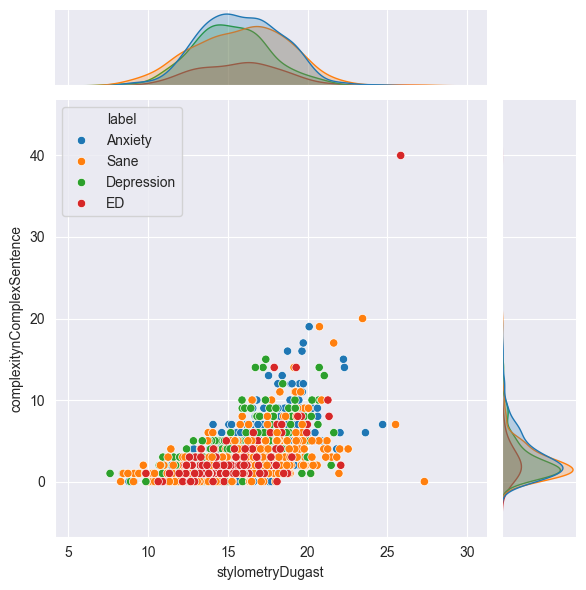

<Figure size 1000x300 with 0 Axes>

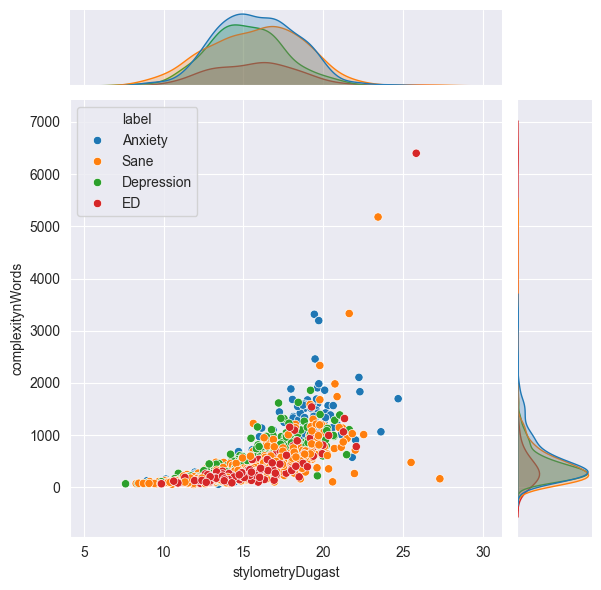

<Figure size 1000x300 with 0 Axes>

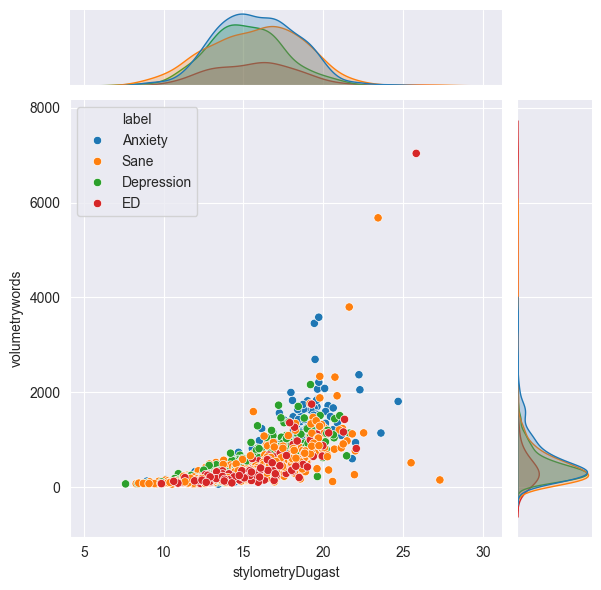

<Figure size 1000x300 with 0 Axes>

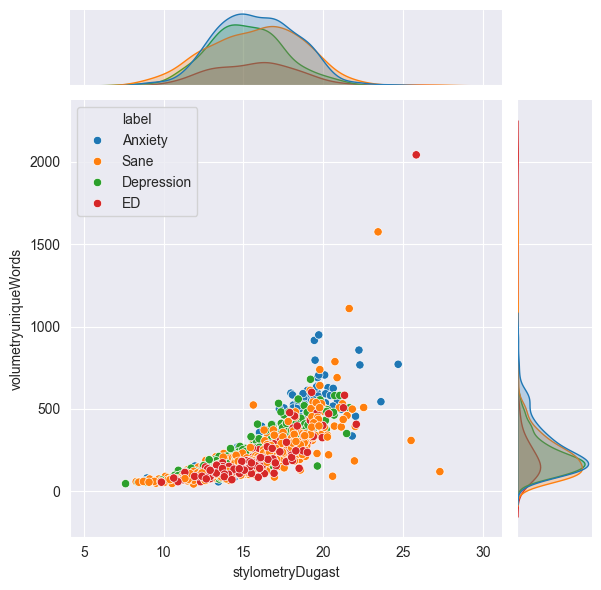

<Figure size 1000x300 with 0 Axes>

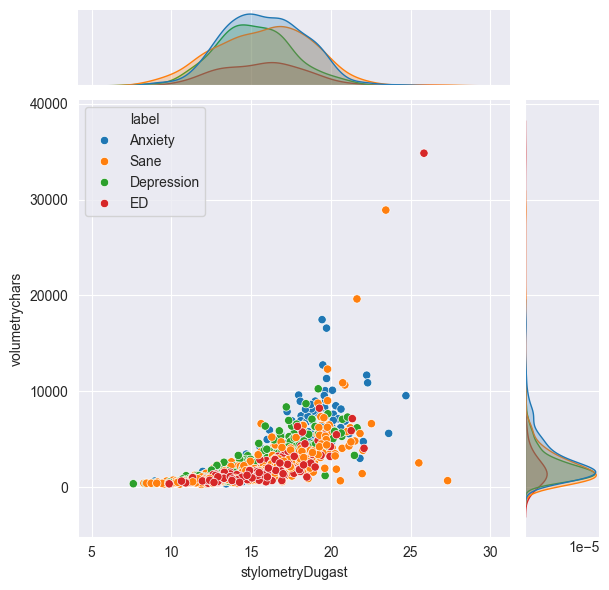

<Figure size 1000x300 with 0 Axes>

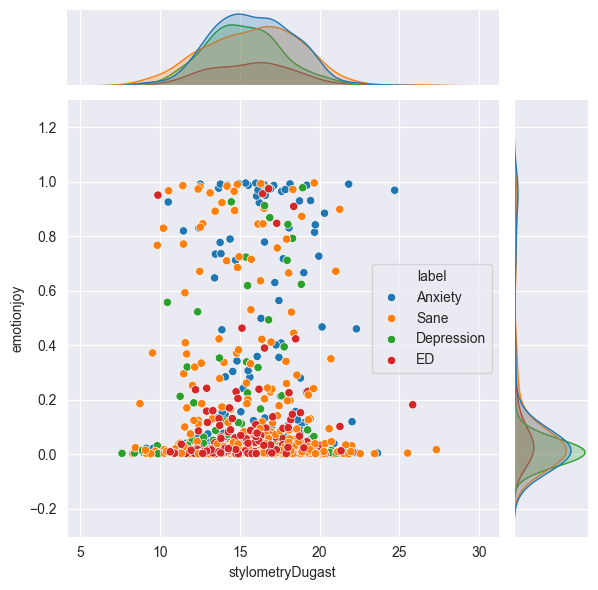

<Figure size 1000x300 with 0 Axes>

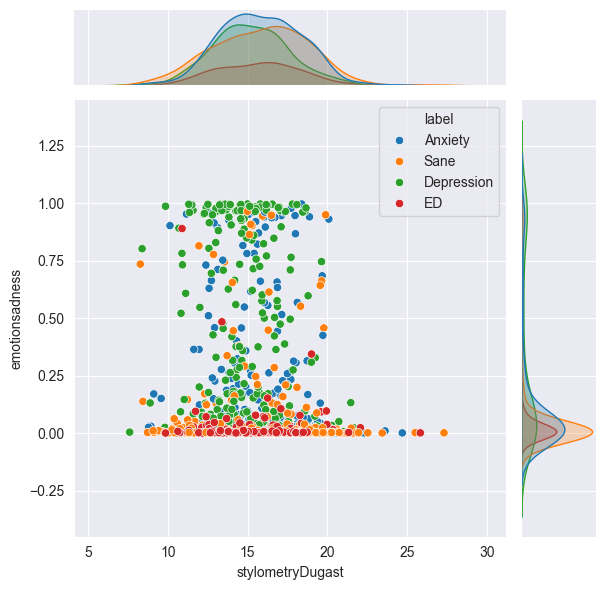

<Figure size 1000x300 with 0 Axes>

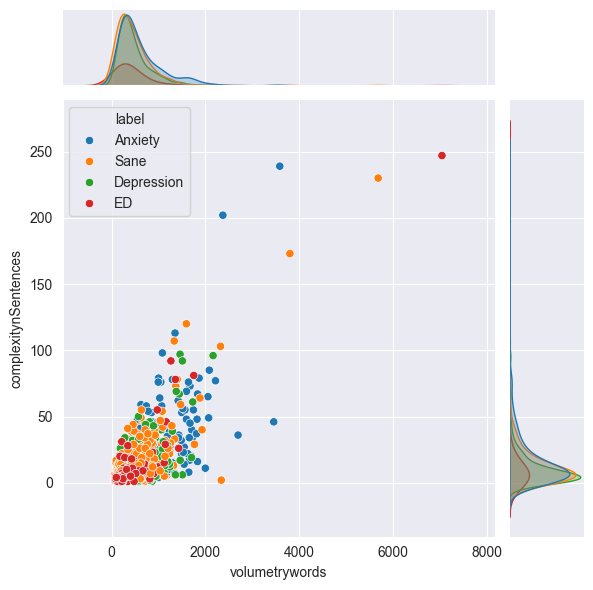

<Figure size 1000x300 with 0 Axes>

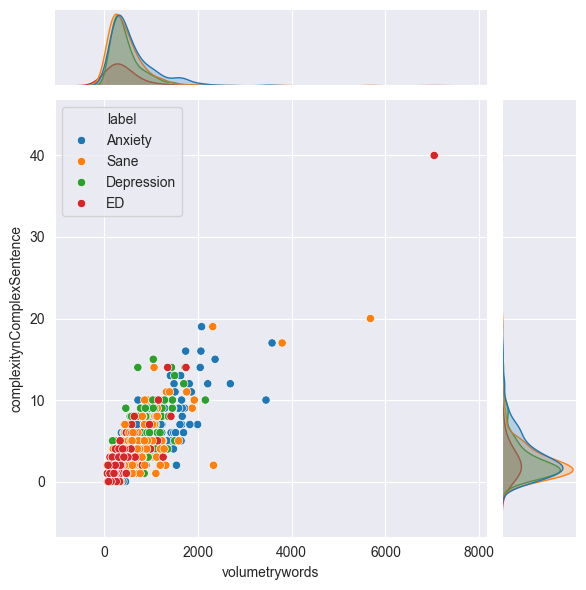

<Figure size 1000x300 with 0 Axes>

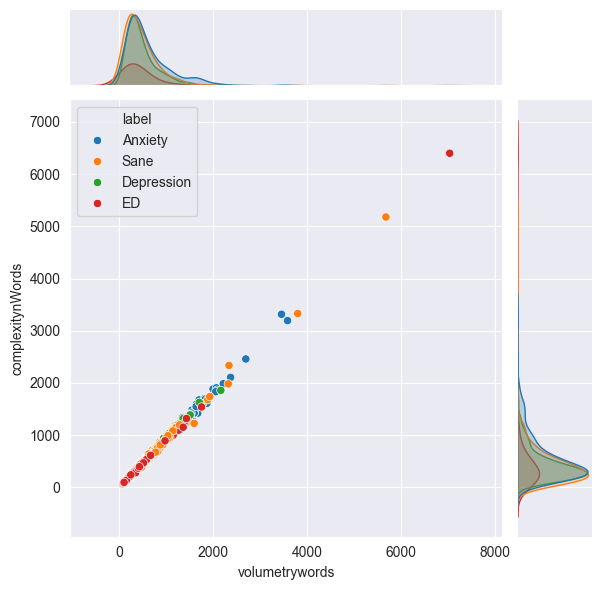

<Figure size 1000x300 with 0 Axes>

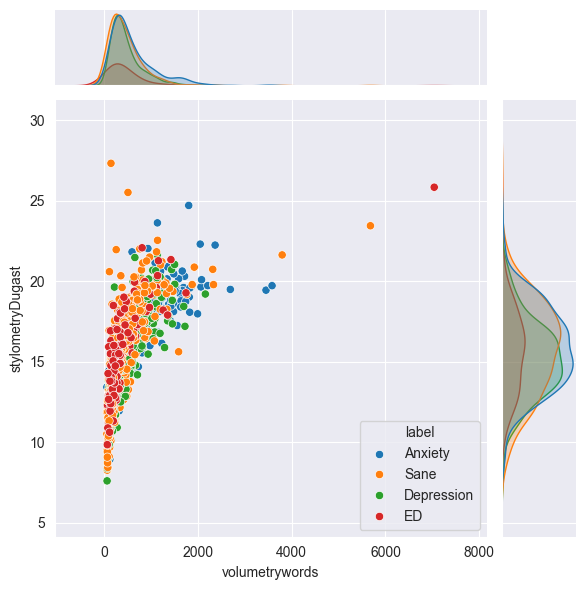

<Figure size 1000x300 with 0 Axes>

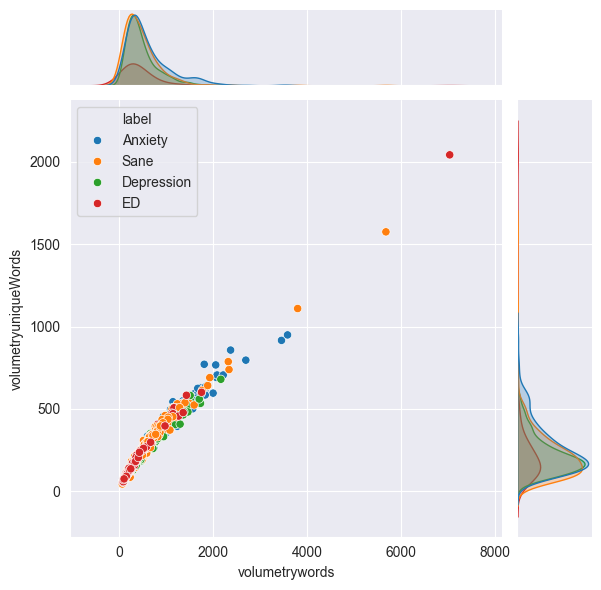

<Figure size 1000x300 with 0 Axes>

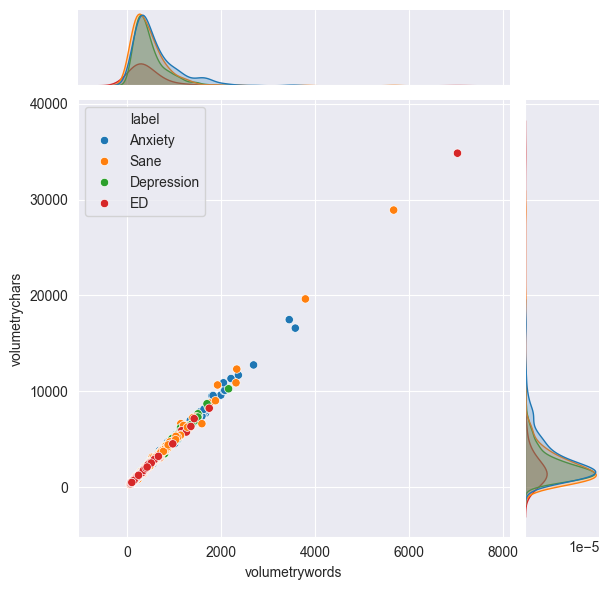

<Figure size 1000x300 with 0 Axes>

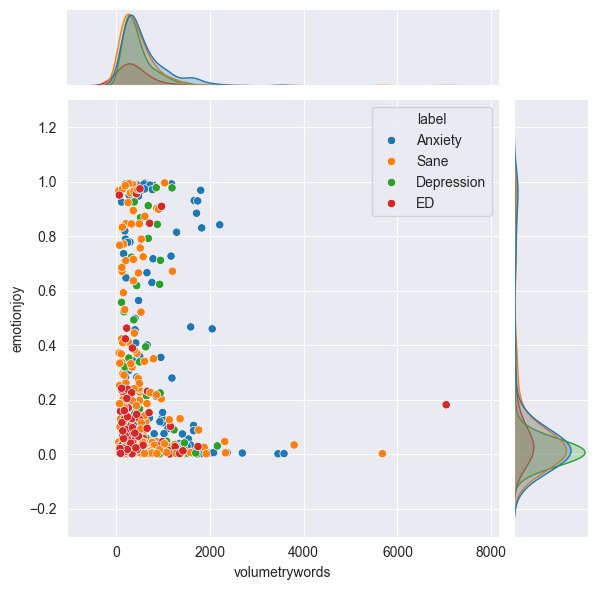

<Figure size 1000x300 with 0 Axes>

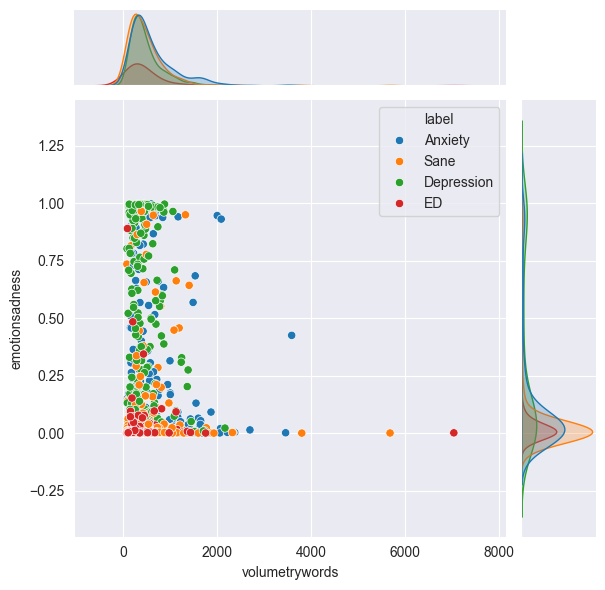

<Figure size 1000x300 with 0 Axes>

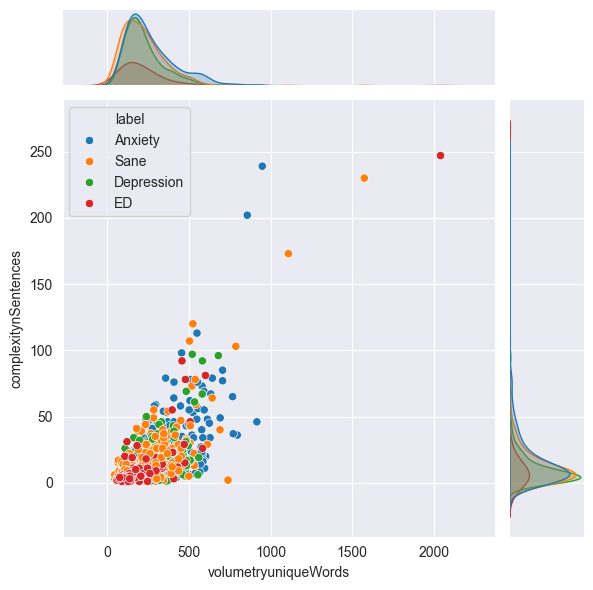

<Figure size 1000x300 with 0 Axes>

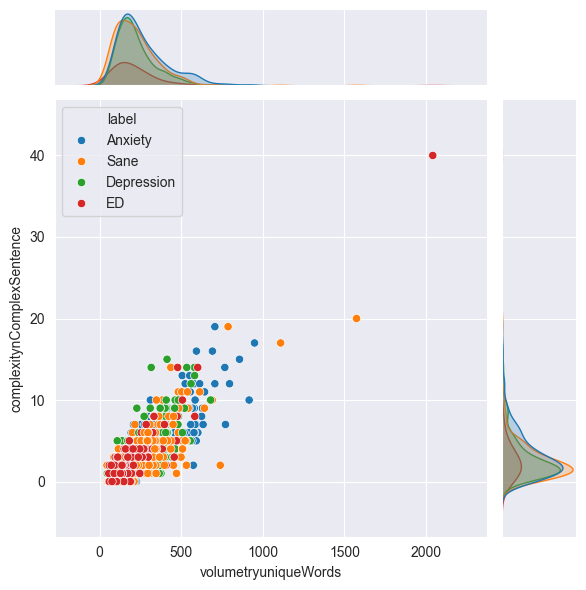

<Figure size 1000x300 with 0 Axes>

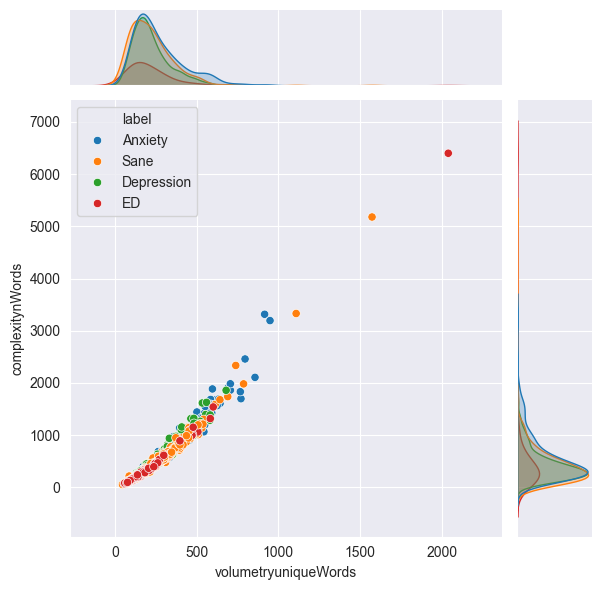

<Figure size 1000x300 with 0 Axes>

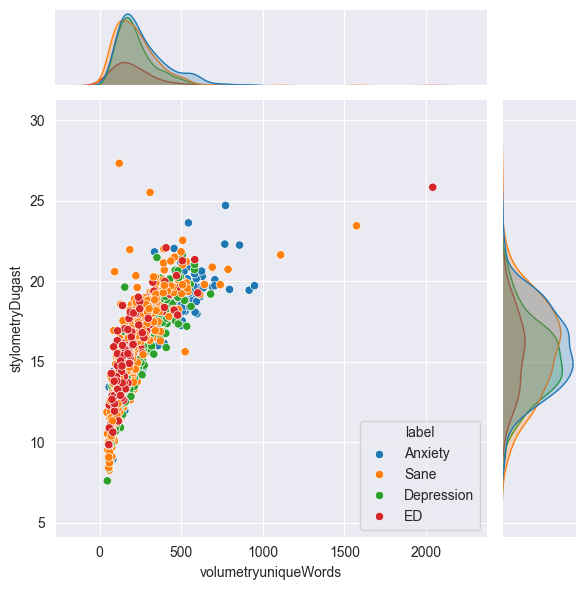

<Figure size 1000x300 with 0 Axes>

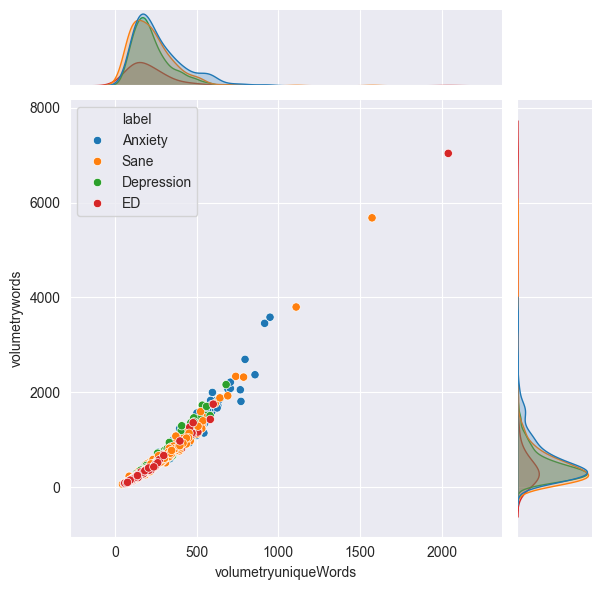

<Figure size 1000x300 with 0 Axes>

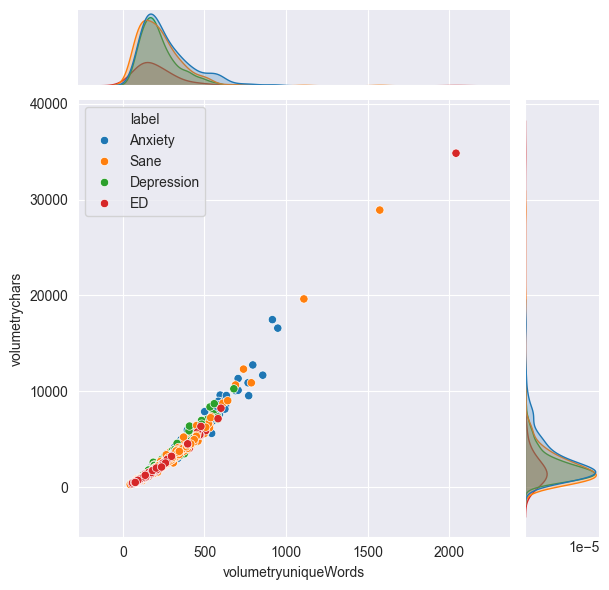

<Figure size 1000x300 with 0 Axes>

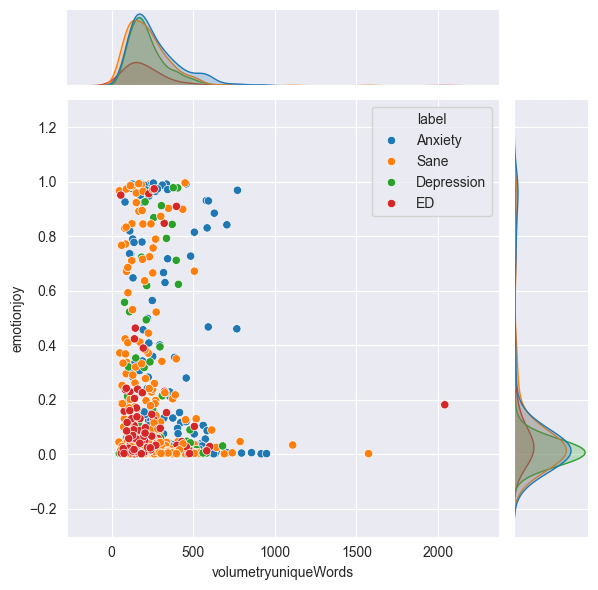

<Figure size 1000x300 with 0 Axes>

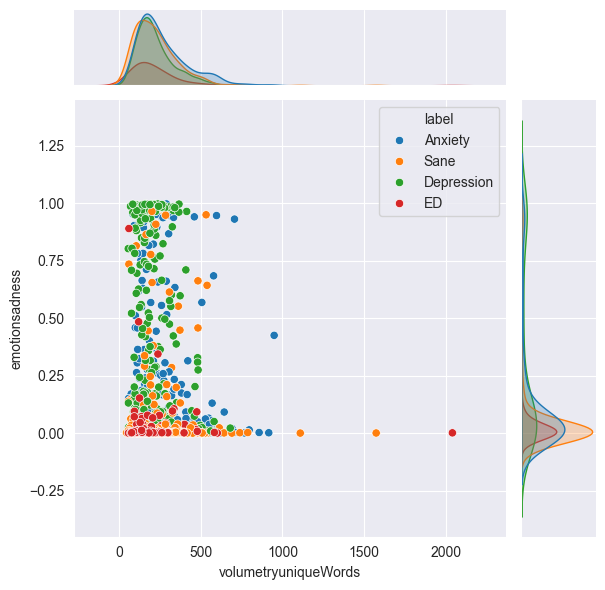

<Figure size 1000x300 with 0 Axes>

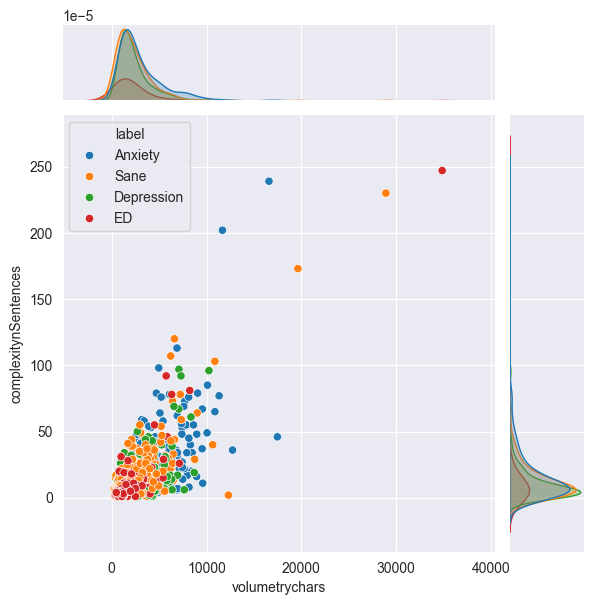

<Figure size 1000x300 with 0 Axes>

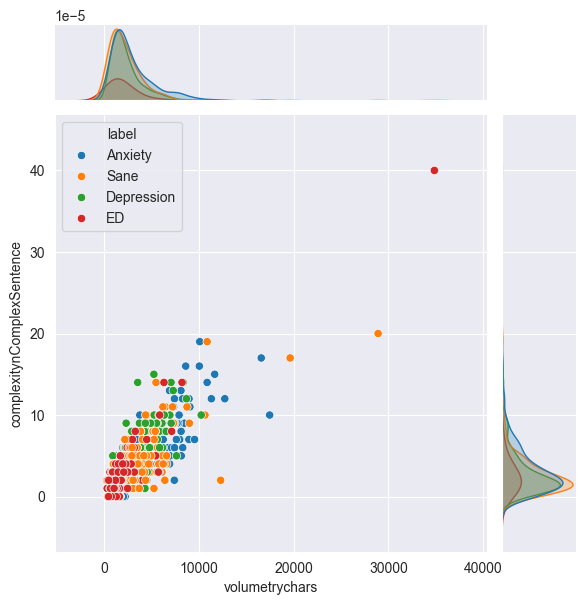

<Figure size 1000x300 with 0 Axes>

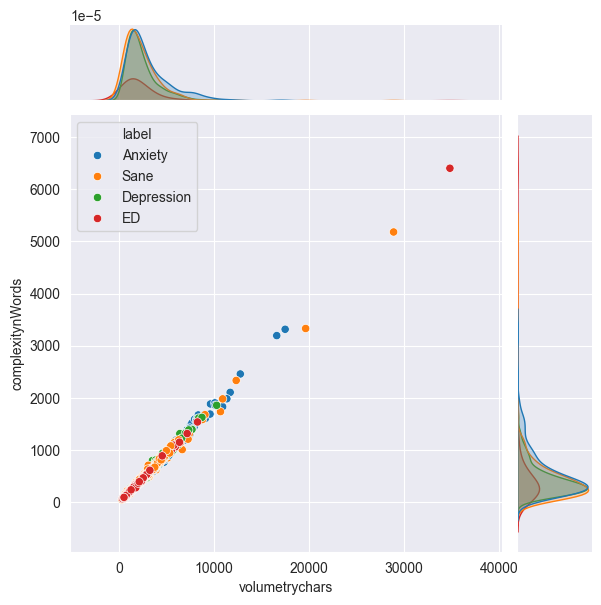

<Figure size 1000x300 with 0 Axes>

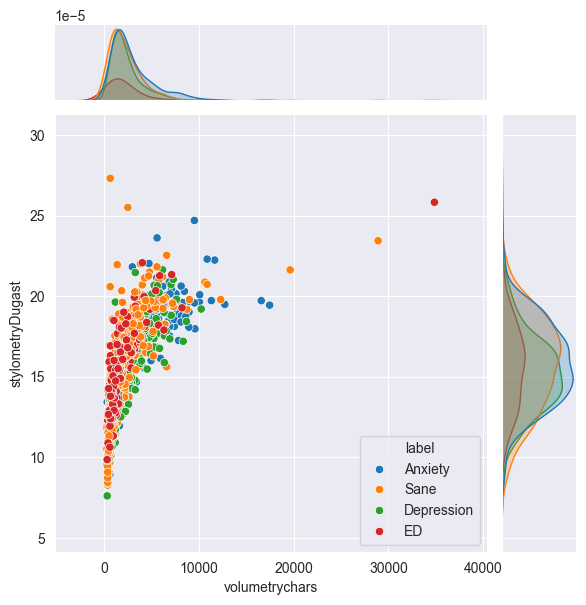

<Figure size 1000x300 with 0 Axes>

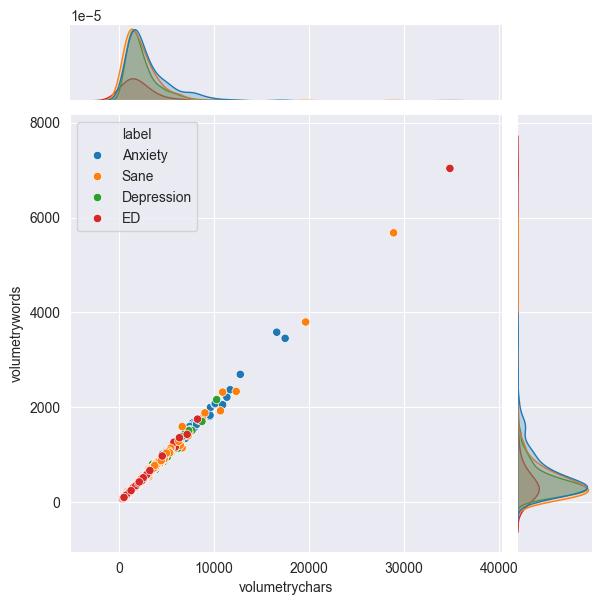

<Figure size 1000x300 with 0 Axes>

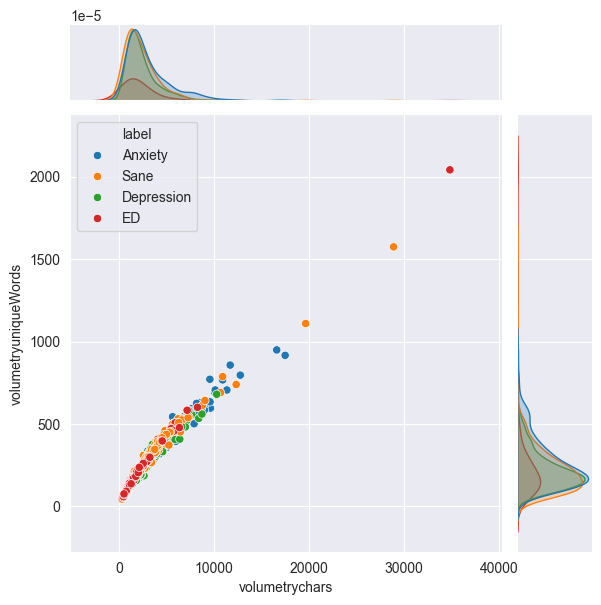

<Figure size 1000x300 with 0 Axes>

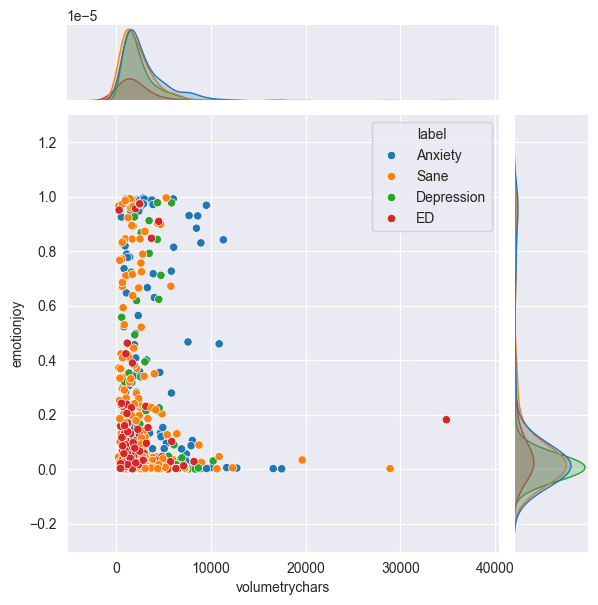

<Figure size 1000x300 with 0 Axes>

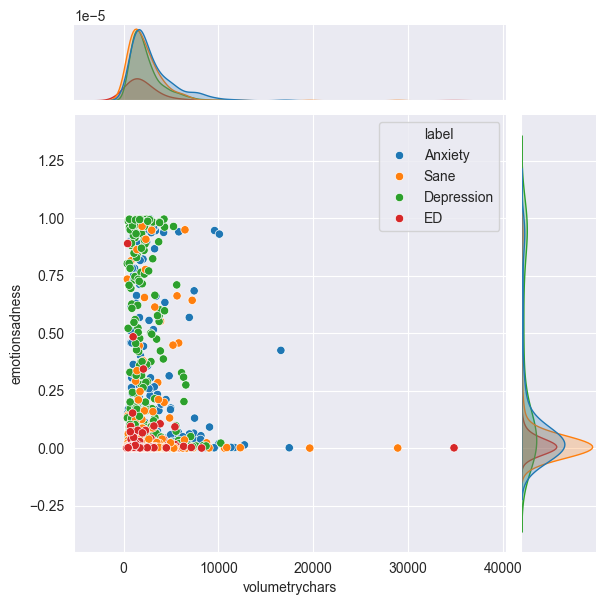

<Figure size 1000x300 with 0 Axes>

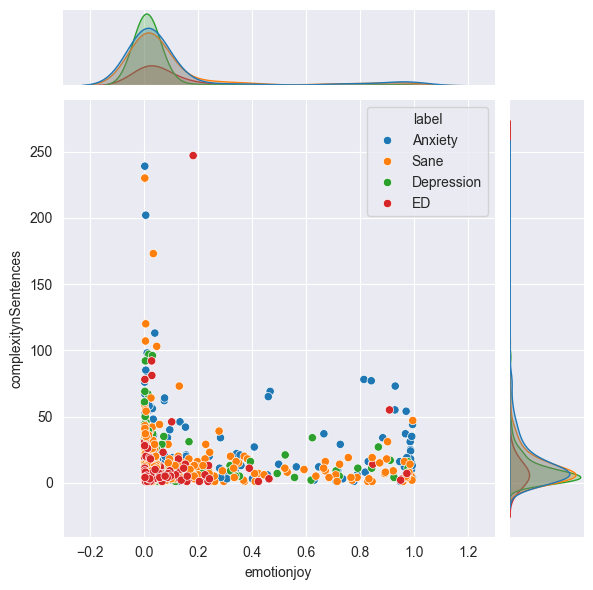

<Figure size 1000x300 with 0 Axes>

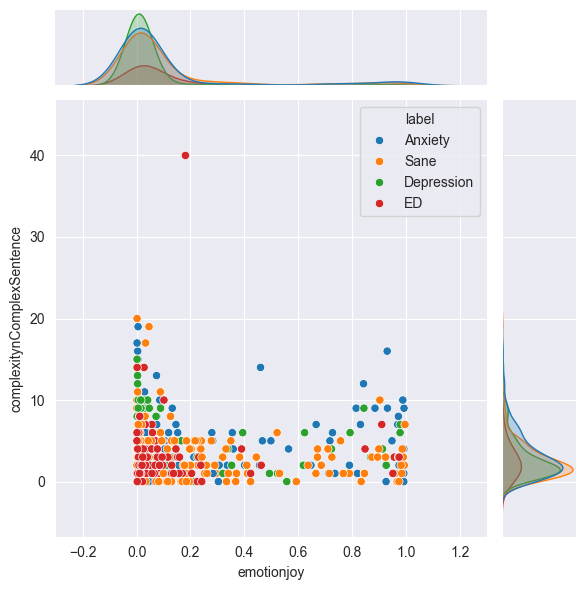

<Figure size 1000x300 with 0 Axes>

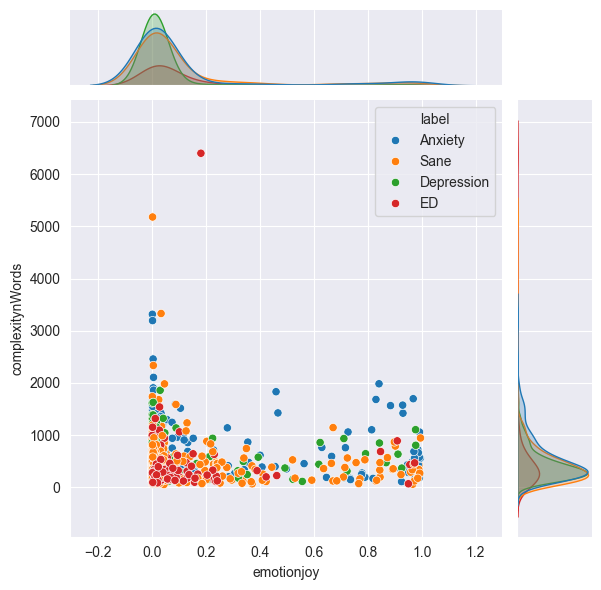

<Figure size 1000x300 with 0 Axes>

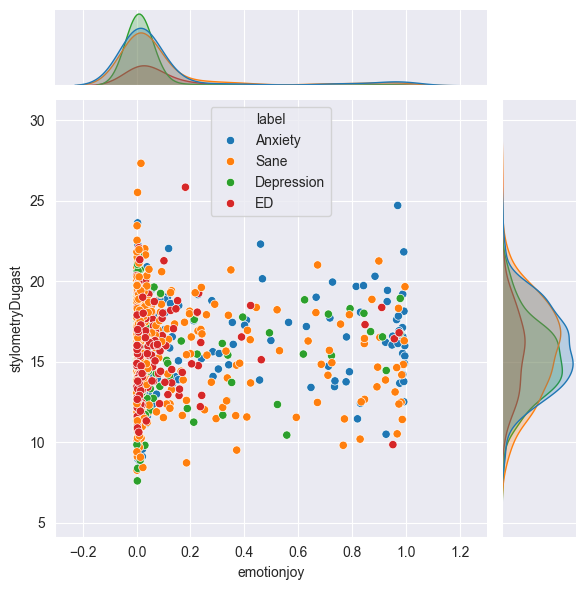

<Figure size 1000x300 with 0 Axes>

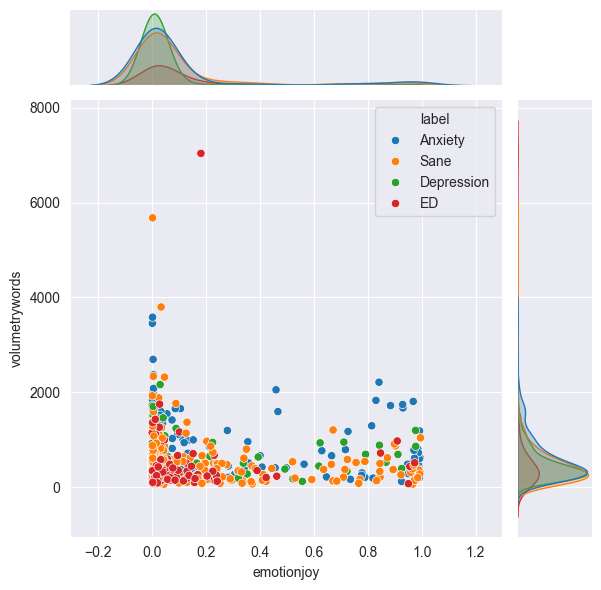

<Figure size 1000x300 with 0 Axes>

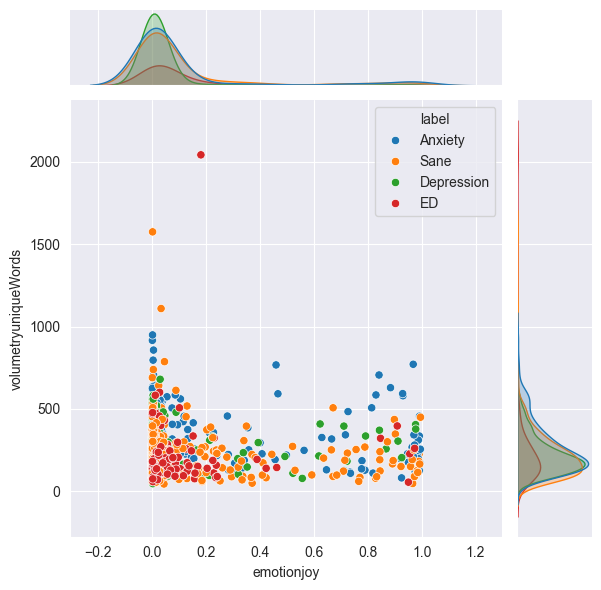

<Figure size 1000x300 with 0 Axes>

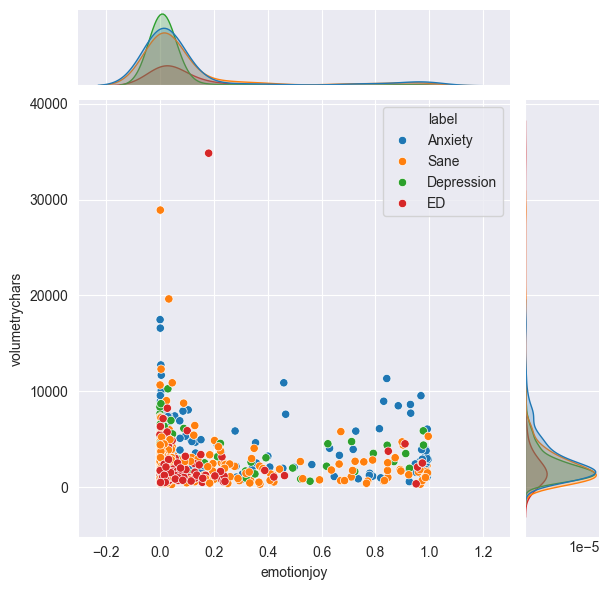

<Figure size 1000x300 with 0 Axes>

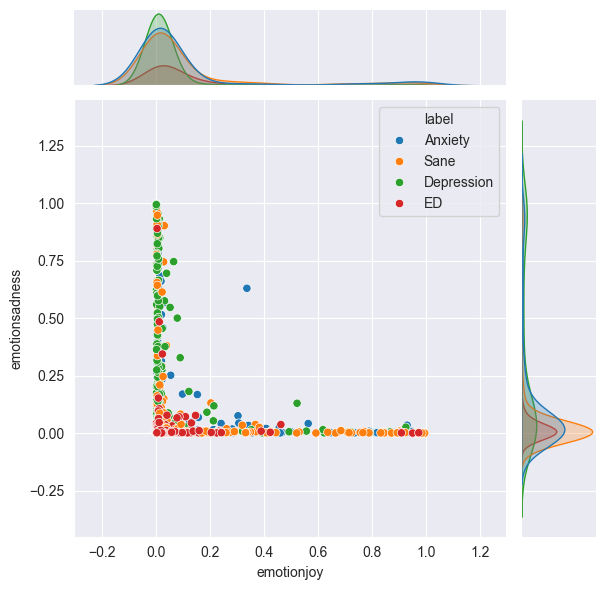

<Figure size 1000x300 with 0 Axes>

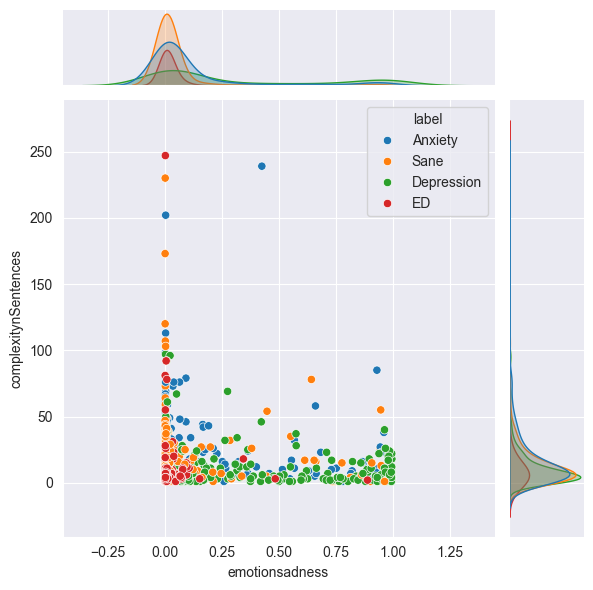

<Figure size 1000x300 with 0 Axes>

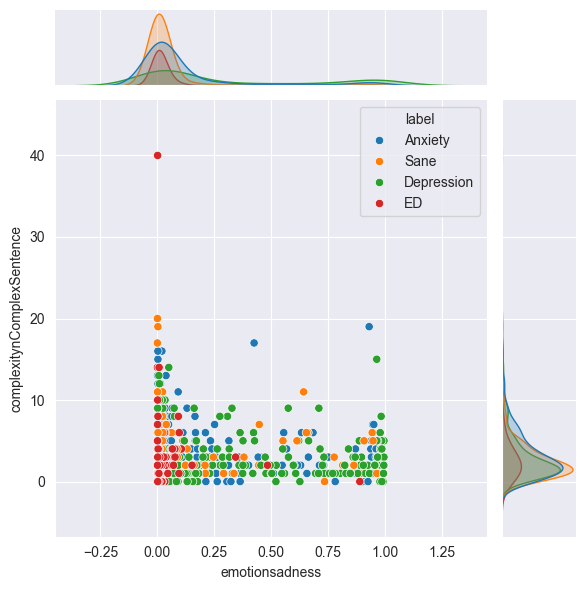

<Figure size 1000x300 with 0 Axes>

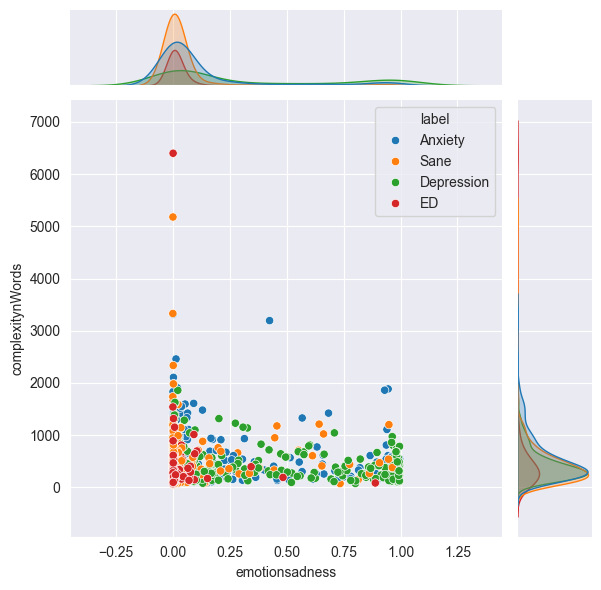

<Figure size 1000x300 with 0 Axes>

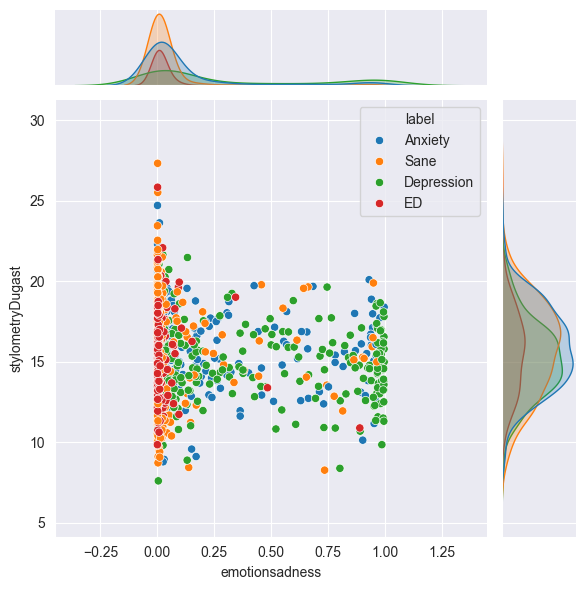

<Figure size 1000x300 with 0 Axes>

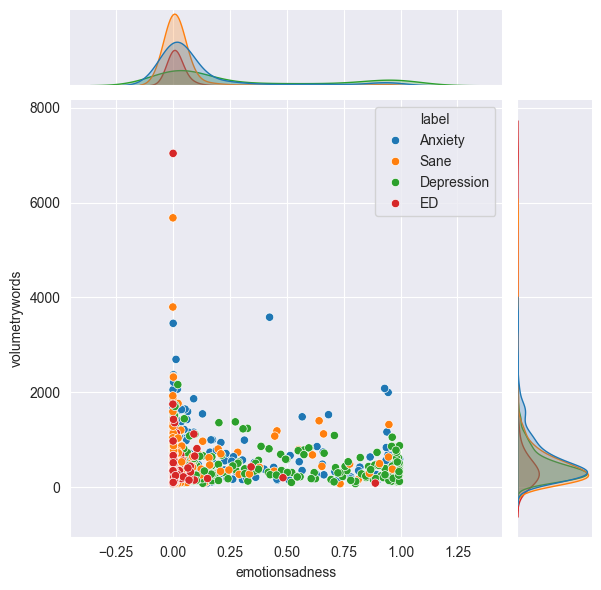

<Figure size 1000x300 with 0 Axes>

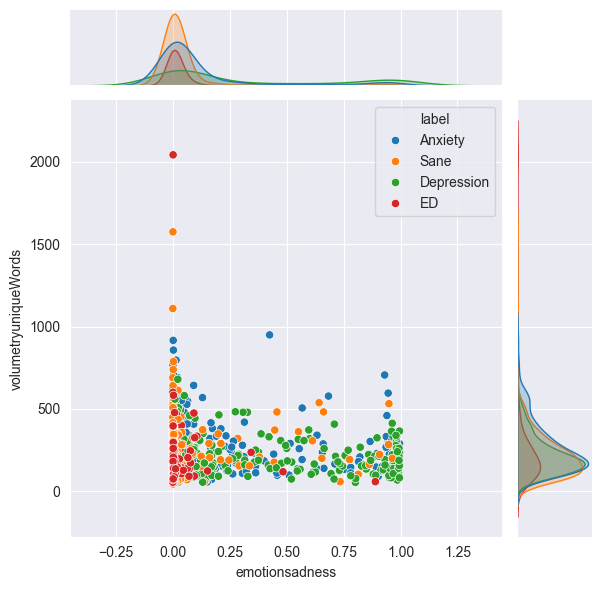

<Figure size 1000x300 with 0 Axes>

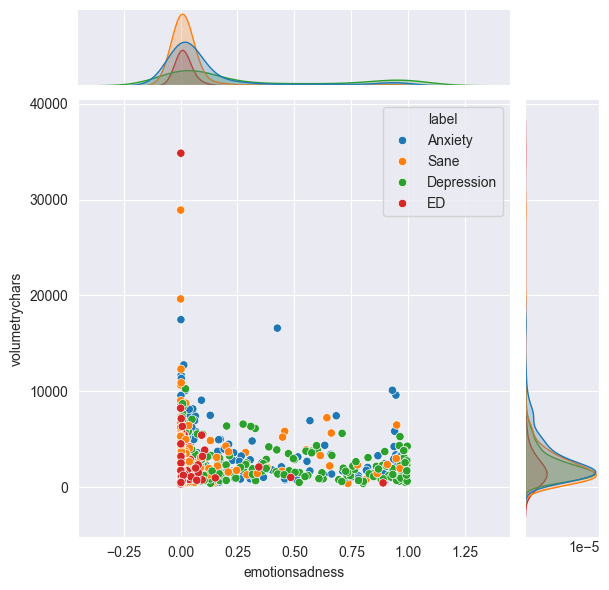

<Figure size 1000x300 with 0 Axes>

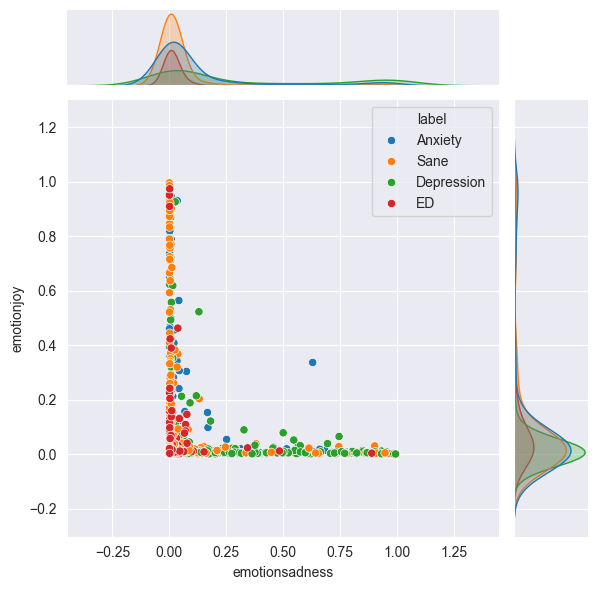

In [65]:
features = ['complexitynSentences', 'complexitynComplexSentence',
       'complexitynWords', 'stylometryDugast', 'volumetrywords',
       'volumetryuniqueWords', 'volumetrychars', 'emotionjoy', 'emotionsadness',]
for i in features:
    for j in features:
        if j != i:
            plt.figure(figsize=(10,3))
            sns.jointplot(data=df_visualization, x=i, y=j, hue='label')
            plt.show()

In [8]:
df_visualization = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_tf_notrastcol.csv', index_col = 0)

In [9]:
df_visualization['label'] = df_visualization['label'].replace({0: 'Sane', 1: 'Anxiety', 2: 'Depression', 3: 'ED'})

In [12]:
# Obtaining the number of tokens and vocabulary size per user written text
vol_df = df_visualization.copy()
vol_df['text'] = vol_df.groupby(by=['subject'])['message'].transform(lambda x : ' '.join(x))
vol_df['num_tokens'] = vol_df[['subject', 'message', 'label']].drop_duplicates().apply(lambda x: len(nltk.word_tokenize(re.sub(r'[^\w\s]',' ', x['message'].lower()))), axis=1)
vol_df['vocabulary_size'] = vol_df[['subject', 'message', 'label']].drop_duplicates().apply(lambda x: len(set(nltk.word_tokenize(re.sub(r'[^\w\s]',' ', x['message'].lower())))), axis=1)
vol_df[['subject', 'num_tokens', 'vocabulary_size']]

,subject,num_tokens,vocabulary_size
0,subject1_anx,1336,503
1,subject10_anx,79,64
2,subject100_anx,385,221
3,subject101_anx,1229,510
4,subject102_anx,1184,536
...,...,...,...
1328,subject95_ed,241,133
1329,subject96_ed,364,194
1330,subject97_ed,87,70
1331,subject98_ed,393,231


In [13]:
vol_df.describe()

,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,complexitynChar,complexityILFW,complexityLDI,...,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen,num_tokens,vocabulary_size
count,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,...,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000,1333.000000
mean,13.750938,3.002251,70.583907,38.644411,475.990248,112.324081,840.501125,5.170293,0.389493,22.538545,...,0.095867,0.800888,15.634514,1728.465772,513.617404,235.368342,2530.903976,4.982746,467.133533,227.178545
std,19.952220,2.946341,82.590514,50.268823,430.440872,109.944362,762.055979,2.836160,0.090324,24.996169,...,0.021241,0.041256,2.664526,863.736491,471.691890,149.274849,2334.256225,0.187049,415.017575,144.310600
min,1.000000,0.000000,4.588235,0.000000,55.000000,9.000000,40.000000,1.000000,0.149123,1.716667,...,0.043282,0.546909,7.613386,195.424251,64.000000,45.000000,268.000000,4.000000,42.000000,34.000000
25%,4.000000,1.000000,24.600000,10.000000,215.000000,50.000000,375.000000,3.000000,0.330275,8.153846,...,0.081150,0.779488,13.730079,1279.218669,228.000000,135.000000,1134.000000,5.000000,213.000000,129.000000
50%,8.000000,2.000000,43.450000,24.000000,356.000000,83.000000,632.000000,5.000000,0.380282,14.466667,...,0.091965,0.808235,15.608844,1513.815576,383.000000,199.000000,1891.000000,5.000000,351.000000,191.000000
75%,16.000000,4.000000,80.333333,50.000000,590.000000,140.000000,1035.000000,7.000000,0.441270,25.666667,...,0.106924,0.829650,17.457221,1891.434977,637.000000,293.000000,3129.000000,5.000000,580.000000,284.000000
max,247.000000,40.000000,1167.500000,658.000000,6399.000000,1987.000000,10560.000000,15.000000,0.920354,276.000000,...,0.228815,0.893421,27.314221,11468.798861,7038.000000,2041.000000,34853.000000,6.000000,5766.000000,1901.000000


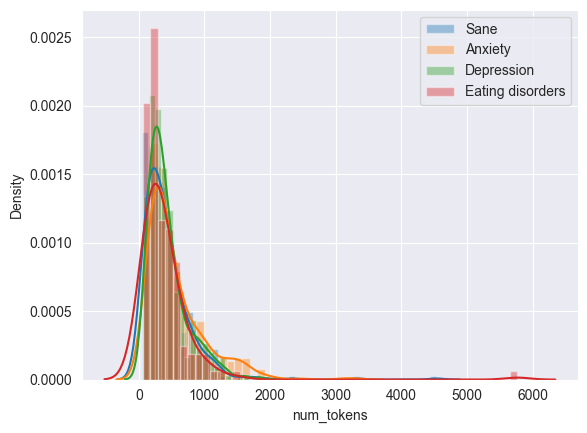

In [14]:
# Visualization per class
sns.distplot(vol_df[vol_df['label'] == 'Sane']['num_tokens'], label="Sane")
sns.distplot(vol_df[vol_df['label'] == 'Anxiety']['num_tokens'], label="Anxiety")
sns.distplot(vol_df[vol_df['label'] == 'Depression']['num_tokens'], label="Depression")
sns.distplot(vol_df[vol_df['label'] == 'ED']['num_tokens'], label="Eating disorders")
plt.legend()
plt.show()

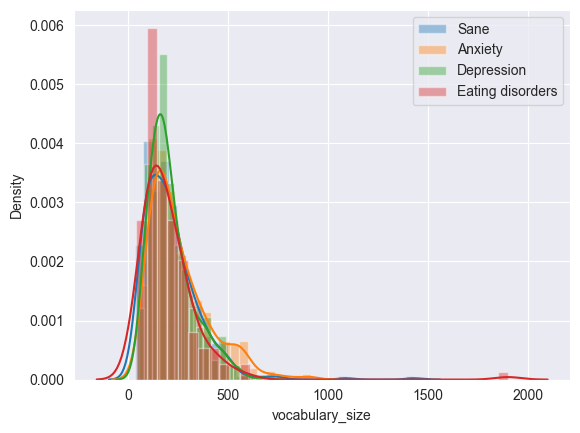

In [15]:
sns.distplot(vol_df[vol_df['label'] == 'Sane']['vocabulary_size'], label="Sane")
sns.distplot(vol_df[vol_df['label'] == 'Anxiety']['vocabulary_size'], label="Anxiety")
sns.distplot(vol_df[vol_df['label'] == 'Depression']['vocabulary_size'], label="Depression")
sns.distplot(vol_df[vol_df['label'] == 'ED']['vocabulary_size'], label="Eating disorders")
plt.legend()
plt.show()

In [33]:
# Function to filter stopwords from a text
def remove_sw(text):
    text = text.lower()
    tokenizer = TreebankWordTokenizer()
    spanish_stops = stopwords.words('spanish')
    text = tokenizer.tokenize(text)
    filtered = [word for word in text if word not in spanish_stops]
    final_str = ' '.join(filtered)
    return final_str

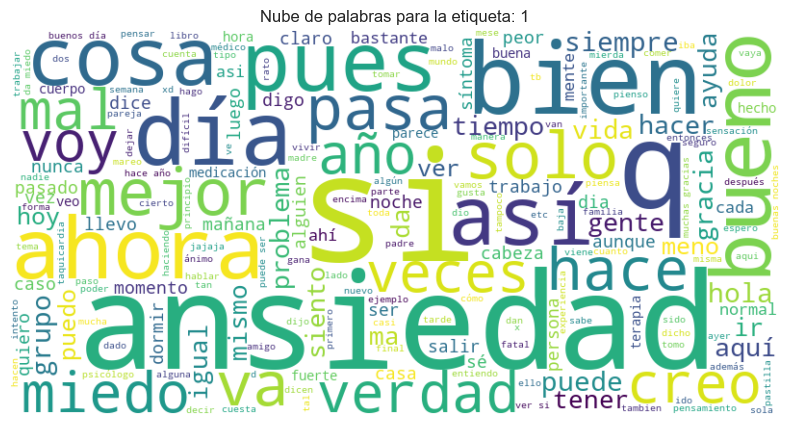

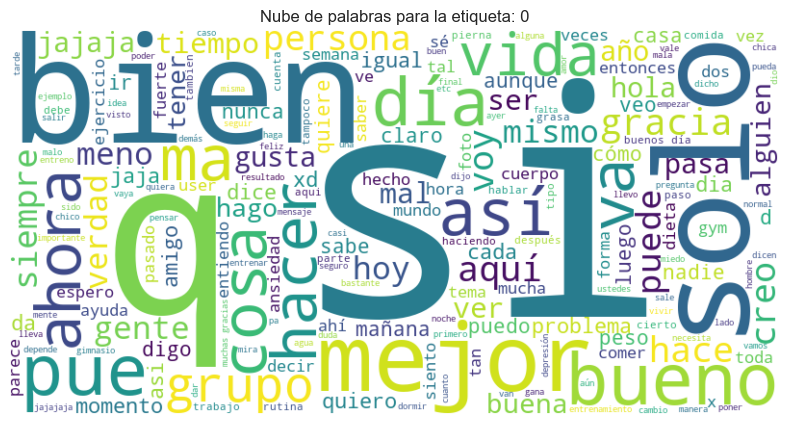

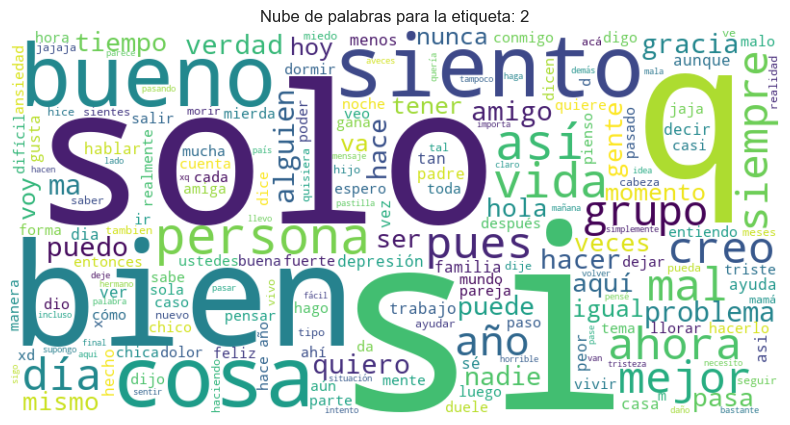

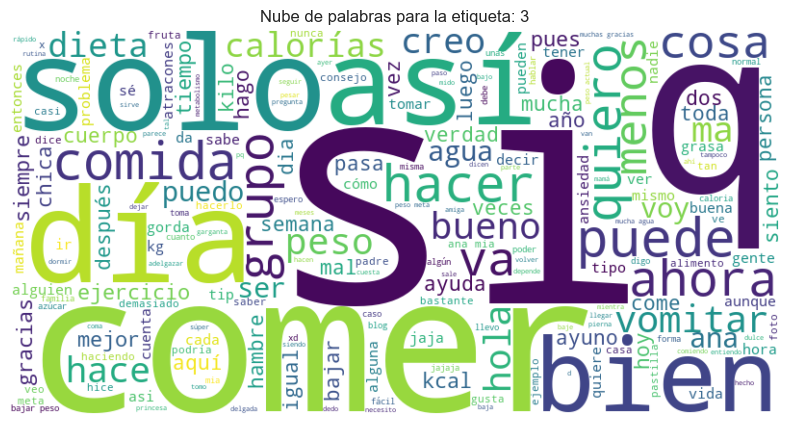

In [34]:
df = pd.read_csv('C:\\Users\\Pablo\\Desktop\\tfm\\df_tf_notrastcol.csv', index_col = 0)
df = df[['message', 'label']]
df['message'] = df['message'].apply(lambda x: remove_sw(x))

for etiqueta in df['label'].unique():
    # Filter texts from each tag
    textos = df[df['label'] == etiqueta]['message']
    
    # Join every text in one single spaces separated string
    textos_unidos = ' '.join(textos)
    
    # Create the wordcloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(textos_unidos)
    
    # Show the wordcloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Nube de palabras para la etiqueta: {etiqueta}')
    plt.axis('off')
    plt.show()

### Análisis y tratamiento de valores faltantes

Observamos con anterioridad que volumetryavgWordsLen posee tan solo 3 valores distintos en toda la distribución por lo que la transformamos
a categórica. Es cierto que *complexitynComplexSentence* y *complexitynChar* poseen 21 y 15 valores distintos respectivamente pero nos ceñiremos a las restricciones aprendidas durante la titulación donde el máximo de valores distintos para convertir una variable a categórica debe ser 10 o menos.

In [122]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_tf_notrastcol.csv', index_col = 0)

In [123]:
set(df['volumetryavgWordsLen'])

{4, 5, 6}

In [124]:
def col_to_categ(x):
    if x == 4:
        return 'Short'
    elif x == 5:
        return 'Medium'
    else:
        return 'Long'

df['volumetryavgWordsLen'] = df.volumetryavgWordsLen.apply(lambda x: col_to_categ(x))

In [125]:
subjects = df['subject']
messages = df['message']
labels = df['label']
df.drop(['subject', 'message', 'label'], axis = 1, inplace = True)

In [126]:
df

,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,complexitynChar,complexityILFW,complexityLDI,...,stylometryRTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen
0,53,12,25.603774,140,1357,303,2432,5,0.364919,6.716981,...,10.759723,0.824806,0.081067,0.833361,18.132287,1249.689964,1496,524,7430,Medium
1,15,0,5.266667,18,79,31,105,7,0.909091,2.000000,...,5.178265,0.859470,0.095755,0.779407,14.137679,1447.505121,97,67,406,Short
2,17,3,22.647059,51,385,84,661,8,0.364865,7.470588,...,7.645096,0.834428,0.090025,0.813650,15.953629,2113.179288,436,226,2137,Medium
3,15,5,82.333333,66,1235,271,2106,5,0.365385,23.866667,...,11.838297,0.844635,0.069929,0.851364,20.044920,1356.935108,1301,519,6356,Medium
4,113,5,10.584071,156,1196,290,2281,8,0.350495,3.619469,...,12.483154,0.850154,0.066217,0.857766,20.894644,1690.727413,1352,549,6885,Medium
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,3,2,80.000000,5,240,76,419,6,0.469565,26.666667,...,6.426476,0.837683,0.096676,0.796984,14.740882,779.556104,245,137,1225,Medium
1329,5,4,73.200000,39,366,92,661,6,0.322785,24.800000,...,7.614810,0.837578,0.088648,0.815375,16.079814,1182.957028,405,205,1978,Medium
1330,3,2,29.000000,4,87,27,169,7,0.428571,12.666667,...,5.136596,0.862767,0.094108,0.780490,14.275284,1919.860564,91,71,493,Medium
1331,18,3,21.944444,33,395,109,693,7,0.493590,7.611111,...,8.942313,0.861570,0.070869,0.846001,19.009135,2212.804988,428,237,2086,Medium


In [127]:
var_input = list(df.columns)  

# Selecting numeric features
numeric_input = df.select_dtypes(include = ['int', 'int32', 'int64','float', 'float32', 'float64']).columns

# Selecting categorical features
categorical_input = [var for var in var_input if var not in numeric_input]

In [128]:
numeric_input

Index(['complexitynSentences', 'complexitynComplexSentence',
       'complexityavglenSentence', 'complexitynPuntuationMarks',
       'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes',
       'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC',
       'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta',
       'complexityIFSZ', 'complexitypolini', 'complexitymu',
       'complexityminage', 'complexitySOL', 'complexitycrawford',
       'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth',
       'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger',
       'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironyNI', 'ironyI',
       'perplexity', 'polarityNEG', 'polarityNEU', 'polarityPOS',
       'stylometryuniqueWords', 'stylometryTTR', 'stylometryRTTR',
       'stylometryHerdan', 'stylometryMass', 'stylometrySomers',
       'stylometryDugast', 'stylometryHonore', 'volumetrywords',
       'volumetryuniqueWor

In [129]:
# Percentage of outliners for each variable
results = {x: atipicosAmissing(df[x])[1] / len(df) for x in numeric_input}
results

{'complexitynSentences': 0.02175543885971493,
 'complexitynComplexSentence': 0.012753188297074268,
 'complexityavglenSentence': 0.021005251312828207,
 'complexitynPuntuationMarks': 0.010502625656414103,
 'complexitynWords': 0.00450112528132033,
 'complexitynRareWords': 0.00450112528132033,
 'complexitynSyllabes': 0.005251312828207052,
 'complexitynChar': 0.0,
 'complexityILFW': 0.0037509377344336083,
 'complexityLDI': 0.01800450112528132,
 'complexityLC': 0.01800450112528132,
 'complexitySSR': 0.019504876219054765,
 'complexitySCI': 0.020255063765941484,
 'complexityARI': 0.021005251312828207,
 'complexityhuerta': 0.020255063765941484,
 'complexityIFSZ': 0.02175543885971493,
 'complexitypolini': 0.02250562640660165,
 'complexitymu': 0.0015003750937734434,
 'complexityminage': 0.02250562640660165,
 'complexitySOL': 0.0015003750937734434,
 'complexitycrawford': 0.003000750187546887,
 'complexitymin_depth': 0.024756189047261814,
 'complexitymax_depth': 0.0007501875468867217,
 'complexitym

Observando las columnas que poseen mayor densidad de outliners, son las que 'miden' emociones y polaridad por lo que al considerar que las columnas pueden tomar esos valores, no los sustituiremos por valores missing, el resto sí.

In [130]:
cols_w_outliners = [
    'complexitymin_depth', 'complexityminage', 'complexitypolini', 'complexityIFSZ', 'complexitynSentences', 
    'complexityARI', 'complexityavglenSentence' ,'complexityhuerta', 'complexitySCI', 'complexitySSR', 'complexityLC', 'complexityLDI',
    'stylometryHonore', 'complexitynComplexSentence', 'complexitynPuntuationMarks', 'complexitynSyllabes', 'complexitynRareWords', 'complexitynWords', 
    'volumetrychars', 'volumetrywords', 'complexityILFW', 'complexitymean_depth', 'complexitycrawford', 'stylometryuniqueWords', 'volumetryuniqueWords',
    'complexitymu', 'complexitySOL', 'stylometryRTTR', 'stylometryTTR', 'complexitymax_depth', 'stylometryHerdan']

# Transformation of outliner values into missing values
for x in cols_w_outliners:
    df[x] = atipicosAmissing(df[x])[0]

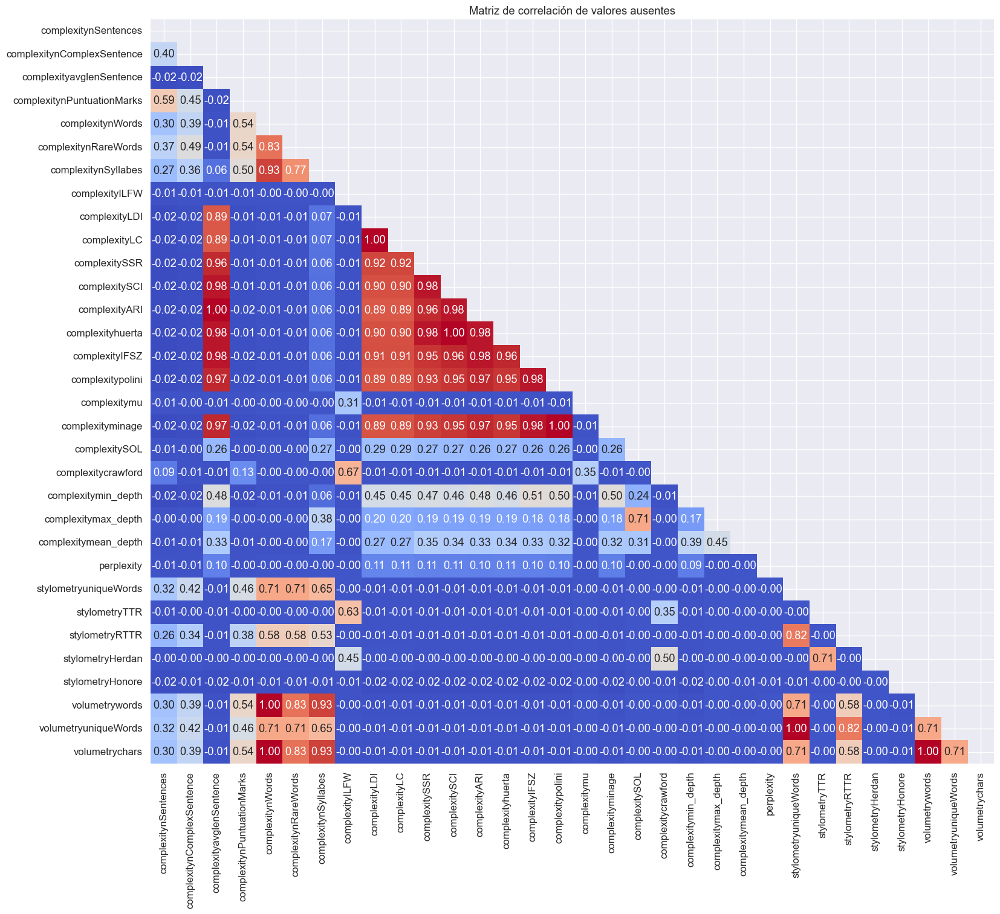

In [131]:
def patron_perdidos_custom(datos_input):
    """
    Visualiza un mapa de calor que muestra la matriz de correlación de valores ausentes en el conjunto de datos.

    Args:
        datos_input (DataFrame): El conjunto de datos de entrada.

    """
    # Correlation matrix calculation
    correlation_matrix = datos_input[datos_input.columns[datos_input.isna().sum() > 0]].isna().corr()
    
    # Creating mask in order to avoid symmetry
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
    
    plt.figure(figsize=(18, 16))
    sns.set(font_scale=1.1)
    
    # Heatmap
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", cbar=False, mask=mask)
    
    plt.title("Matriz de correlación de valores ausentes")
    plt.show()

patron_perdidos_custom(df)

In [132]:
# Total of missing values per variable
df[var_input].isna().sum()

complexitynSentences          29
complexitynComplexSentence    17
complexityavglenSentence      28
complexitynPuntuationMarks    14
complexitynWords               6
complexitynRareWords           6
complexitynSyllabes            7
complexitynChar                0
complexityILFW                 5
complexityLDI                 24
complexityLC                  24
complexitySSR                 26
complexitySCI                 27
complexityARI                 28
complexityhuerta              27
complexityIFSZ                29
complexitypolini              30
complexitymu                   2
complexityminage              30
complexitySOL                  2
complexitycrawford             4
complexitymin_depth           33
complexitymax_depth            1
complexitymean_depth           5
emotionothers                  0
emotionjoy                     0
emotionsadness                 0
emotionanger                   0
emotionsurprise                0
emotiondisgust                 0
emotionfea

In [133]:
# Proportion of missing values per feature
prop_missingsVars = df.isna().sum()/len(df)

In [134]:
prop_missingsVars.sort_values(ascending=False)

complexitymin_depth           0.024756
complexityminage              0.022506
complexitypolini              0.022506
complexityIFSZ                0.021755
complexitynSentences          0.021755
complexityARI                 0.021005
complexityavglenSentence      0.021005
complexitySCI                 0.020255
complexityhuerta              0.020255
complexitySSR                 0.019505
complexityLDI                 0.018005
complexityLC                  0.018005
stylometryHonore              0.013503
complexitynComplexSentence    0.012753
complexitynPuntuationMarks    0.010503
complexitynSyllabes           0.005251
volumetrychars                0.004501
complexitynWords              0.004501
volumetrywords                0.004501
complexitynRareWords          0.004501
complexityILFW                0.003751
complexitymean_depth          0.003751
complexitycrawford            0.003001
volumetryuniqueWords          0.002251
perplexity                    0.002251
stylometryuniqueWords    

### Imputaciones

Imputamos los valores nulos del conjunto de datos

In [135]:
vars = list(numeric_input)
old = df[['complexityIFSZ']]
imputer = KNNImputer(n_neighbors=5, metric='nan_euclidean')
imputer.fit(df[vars])
df[vars] = imputer.transform(df[vars])
new = df[['complexityIFSZ']]

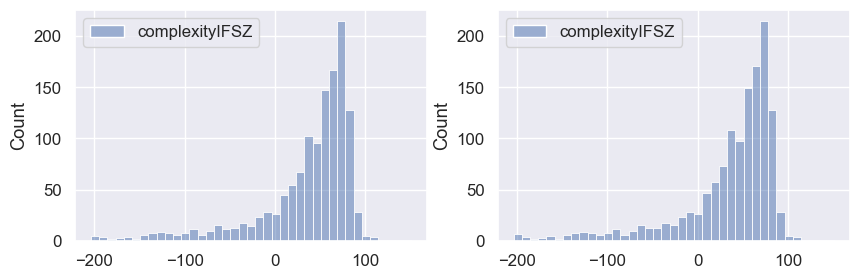

In [34]:
plt.figure(figsize=(10,3))
plt.subplot(1,2,1)
sns.histplot(old)
plt.subplot(1,2,2)
sns.histplot(new)
plt.show()

### Analisis de normalidad y contrastes estadísticos

In [113]:
numeric = list(numeric_input)

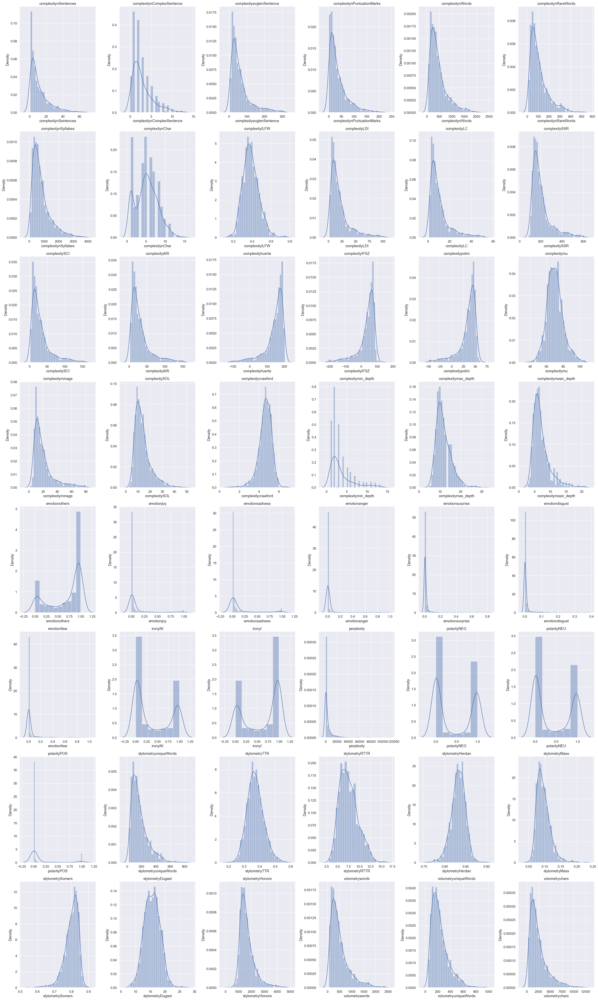

In [114]:
def show_distplots(df):
  ncols = 6
  nrows = int(len(numeric)/ncols)

  fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(30, 50), sharey=False)
  for i, target in enumerate(numeric):
    ax = axs[int(i/ncols), i % ncols]
    _ = sns.distplot(df[target],ax=ax)
    ax.set_title(target)
  plt.tight_layout()
  plt.show()

show_distplots(df)

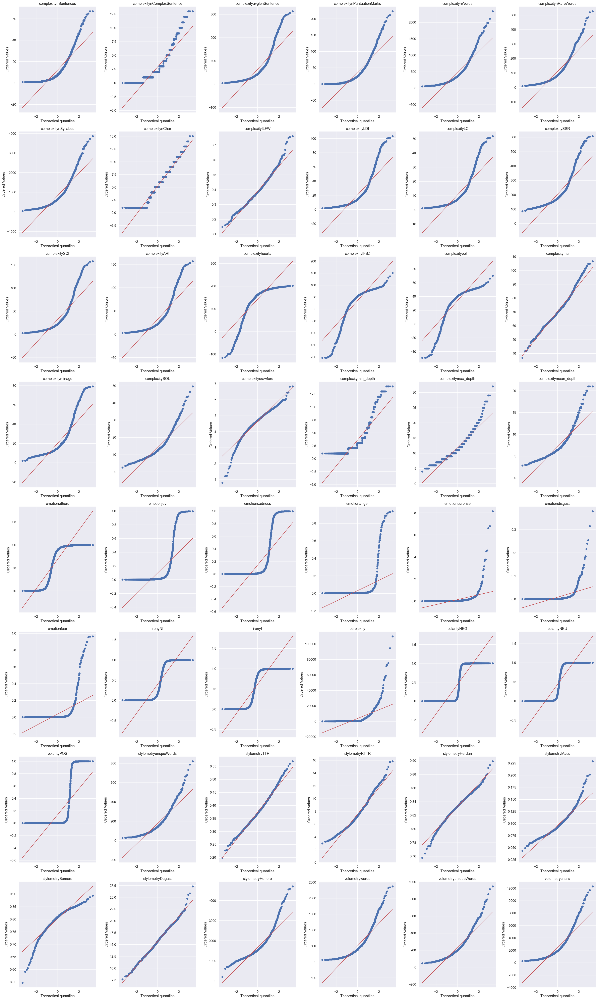

In [115]:
def show_probplots(df):
  ncols = 6
  nrows = int(len(numeric)/ncols)

  fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(30, 50), sharey=False)
  for i, target in enumerate(numeric):
    ax = axs[int(i/ncols), i % ncols]
    stats.probplot(df[target], dist="norm", plot=ax)
    ax.set_title(target)
  plt.tight_layout()
  plt.show()
show_probplots(df)

Así presentadas, no parece que estas distribuciones sigan una curva normal. Existen algunas métricas de estilometría que se acercan.

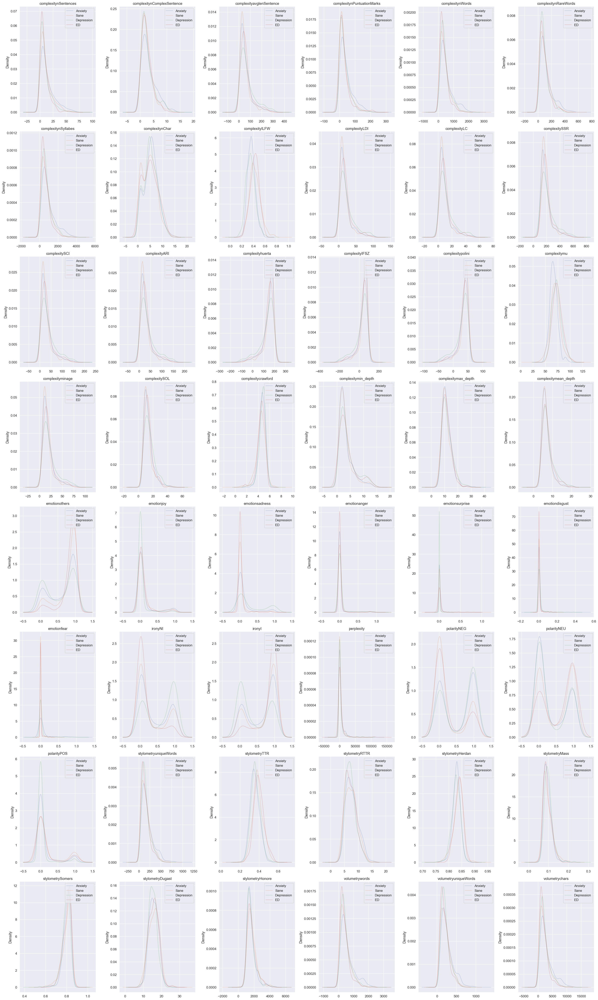

In [116]:
def show_kde(df, group):
  ncols = 6
  nrows = math.ceil(len(numeric)/ncols)
  group_unique_values = list(df[group].unique())

  fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(30, 50), sharey=False)
  for i, c in enumerate(numeric):
    ax = axs[int(i/ncols), i % ncols]
    for value in group_unique_values:
        try:
          df[df[group] == value][c].plot.kde(alpha=1.0/len(group_unique_values), label=value, ax=ax)
        except LA.LinAlgError:
          pass
    ax.set_title(c)
    ax.legend(loc='upper right')
  plt.tight_layout()
  plt.show()
    
df_l = pd.concat([labels, df], axis = 1)
df_l['label'] = df_l['label'].replace({0: 'Sane', 1: 'Anxiety', 2: 'Depression', 3: 'ED'})
show_kde(df_l, 'label')

In [118]:
# Use of normality tests over data
df = pd.concat([labels, df], axis = 1)
df['label'] = df['label'].replace({0: 'Sane', 1: 'Anxiety', 2: 'Depression', 3: 'ED'})
test = df[numeric].apply(lambda x: shapiro(x) + normaltest(x) + kstest(x, 'norm'), axis=0)
test.index = ['Shapiro stat', 'Shapiro p-value', "D'Agostino stat", "D'Agostino p-value", "KS stat", "KS p-value"]
test = test.transpose()
test

,Shapiro stat,Shapiro p-value,D'Agostino stat,D'Agostino p-value,KS stat,KS p-value
complexitynSentences,0.802749,1.789536e-37,455.583386,1.178486e-99,0.902231,0.000000e+00
complexitynComplexSentence,0.861716,1.081945e-32,313.161964,9.948178e-69,0.751322,0.000000e+00
complexityavglenSentence,0.779927,5.128102e-39,509.802413,1.985238e-111,0.999998,0.000000e+00
complexitynPuntuationMarks,0.813579,1.085875e-36,469.683945,1.021944e-102,0.934884,0.000000e+00
complexitynWords,0.840322,1.376634e-34,429.301465,6.003042e-94,1.000000,0.000000e+00
complexitynRareWords,0.845036,3.453449e-34,414.257794,1.109335e-90,1.000000,0.000000e+00
complexitynSyllabes,0.841517,1.734354e-34,429.312016,5.971456e-94,1.000000,0.000000e+00
complexitynChar,0.956328,1.590955e-19,25.917152,2.355928e-06,0.841345,0.000000e+00
complexityILFW,0.982212,9.580842e-12,86.679920,1.505548e-19,0.579572,0.000000e+00
complexityLDI,0.775270,2.577097e-39,531.597310,3.673760e-116,0.989199,0.000000e+00


In [119]:
for t in ['Shapiro', "D'Agostino", 'KS']:
  print("Superan el test de "+t)
  print(list(test[test[t+' p-value'] > 0.05].index))

Superan el test de Shapiro
[]
Superan el test de D'Agostino
['stylometryDugast']
Superan el test de KS
[]


In [120]:
gasussian_cols = ['stylometryDugast']

In [121]:
# Application of normality tests per disorder
for s in ['Sane', 'Anxiety', 'Depression', 'ED']:
  print(s, '---------------')
  test = df[df['label'] == s][numeric].apply(lambda x: shapiro(x) + normaltest(x) + kstest(x, 'norm'), axis=0)
  test.index = ['Shapiro stat', 'Shapiro p-value', "D'Agostino stat", "D'Agostino p-value", "KS stat", "KS p-value"]
  test = test.transpose()
  for t in ['Shapiro', "D'Agostino", 'KS']:
    print("Superan el test de "+t)
    print(list(test[test[t+' p-value'] > 0.05].index))

Sane ---------------
Superan el test de Shapiro
[]
Superan el test de D'Agostino
['stylometryTTR', 'stylometryDugast']
Superan el test de KS
[]
Anxiety ---------------
Superan el test de Shapiro
['stylometryDugast']
Superan el test de D'Agostino
['complexitynChar', 'stylometryDugast']
Superan el test de KS
[]
Depression ---------------
Superan el test de Shapiro
['stylometryTTR', 'stylometryDugast']
Superan el test de D'Agostino
['stylometryDugast']
Superan el test de KS
[]
ED ---------------
Superan el test de Shapiro
['complexityILFW', 'complexitymu', 'stylometryTTR', 'stylometryHerdan', 'stylometryDugast']
Superan el test de D'Agostino
['complexityILFW', 'complexitymu', 'stylometryTTR', 'stylometryHerdan', 'stylometryDugast']
Superan el test de KS
[]


In [122]:
normal_features_sane = []

In [123]:
shapiro = ['stylometryDugast']
dagostino = ['complexitynChar', 'stylometryDugast']

normal_features_anx = list(set(shapiro).intersection(set(dagostino)))
normal_features_anx

['stylometryDugast']

In [124]:
shapiro = ['stylometryTTR', 'stylometryDugast']
dagostino = ['stylometryDugast']

normal_features_dep = list(set(shapiro).intersection(set(dagostino)))
normal_features_dep

['stylometryDugast']

In [125]:
shapiro = ['complexityILFW', 'complexitymu', 'stylometryTTR', 'stylometryHerdan', 'stylometryDugast']
dagostino = ['complexityILFW', 'complexitymu', 'stylometryTTR', 'stylometryHerdan', 'stylometryDugast']

normal_features_ed = list(set(shapiro).intersection(set(dagostino)))
normal_features_ed

['complexityILFW',
 'stylometryHerdan',
 'complexitymu',
 'stylometryTTR',
 'stylometryDugast']

In [127]:
normal_features = {
    'sane': normal_features_sane,
    'anxiety': normal_features_anx,
    'depression': normal_features_dep,
    'eating_disorders': normal_features_ed
}

no_normal_features = {
    'sane': list(set(numeric).difference(set(normal_features_sane))),
    'anxiety': list(set(numeric).difference(set(normal_features_anx))),
    'depression': list(set(numeric).difference(set(normal_features_dep))),
    'eating_disorders': list(set(numeric).difference(set(normal_features_ed)))
}

In [128]:
# Number of variables that pass Shapiro and D'Agostino tests per disorder
for k in normal_features:
  print(k, 'tiene', len(normal_features[k]), 'características que superan los tests de normalidad')
print()
for k in no_normal_features:
  print(k, 'tiene', len(no_normal_features[k]), 'características que NO superan los tests de normalidad')

sane tiene 0 características que superan los tests de normalidad
anxiety tiene 1 características que superan los tests de normalidad
depression tiene 1 características que superan los tests de normalidad
eating_disorders tiene 5 características que superan los tests de normalidad

sane tiene 48 características que NO superan los tests de normalidad
anxiety tiene 47 características que NO superan los tests de normalidad
depression tiene 47 características que NO superan los tests de normalidad
eating_disorders tiene 43 características que NO superan los tests de normalidad


In [129]:
df = pd.concat([subjects, df], axis = 1)

In [130]:
df.groupby(by = ['label'])[['subject']].count()

,subject
label,
Anxiety,443
Depression,333
ED,143
Sane,414


In [131]:
categories = {'label': ['Sane', 'Anxiety', 'Depression', 'ED']}

In [144]:
counts_tbl = []
for feature in numeric:
  for ci in range(len(categories['label'])):
    for cj in range(ci+1, len(categories['label'])):          
      dist_i = df[(df['label'] == categories['label'][ci])]
      dist_j = df[(df['label'] == categories['label'][cj])]
      counts_tbl.append([feature, categories['label'][ci], categories['label'][cj], len(dist_i), len(dist_j)])
pd.DataFrame(counts_tbl, columns=['feature', 'label_1', 'label_2', 'len_1', 'len_2'])

,feature,label_1,label_2,len_1,len_2
0,complexitynSentences,Sane,Anxiety,414,443
1,complexitynSentences,Sane,Depression,414,333
2,complexitynSentences,Sane,ED,414,143
3,complexitynSentences,Anxiety,Depression,443,333
4,complexitynSentences,Anxiety,ED,443,143
...,...,...,...,...,...
283,volumetrychars,Sane,Depression,414,333
284,volumetrychars,Sane,ED,414,143
285,volumetrychars,Anxiety,Depression,443,333
286,volumetrychars,Anxiety,ED,443,143


In [148]:
# Criteria contrasts per disorder

alpha = 0.05
noparam_df = []
for feature in numeric:
    for ci in range(len(categories['label'])):
        for cj in range(ci+1, len(categories['label'])):
            dist_i = df[(df['label'] == categories['label'][ci])][feature]
            dist_j = df[(df['label'] == categories['label'][cj])][feature]
            id_i = df[(df['label'] == categories['label'][ci])]['subject']
            id_j = df[(df['label'] == categories['label'][cj])]['subject']
            max_len = min(len(dist_i), len(dist_j))

            if (max_len == 0):
              p_m, p_w, p_k = np.NaN, np.NaN, np.NaN
            else:
              dist_i = dist_i[:max_len].to_numpy()
              dist_j = dist_j[:max_len].to_numpy()

              # ignore series of values that are equal
              if (abs(dist_i - dist_j).sum() == 0):
                p_m, p_w, p_k = np.NaN, np.NaN, np.NaN
              else:

                # ignore nan values
                mask = (~ np.isnan(dist_i)) & (~ np.isnan(dist_j))
                dist_i = dist_i[mask]
                dist_j = dist_j[mask]

                if (len(dist_i) == 0):
                  p_m, p_w, p_k = np.NaN, np.NaN, np.NaN
                else:
                  _, p_m = mannwhitneyu(dist_i, dist_j)
                  _, p_w = wilcoxon(dist_i, dist_j)
                  _, p_k = kruskal(dist_i, dist_j)

                  if p_m < 0.05:
                    print("-------------------------")
                    print(feature, categories['label'][ci], categories['label'][cj], p_m, id_i, id_j)
                    for k in range(len(dist_i)):
                      print(dist_i[k], dist_j[k])

            noparam_df.append([feature, categories['label'][ci], categories['label'][cj],
                              p_m, p_w, p_k, len(dist_i)])

noparam_df = pd.DataFrame(noparam_df, columns=['feature', 'label_1', 'label_2', 'mannwhitneyu', 'wilcoxon', 'kruskal', 'size'])
noparam_df.to_excel('contrastes.xlsx')
noparam_df

-------------------------
complexitynSentences Sane Anxiety 0.026851592506560617 1        subject10_anx
6       subject104_anx
7       subject105_anx
9       subject107_anx
11      subject109_anx
             ...      
1258     subject333_ed
1291      subject61_ed
1294      subject64_ed
1296      subject66_ed
1315      subject83_ed
Name: subject, Length: 414, dtype: object 0        subject1_anx
2      subject100_anx
3      subject101_anx
4      subject102_anx
5      subject103_anx
            ...      
494     subject94_anx
495     subject95_anx
496     subject96_anx
498     subject98_anx
499     subject99_anx
Name: subject, Length: 443, dtype: object
15.0 53.0
13.0 17.0
18.0 15.0
6.0 22.8
12.0 34.0
3.0 15.0
4.0 40.0
8.0 2.0
4.0 16.0
16.0 22.0
6.0 6.0
26.0 7.0
1.0 4.0
4.0 11.0
7.0 36.0
5.0 8.0
1.0 4.0
9.0 12.0
19.0 2.0
14.0 14.0
2.0 20.0
8.0 23.0
37.0 14.0
1.0 6.0
32.0 2.0
4.0 6.0
6.0 5.0
22.8 33.0
25.0 21.0
28.0 26.0
6.0 10.0
8.0 2.0
17.0 18.0
1.0 7.0
1.0 4.0
3.0 22.0
4.0 3.0
8.0 2.0


,feature,label_1,label_2,mannwhitneyu,wilcoxon,kruskal,size
0,complexitynSentences,Sane,Anxiety,2.685159e-02,7.978670e-03,2.684158e-02,414
1,complexitynSentences,Sane,Depression,1.830348e-02,5.208223e-02,1.829353e-02,333
2,complexitynSentences,Sane,ED,1.223026e-03,3.395580e-04,1.219962e-03,143
3,complexitynSentences,Anxiety,Depression,5.551737e-07,5.728291e-08,5.545925e-07,333
4,complexitynSentences,Anxiety,ED,2.182463e-06,1.115777e-06,2.174768e-06,143
...,...,...,...,...,...,...,...
283,volumetrychars,Sane,Depression,8.026754e-02,2.355436e-01,8.023274e-02,333
284,volumetrychars,Sane,ED,6.183367e-02,8.930391e-03,6.173399e-02,143
285,volumetrychars,Anxiety,Depression,2.720179e-05,3.028695e-06,2.717762e-05,333
286,volumetrychars,Anxiety,ED,6.754080e-09,5.612096e-09,6.725357e-09,143


### Normalización de variables

In [143]:
numerical = df.select_dtypes(include=['int', 'int32', 'int64','float', 'float32', 'float64']).columns

categorical = [variable for variable in variables if variable not in numericas]

preprocessor = make_column_transformer(
    (MinMaxScaler(), numerical), # Scale numeric variables
    (OneHotEncoder(), categorical) # Create dummy variables for categorical features
)

transformed_data = preprocessor.fit_transform(df)

transformed_df = pd.DataFrame(transformed_data, columns=preprocessor.get_feature_names_out(input_features=df.columns))

# Eliminating suffix from variable names
transformed_df.rename(columns={col: col.replace('minmaxscaler__', '') for col in transformed_df.columns}, inplace=True)
transformed_df.rename(columns={col: col.replace('onehotencoder__', '') for col in transformed_df.columns}, inplace=True)

In [145]:
transformed_df

,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,complexitynChar,complexityILFW,complexityLDI,...,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen_Long,volumetryavgWordsLen_Medium,volumetryavgWordsLen_Short
0,0.787879,0.923077,0.068141,0.627803,0.571053,0.568665,0.626999,0.285714,0.353628,0.049370,...,0.203655,0.826672,0.533932,0.233853,0.620720,0.529867,0.594801,0.0,1.0,0.0
1,0.212121,0.000000,0.002200,0.080717,0.010526,0.042553,0.017038,0.428571,0.327927,0.002797,...,0.282821,0.670966,0.331168,0.277732,0.014304,0.024336,0.011461,0.0,0.0,1.0
2,0.242424,0.230769,0.058554,0.228700,0.144737,0.145068,0.162779,0.500000,0.353539,0.056810,...,0.251937,0.769788,0.423345,0.425390,0.161248,0.200221,0.155220,0.0,1.0,0.0
3,0.212121,0.384615,0.252082,0.295964,0.517544,0.506770,0.541547,0.285714,0.354391,0.218693,...,0.143622,0.878626,0.631016,0.257642,0.536194,0.524336,0.505606,0.0,1.0,0.0
4,0.330303,0.384615,0.019441,0.699552,0.500439,0.543520,0.587418,0.500000,0.329991,0.018787,...,0.123615,0.897104,0.674147,0.331683,0.558301,0.557522,0.549539,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,0.030303,0.153846,0.244516,0.022422,0.081140,0.129594,0.099345,0.357143,0.525113,0.246339,...,0.287784,0.721692,0.361787,0.129570,0.078457,0.101770,0.079478,0.0,1.0,0.0
1329,0.060606,0.307692,0.222468,0.174888,0.136404,0.160542,0.162779,0.357143,0.284582,0.227909,...,0.244516,0.774768,0.429750,0.219051,0.147811,0.176991,0.142015,0.0,1.0,0.0
1330,0.030303,0.153846,0.079153,0.017937,0.014035,0.034816,0.033814,0.428571,0.457936,0.108113,...,0.273947,0.674092,0.338153,0.382508,0.011704,0.028761,0.018686,0.0,1.0,0.0
1331,0.257576,0.230769,0.056276,0.147982,0.149123,0.193424,0.171166,0.428571,0.564482,0.058198,...,0.148689,0.863149,0.578440,0.447488,0.157781,0.212389,0.150984,0.0,1.0,0.0


In [146]:
df_final = pd.concat([subjects, messages, labels, transformed_df], axis = 1)
df_final

,subject,message,label,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,...,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen_Long,volumetryavgWordsLen_Medium,volumetryavgWordsLen_Short
0,subject1_anx,buenos días a tod @s ! ! no sé si esta será la...,1,0.787879,0.923077,0.068141,0.627803,0.571053,0.568665,0.626999,...,0.203655,0.826672,0.533932,0.233853,0.620720,0.529867,0.594801,0.0,1.0,0.0
1,subject10_anx,ola soi nuebo como estn ? a ustds los entimdm ...,0,0.212121,0.000000,0.002200,0.080717,0.010526,0.042553,0.017038,...,0.282821,0.670966,0.331168,0.277732,0.014304,0.024336,0.011461,0.0,0.0,1.0
2,subject100_anx,de donde son .. yo de perú supongo q tb sigue ...,1,0.242424,0.230769,0.058554,0.228700,0.144737,0.145068,0.162779,...,0.251937,0.769788,0.423345,0.425390,0.161248,0.200221,0.155220,0.0,1.0,0.0
3,subject101_anx,es lo que necesitas ? aaah pues perdón por no ...,1,0.212121,0.384615,0.252082,0.295964,0.517544,0.506770,0.541547,...,0.143622,0.878626,0.631016,0.257642,0.536194,0.524336,0.505606,0.0,1.0,0.0
4,subject102_anx,ya perdí una xd siete seguidas no está mal . e...,1,0.330303,0.384615,0.019441,0.699552,0.500439,0.543520,0.587418,...,0.123615,0.897104,0.674147,0.331683,0.558301,0.557522,0.549539,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,subject95_ed,cuantoa kilos sr puede bajar vomitando ? ya vo...,3,0.030303,0.153846,0.244516,0.022422,0.081140,0.129594,0.099345,...,0.287784,0.721692,0.361787,0.129570,0.078457,0.101770,0.079478,0.0,1.0,0.0
1329,subject96_ed,"holis grupo , porfis necesito perder 15 kilos ...",3,0.060606,0.307692,0.222468,0.174888,0.136404,0.160542,0.162779,...,0.244516,0.774768,0.429750,0.219051,0.147811,0.176991,0.142015,0.0,1.0,0.0
1330,subject97_ed,quiero volver a bajar me pasan licuados detox ...,3,0.030303,0.153846,0.079153,0.017937,0.014035,0.034816,0.033814,...,0.273947,0.674092,0.338153,0.382508,0.011704,0.028761,0.018686,0.0,1.0,0.0
1331,subject98_ed,hola . vengo de una dieta cetogenica xon la qu...,3,0.257576,0.230769,0.056276,0.147982,0.149123,0.193424,0.171166,...,0.148689,0.863149,0.578440,0.447488,0.157781,0.212389,0.150984,0.0,1.0,0.0


In [147]:
df_final.to_csv('df_inputed.csv', encoding='utf-8')

### Selección de variables y correlación entre ellas

Primero normalizamos para poder comparar variables.

In [32]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)

In [33]:
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)

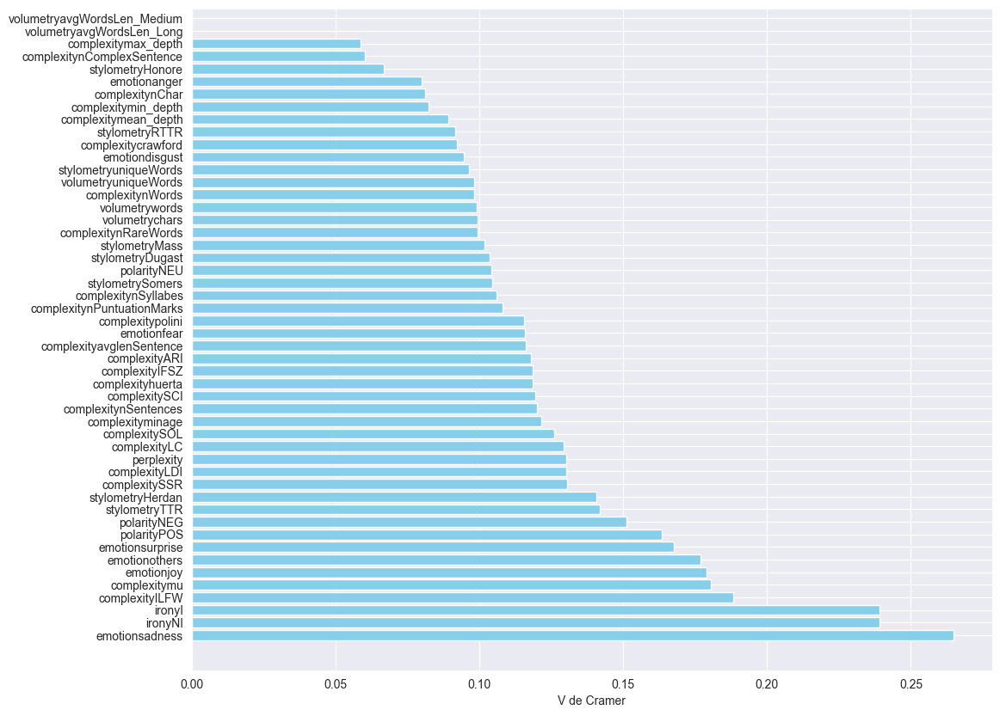

In [34]:
obj = df['label']
df.drop(['label'], axis = 1, inplace = True)
# Printing Cramer's V in order to check features level of relation with objective variable
graficoVcramer(df, obj)

In [35]:
# Cramer graph in DF format

variables = list(df.columns)
VCramer = pd.DataFrame(columns=['Variable', 'Objetivo', 'Vcramer'])

frames = []
for variable in variables:
  v_cramer = Vcramer(df[variable], obj)
  frame = pd.DataFrame({'Variable': [variable], 'Vcramer': [v_cramer]})
  frames.append(frame)
VCramer = pd.concat(frames, ignore_index=True)
VCramer.sort_values(by='Vcramer', ascending=False, inplace=True)
VCramer.reset_index(inplace=True, drop=True)
VCramer

,Variable,Vcramer
0,emotionsadness,0.264945
1,ironyI,0.239096
2,ironyNI,0.239096
3,complexityILFW,0.188306
4,complexitymu,0.180579
5,emotionjoy,0.178830
6,emotionothers,0.176795
7,emotionsurprise,0.167689
8,polarityPOS,0.163358
9,polarityNEG,0.151117


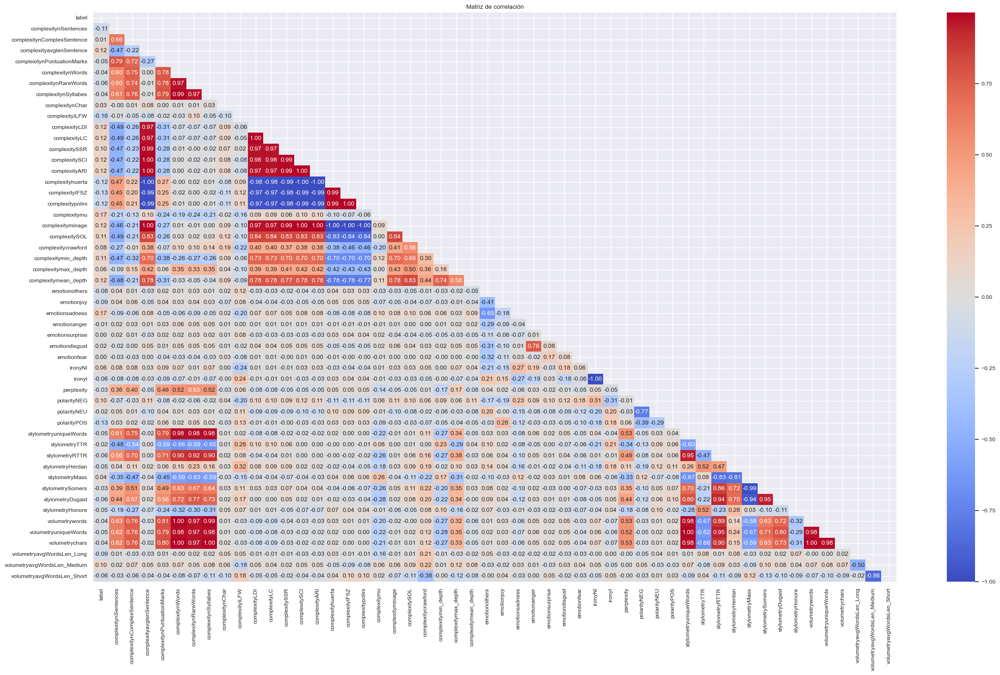

In [36]:
# Variable correlation graphic
numericas = df.select_dtypes(include=['int', 'float']).columns
# Calcular la matriz de correlación de Pearson entre la variable objetivo continua ('varObjCont') y las variables numéricas
matriz_corr = pd.concat([obj, df[numericas]], axis = 1).corr(method = 'pearson')
# Creating mask in order to avoid symmetry
mask = np.triu(np.ones_like(matriz_corr, dtype=bool))

plt.figure(figsize=(28, 16))
sns.set(font_scale=0.8)

# Heatmap
sns.heatmap(matriz_corr, annot=True, cmap='coolwarm', fmt=".2f", cbar=True, mask=mask)
plt.title("Matriz de correlación")
plt.show()

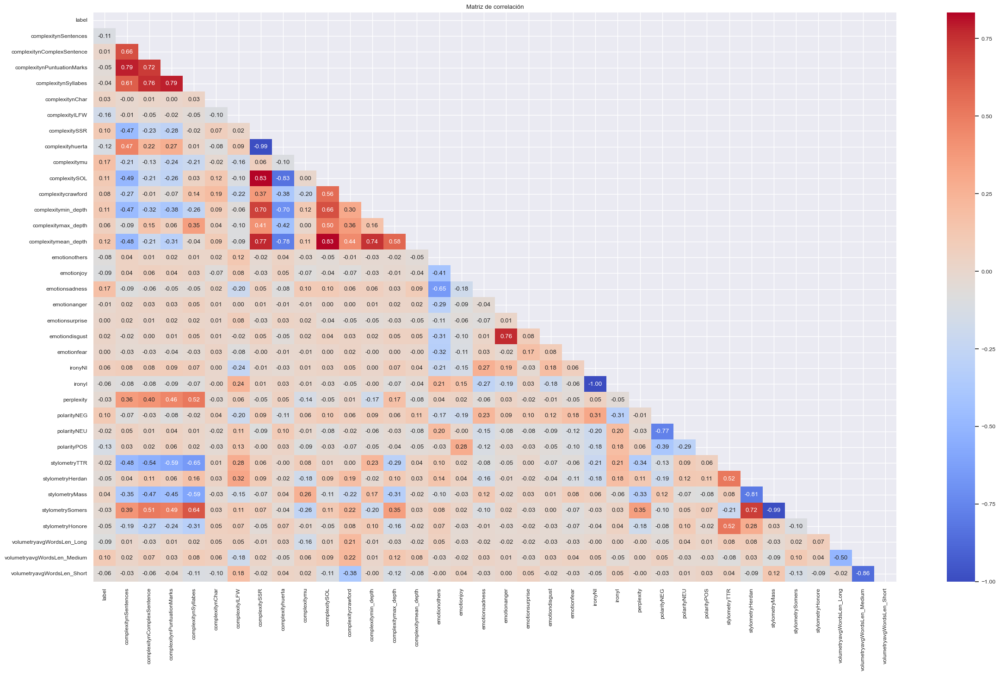

In [37]:
# Variable correlation graphic

df_corr = df.drop(['complexityavglenSentence', 'complexitynWords', 'complexitynRareWords', 'volumetrychars',
                  'stylometryuniqueWords', 'volumetryuniqueWords', 'volumetrywords', 'complexityARI', 'complexitySCI',
                  'complexityLC', 'complexityLDI', 'complexitypolini', 'complexityIFSZ', 'complexityminage',
                  'stylometryDugast', 'stylometryRTTR'], axis=1)

# Variable correlation
numericas = df_corr.select_dtypes(include=['int', 'float']).columns
# Calcular la matriz de correlación de Pearson entre la variable objetivo continua ('varObjCont') y las variables numéricas
matriz_corr = pd.concat([obj, df_corr[numericas]], axis = 1).corr(method = 'pearson')
# Creating mask in order to avoid symmetry
mask = np.triu(np.ones_like(matriz_corr, dtype=bool))

plt.figure(figsize=(28, 16))
sns.set(font_scale=0.8)

# Heatmap
sns.heatmap(matriz_corr, annot=True, cmap='coolwarm', fmt=".2f", cbar=True, mask=mask)
plt.title("Matriz de correlación")
plt.show()

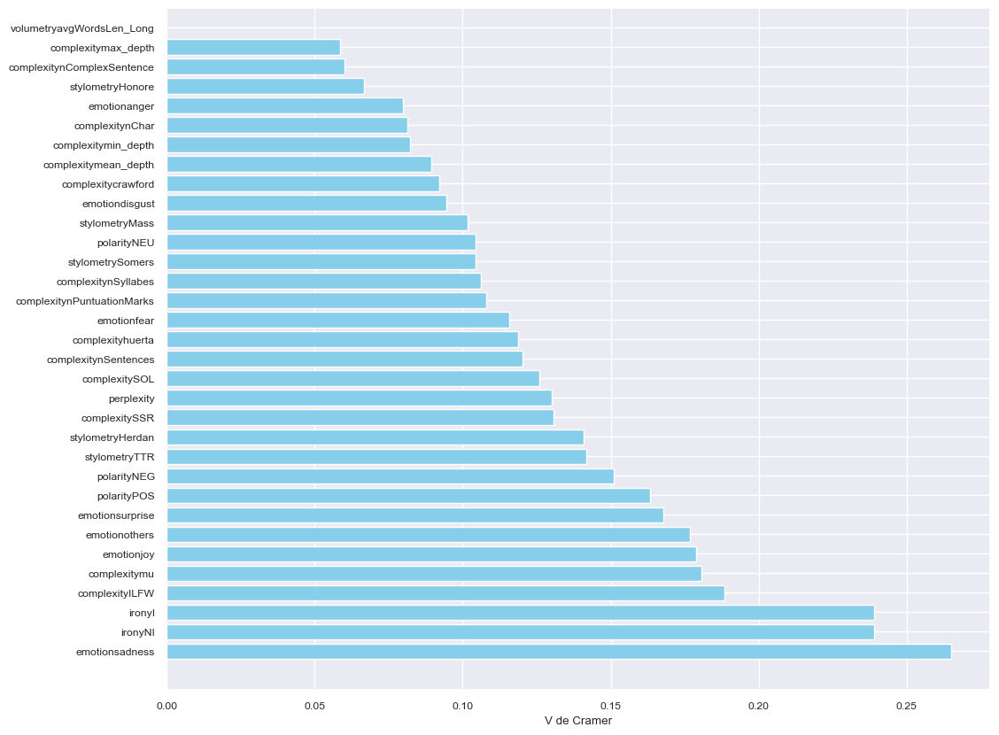

In [38]:
graficoVcramer(df_corr, obj)

In [39]:
# Hay que ver donde poner el corte
variables = list(df_corr.columns)
VCramer = pd.DataFrame(columns=['Variable', 'Objetivo', 'Vcramer'])

frames = []
for variable in variables:
  v_cramer = Vcramer(df_corr[variable], obj)
  frame = pd.DataFrame({'Variable': [variable], 'Vcramer': [v_cramer]})
  frames.append(frame)
VCramer = pd.concat(frames, ignore_index=True)
VCramer.sort_values(by='Vcramer', ascending=False, inplace=True)
VCramer.reset_index(inplace=True, drop=True)
VCramer

,Variable,Vcramer
0,emotionsadness,0.264945
1,ironyI,0.239096
2,ironyNI,0.239096
3,complexityILFW,0.188306
4,complexitymu,0.180579
5,emotionjoy,0.178830
6,emotionothers,0.176795
7,emotionsurprise,0.167689
8,polarityPOS,0.163358
9,polarityNEG,0.151117


#### Otros métodos

In [40]:
#df_corr = pd.concat([users, messages, df_corr], axis = 1)
df_corr

,complexitynSentences,complexitynComplexSentence,complexitynPuntuationMarks,complexitynSyllabes,complexitynChar,complexityILFW,complexitySSR,complexityhuerta,complexitymu,complexitySOL,...,polarityNEU,polarityPOS,stylometryTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryHonore,volumetryavgWordsLen_Long,volumetryavgWordsLen_Medium,volumetryavgWordsLen_Short
0,0.787879,0.923077,0.627803,0.626999,0.285714,0.353628,0.100670,0.932255,0.325699,0.158673,...,0.991208,0.004576,0.213160,0.475023,0.203655,0.826672,0.233853,0.0,1.0,0.0
1,0.212121,0.000000,0.080717,0.017038,0.428571,0.327927,0.145533,0.998648,0.574638,0.000000,...,0.970331,0.001788,0.882736,0.720219,0.282821,0.670966,0.277732,0.0,0.0,1.0
2,0.242424,0.230769,0.228700,0.162779,0.500000,0.353539,0.088297,0.941923,0.419641,0.129042,...,0.386508,0.608219,0.449715,0.543086,0.251937,0.769788,0.425390,0.0,1.0,0.0
3,0.212121,0.384615,0.295964,0.541547,0.285714,0.354391,0.273285,0.749667,0.362029,0.300326,...,0.024205,0.031947,0.349640,0.615286,0.143622,0.878626,0.257642,0.0,1.0,0.0
4,0.330303,0.384615,0.699552,0.587418,0.500000,0.329991,0.066530,0.980423,0.326612,0.094140,...,0.997969,0.001313,0.380099,0.654325,0.123615,0.897104,0.331683,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,0.030303,0.153846,0.022422,0.099345,0.357143,0.525113,0.327962,0.757107,0.763433,0.301822,...,0.977171,0.002676,0.567391,0.566109,0.287784,0.721692,0.129570,0.0,1.0,0.0
1329,0.060606,0.307692,0.174888,0.162779,0.357143,0.284582,0.265421,0.778899,0.636075,0.297313,...,0.002137,0.998041,0.480021,0.565364,0.244516,0.774768,0.219051,0.0,1.0,0.0
1330,0.030303,0.153846,0.017937,0.033814,0.428571,0.457936,0.166553,0.921030,0.472312,0.191481,...,0.693878,0.001384,0.916974,0.743542,0.273947,0.674092,0.382508,0.0,1.0,0.0
1331,0.257576,0.230769,0.147982,0.171166,0.428571,0.564482,0.122891,0.944115,0.474353,0.131080,...,0.973743,0.001069,0.630359,0.735072,0.148689,0.863149,0.447488,0.0,1.0,0.0


In [41]:
features = df_corr
X, y = features, obj

test = SelectKBest(score_func=chi2, k=10)
results = test.fit(X, y)

In [42]:
pd.DataFrame(zip(X.columns, results.pvalues_), columns=["feature", "pvalue"]).sort_values("pvalue", ascending=True)

,feature,pvalue
16,emotionsadness,2.161664e-24
24,polarityNEG,2.802948e-13
21,ironyNI,1.386054e-12
22,ironyI,3.446696e-08
26,polarityPOS,9.664664e-08
20,emotionfear,3.330040e-07
25,polarityNEU,8.548966e-06
34,volumetryavgWordsLen_Short,8.215811e-05
14,emotionothers,1.730559e-04
32,volumetryavgWordsLen_Long,1.493505e-03


In [43]:
X_new = test.transform(X)
X_new.shape

(1333, 10)

In [44]:
""" Feature importances """
model = ExtraTreesClassifier(random_state=1)
model.fit(X, y)

ExtraTreesClassifier(random_state=1)

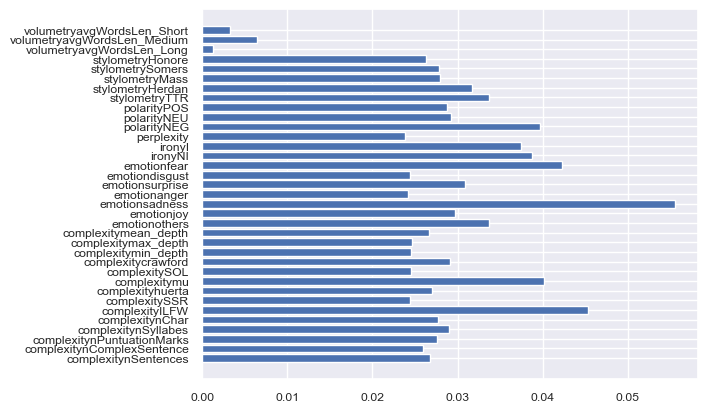

In [45]:
plt.barh(y=X.columns, width=model.feature_importances_)
plt.show()

In [46]:
""" RFE """
model = LogisticRegression()
rfe = RFE(estimator=model, n_features_to_select=20)
results = rfe.fit(X, y)

In [47]:
results.ranking_
X.columns[results.support_]

Index(['complexitynSentences', 'complexitynComplexSentence',
       'complexitynPuntuationMarks', 'complexitynSyllabes', 'complexityILFW',
       'complexityhuerta', 'complexitymu', 'complexitycrawford',
       'complexitymax_depth', 'emotionsadness', 'emotionsurprise',
       'emotiondisgust', 'emotionfear', 'ironyNI', 'polarityNEG',
       'stylometryTTR', 'stylometryHerdan', 'stylometryHonore',
       'volumetryavgWordsLen_Long', 'volumetryavgWordsLen_Medium'],
      dtype='object')

In [48]:
# Hacer un set de cada una de las tecnicas y sacar las 10/15 mejores variables
cramer = ['emotionsadness', 'ironyI', 'ironyNI', 'complexityILFW', 'complexitymu', 'emotionjoy', 'emotionothers', 'emotionsurprise',
          'polarityPOS', 'polarityNEG',	'stylometryTTR', 'stylometryHerdan', 'complexitySSR', 'perplexity',	'complexitySOL', 
          'complexitynSentences', 'complexityhuerta', 'emotionfear', 'complexitynPuntuationMarks', 'complexitynSyllabes',
          'stylometrySomers', 'polarityNEU', 'stylometryMass']

chi = ['emotionsadness', 'polarityNEG', 'ironyNI', 'ironyI', 'polarityPOS', 'emotionfear', 'polarityNEU', 'volumetryavgWordsLen_Short',
       'emotionothers', 'volumetryavgWordsLen_Long', 'emotionjoy', 'complexityILFW', 'complexitynSentences']

rfe = ['complexitynSentences', 'complexitynComplexSentence',
       'complexitynPuntuationMarks', 'complexitynSyllabes', 'complexityILFW',
       'complexityhuerta', 'complexitymu', 'complexitycrawford',
       'complexitymax_depth', 'emotionsadness', 'emotionsurprise',
       'emotiondisgust', 'emotionfear', 'ironyNI', 'polarityNEG',
       'stylometryTTR', 'stylometryHerdan', 'stylometryHonore',
       'volumetryavgWordsLen_Long', 'volumetryavgWordsLen_Medium']

print(len(cramer))
print(len(chi))
print(len(rfe))

imp_cramer_rfe = list(set(rfe).intersection(set(cramer)))
imp_2 = list(set(imp_cramer_rfe).intersection(set(chi)))
print(imp_cramer_rfe)
print("*"*20)
print(imp_2)

23
13
20
['emotionsadness', 'emotionfear', 'polarityNEG', 'complexityILFW', 'complexityhuerta', 'stylometryHerdan', 'complexitynPuntuationMarks', 'emotionsurprise', 'complexitynSyllabes', 'stylometryTTR', 'complexitynSentences', 'ironyNI', 'complexitymu']
********************
['emotionsadness', 'polarityNEG', 'emotionfear', 'complexityILFW', 'complexitynSentences', 'ironyNI']


In [28]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
obj = df['label']
df.drop(['label'], axis = 1, inplace = True)
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]

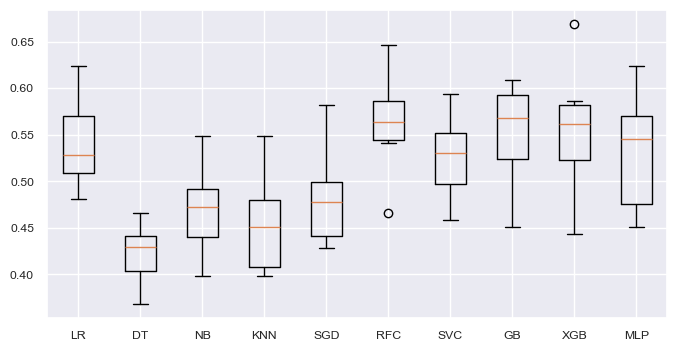

In [46]:
models = []
models.append(("LR", LogisticRegression(random_state=7764)))
models.append(("DT", DecisionTreeClassifier(random_state=7764)))
models.append(("NB", GaussianNB()))
models.append(("KNN", KNeighborsClassifier()))
models.append(("SGD", SGDClassifier(random_state=7764)))
models.append(("RFC", RandomForestClassifier(random_state=7764)))
models.append(("SVC", SVC(random_state=7764)))
models.append(("GB", GradientBoostingClassifier(random_state=7764)))
models.append(("XGB", XGBClassifier(random_state=7764)))
models.append(("MLP", MLPClassifier(random_state=7764)))

results = []
names = []
scoring = scoring = {'acc': 'accuracy',
           'prec_macro': 'precision_macro',
           'rec_micro': 'recall_macro'}
for name, model in models:
    cv_technique = StratifiedKFold(n_splits=10, shuffle=True, random_state=7764)
    cv_results = cross_val_score(model, X, y, cv=cv_technique, scoring='accuracy')

    names.append(name)
    results.append(cv_results)

plt.figure(figsize=(8, 4))
plt.boxplot(results)
plt.xticks(range(1, len(names)+1), names)
plt.show()

In [47]:
for name, res in zip(names, results):
    print(f"{name} -- {res.std()}, {res.mean()}")

LR -- 0.04472752341201624, 0.5378801481315229
DT -- 0.027898568981649607, 0.4230782179328919
NB -- 0.04101760208425951, 0.4673325103804286
KNN -- 0.04896920349539682, 0.4546739984289081
SGD -- 0.0452167877298189, 0.48082706766917294
RFC -- 0.045385852884122266, 0.5656548086634496
SVC -- 0.039170912965726105, 0.5273650544271125
GB -- 0.047480033517008774, 0.5551509370441028
XGB -- 0.05819795818598073, 0.5513859275053304
MLP -- 0.059124010982104895, 0.5349399618449107


Nos quedamos con RandomForest, GB, XGB, LR y MLP

## Algoritmos y parametrización

In [2]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

### Clasificación multiclase

#### MLP

In [154]:
X.shape

(1333, 13)

In [100]:
red1 = MLPClassifier(random_state=seed, hidden_layer_sizes=(5),activation='tanh',
                     alpha=0.001,solver='adam',max_iter=700)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

minor_class_count = 118
minor_class_label = [key for key, value in Counter(y_train).items() if value == minor_class_count][0]

# Find the class with the number of samples we want to match (not the majority).
target_class_count = sorted(Counter(y_train).values())[1]  # Second most numerous class

# Over-sampling
sampling_strategy = {minor_class_label: target_class_count}
smote = SMOTE(sampling_strategy=sampling_strategy,random_state=seed)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

red1.fit(X_resampled, y_resampled)

MLPClassifier(activation='tanh', alpha=0.001, hidden_layer_sizes=5,
              max_iter=700, random_state=7764)

In [102]:
print(red1.classes_)

print(red1.feature_names_in_)

# Convergency iterations
print(red1.n_iter_)

print(red1.coefs_)

[0 1 2 3]
['complexityILFW' 'complexityhuerta' 'stylometryTTR' 'complexitymu'
 'emotionsurprise' 'complexitynSyllabes' 'complexitynSentences' 'ironyNI'
 'polarityNEG' 'complexitynPuntuationMarks' 'emotionsadness' 'emotionfear'
 'stylometryHerdan']
658
[array([[-1.30416655,  0.58144293,  0.53161262, -0.73253623, -0.36696969],
       [-0.27528527, -0.03512063,  0.2040192 ,  0.25441298,  0.16175604],
       [-0.42867421,  0.26224941,  0.32319667, -0.49161043, -0.23821382],
       [-0.20896212, -0.16014816, -0.2773404 , -0.02612761, -1.24947819],
       [-0.94184399,  1.09157511, -0.99651948, -0.02518135, -0.74026671],
       [ 0.46185257, -0.23534174,  0.09857252,  0.63684271,  0.50176253],
       [-0.11193105, -0.35417931,  0.35623808, -0.18429477,  0.85795822],
       [ 0.58568361, -0.50844335,  0.09537123, -0.7376614 ,  0.01372718],
       [ 0.36817462,  0.03590294,  0.18287592,  0.5094231 , -0.04242005],
       [-0.09206618,  0.7822712 , -0.782429  , -0.27938448, -0.1528732 ],
       

In [103]:
y_pred = red1.predict(X_test)

# Precision of the model
precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.5431
F-score del modelo en test: 0.5333
Matriz de confusión:
[[40 16  5 21]
 [16 51 14  4]
 [12 19 36  8]
 [ 6  1  0 18]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.54      0.49      0.51        82
           1       0.59      0.60      0.59        85
           2       0.65      0.48      0.55        75
           3       0.35      0.72      0.47        25

    accuracy                           0.54       267
   macro avg       0.53      0.57      0.53       267
weighted avg       0.57      0.54      0.55       267



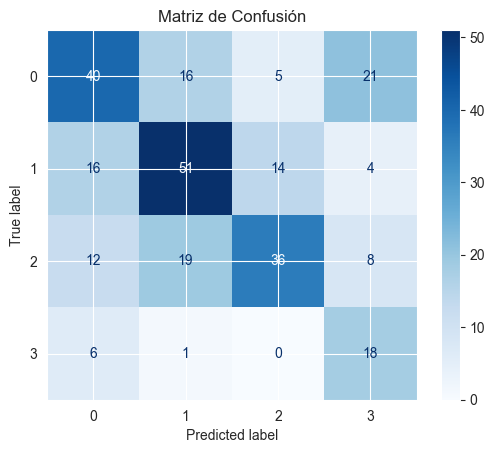

In [104]:
label_encoder = LabelEncoder()
y_test_encoded = label_encoder.fit_transform(y_test)
y_pred_encoded = label_encoder.fit_transform(y_pred)
cm = confusion_matrix(y_test_encoded, y_pred_encoded)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title('Matriz de Confusión')
plt.show()


In [105]:
y_pred_tr = red1.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(red1, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.5390
Precisión del modelo en test: 0.5431
F-score del modelo en train: 0.5344
F-score del modelo en test: 0.5333
Precisión promedio mediante validación cruzada: 0.4496


In [106]:
# Grid search
red = MLPClassifier(random_state=seed)
params = {
    'max_iter': [925, 950, 975, 980, 990], 
    'hidden_layer_sizes': [5, 6, 10, 11, 12],
    'activation': ['tanh','relu'],
    'alpha': [0.1, 0.01, 0.001, 0.0001]
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=red, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_resampled, y_resampled)

GridSearchCV(cv=4, estimator=MLPClassifier(random_state=7764),
             param_grid={'activation': ['tanh', 'relu'],
                         'alpha': [0.1, 0.01, 0.001, 0.0001],
                         'hidden_layer_sizes': [5, 6, 10, 11, 12],
                         'max_iter': [925, 950, 975, 980, 990]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [107]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                params  mean_test_accuracy  \
168  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.558890   
169  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.556399   
167  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.556404   
166  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.555568   
165  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.553907   
143  {'activation': 'relu', 'alpha': 0.01, 'hidden_...            0.553096   
140  {'activation': 'relu', 'alpha': 0.01, 'hidden_...            0.553093   
144  {'activation': 'relu', 'alpha': 0.01, 'hidden_...            0.552265   
146  {'activation': 'relu', 'alpha': 0.01, 'hidden_...            0.553079   
149  {'activation': 'relu', 'alpha': 0.01, 'hidden_...            0.553082   

     mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
168                   0.561387       

In [108]:
best_model = grid_search.best_estimator_
print(grid_search.best_estimator_)

MLPClassifier(alpha=0.001, hidden_layer_sizes=11, max_iter=980,
              random_state=7764)


In [109]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"Red{index}")

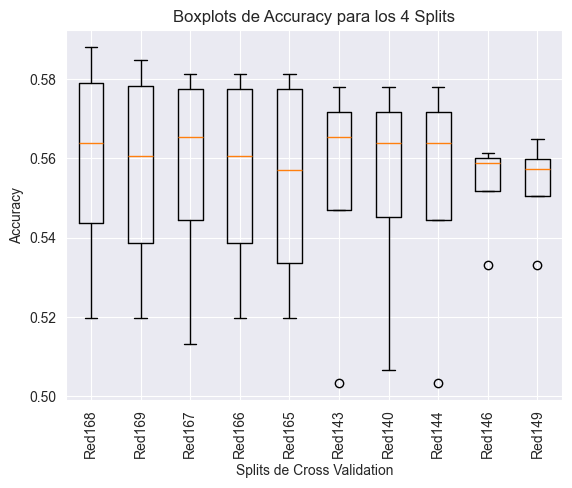

In [110]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

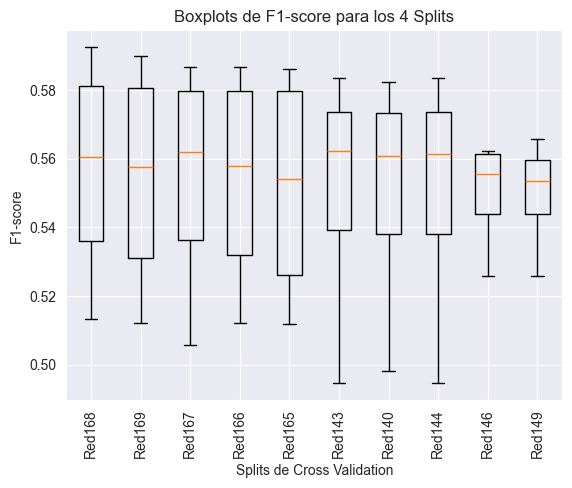

In [111]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [112]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.5588903434467888 0.026102530833470847

0.5563986490946293 0.025789113766661837

0.5564041495236628 0.026832998823087068

0.5555680843105762 0.024901936521479717

0.55390695474247 0.025768024657675272

0.5530956414600339 0.029337048093608566

0.5530928912455172 0.02774601059100147

0.5522650766759808 0.029134766878073558

0.5530791401729335 0.011587666522190065

0.5530818903874503 0.011954021499243928



In [113]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.556776074173329 0.03071538578973363

0.5542833969553633 0.031081428434865027

0.5541642135638577 0.031656784246383116

0.553770055284869 0.03009652315529127

0.5515462554275545 0.031164752593701075

0.5506547211711861 0.03397308542678085

0.5505927313478886 0.03217682195690048

0.5502224748789701 0.03396649983705618

0.5498148196597518 0.014663686582128677

0.5497830605082104 0.014925370172228329



In [114]:
# Best in F1
red0 = MLPClassifier(**results.iloc[0].params, random_state=seed)
# Best in variability
red8 = MLPClassifier(**results.iloc[8].params, random_state=seed)
# Balanced
red3 = MLPClassifier(**results.iloc[3].params, random_state=seed)

In [115]:
red0.fit(X_resampled, y_resampled)
red8.fit(X_resampled, y_resampled)
red3.fit(X_resampled, y_resampled)

MLPClassifier(alpha=0.001, hidden_layer_sizes=11, max_iter=950,
              random_state=7764)

In [116]:
y_pred = red0.predict(X_test)
y_pred_tr = red0.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.5531
Precisión del modelo en test: 0.5393
F-score del modelo en train: 0.5505
F-score del modelo en test: 0.5319
Matriz de confusión:
[[43 18  4 17]
 [20 48 13  4]
 [15 16 36  8]
 [ 7  1  0 17]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.51      0.52      0.51        82
           1       0.58      0.56      0.57        85
           2       0.68      0.48      0.56        75
           3       0.37      0.68      0.48        25

    accuracy                           0.54       267
   macro avg       0.53      0.56      0.53       267
weighted avg       0.56      0.54      0.54       267



In [117]:
y_pred = red8.predict(X_test)
y_pred_tr = red8.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.5340
Precisión del modelo en test: 0.4944
F-score del modelo en train: 0.5294
F-score del modelo en test: 0.4855
Matriz de confusión:
[[36 22  4 20]
 [19 47 11  8]
 [14 20 33  8]
 [ 6  3  0 16]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.48      0.44      0.46        82
           1       0.51      0.55      0.53        85
           2       0.69      0.44      0.54        75
           3       0.31      0.64      0.42        25

    accuracy                           0.49       267
   macro avg       0.50      0.52      0.49       267
weighted avg       0.53      0.49      0.50       267



In [118]:
y_pred = red3.predict(X_test)
y_pred_tr = red3.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.5531
Precisión del modelo en test: 0.5393
F-score del modelo en train: 0.5505
F-score del modelo en test: 0.5319
Matriz de confusión:
[[43 18  4 17]
 [20 48 13  4]
 [15 16 36  8]
 [ 7  1  0 17]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.51      0.52      0.51        82
           1       0.58      0.56      0.57        85
           2       0.68      0.48      0.56        75
           3       0.37      0.68      0.48        25

    accuracy                           0.54       267
   macro avg       0.53      0.56      0.53       267
weighted avg       0.56      0.54      0.54       267



Nos quedamos con el primer modelo que definimos

In [119]:
# Testing the model with various seeds

l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    red_n = MLPClassifier(random_state=r_seed, hidden_layer_sizes=(5), activation='tanh', alpha=0.001, solver='adam',max_iter=700)
    red_n.fit(X_resampled, y_resampled)
    
    y_pred = red_n.predict(X_test)
    y_pred_tr = red_n.predict(X_resampled)
    
    precision_tr = accuracy_score(y_resampled, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.5124
Precisión del modelo en test: 0.4981
F-score del modelo en train: 0.5113
F-score del modelo en test: 0.4923
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.40      0.41      0.41        82
           1       0.56      0.58      0.57        85
           2       0.67      0.47      0.55        75
           3       0.35      0.60      0.44        25

    accuracy                           0.50       267
   macro avg       0.50      0.51      0.49       267
weighted avg       0.52      0.50      0.50       267

**************************************************
Precisión del modelo en train: 0.5398
Precisión del modelo en test: 0.5281
F-score del modelo en train: 0.5384
F-score del modelo en test: 0.5227
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.50      0.54      0.52        82
           1       0.57      0.53      0.55        85
       

In [120]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.5
0.020608706640723062


In [121]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.4922074024502661
0.02141143742164805


#### Regresión logística

In [4]:
df['label'].value_counts()

label
1    443
0    414
2    333
3    143
Name: count, dtype: int64

Para los pesos aplicaremos la fórmula: total_num_observ/num_clases * num_observ_clase_i)

Dando como resultado:
* Clase 0: 1333 / (4*414) = 0.80495
* Clase 1: 1333 / (4*443) = 0.7523
* Clase 2: 1333 / (4*333) = 1.001
* Clase 3: 1333 / (4*143) = 2.33

Con resample:
* Clase 0: 1.2412
* Clase 1: 1.0038
* Clase 2: 1.2917
* Clase 3: 1.2917

In [79]:
rl1 = LogisticRegression(random_state=seed, class_weight='balanced', multi_class='multinomial')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

minor_class_count = 118
minor_class_label = [key for key, value in Counter(y_train).items() if value == minor_class_count][0]

# Find the class with the number of samples we want to match (not the majority).
target_class_count = sorted(Counter(y_train).values())[1] # Second most numerous class

# Over-sampling
sampling_strategy = {minor_class_label: target_class_count}
smote = SMOTE(sampling_strategy=sampling_strategy,random_state=seed)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

rl1.fit(X_resampled, y_resampled)

LogisticRegression(class_weight='balanced', multi_class='multinomial',
                   random_state=7764)

In [80]:
print(f'La frecuencia de cada clase en train es: \n{y_resampled.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
1    358
0    332
2    258
3    258
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
1    85
0    82
2    75
3    25
Name: count, dtype: int64


In [141]:
# Convergency iterations
print(rl1.n_iter_)

[55]


In [81]:
y_pred = rl1.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.5019
F-score del modelo en test: 0.4950
Matriz de confusión:
[[36 12  8 26]
 [19 42 17  7]
 [12 14 37 12]
 [ 5  1  0 19]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.50      0.44      0.47        82
           1       0.61      0.49      0.55        85
           2       0.60      0.49      0.54        75
           3       0.30      0.76      0.43        25

    accuracy                           0.50       267
   macro avg       0.50      0.55      0.50       267
weighted avg       0.54      0.50      0.51       267



In [82]:
y_pred_tr = rl1.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(rl1, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.5381
Precisión del modelo en test: 0.5019
F-score del modelo en train: 0.5352
F-score del modelo en test: 0.4950
Precisión promedio mediante validación cruzada: 0.4620


In [126]:
# Grid search
lr = LogisticRegression(random_state=seed)
params = {
    'penalty': ['l1', 'l2', 'elasticnet', None], 
    'C': [0.1, 1, 3, 5],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'max_iter': [20, 30, 40, 50, 60],
    'class_weight': ['balanced', {0:1.2412, 1:1.2412, 2:1.2917, 3:1.2917}, {0:1.2412, 1:1.0038, 2:1.2917, 3:1.2917}, None],
    'tol': [1e-2, 0.05, 1e-1, 0.5, 0.9],
    'multi_class': ['multinomial']
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']
grid_search = GridSearchCV(estimator=lr, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_resampled, y_resampled)

GridSearchCV(cv=4, estimator=LogisticRegression(random_state=7764),
             param_grid={'C': [0.1, 1, 3, 5],
                         'class_weight': ['balanced',
                                          {0: 1.2412, 1: 1.2412, 2: 1.2917,
                                           3: 1.2917},
                                          {0: 1.2412, 1: 1.0038, 2: 1.2917,
                                           3: 1.2917},
                                          None],
                         'max_iter': [20, 30, 40, 50, 60],
                         'multi_class': ['multinomial'],
                         'penalty': ['l1', 'l2', 'elasticnet', None],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag',
                                    'saga'],
                         'tol': [0.01, 0.05, 0.1, 0.5, 0.9]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [127]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                 params  mean_test_accuracy  \
2646  {'C': 1, 'class_weight': {0: 1.2412, 1: 1.2412...            0.533151   
2546  {'C': 1, 'class_weight': {0: 1.2412, 1: 1.2412...            0.533151   
2946  {'C': 1, 'class_weight': {0: 1.2412, 1: 1.2412...            0.533151   
2846  {'C': 1, 'class_weight': {0: 1.2412, 1: 1.2412...            0.533151   
2746  {'C': 1, 'class_weight': {0: 1.2412, 1: 1.2412...            0.533151   
2940  {'C': 1, 'class_weight': {0: 1.2412, 1: 1.2412...            0.532318   
2740  {'C': 1, 'class_weight': {0: 1.2412, 1: 1.2412...            0.532318   
2640  {'C': 1, 'class_weight': {0: 1.2412, 1: 1.2412...            0.532318   
2840  {'C': 1, 'class_weight': {0: 1.2412, 1: 1.2412...            0.532318   
3946  {'C': 1, 'class_weight': None, 'max_iter': 60,...            0.532323   

      mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
2646                   0.

In [128]:
best_model = grid_search.best_estimator_
print(grid_search.best_estimator_)

LogisticRegression(C=1,
                   class_weight={0: 1.2412, 1: 1.2412, 2: 1.2917, 3: 1.2917},
                   max_iter=20, multi_class='multinomial', random_state=7764,
                   solver='saga', tol=0.05)


In [129]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"Red{index}")

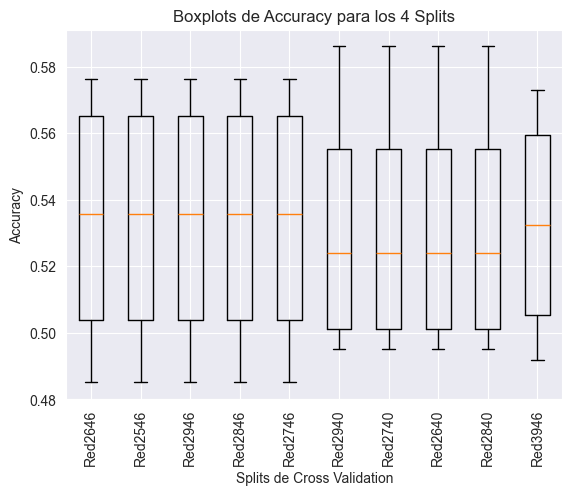

In [130]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

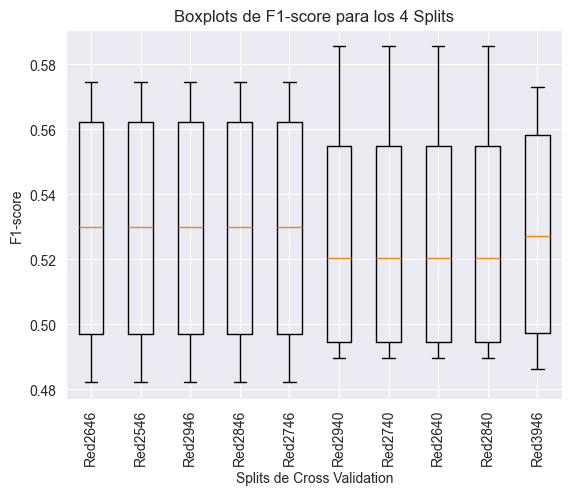

In [131]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [132]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.5331510857846912 0.03709429107371669

0.5331510857846912 0.03709429107371669

0.5331510857846912 0.03709429107371669

0.5331510857846912 0.03709429107371669

0.5331510857846912 0.03709429107371669

0.5323177707861213 0.03633719918091028

0.5323177707861213 0.03633719918091028

0.5323177707861213 0.03633719918091028

0.5323177707861213 0.03633719918091028

0.5323232712151548 0.032787980765966486



In [133]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.5291765746858431 0.03822864469280484

0.5291765746858431 0.03822864469280484

0.5291765746858431 0.03822864469280484

0.5291765746858431 0.03822864469280484

0.5291765746858431 0.03822864469280484

0.5290397163002938 0.03892333641935685

0.5290397163002938 0.03892333641935685

0.5290397163002938 0.03892333641935685

0.5290397163002938 0.03892333641935685

0.5284282017920946 0.03574339398605044



In [135]:
# Overall best
rl0 = LogisticRegression(**results.iloc[0].params, random_state=seed)
# Best in variability
rl9 = LogisticRegression(**results.iloc[9].params, random_state=seed)

In [136]:
rl0.fit(X_resampled, y_resampled)
rl9.fit(X_resampled, y_resampled)

LogisticRegression(C=1, max_iter=60, multi_class='multinomial',
                   random_state=7764, solver='saga', tol=0.05)

In [137]:
y_pred = rl0.predict(X_test)
y_pred_tr = rl0.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.5481
Precisión del modelo en test: 0.4981
F-score del modelo en train: 0.5419
F-score del modelo en test: 0.4948
Matriz de confusión:
[[37 18  6 21]
 [19 46 16  4]
 [12 24 32  7]
 [ 6  1  0 18]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.50      0.45      0.47        82
           1       0.52      0.54      0.53        85
           2       0.59      0.43      0.50        75
           3       0.36      0.72      0.48        25

    accuracy                           0.50       267
   macro avg       0.49      0.53      0.49       267
weighted avg       0.52      0.50      0.50       267



In [138]:
y_pred = rl9.predict(X_test)
y_pred_tr = rl9.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.5498
Precisión del modelo en test: 0.4944
F-score del modelo en train: 0.5441
F-score del modelo en test: 0.4890
Matriz de confusión:
[[39 17  6 20]
 [21 46 15  3]
 [16 21 30  8]
 [ 7  1  0 17]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.47      0.48      0.47        82
           1       0.54      0.54      0.54        85
           2       0.59      0.40      0.48        75
           3       0.35      0.68      0.47        25

    accuracy                           0.49       267
   macro avg       0.49      0.52      0.49       267
weighted avg       0.51      0.49      0.49       267



In [83]:
# Testing the model with various seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    lr = LogisticRegression(random_state=r_seed, class_weight='balanced', multi_class='multinomial')
    lr.fit(X_resampled, y_resampled)
    
    y_pred = lr.predict(X_test)
    y_pred_tr = lr.predict(X_resampled)
    
    # Calcular la precisión del modelo
    precision_tr = accuracy_score(y_resampled, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    # Calcular el F1 score
    f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    # Mostrar el informe de clasificación
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.5381
Precisión del modelo en test: 0.5019
F-score del modelo en train: 0.5352
F-score del modelo en test: 0.4950
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.50      0.44      0.47        82
           1       0.61      0.49      0.55        85
           2       0.60      0.49      0.54        75
           3       0.30      0.76      0.43        25

    accuracy                           0.50       267
   macro avg       0.50      0.55      0.50       267
weighted avg       0.54      0.50      0.51       267

**************************************************
Precisión del modelo en train: 0.5381
Precisión del modelo en test: 0.5019
F-score del modelo en train: 0.5352
F-score del modelo en test: 0.4950
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.50      0.44      0.47        82
           1       0.61      0.49      0.55        85
       

In [84]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.50187265917603
0.0


In [85]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.49502482263082603
0.0


#### Random forest

In [64]:
rf1 = RandomForestClassifier(n_estimators = 60,bootstrap = True, max_depth = 7, 
                             min_samples_split=10, criterion='entropy', 
                             max_features= None, random_state=seed, class_weight={0:1.2412, 1:1.0038, 2:1.2917, 3:1.2917})

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

minor_class_count = 118
minor_class_label = [key for key, value in Counter(y_train).items() if value == minor_class_count][0]

# Find the class with the number of samples we want to match (not the majority).
target_class_count = sorted(Counter(y_train).values())[1]  # Second most numerous class

# Over-sampling
sampling_strategy = {minor_class_label: target_class_count}
smote = SMOTE(sampling_strategy=sampling_strategy,random_state=seed)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

rf1.fit(X_resampled, y_resampled)

RandomForestClassifier(class_weight={0: 1.2412, 1: 1.0038, 2: 1.2917,
                                     3: 1.2917},
                       criterion='entropy', max_depth=7, max_features=None,
                       min_samples_split=10, n_estimators=60,
                       random_state=7764)

In [65]:
print(f'La frecuencia de cada clase en train es: \n{y_resampled.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
1    358
0    332
2    258
3    258
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
1    85
0    82
2    75
3    25
Name: count, dtype: int64


In [66]:
y_pred = rf1.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.5281
F-score del modelo en test: 0.5108
Matriz de confusión:
[[39 19  8 16]
 [17 53 10  5]
 [11 25 36  3]
 [ 7  4  1 13]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.53      0.48      0.50        82
           1       0.52      0.62      0.57        85
           2       0.65      0.48      0.55        75
           3       0.35      0.52      0.42        25

    accuracy                           0.53       267
   macro avg       0.51      0.52      0.51       267
weighted avg       0.55      0.53      0.53       267



In [67]:
y_pred_tr = rf1.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(rf1, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.8458
Precisión del modelo en test: 0.5281
F-score del modelo en train: 0.8465
F-score del modelo en test: 0.5108
Precisión promedio mediante validación cruzada: 0.4516


In [68]:
# Grid search
params = {
    'n_estimators' : [100,150,200,300,400],
    'max_depth': [2,3,4,5], # si bajamos más la profundidad emepezamos a perder mucho rendimiento en test aunque el modelo esté sobreajustado
    'bootstrap': [True],
    'min_samples_split': [2,3,4,5,7],
    'criterion': ["entropy", "gini"],
    'max_features': [None],
    'class_weight': [None, 'balanced', {0:1.2412, 1:1.2412, 2:1.2917, 3:1.2917}, {0:1.2412, 1:1.0038, 2:1.2917, 3:1.2917}, ]
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=rf1, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_resampled, y_resampled)

GridSearchCV(cv=4,
             estimator=RandomForestClassifier(class_weight={0: 1.2412,
                                                            1: 1.0038,
                                                            2: 1.2917,
                                                            3: 1.2917},
                                              criterion='entropy', max_depth=7,
                                              max_features=None,
                                              min_samples_split=10,
                                              n_estimators=60,
                                              random_state=7764),
             param_grid={'bootstrap': [True],
                         'class_weight': [None, 'balanced',
                                          {0: 1.2412, 1: 1.2412, 2: 1.2917,
                                           3: 1.2917},
                                          {0: 1.2412, 1: 1.0038, 2: 1.2917,
                                           3: 1.2917}],
                         'criterion': ['entropy', 'gini'],
                         'max_depth': [2, 3, 4, 5], 'max_features': [None],
                         'min_samples_split': [2, 3, 4, 5, 7],
                         'n_estimators': [100, 150, 200, 300, 400]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [69]:
# Cheking possible overfitting
best_model_RF = grid_search.best_estimator_

y_train_pred = best_model_RF.predict(X_resampled)
y_test_pred = best_model_RF.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_resampled,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.6674958540630183
Se tiene un accuracy para test de: 0.5280898876404494
F-score del modelo en train: 0.6674
F-score del modelo en test: 0.5127


In [70]:
# Grid search results

results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                params  mean_test_accuracy  \
797  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.554749   
796  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.553907   
787  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.553918   
792  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.553918   
791  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.553079   
786  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.552254   
780  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.552257   
776  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.552251   
785  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.551426   
781  {'bootstrap': True, 'class_weight': {0: 1.2412...            0.551424   

     mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
797                   0.556660       

In [71]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"Red{index}")

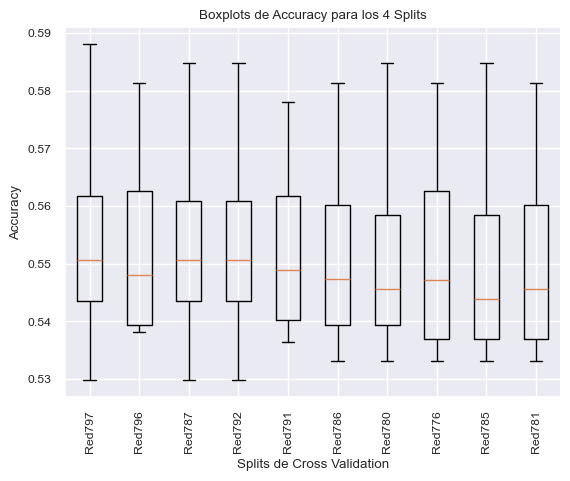

In [72]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

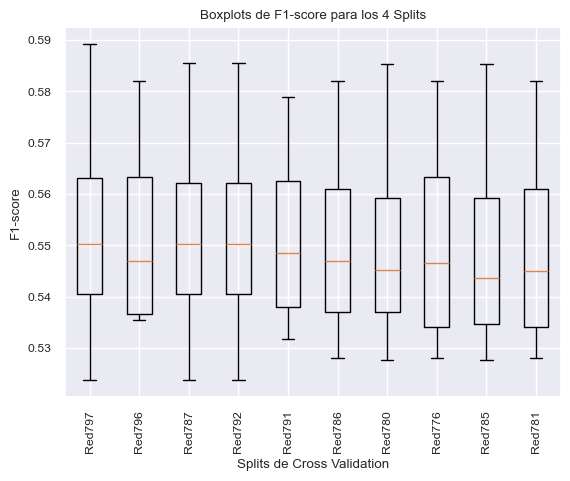

In [73]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [74]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.55474852038459 0.021077501054644145

0.55390695474247 0.017382889836478406

0.5539179556005369 0.019774461405636403

0.5539179556005369 0.019774461405636403

0.5530791401729335 0.016169712183760378

0.5522540758179137 0.01824267851893256

0.5522568260324305 0.01963418246367776

0.552251325603397 0.018902773768184233

0.5514262612483773 0.020134353910802566

0.5514235110338606 0.01877982527796599



In [75]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.5533616882189988 0.02352145326358238

0.5529001071186737 0.018859689389195827

0.5524434718086668 0.02213561807840935

0.5524434718086668 0.02213561807840935

0.5519505851083553 0.018017505678670897

0.5510160793458323 0.020115723486158397

0.550925491107574 0.02146103629687104

0.5508439904493911 0.020920213052546342

0.5501420894538875 0.021894842707945127

0.5500587333672284 0.020726728842974322



In [76]:
# Overall best
rf0 = RandomForestClassifier(**results.iloc[0].params, random_state=seed)
# Best in variability
rf4 = RandomForestClassifier(**results.iloc[4].params, random_state=seed)
# Balanced
rf1 = RandomForestClassifier(**results.iloc[1].params, random_state=seed)

In [77]:
rf0.fit(X_resampled, y_resampled)
rf4.fit(X_resampled, y_resampled)
rf1.fit(X_resampled, y_resampled)

RandomForestClassifier(class_weight={0: 1.2412, 1: 1.0038, 2: 1.2917,
                                     3: 1.2917},
                       max_depth=5, max_features=None, min_samples_split=7,
                       n_estimators=150, random_state=7764)

In [78]:
y_pred = rf0.predict(X_test)
y_pred_tr = rf0.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.6675
Precisión del modelo en test: 0.5281
F-score del modelo en train: 0.6674
F-score del modelo en test: 0.5127
Matriz de confusión:
[[38 18  7 19]
 [16 52 11  6]
 [13 23 37  2]
 [ 5  5  1 14]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.53      0.46      0.49        82
           1       0.53      0.61      0.57        85
           2       0.66      0.49      0.56        75
           3       0.34      0.56      0.42        25

    accuracy                           0.53       267
   macro avg       0.52      0.53      0.51       267
weighted avg       0.55      0.53      0.53       267



In [79]:
y_pred = rf4.predict(X_test)
y_pred_tr = rf4.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.6716
Precisión del modelo en test: 0.5206
F-score del modelo en train: 0.6717
F-score del modelo en test: 0.5041
Matriz de confusión:
[[37 17  8 20]
 [16 52 11  6]
 [12 24 36  3]
 [ 5  5  1 14]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.53      0.45      0.49        82
           1       0.53      0.61      0.57        85
           2       0.64      0.48      0.55        75
           3       0.33      0.56      0.41        25

    accuracy                           0.52       267
   macro avg       0.51      0.53      0.50       267
weighted avg       0.54      0.52      0.52       267



In [80]:
y_pred = rf1.predict(X_test)
y_pred_tr = rf1.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.6675
Precisión del modelo en test: 0.5206
F-score del modelo en train: 0.6677
F-score del modelo en test: 0.5044
Matriz de confusión:
[[36 18  8 20]
 [16 52 11  6]
 [12 23 37  3]
 [ 5  5  1 14]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.52      0.44      0.48        82
           1       0.53      0.61      0.57        85
           2       0.65      0.49      0.56        75
           3       0.33      0.56      0.41        25

    accuracy                           0.52       267
   macro avg       0.51      0.53      0.50       267
weighted avg       0.54      0.52      0.52       267



In [81]:
rf1.get_params

<bound method BaseEstimator.get_params of RandomForestClassifier(class_weight={0: 1.2412, 1: 1.0038, 2: 1.2917,
                                     3: 1.2917},
                       max_depth=5, max_features=None, min_samples_split=7,
                       n_estimators=150, random_state=7764)>

In [75]:
# Testing the model with various seeds

l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    rf = RandomForestClassifier(**results.iloc[1].params, random_state=r_seed)
    rf.fit(X_resampled, y_resampled)
    
    y_pred = rf.predict(X_test)
    y_pred_tr = rf.predict(X_resampled)
    
    # Calcular la precisión del modelo
    precision_tr = accuracy_score(y_resampled, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    # Calcular el F1 score
    f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    # Mostrar el informe de clasificación
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.6692
Precisión del modelo en test: 0.5243
F-score del modelo en train: 0.6693
F-score del modelo en test: 0.5094
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.52      0.48      0.50        82
           1       0.53      0.61      0.57        85
           2       0.67      0.47      0.55        75
           3       0.34      0.56      0.42        25

    accuracy                           0.52       267
   macro avg       0.51      0.53      0.51       267
weighted avg       0.55      0.52      0.53       267

**************************************************
Precisión del modelo en train: 0.6866
Precisión del modelo en test: 0.5169
F-score del modelo en train: 0.6868
F-score del modelo en test: 0.4984
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.51      0.46      0.48        82
           1       0.54      0.62      0.58        85
       

In [76]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.5191011235955056
0.0043962089542219415


In [77]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.5016685059629565
0.004447163366633869


#### GBOOST

In [83]:
gb = GradientBoostingClassifier(n_estimators = 450, criterion='squared_error', 
                                learning_rate = 0.1, subsample = 1, 
                                random_state = seed,n_iter_no_change = 10, 
                                loss='log_loss', min_samples_split=5, max_depth=5)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

minor_class_count = 118
minor_class_label = [key for key, value in Counter(y_train).items() if value == minor_class_count][0]

# Find the class with the number of samples we want to match (not the majority).
target_class_count = sorted(Counter(y_train).values())[1]  # Second most numerous class

sampling_strategy = {minor_class_label: target_class_count}
smote = SMOTE(sampling_strategy=sampling_strategy,random_state=seed)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

gb.fit(X_resampled, y_resampled)

GradientBoostingClassifier(criterion='squared_error', max_depth=5,
                           min_samples_split=5, n_estimators=450,
                           n_iter_no_change=10, random_state=7764, subsample=1)

In [84]:
print(f'La frecuencia de cada clase en train es: \n{y_resampled.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
1    358
0    332
2    258
3    258
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
1    85
0    82
2    75
3    25
Name: count, dtype: int64


In [85]:
y_pred = gb.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.5581
F-score del modelo en test: 0.5309
Matriz de confusión:
[[42 20 10 10]
 [12 57 10  6]
 [11 22 39  3]
 [10  4  0 11]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.56      0.51      0.54        82
           1       0.55      0.67      0.61        85
           2       0.66      0.52      0.58        75
           3       0.37      0.44      0.40        25

    accuracy                           0.56       267
   macro avg       0.54      0.54      0.53       267
weighted avg       0.57      0.56      0.56       267



In [86]:
y_pred_tr = gb.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(gb, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.9320
Precisión del modelo en test: 0.5581
F-score del modelo en train: 0.9315
F-score del modelo en test: 0.5309
Precisión promedio mediante validación cruzada: 0.4756


In [87]:
# Grid search
start = time()

params = {
   'loss': ["log_loss", "exponential"],
   'n_estimators': [50, 100, 150],
   'n_iter_no_change': [None,5,10],
   'criterion': ["friedman_mse", "squared_error"],
   'max_depth': [4,5],
   'subsample': [0.5, 0.75, 1],
   'min_samples_split': [420],#[410, 415, 425],
   'min_samples_leaf': [420],#[75,100,150]
   'learning_rate': [0.01, 0.1],
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=gb, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_resampled, y_resampled)

end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

>>>>>>>>>>>>> elapsed time: 1m


In [88]:
grid_search.best_estimator_

GradientBoostingClassifier(max_depth=4, min_samples_leaf=420,
                           min_samples_split=420, random_state=7764,
                           subsample=1)

In [89]:
# Checking for overfitting
best_model_gb = grid_search.best_estimator_

y_train_pred = best_model_gb.predict(X_resampled)
y_test_pred = best_model_gb.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_resampled,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.5837479270315091
Se tiene un accuracy para test de: 0.5093632958801498
F-score del modelo en train: 0.5783
F-score del modelo en test: 0.4946


In [90]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                params  mean_test_accuracy  \
119  {'criterion': 'friedman_mse', 'learning_rate':...            0.510822   
146  {'criterion': 'friedman_mse', 'learning_rate':...            0.510822   
335  {'criterion': 'squared_error', 'learning_rate'...            0.510822   
362  {'criterion': 'squared_error', 'learning_rate'...            0.510822   
371  {'criterion': 'squared_error', 'learning_rate'...            0.501702   
128  {'criterion': 'friedman_mse', 'learning_rate':...            0.501702   
155  {'criterion': 'friedman_mse', 'learning_rate':...            0.501702   
344  {'criterion': 'squared_error', 'learning_rate'...            0.501702   
326  {'criterion': 'squared_error', 'learning_rate'...            0.498358   
137  {'criterion': 'friedman_mse', 'learning_rate':...            0.498358   

     mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
119                   0.511280       

In [91]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"GB{index}")

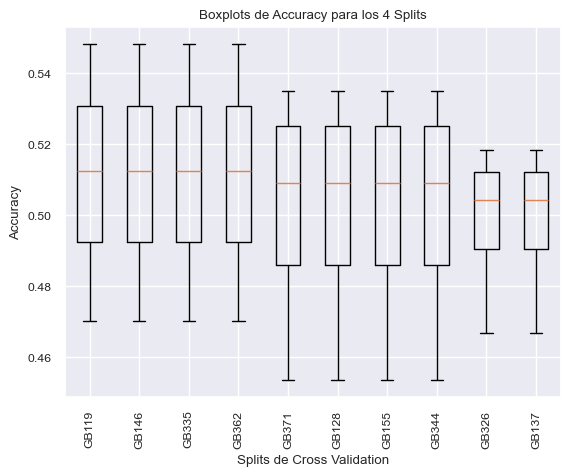

In [92]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

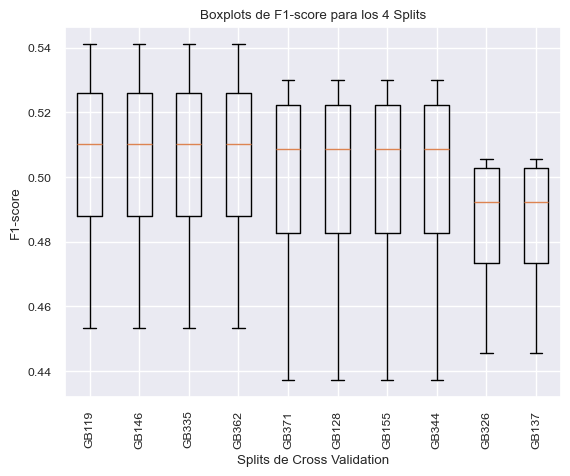

In [93]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [94]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.5108220941233417 0.028987569294894794

0.5108220941233417 0.028987569294894794

0.5108220941233417 0.028987569294894794

0.5108220941233417 0.028987569294894794

0.5017023827858573 0.030949979538798515

0.5017023827858573 0.030949979538798515

0.5017023827858573 0.030949979538798515

0.5017023827858573 0.030949979538798515

0.4983581219335108 0.01949987719517602

0.4983581219335108 0.01949987719517602



In [95]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.503737702891315 0.032623779115613934

0.503737702891315 0.032623779115613934

0.503737702891315 0.032623779115613934

0.503737702891315 0.032623779115613934

0.49609900176808114 0.035880753094280994

0.49609900176808114 0.035880753094280994

0.49609900176808114 0.035880753094280994

0.49609900176808114 0.035880753094280994

0.4838719554789245 0.02380870242889848

0.4838719554789245 0.02380870242889848



In [96]:
# Best in F1 and variability
gb0 = GradientBoostingClassifier(**results.iloc[0].params, random_state=seed)
# Best in variability
gb8 = GradientBoostingClassifier(**results.iloc[8].params, random_state=seed)

In [97]:
gb0.fit(X_resampled, y_resampled)
gb8.fit(X_resampled, y_resampled)

GradientBoostingClassifier(criterion='squared_error', max_depth=4,
                           min_samples_leaf=420, min_samples_split=420,
                           n_estimators=50, random_state=7764, subsample=1)

In [98]:
y_pred = gb0.predict(X_test)
y_pred_tr = gb0.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.5837
Precisión del modelo en test: 0.5094
F-score del modelo en train: 0.5783
F-score del modelo en test: 0.4946
Matriz de confusión:
[[36 19 13 14]
 [16 49 12  8]
 [11 23 38  3]
 [10  2  0 13]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.49      0.44      0.46        82
           1       0.53      0.58      0.55        85
           2       0.60      0.51      0.55        75
           3       0.34      0.52      0.41        25

    accuracy                           0.51       267
   macro avg       0.49      0.51      0.49       267
weighted avg       0.52      0.51      0.51       267



In [99]:
y_pred = gb8.predict(X_test)
y_pred_tr = gb8.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.5688
Precisión del modelo en test: 0.5169
F-score del modelo en train: 0.5576
F-score del modelo en test: 0.4831
Matriz de confusión:
[[40 22 10 10]
 [14 53 13  5]
 [13 24 37  1]
 [13  4  0  8]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.50      0.49      0.49        82
           1       0.51      0.62      0.56        85
           2       0.62      0.49      0.55        75
           3       0.33      0.32      0.33        25

    accuracy                           0.52       267
   macro avg       0.49      0.48      0.48       267
weighted avg       0.52      0.52      0.52       267



Nos quedamos con el segundo al estar menos sobreajustado y poseer mejor variabilidad que el primero.

In [100]:
gb8.get_params

<bound method BaseEstimator.get_params of GradientBoostingClassifier(criterion='squared_error', max_depth=4,
                           min_samples_leaf=420, min_samples_split=420,
                           n_estimators=50, random_state=7764, subsample=1)>

In [80]:
# Testing the model with various seeds

l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    gb = GradientBoostingClassifier(**results.iloc[8].params, random_state=r_seed)
    gb.fit(X_resampled, y_resampled)
    
    y_pred = gb.predict(X_test)
    y_pred_tr = gb.predict(X_resampled)
    
    # Calcular la precisión del modelo
    precision_tr = accuracy_score(y_resampled, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    # Calcular el F1 score
    f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    # Mostrar el informe de clasificación
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.5688
Precisión del modelo en test: 0.5169
F-score del modelo en train: 0.5576
F-score del modelo en test: 0.4831
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.50      0.49      0.49        82
           1       0.51      0.62      0.56        85
           2       0.62      0.49      0.55        75
           3       0.33      0.32      0.33        25

    accuracy                           0.52       267
   macro avg       0.49      0.48      0.48       267
weighted avg       0.52      0.52      0.52       267

**************************************************
Precisión del modelo en train: 0.5688
Precisión del modelo en test: 0.5169
F-score del modelo en train: 0.5576
F-score del modelo en test: 0.4831
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.50      0.49      0.49        82
           1       0.51      0.62      0.56        85
       

In [82]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.48308392703022895
0.0


In [83]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.48308392703022895
0.0


#### XGBoost

In [89]:
xgb = XGBClassifier(booster = 'gbtree', n_estimators = 200, 
                               eta = 0.1, gamma = 1, random_state=seed, max_depth = 15, tree_method = 'hist')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

minor_class_count = 118
minor_class_label = [key for key, value in Counter(y_train).items() if value == minor_class_count][0]

# Find the class with the number of samples we want to match (not the majority).
target_class_count = sorted(Counter(y_train).values())[1]  # Second most numerous class

# Resampling
sampling_strategy = {minor_class_label: target_class_count}
smote = SMOTE(sampling_strategy=sampling_strategy,random_state=seed)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

xgb.fit(X_resampled, y_resampled)

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.1, eval_metric=None,
              feature_types=None, gamma=1, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=15,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=200,
              n_jobs=None, num_parallel_tree=None, ...)

In [90]:
print(f'La frecuencia de cada clase en train es: \n{y_resampled.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
1    358
0    332
2    258
3    258
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
1    85
0    82
2    75
3    25
Name: count, dtype: int64


In [91]:
y_pred = xgb.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.5655
F-score del modelo en test: 0.5485
Matriz de confusión:
[[37 23  8 14]
 [16 58  9  2]
 [10 20 43  2]
 [ 7  4  1 13]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.53      0.45      0.49        82
           1       0.55      0.68      0.61        85
           2       0.70      0.57      0.63        75
           3       0.42      0.52      0.46        25

    accuracy                           0.57       267
   macro avg       0.55      0.56      0.55       267
weighted avg       0.58      0.57      0.56       267



In [92]:
y_pred_tr = xgb.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(xgb, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.9793
Precisión del modelo en test: 0.5655
F-score del modelo en train: 0.9797
F-score del modelo en test: 0.5485
Precisión promedio mediante validación cruzada: 0.4804


In [140]:
# Grid search
params = {
    'n_estimators': [100, 125, 200],
    'eta' : [0.001, 0.003, 0.004],
    'gamma' : [0.7, 0.8, 0.9, 0.95],
    'max_depth': [2,3]
}

grid_search = GridSearchCV(estimator=xgb, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_resampled, y_resampled)

GridSearchCV(cv=4,
             estimator=XGBClassifier(base_score=None, booster='gbtree',
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eta=0.1,
                                     eval_metric=None, feature_types=None,
                                     gamma=1, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_r...
                                     max_delta_step=None, max_depth=15,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=200,
                                     n_jobs=None, num_parallel_tree=None, ...),
             param_grid={'eta': [0.001, 0.003, 0.004],
                         'gamma': [0.7, 0.8, 0.9, 0.95], 'max_depth': [2, 3],
                         'n_estimators': [100, 125, 200]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [141]:
# Checking possible overfitting
best_model_gb = grid_search.best_estimator_

y_train_pred = best_model_gb.predict(X_resampled)
y_test_pred = best_model_gb.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_resampled,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.632669983416252
Se tiene un accuracy para test de: 0.5430711610486891
F-score del modelo en train: 0.6305
F-score del modelo en test: 0.5241


In [142]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                               params  mean_test_accuracy  \
71  {'eta': 0.004, 'gamma': 0.95, 'max_depth': 3, ...            0.514125   
65  {'eta': 0.004, 'gamma': 0.9, 'max_depth': 3, '...            0.514125   
59  {'eta': 0.004, 'gamma': 0.8, 'max_depth': 3, '...            0.513297   
47  {'eta': 0.003, 'gamma': 0.95, 'max_depth': 3, ...            0.510808   
41  {'eta': 0.003, 'gamma': 0.9, 'max_depth': 3, '...            0.510808   
35  {'eta': 0.003, 'gamma': 0.8, 'max_depth': 3, '...            0.510808   
53  {'eta': 0.004, 'gamma': 0.7, 'max_depth': 3, '...            0.510814   
29  {'eta': 0.003, 'gamma': 0.7, 'max_depth': 3, '...            0.509981   
57  {'eta': 0.004, 'gamma': 0.8, 'max_depth': 3, '...            0.507505   
64  {'eta': 0.004, 'gamma': 0.9, 'max_depth': 3, '...            0.508328   

    mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
71                   0.513489                0.50

In [144]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"XGB{index}")

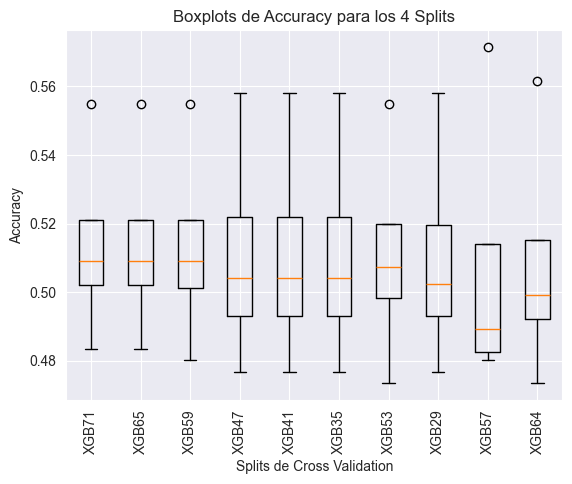

In [145]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

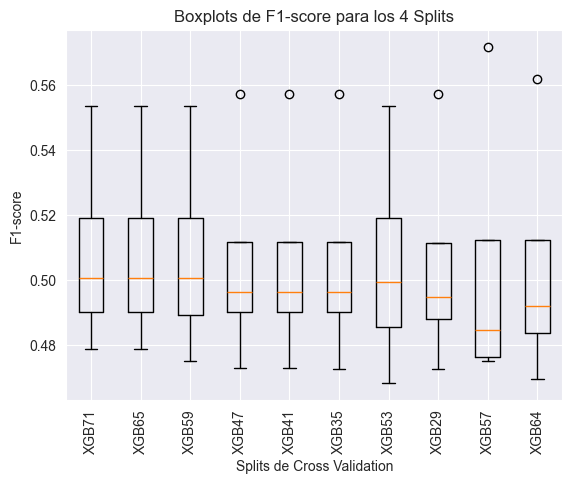

In [146]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [147]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.5141251017579371 0.025732441464117708

0.5141251017579371 0.025732441464117708

0.5132972871884007 0.026739696765541967

0.510808343050758 0.029797738044321818

0.510808343050758 0.029797738044321818

0.510808343050758 0.029797738044321818

0.5108138434797914 0.028947115561656522

0.5099805284812216 0.02985647306809165

0.5075053354161625 0.03731750612959131

0.5083276495566654 0.03242158268673014



In [148]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.5084299751229197 0.02809764727622483

0.5084299751229197 0.02809764727622483

0.5075099247367066 0.029099785171999456

0.5056800297701812 0.031370897982198075

0.5056800297701812 0.031370897982198075

0.5056029323046537 0.031451880019503324

0.5052091993061809 0.03132089251809861

0.5048157279799804 0.03171153780727297

0.5040486760729069 0.03971091107693996

0.5038851546418857 0.03481362590288066



In [149]:
# Overall best
xgb0 = XGBClassifier(**results.iloc[0].params, random_state=seed)

In [150]:
xgb0.get_params

<bound method XGBModel.get_params of XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.004, eval_metric=None,
              feature_types=None, gamma=0.95, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=3,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=200,
              n_jobs=None, num_parallel_tree=None, ...)>

In [151]:
xgb0.fit(X_resampled, y_resampled)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.004, eval_metric=None,
              feature_types=None, gamma=0.95, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=3,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=200,
              n_jobs=None, num_parallel_tree=None, ...)

In [152]:
y_pred = xgb0.predict(X_test)
y_pred_tr = xgb0.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.6327
Precisión del modelo en test: 0.5431
F-score del modelo en train: 0.6305
F-score del modelo en test: 0.5241
Matriz de confusión:
[[40 23  5 14]
 [16 58  9  2]
 [13 23 34  5]
 [ 7  4  1 13]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.53      0.49      0.51        82
           1       0.54      0.68      0.60        85
           2       0.69      0.45      0.55        75
           3       0.38      0.52      0.44        25

    accuracy                           0.54       267
   macro avg       0.53      0.54      0.52       267
weighted avg       0.56      0.54      0.54       267



In [156]:
# Testing algorithm with multiple seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    xgb = XGBClassifier(**results.iloc[0].params, random_state=r_seed)
    xgb.fit(X_resampled, y_resampled)
    
    y_pred = xgb.predict(X_test)
    y_pred_tr = xgb.predict(X_resampled)
    
    precision_tr = accuracy_score(y_resampled, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.6327
Precisión del modelo en test: 0.5431
F-score del modelo en train: 0.6305
F-score del modelo en test: 0.5241
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.53      0.49      0.51        82
           1       0.54      0.68      0.60        85
           2       0.69      0.45      0.55        75
           3       0.38      0.52      0.44        25

    accuracy                           0.54       267
   macro avg       0.53      0.54      0.52       267
weighted avg       0.56      0.54      0.54       267

**************************************************
Precisión del modelo en train: 0.6327
Precisión del modelo en test: 0.5431
F-score del modelo en train: 0.6305
F-score del modelo en test: 0.5241
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.53      0.49      0.51        82
           1       0.54      0.68      0.60        85
       

In [157]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.5241076115574977
0.0


In [158]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.5241076115574977
0.0


### Clasificación binaria

Probemos los algoritmos anteriores en clasificaciones binarias sanos vs trastornos dos a dos

#### MLP

##### SANOS VS ANSIEDAD

In [ ]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 1])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [21]:
X.shape

(857, 13)

In [4]:
print(f'La frecuencia de cada clase es: \n{y.value_counts()}')

La frecuencia de cada clase es: 
label
1    443
0    414
Name: count, dtype: int64


In [43]:
red_n = MLPClassifier(random_state=seed, hidden_layer_sizes=(3), activation='tanh', alpha=0.001, solver='adam',max_iter=600)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

red_n.fit(X_train, y_train)

MLPClassifier(activation='tanh', alpha=0.001, hidden_layer_sizes=3,
              max_iter=600, random_state=7764)

In [44]:
print(f'La frecuencia de cada clase en train es: \n{y_train.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
1    355
0    330
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
1    88
0    84
Name: count, dtype: int64


In [46]:
print(red_n.classes_)

print(red_n.feature_names_in_)

# Convergency iterations
print(red_n.n_iter_)

print(red_n.coefs_)

[0 1]
['complexityILFW' 'complexityhuerta' 'stylometryTTR' 'complexitymu'
 'emotionsurprise' 'complexitynSyllabes' 'complexitynSentences' 'ironyNI'
 'polarityNEG' 'complexitynPuntuationMarks' 'emotionsadness' 'emotionfear'
 'stylometryHerdan']
561
[array([[-1.24583339, -0.53856815,  0.9019239 ],
       [ 0.33754964, -0.195349  , -0.41769721],
       [-0.49426202, -0.0181486 ,  0.49136574],
       [-0.5810122 , -0.89430755,  0.61374257],
       [ 0.42004631, -0.4591988 , -0.61884496],
       [ 0.3359204 ,  0.74507103, -0.08295156],
       [ 0.01037284, -0.35281339, -0.52148734],
       [-0.29299578, -0.10307397, -0.30546136],
       [ 0.25101079,  0.17092357, -0.14375863],
       [-0.01216148, -0.0569327 ,  0.18049891],
       [ 0.08868268, -0.04216363, -0.88860112],
       [ 1.24586986,  1.47923174, -0.86015658],
       [ 0.21568474, -0.76051509, -0.33835243]]), array([[ 1.98976297],
       [ 2.39426253],
       [-1.04377673]])]


In [47]:
y_pred = red_n.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.6860
F-score del modelo en test: 0.6859
Matriz de confusión:
[[57 27]
 [27 61]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.68      0.68      0.68        84
           1       0.69      0.69      0.69        88

    accuracy                           0.69       172
   macro avg       0.69      0.69      0.69       172
weighted avg       0.69      0.69      0.69       172



In [48]:
y_pred_tr = red_n.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(red_n, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.7547
Precisión del modelo en test: 0.6860
F-score del modelo en train: 0.7546
F-score del modelo en test: 0.6859
Precisión promedio mediante validación cruzada: 0.7183


In [49]:
# Grid search
red = MLPClassifier(random_state=seed)

params = {
    'max_iter': [300, 400, 500], 
    'hidden_layer_sizes': [2,3],
    'activation': ['tanh','relu'],
    'alpha': [0.1, 0.01, 0.001, 0.0001]
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=red, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

GridSearchCV(cv=4, estimator=MLPClassifier(random_state=7764),
             param_grid={'activation': ['tanh', 'relu'],
                         'alpha': [0.1, 0.01, 0.001, 0.0001],
                         'hidden_layer_sizes': [2, 3],
                         'max_iter': [300, 400, 500]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [50]:
# Checking possible overfitting
best_model_mlp = grid_search.best_estimator_

y_train_pred = best_model_mlp.predict(X_train)
y_test_pred = best_model_mlp.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.7489051094890511
Se tiene un accuracy para test de: 0.7034883720930233
F-score del modelo en train: 0.7488
F-score del modelo en test: 0.7032


In [51]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                               params  mean_test_accuracy  \
29  {'activation': 'relu', 'alpha': 0.1, 'hidden_l...            0.740157   
17  {'activation': 'tanh', 'alpha': 0.001, 'hidden...            0.738695   
11  {'activation': 'tanh', 'alpha': 0.01, 'hidden_...            0.738695   
23  {'activation': 'tanh', 'alpha': 0.0001, 'hidde...            0.738695   
35  {'activation': 'relu', 'alpha': 0.01, 'hidden_...            0.738695   
41  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.738695   
47  {'activation': 'relu', 'alpha': 0.0001, 'hidde...            0.738695   
5   {'activation': 'tanh', 'alpha': 0.1, 'hidden_l...            0.737233   
46  {'activation': 'relu', 'alpha': 0.0001, 'hidde...            0.735771   
40  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.735771   

    mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
29                   0.741540                0.74

In [52]:
best_model = grid_search.best_estimator_
print(grid_search.best_estimator_)

MLPClassifier(alpha=0.1, hidden_layer_sizes=3, max_iter=500, random_state=7764)


In [53]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"Red{index}")

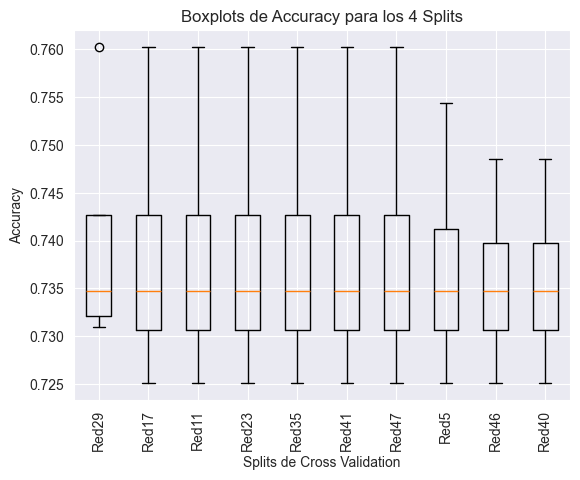

In [54]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

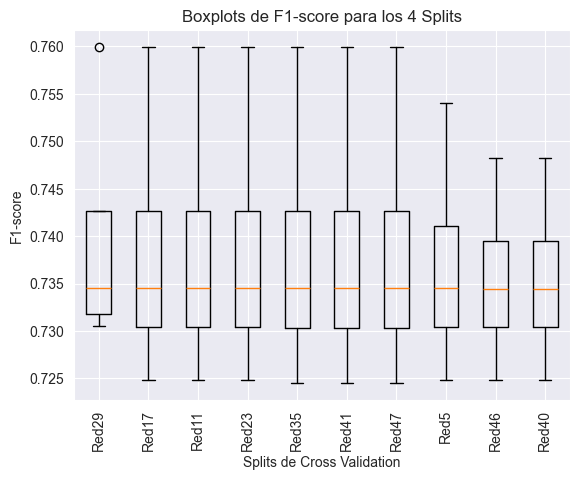

In [55]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [56]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.74015707874337 0.01178740462971306

0.7386950904392765 0.013120492392888783

0.7386950904392765 0.013120492392888783

0.7386950904392765 0.013120492392888783

0.7386950904392765 0.013120492392888783

0.7386950904392765 0.013120492392888783

0.7386950904392765 0.013120492392888783

0.7372331021351829 0.010750838186125584

0.7357711138310893 0.008475740769071278

0.7357711138310893 0.008475740769071278



In [57]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7398798457441585 0.011805306117944704

0.7384460411388908 0.01312662066326692

0.7384460411388908 0.01312662066326692

0.7384460411388908 0.01312662066326692

0.7383800183048762 0.013195536028912632

0.7383800183048762 0.013195536028912632

0.7383800183048762 0.013195536028912632

0.7369548723149607 0.010718281191821801

0.735446364673041 0.008485826008642035

0.735446364673041 0.008485826008642035



In [59]:
# Best in F1
red0 = MLPClassifier(**results.iloc[0].params, random_state=seed)
# Best in variability
red8 = MLPClassifier(**results.iloc[8].params, random_state=seed)
# Balanced
red7 = MLPClassifier(**results.iloc[7].params, random_state=seed)

In [60]:
red0.fit(X_train, y_train)
red8.fit(X_train, y_train)
red7.fit(X_train, y_train)

MLPClassifier(activation='tanh', alpha=0.1, hidden_layer_sizes=3, max_iter=500,
              random_state=7764)

In [63]:
y_pred = red0.predict(X_test)
y_pred_tr = red0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7489
Precisión del modelo en test: 0.7035
F-score del modelo en train: 0.7488
F-score del modelo en test: 0.7032
Matriz de confusión:
[[58 26]
 [25 63]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.70      0.69      0.69        84
           1       0.71      0.72      0.71        88

    accuracy                           0.70       172
   macro avg       0.70      0.70      0.70       172
weighted avg       0.70      0.70      0.70       172



In [64]:
y_pred = red8.predict(X_test)
y_pred_tr = red8.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7474
Precisión del modelo en test: 0.7035
F-score del modelo en train: 0.7473
F-score del modelo en test: 0.7032
Matriz de confusión:
[[58 26]
 [25 63]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.70      0.69      0.69        84
           1       0.71      0.72      0.71        88

    accuracy                           0.70       172
   macro avg       0.70      0.70      0.70       172
weighted avg       0.70      0.70      0.70       172



In [65]:
y_pred = red7.predict(X_test)
y_pred_tr = red7.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7504
Precisión del modelo en test: 0.7093
F-score del modelo en train: 0.7502
F-score del modelo en test: 0.7089
Matriz de confusión:
[[58 26]
 [24 64]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.71      0.69      0.70        84
           1       0.71      0.73      0.72        88

    accuracy                           0.71       172
   macro avg       0.71      0.71      0.71       172
weighted avg       0.71      0.71      0.71       172



Nos quedamnos claramente con la 7

In [69]:
# Testing the model over several seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    red_s_anx = MLPClassifier(**results.iloc[7].params, random_state=r_seed)
    red_s_anx.fit(X_train, y_train)
    
    y_pred = red_s_anx.predict(X_test)
    y_pred_tr = red_s_anx.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7533
Precisión del modelo en test: 0.6860
F-score del modelo en train: 0.7530
F-score del modelo en test: 0.6850
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.69      0.64      0.67        84
           1       0.68      0.73      0.70        88

    accuracy                           0.69       172
   macro avg       0.69      0.69      0.68       172
weighted avg       0.69      0.69      0.69       172

**************************************************
Precisión del modelo en train: 0.7124
Precisión del modelo en test: 0.6977
F-score del modelo en train: 0.7124
F-score del modelo en test: 0.6970
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.70      0.67      0.68        84
           1       0.70      0.73      0.71        88

    accuracy                           0.70       172
   macro avg       0.70      0.70      0.70       172
weight

In [70]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.6976744186046512
0.006128445077845707


In [71]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.6972833375329406
0.006364877281449506


##### SANOS VS DEPRESIÓN

In [73]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 2])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [74]:
X.shape

(747, 13)

In [75]:
print(f'La frecuencia de cada clase es: \n{y.value_counts()}')

La frecuencia de cada clase es: 
label
0    414
2    333
Name: count, dtype: int64


In [78]:
red_n = MLPClassifier(random_state=seed, hidden_layer_sizes=(3), activation='tanh', alpha=0.001, solver='adam',max_iter=350)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

red_n.fit(X_train, y_train)

MLPClassifier(activation='tanh', alpha=0.001, hidden_layer_sizes=3,
              max_iter=350, random_state=7764)

In [79]:
print(red_n.classes_)

print(red_n.feature_names_in_)

# Convergency iterations
print(red_n.n_iter_)

print(red_n.coefs_)

[0 2]
['complexityILFW' 'complexityhuerta' 'stylometryTTR' 'complexitymu'
 'emotionsurprise' 'complexitynSyllabes' 'complexitynSentences' 'ironyNI'
 'polarityNEG' 'complexitynPuntuationMarks' 'emotionsadness' 'emotionfear'
 'stylometryHerdan']
335
[array([[-0.94618557, -0.21506095,  0.84367968],
       [-0.02706928, -0.65251156,  0.0924417 ],
       [-0.53244413, -0.06320962,  0.59436927],
       [ 0.29004784, -0.08615483, -0.31307107],
       [-0.24409177, -1.04696446,  0.12707058],
       [ 0.04612419,  0.37242581,  0.22058071],
       [ 0.07286077, -0.51271634, -0.20485817],
       [-0.05658513,  0.32424692, -0.64488891],
       [ 0.39519732,  0.18266247, -0.13251706],
       [-0.01964975, -0.1634305 ,  0.41639461],
       [ 0.45617891,  0.45346938, -0.99856629],
       [ 0.71568998,  1.09463218, -0.09844307],
       [ 0.32156627, -0.70266814, -0.34949614]]), array([[ 1.18375068],
       [ 1.60599517],
       [-1.00865222]])]


In [80]:
y_pred = red_n.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.7533
F-score del modelo en test: 0.7423
Matriz de confusión:
[[72 14]
 [23 41]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.76      0.84      0.80        86
           2       0.75      0.64      0.69        64

    accuracy                           0.75       150
   macro avg       0.75      0.74      0.74       150
weighted avg       0.75      0.75      0.75       150



In [81]:
y_pred_tr = red_n.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(red_n, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.7404
Precisión del modelo en test: 0.7533
F-score del modelo en train: 0.7338
F-score del modelo en test: 0.7423
Precisión promedio mediante validación cruzada: 0.7285


In [87]:
# Grid search
red = MLPClassifier(random_state=seed)

params = {
    'max_iter': [300, 350, 400, 500], 
    'hidden_layer_sizes': [2,3,4,5],
    'activation': ['tanh','relu'],
    'alpha': [0.1, 0.01, 0.001, 0.0001]
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=red, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

GridSearchCV(cv=4, estimator=MLPClassifier(random_state=7764),
             param_grid={'activation': ['tanh', 'relu'],
                         'alpha': [0.1, 0.01, 0.001, 0.0001],
                         'hidden_layer_sizes': [2, 3, 4, 5],
                         'max_iter': [300, 350, 400, 500]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [88]:
best_model_mlp = grid_search.best_estimator_
best_model_mlp.get_params

<bound method BaseEstimator.get_params of MLPClassifier(alpha=0.01, hidden_layer_sizes=4, max_iter=350, random_state=7764)>

In [89]:
# Checking possible overfitting
best_model_mlp = grid_search.best_estimator_

y_train_pred = best_model_mlp.predict(X_train)
y_test_pred = best_model_mlp.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.7520938023450586
Se tiene un accuracy para test de: 0.7466666666666667
F-score del modelo en train: 0.7467
F-score del modelo en test: 0.7346


In [90]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                params  mean_test_accuracy  \
89   {'activation': 'relu', 'alpha': 0.01, 'hidden_...            0.747103   
4    {'activation': 'tanh', 'alpha': 0.1, 'hidden_l...            0.747103   
105  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.745425   
121  {'activation': 'relu', 'alpha': 0.0001, 'hidde...            0.745425   
73   {'activation': 'relu', 'alpha': 0.1, 'hidden_l...            0.745436   
20   {'activation': 'tanh', 'alpha': 0.01, 'hidden_...            0.745425   
52   {'activation': 'tanh', 'alpha': 0.0001, 'hidde...            0.745425   
36   {'activation': 'tanh', 'alpha': 0.001, 'hidden...            0.745425   
74   {'activation': 'relu', 'alpha': 0.1, 'hidden_l...            0.743770   
75   {'activation': 'relu', 'alpha': 0.1, 'hidden_l...            0.743758   

     mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
89                    0.747645       

In [91]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"Red{index}")

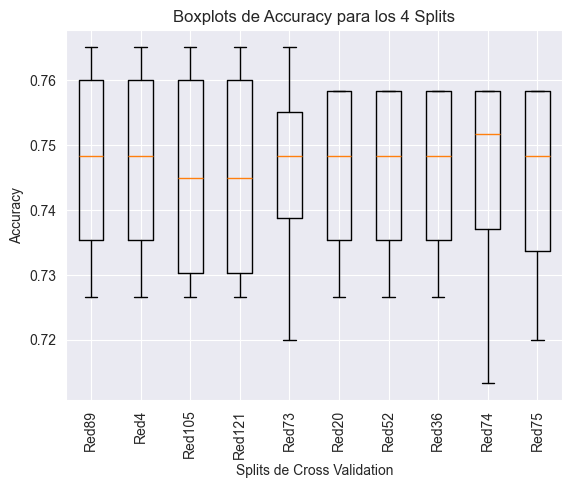

In [92]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

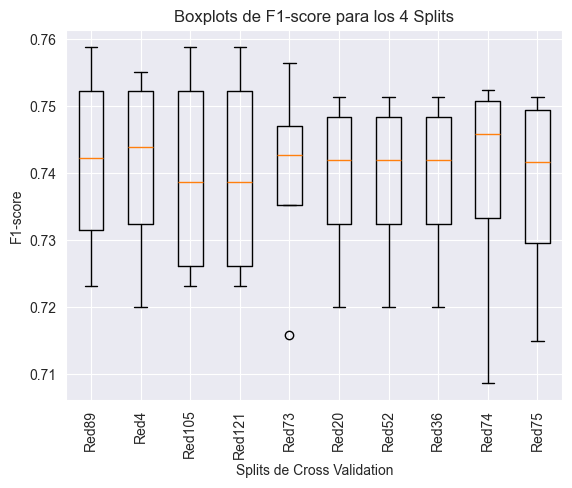

In [93]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [94]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7471029082774049 0.01538851926702488

0.7471029082774049 0.01538851926702488

0.7454250559284116 0.016581403605031887

0.7454250559284116 0.016581403605031887

0.7454362416107383 0.016377351673994813

0.7454250559284117 0.013596209521489851

0.7454250559284117 0.013596209521489851

0.7454250559284117 0.013596209521489851

0.7437695749440716 0.018406980881791806

0.743758389261745 0.015991191665770305



In [95]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7416297403736989 0.01383019153799174

0.7407995089126235 0.013838385487698555

0.739811654374738 0.015084992765463191

0.739811654374738 0.015084992765463191

0.7394732300485851 0.014741014038689852

0.7388699623567603 0.012132224249659082

0.7388699623567603 0.012132224249659082

0.7388699623567603 0.012132224249659082

0.7382349214730892 0.017551158122554856

0.7373943840271588 0.014503226672504574



In [96]:
# Best in F1
red0 = MLPClassifier(**results.iloc[0].params, random_state=seed)
# Mejor in variability
red5 = MLPClassifier(**results.iloc[5].params, random_state=seed)

In [97]:
red0.fit(X_train, y_train)
red5.fit(X_train, y_train)

MLPClassifier(activation='tanh', alpha=0.01, hidden_layer_sizes=3, max_iter=300,
              random_state=7764)

In [98]:
y_pred = red0.predict(X_test)
y_pred_tr = red0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7521
Precisión del modelo en test: 0.7467
F-score del modelo en train: 0.7467
F-score del modelo en test: 0.7346
Matriz de confusión:
[[72 14]
 [24 40]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.75      0.84      0.79        86
           2       0.74      0.62      0.68        64

    accuracy                           0.75       150
   macro avg       0.75      0.73      0.73       150
weighted avg       0.75      0.75      0.74       150



In [99]:
y_pred = red5.predict(X_test)
y_pred_tr = red5.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7387
Precisión del modelo en test: 0.7467
F-score del modelo en train: 0.7322
F-score del modelo en test: 0.7346
Matriz de confusión:
[[72 14]
 [24 40]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.75      0.84      0.79        86
           2       0.74      0.62      0.68        64

    accuracy                           0.75       150
   macro avg       0.75      0.73      0.73       150
weighted avg       0.75      0.75      0.74       150



Nos quedamos con el 5 por no tener sobreajuste

In [100]:
# Testing chosen model with various seeds

l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    red_s_dep = MLPClassifier(**results.iloc[5].params, random_state=r_seed)
    red_s_dep.fit(X_train, y_train)
    
    y_pred = red_s_dep.predict(X_test)
    y_pred_tr = red_s_dep.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7253
Precisión del modelo en test: 0.7133
F-score del modelo en train: 0.7206
F-score del modelo en test: 0.7037
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.74      0.78      0.76        86
           2       0.68      0.62      0.65        64

    accuracy                           0.71       150
   macro avg       0.71      0.70      0.70       150
weighted avg       0.71      0.71      0.71       150

**************************************************
Precisión del modelo en train: 0.7370
Precisión del modelo en test: 0.7333
F-score del modelo en train: 0.7317
F-score del modelo en test: 0.7237
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.75      0.80      0.78        86
           2       0.71      0.64      0.67        64

    accuracy                           0.73       150
   macro avg       0.73      0.72      0.72       150
weight

In [101]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.7413333333333333
0.016865480854231354


In [102]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.72961488800266
0.016861838148561847


##### SANOS VS TCA

In [116]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 3])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [105]:
X.shape

(557, 13)

In [106]:
print(f'La frecuencia de cada clase es: \n{y.value_counts()}')

La frecuencia de cada clase es: 
label
0    414
3    143
Name: count, dtype: int64


In [129]:
red_n = MLPClassifier(random_state=seed, hidden_layer_sizes=(2), activation='tanh', alpha=0.001, solver='adam',max_iter=500)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

# Resampling
smote = SMOTE(sampling_strategy='minority',random_state=seed)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

red_n.fit(X_resampled, y_resampled)

MLPClassifier(activation='tanh', alpha=0.001, hidden_layer_sizes=2,
              max_iter=500, random_state=7764)

In [130]:
print(f'La frecuencia de cada clase en train es: \n{y_resampled.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
0    320
3    320
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
0    94
3    18
Name: count, dtype: int64


In [131]:
print(red_n.classes_)

print(red_n.feature_names_in_)

# Convergency iterations
print(red_n.n_iter_)

print(red_n.coefs_)

[0 3]
['complexityILFW' 'complexityhuerta' 'stylometryTTR' 'complexitymu'
 'emotionsurprise' 'complexitynSyllabes' 'complexitynSentences' 'ironyNI'
 'polarityNEG' 'complexitynPuntuationMarks' 'emotionsadness' 'emotionfear'
 'stylometryHerdan']
498
[array([[ 0.0873175 , -0.08343803],
       [ 0.37501182, -0.00816098],
       [-0.47644909, -0.02382687],
       [-1.0193561 ,  0.74552228],
       [-0.67627109,  0.85527705],
       [-0.16278564,  0.04580177],
       [ 1.09440303, -1.25054007],
       [ 0.16683375, -0.62588668],
       [ 0.35683956,  0.23856582],
       [-0.9999798 ,  0.65037512],
       [ 0.52298046, -0.98831282],
       [-0.35013863, -0.31976916],
       [-0.46496171, -0.04114838]]), array([[-0.9098751 ],
       [ 1.74239736]])]


In [132]:
y_pred = red_n.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.5714
F-score del modelo en test: 0.5013
Matriz de confusión:
[[53 41]
 [ 7 11]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.88      0.56      0.69        94
           3       0.21      0.61      0.31        18

    accuracy                           0.57       112
   macro avg       0.55      0.59      0.50       112
weighted avg       0.78      0.57      0.63       112



In [133]:
y_pred_tr = red_n.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(red_n, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.6022
Precisión del modelo en test: 0.5714
F-score del modelo en train: 0.5890
F-score del modelo en test: 0.5013
Precisión promedio mediante validación cruzada: 0.4264


In [142]:
# Grid search
red = MLPClassifier(random_state=seed)

params = {
    'max_iter': [300, 400, 450, 500, 550], 
    'hidden_layer_sizes': [2,3,4,5],
    'activation': ['tanh','relu'],
    'alpha': [0.1, 0.01, 0.001, 0.0001]
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=red, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_resampled, y_resampled)

GridSearchCV(cv=4, estimator=MLPClassifier(random_state=7764),
             param_grid={'activation': ['tanh', 'relu'],
                         'alpha': [0.1, 0.01, 0.001, 0.0001],
                         'hidden_layer_sizes': [2, 3, 4, 5],
                         'max_iter': [300, 400, 450, 500, 550]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [150]:
# Checking for overfitting
best_model_mlp = grid_search.best_estimator_

y_train_pred = best_model_mlp.predict(X_resampled)
y_test_pred = best_model_mlp.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_resampled,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.659375
Se tiene un accuracy para test de: 0.625
F-score del modelo en train: 0.6582
F-score del modelo en test: 0.5406


In [152]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                params  mean_test_accuracy  \
39   {'activation': 'tanh', 'alpha': 0.01, 'hidden_...            0.642188   
38   {'activation': 'tanh', 'alpha': 0.01, 'hidden_...            0.642188   
143  {'activation': 'relu', 'alpha': 0.0001, 'hidde...            0.643750   
17   {'activation': 'tanh', 'alpha': 0.1, 'hidden_l...            0.640625   
123  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.642188   
144  {'activation': 'relu', 'alpha': 0.0001, 'hidde...            0.642188   
37   {'activation': 'tanh', 'alpha': 0.01, 'hidden_...            0.639062   
19   {'activation': 'tanh', 'alpha': 0.1, 'hidden_l...            0.639063   
18   {'activation': 'tanh', 'alpha': 0.1, 'hidden_l...            0.639063   
124  {'activation': 'relu', 'alpha': 0.001, 'hidden...            0.640625   

     mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
39                    0.647079       

In [153]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"Red{index}")

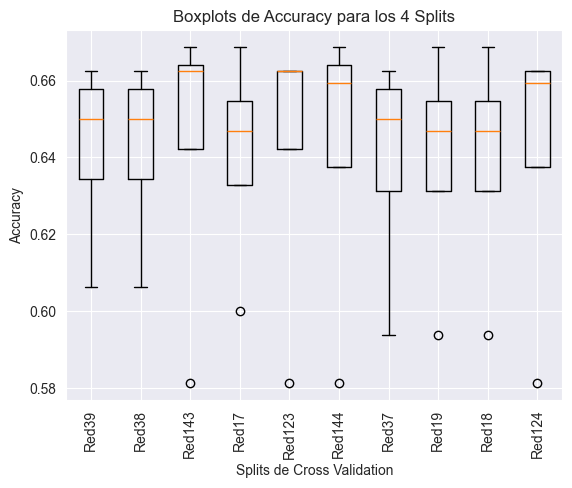

In [154]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

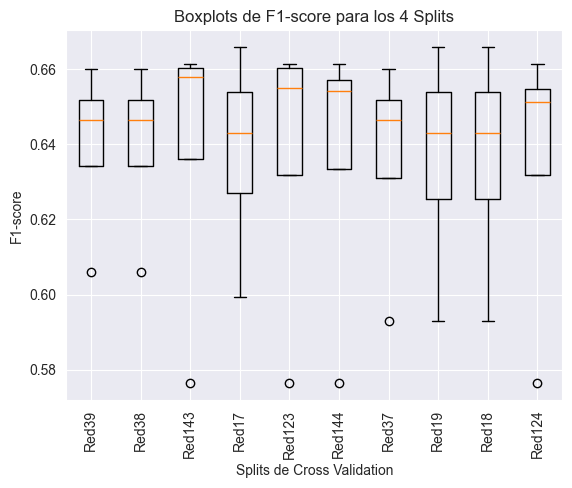

In [155]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [156]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.6421875 0.021819125068388984

0.6421875 0.021819125068388984

0.64375 0.03617449032121942

0.640625 0.02519455546343297

0.6421875 0.035182282028742795

0.6421875 0.0354587678684694

0.6390625 0.02701815072779778

0.6390625000000001 0.02773162398327944

0.6390625000000001 0.02773162398327944

0.640625 0.034374999999999975



In [157]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.6396572909254556 0.02023545673069433

0.6396572909254556 0.02023545673069433

0.6383428667175972 0.035777541001148945

0.6378159317374097 0.02450745207298962

0.636935927026679 0.03516765083729532

0.6364501158916743 0.03477341276183205

0.6363721402556511 0.025734338032701073

0.6361994849956218 0.027065288656528366

0.6361994849956218 0.027065288656528366

0.6350431762007561 0.03406751367367085



In [158]:
# Overall best
red0 = MLPClassifier(**results.iloc[0].params, random_state=seed)

In [159]:
red0.fit(X_resampled, y_resampled)

MLPClassifier(activation='tanh', alpha=0.01, hidden_layer_sizes=5, max_iter=550,
              random_state=7764)

In [160]:
y_pred = red0.predict(X_test)
y_pred_tr = red0.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.6594
Precisión del modelo en test: 0.6250
F-score del modelo en train: 0.6582
F-score del modelo en test: 0.5406
Matriz de confusión:
[[59 35]
 [ 7 11]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.89      0.63      0.74        94
           3       0.24      0.61      0.34        18

    accuracy                           0.62       112
   macro avg       0.57      0.62      0.54       112
weighted avg       0.79      0.62      0.67       112



In [161]:
# Testing the model
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    red_n = MLPClassifier(**results.iloc[0].params, random_state=r_seed)
    red_n.fit(X_resampled, y_resampled)
    
    y_pred = red_n.predict(X_test)
    y_pred_tr = red_n.predict(X_resampled)
    
    precision_tr = accuracy_score(y_resampled, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.6672
Precisión del modelo en test: 0.6429
F-score del modelo en train: 0.6669
F-score del modelo en test: 0.5540
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.90      0.65      0.75        94
           3       0.25      0.61      0.35        18

    accuracy                           0.64       112
   macro avg       0.57      0.63      0.55       112
weighted avg       0.79      0.64      0.69       112

**************************************************
Precisión del modelo en train: 0.6516
Precisión del modelo en test: 0.5982
F-score del modelo en train: 0.6484
F-score del modelo en test: 0.5288
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.90      0.59      0.71        94
           3       0.24      0.67      0.35        18

    accuracy                           0.60       112
   macro avg       0.57      0.63      0.53       112
weight

In [164]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.6151785714285715
0.02899304494751798


In [165]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.5405866053351405
0.020291317269001945


#### Regresión logística

##### SANOS VS ANSIEDAD

In [69]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 1])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

El mejor modelo en regresión logística fue sorprendentemente, el que entrenamos con valores por defecto por lo que volveremos a usarlo. Esta vez estableceremoss la opción para clasificación binaria.

In [70]:
lr = LogisticRegression(random_state=seed, multi_class='ovr')
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

lr.fit(X_train, y_train)

LogisticRegression(multi_class='ovr', random_state=7764)

In [71]:
y_pred = lr.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.7151
F-score del modelo en test: 0.7139
Matriz de confusión:
[[56 28]
 [21 67]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.73      0.67      0.70        84
           1       0.71      0.76      0.73        88

    accuracy                           0.72       172
   macro avg       0.72      0.71      0.71       172
weighted avg       0.72      0.72      0.71       172



In [72]:
y_pred_tr = lr.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(lr, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.7591
Precisión del modelo en test: 0.7151
F-score del modelo en train: 0.7586
F-score del modelo en test: 0.7139
Precisión promedio mediante validación cruzada: 0.7129


In [73]:
# Grid search
lr = LogisticRegression(random_state=seed)

params = {
    'penalty': ['l1', 'l2', 'elasticnet', None], 
    'C': [0.1, 1, 3, 5, 10],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'max_iter': [15, 20, 25, 40, 50],
    'tol': [0.001, 0.01, 0.05, 0.1],
    'multi_class': ['ovr']
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=lr, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

GridSearchCV(cv=4, estimator=LogisticRegression(random_state=7764),
             param_grid={'C': [0.1, 1, 3, 5, 10],
                         'max_iter': [15, 20, 25, 40, 50],
                         'multi_class': ['ovr'],
                         'penalty': ['l1', 'l2', 'elasticnet', None],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag',
                                    'saga'],
                         'tol': [0.001, 0.01, 0.05, 0.1]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [74]:
# Checking overfitting
best_model_lr = grid_search.best_estimator_

y_train_pred = best_model_lr.predict(X_train)
y_test_pred = best_model_lr.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.762043795620438
Se tiene un accuracy para test de: 0.6976744186046512
F-score del modelo en train: 0.7616
F-score del modelo en test: 0.6970


In [75]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                 params  mean_test_accuracy  \
1312  {'C': 5, 'max_iter': 20, 'multi_class': 'ovr',...            0.763481   
1313  {'C': 5, 'max_iter': 20, 'multi_class': 'ovr',...            0.760557   
1154  {'C': 3, 'max_iter': 50, 'multi_class': 'ovr',...            0.760565   
914   {'C': 3, 'max_iter': 20, 'multi_class': 'ovr',...            0.760565   
834   {'C': 3, 'max_iter': 15, 'multi_class': 'ovr',...            0.760565   
994   {'C': 3, 'max_iter': 25, 'multi_class': 'ovr',...            0.760565   
1074  {'C': 3, 'max_iter': 40, 'multi_class': 'ovr',...            0.760565   
912   {'C': 3, 'max_iter': 20, 'multi_class': 'ovr',...            0.759120   
836   {'C': 3, 'max_iter': 15, 'multi_class': 'ovr',...            0.757675   
1314  {'C': 5, 'max_iter': 20, 'multi_class': 'ovr',...            0.757633   

      mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
1312                   0.

In [76]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"LR{index}")

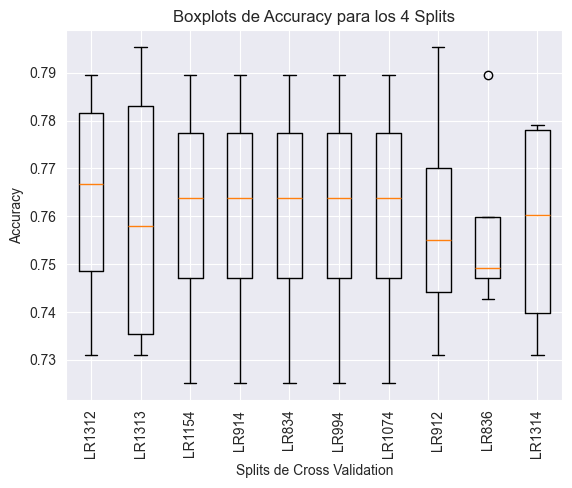

In [77]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

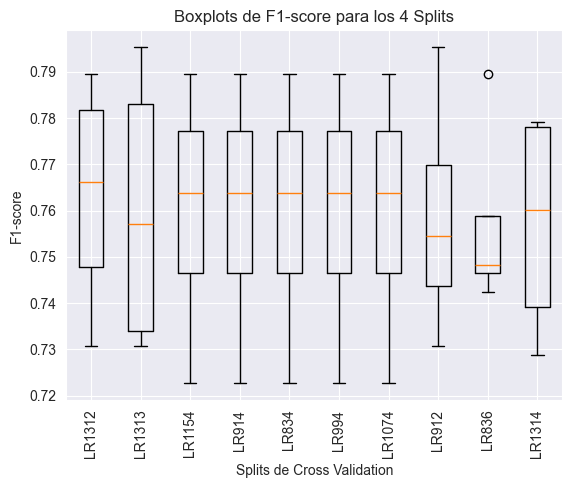

In [78]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [26]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7634808921528627 0.022675671191611253

0.7605569155446756 0.027329749291002587

0.7605654154766762 0.023924050304044313

0.7605654154766762 0.023924050304044313

0.7605654154766762 0.023924050304044313

0.7605654154766762 0.023924050304044313

0.7605654154766762 0.023924050304044313

0.7591204270365837 0.023557854043921033

0.7576754385964912 0.0185613507684132

0.7576329389364884 0.02120298794755262



In [27]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7631589314132547 0.022856288257313152

0.7600409420037273 0.027769532521762487

0.7599527115247149 0.02482583948043042

0.7599527115247149 0.02482583948043042

0.7599527115247149 0.02482583948043042

0.7599527115247149 0.02482583948043042

0.7599527115247149 0.02482583948043042

0.7588261165340027 0.023678559000230737

0.7571216123623614 0.018825210465577613

0.7571073481039943 0.021866670146468828



In [28]:
# Best in F1
rl0 = LogisticRegression(**results.iloc[0].params, random_state=seed)
# Best in variability
rl8 = LogisticRegression(**results.iloc[8].params, random_state=seed)

In [29]:
rl0.fit(X_train, y_train)
rl8.fit(X_train, y_train)

LogisticRegression(C=3, max_iter=15, multi_class='ovr', random_state=7764,
                   solver='saga', tol=0.001)

In [31]:
y_pred = rl0.predict(X_test)
y_pred_tr = rl0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7620
Precisión del modelo en test: 0.6977
F-score del modelo en train: 0.7616
F-score del modelo en test: 0.6970
Matriz de confusión:
[[56 28]
 [24 64]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.70      0.67      0.68        84
           1       0.70      0.73      0.71        88

    accuracy                           0.70       172
   macro avg       0.70      0.70      0.70       172
weighted avg       0.70      0.70      0.70       172



In [32]:
y_pred = rl8.predict(X_test)
y_pred_tr = rl8.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7664
Precisión del modelo en test: 0.7035
F-score del modelo en train: 0.7661
F-score del modelo en test: 0.7027
Matriz de confusión:
[[56 28]
 [23 65]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.71      0.67      0.69        84
           1       0.70      0.74      0.72        88

    accuracy                           0.70       172
   macro avg       0.70      0.70      0.70       172
weighted avg       0.70      0.70      0.70       172



De nuevo, el modelo por defecto es el que mejor resultados garantiza

In [34]:
# Testing with several seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    lr = LogisticRegression(random_state=r_seed, multi_class='ovr')
    lr.fit(X_train, y_train)
    
    y_pred = lr.predict(X_test)
    y_pred_tr = lr.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7591
Precisión del modelo en test: 0.7151
F-score del modelo en train: 0.7586
F-score del modelo en test: 0.7139
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.73      0.67      0.70        84
           1       0.71      0.76      0.73        88

    accuracy                           0.72       172
   macro avg       0.72      0.71      0.71       172
weighted avg       0.72      0.72      0.71       172

**************************************************
Precisión del modelo en train: 0.7591
Precisión del modelo en test: 0.7151
F-score del modelo en train: 0.7586
F-score del modelo en test: 0.7139
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.73      0.67      0.70        84
           1       0.71      0.76      0.73        88

    accuracy                           0.72       172
   macro avg       0.72      0.71      0.71       172
weight

In [35]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.7151162790697675
0.0


In [36]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.7139463055357567
0.0


##### SANOS VS DEPRESIÓN

In [79]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 2])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [80]:
lr = LogisticRegression(random_state=seed, multi_class='ovr')
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

lr.fit(X_train, y_train)

LogisticRegression(multi_class='ovr', random_state=7764)

In [81]:
y_pred = lr.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.7800
F-score del modelo en test: 0.7726
Matriz de confusión:
[[72 14]
 [19 45]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.79      0.84      0.81        86
           2       0.76      0.70      0.73        64

    accuracy                           0.78       150
   macro avg       0.78      0.77      0.77       150
weighted avg       0.78      0.78      0.78       150



In [82]:
y_pred_tr = lr.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(lr, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.7454
Precisión del modelo en test: 0.7800
F-score del modelo en train: 0.7391
F-score del modelo en test: 0.7726
Precisión promedio mediante validación cruzada: 0.7373


In [83]:
# Grid search

lr = LogisticRegression(random_state=seed)

params = {
    'penalty': ['l1', 'l2', 'elasticnet', None], 
    'C': [3, 5, 10, 15, 20],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'max_iter': [10, 15, 20, 25],
    'tol': [0.001, 0.01, 0.05, 0.1],
    'multi_class': ['ovr']
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=lr, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

GridSearchCV(cv=4, estimator=LogisticRegression(random_state=7764),
             param_grid={'C': [3, 5, 10, 15, 20], 'max_iter': [10, 15, 20, 25],
                         'multi_class': ['ovr'],
                         'penalty': ['l1', 'l2', 'elasticnet', None],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag',
                                    'saga'],
                         'tol': [0.001, 0.01, 0.05, 0.1]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [84]:
best_model = grid_search.best_estimator_
print(grid_search.best_estimator_)

LogisticRegression(C=10, max_iter=15, multi_class='ovr', random_state=7764,
                   solver='sag', tol=0.001)


In [85]:
# Checking for overfitting
best_model_lr = grid_search.best_estimator_

y_train_pred = best_model_lr.predict(X_train)
y_test_pred = best_model_lr.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.7520938023450586
Se tiene un accuracy para test de: 0.8
F-score del modelo en train: 0.7462
F-score del modelo en test: 0.7917


In [86]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                 params  mean_test_accuracy  \
1393  {'C': 20, 'max_iter': 15, 'multi_class': 'ovr'...            0.753758   
1073  {'C': 15, 'max_iter': 15, 'multi_class': 'ovr'...            0.753758   
1072  {'C': 15, 'max_iter': 15, 'multi_class': 'ovr'...            0.753758   
752   {'C': 10, 'max_iter': 15, 'multi_class': 'ovr'...            0.753758   
753   {'C': 10, 'max_iter': 15, 'multi_class': 'ovr'...            0.753758   
1392  {'C': 20, 'max_iter': 15, 'multi_class': 'ovr'...            0.753758   
420   {'C': 5, 'max_iter': 15, 'multi_class': 'ovr',...            0.750425   
580   {'C': 5, 'max_iter': 25, 'multi_class': 'ovr',...            0.750425   
340   {'C': 5, 'max_iter': 10, 'multi_class': 'ovr',...            0.750425   
500   {'C': 5, 'max_iter': 20, 'multi_class': 'ovr',...            0.750425   

      mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
1393                   0.

In [87]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"LR{index}")

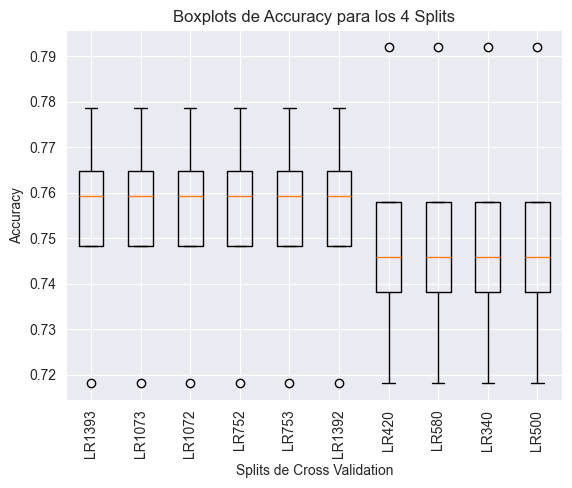

In [88]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

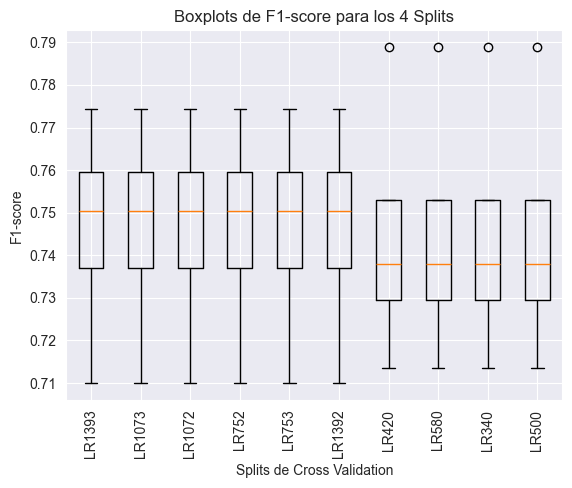

In [89]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [90]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.753758389261745 0.0220439917070324

0.753758389261745 0.0220439917070324

0.753758389261745 0.0220439917070324

0.753758389261745 0.0220439917070324

0.753758389261745 0.0220439917070324

0.753758389261745 0.0220439917070324

0.7504250559284116 0.02651179446698763

0.7504250559284116 0.02651179446698763

0.7504250559284116 0.02651179446698763

0.7504250559284116 0.02651179446698763



In [91]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.746266429448537 0.023371978508500976

0.746266429448537 0.023371978508500976

0.746266429448537 0.023371978508500976

0.746266429448537 0.023371978508500976

0.746266429448537 0.023371978508500976

0.746266429448537 0.023371978508500976

0.7445872584677299 0.02754481391776923

0.7445872584677299 0.02754481391776923

0.7445872584677299 0.02754481391776923

0.7445872584677299 0.02754481391776923



In [92]:
# Best
rl0 = LogisticRegression(**results.iloc[0].params, random_state=seed)

In [93]:
rl0.fit(X_train, y_train)

LogisticRegression(C=20, max_iter=15, multi_class='ovr', random_state=7764,
                   solver='sag', tol=0.01)

In [94]:
y_pred = rl0.predict(X_test)
y_pred_tr = rl0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7504
Precisión del modelo en test: 0.8000
F-score del modelo en train: 0.7449
F-score del modelo en test: 0.7917
Matriz de confusión:
[[75 11]
 [19 45]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.80      0.87      0.83        86
           2       0.80      0.70      0.75        64

    accuracy                           0.80       150
   macro avg       0.80      0.79      0.79       150
weighted avg       0.80      0.80      0.80       150



In [95]:
# Testing the model over several seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    lr = LogisticRegression(**results.iloc[0].params, random_state=r_seed)
    lr.fit(X_train, y_train)
    
    y_pred = lr.predict(X_test)
    y_pred_tr = lr.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7471
Precisión del modelo en test: 0.7933
F-score del modelo en train: 0.7409
F-score del modelo en test: 0.7853
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.80      0.86      0.83        86
           2       0.79      0.70      0.74        64

    accuracy                           0.79       150
   macro avg       0.79      0.78      0.79       150
weighted avg       0.79      0.79      0.79       150

**************************************************
Precisión del modelo en train: 0.7487
Precisión del modelo en test: 0.8000
F-score del modelo en train: 0.7428
F-score del modelo en test: 0.7917
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.80      0.87      0.83        86
           2       0.80      0.70      0.75        64

    accuracy                           0.80       150
   macro avg       0.80      0.79      0.79       150
weight

In [98]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.7926666666666666
0.007336699564097417


In [99]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.7839164087472915
0.008473964419620346


##### SANOS VS TCA

In [123]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 3])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [124]:
lr = LogisticRegression(random_state=seed, class_weight='balanced', multi_class='ovr')
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

lr.fit(X_train, y_train)

LogisticRegression(class_weight='balanced', multi_class='ovr',
                   random_state=7764)

In [125]:
print(f'La frecuencia de cada clase en train es: \n{y_resampled.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
0    320
3    320
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
0    94
3    18
Name: count, dtype: int64


In [126]:
y_pred = lr.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.6518
F-score del modelo en test: 0.5774
Matriz de confusión:
[[60 34]
 [ 5 13]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.92      0.64      0.75        94
           3       0.28      0.72      0.40        18

    accuracy                           0.65       112
   macro avg       0.60      0.68      0.58       112
weighted avg       0.82      0.65      0.70       112



In [127]:
y_pred_tr = lr.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(lr, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.6247
Precisión del modelo en test: 0.6518
F-score del modelo en train: 0.6030
F-score del modelo en test: 0.5774
Precisión promedio mediante validación cruzada: 0.5603


In [150]:
# Grid search

lr = LogisticRegression(random_state=seed)

params = {
    'penalty': ['l1', 'l2', 'elasticnet', None], 
    'C': [2, 3, 4, 10, 15],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'max_iter': [10, 15, 20, 25],
    'tol': [0.001, 0.01, 0.05, 0.1, 0.2],
    'class_weight': ['balanced'],
    'multi_class': ['ovr']
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=lr, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

GridSearchCV(cv=4, estimator=LogisticRegression(random_state=7764),
             param_grid={'C': [2, 3, 4, 10, 15], 'class_weight': ['balanced'],
                         'max_iter': [10, 15, 20, 25], 'multi_class': ['ovr'],
                         'penalty': ['l1', 'l2', 'elasticnet', None],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag',
                                    'saga'],
                         'tol': [0.001, 0.01, 0.05, 0.1, 0.2]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [151]:
best_model = grid_search.best_estimator_
print(grid_search.best_estimator_)

LogisticRegression(C=2, class_weight='balanced', max_iter=10, multi_class='ovr',
                   random_state=7764, solver='sag', tol=0.05)


In [152]:
# Checking for overfitting
best_model_lr = grid_search.best_estimator_

y_train_pred = best_model_lr.predict(X_train)
y_test_pred = best_model_lr.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.6629213483146067
Se tiene un accuracy para test de: 0.6785714285714286
F-score del modelo en train: 0.6276
F-score del modelo en test: 0.5812


In [153]:
# Obtaining best results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                params  mean_test_accuracy  \
42   {'C': 2, 'class_weight': 'balanced', 'max_iter...            0.665199   
743  {'C': 3, 'class_weight': 'balanced', 'max_iter...            0.665279   
643  {'C': 3, 'class_weight': 'balanced', 'max_iter...            0.665279   
543  {'C': 3, 'class_weight': 'balanced', 'max_iter...            0.665279   
20   {'C': 2, 'class_weight': 'balanced', 'max_iter...            0.649413   
21   {'C': 2, 'class_weight': 'balanced', 'max_iter...            0.649413   
242  {'C': 2, 'class_weight': 'balanced', 'max_iter...            0.656190   
342  {'C': 2, 'class_weight': 'balanced', 'max_iter...            0.656190   
142  {'C': 2, 'class_weight': 'balanced', 'max_iter...            0.656190   
121  {'C': 2, 'class_weight': 'balanced', 'max_iter...            0.649413   

     mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
42                    0.629873       

In [154]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"LR{index}")

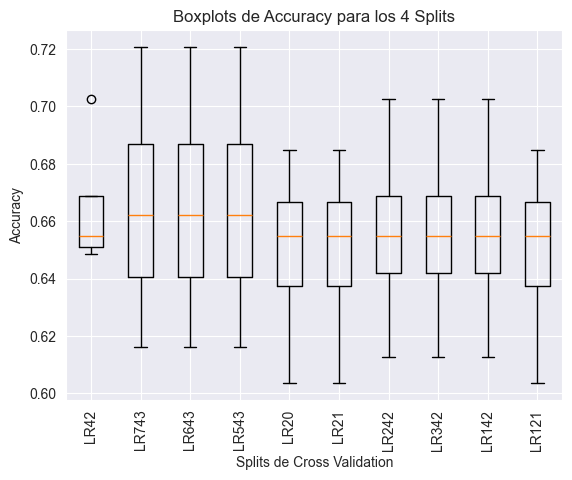

In [155]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

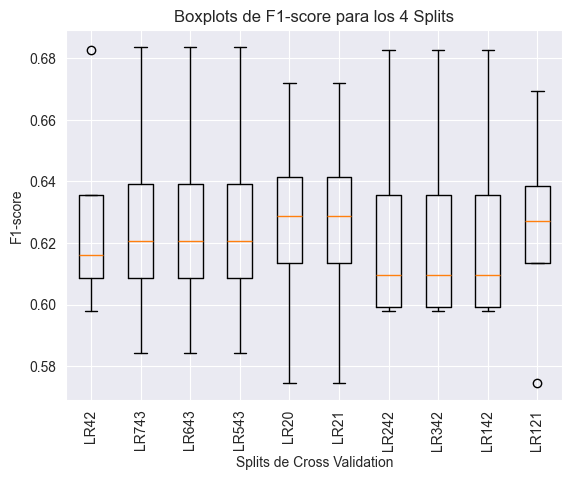

In [156]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [157]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.6651986808236808 0.021893092083097015

0.6652791184041185 0.03834002130115099

0.6652791184041185 0.03834002130115099

0.6652791184041185 0.03834002130115099

0.6494128056628057 0.029457154607714378

0.6494128056628057 0.029457154607714378

0.6561896718146718 0.03195298090727516

0.6561896718146718 0.03195298090727516

0.6561896718146718 0.03195298090727516

0.6494128056628057 0.029457154607714378



In [158]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.628133604355243 0.032364042189370966

0.6272749122369997 0.03587881411802028

0.6272749122369997 0.03587881411802028

0.6272749122369997 0.03587881411802028

0.6260117984271764 0.03453958631066849

0.6260117984271764 0.03453958631066849

0.6249695139050246 0.03431982373306545

0.6249695139050246 0.03431982373306545

0.6249695139050246 0.03431982373306545

0.6245777859982435 0.03358095590520099



In [159]:
# Best model
rl0 = LogisticRegression(**results.iloc[0].params, random_state=seed)

In [160]:
rl0.fit(X_train, y_train)

LogisticRegression(C=2, class_weight='balanced', max_iter=10, multi_class='ovr',
                   random_state=7764, solver='sag', tol=0.05)

In [161]:
y_pred = rl0.predict(X_test)
y_pred_tr = rl0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.6629
Precisión del modelo en test: 0.6786
F-score del modelo en train: 0.6276
F-score del modelo en test: 0.5812
Matriz de confusión:
[[65 29]
 [ 7 11]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.90      0.69      0.78        94
           3       0.28      0.61      0.38        18

    accuracy                           0.68       112
   macro avg       0.59      0.65      0.58       112
weighted avg       0.80      0.68      0.72       112



In [162]:
# Testing the model over several seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    lr = LogisticRegression(**results.iloc[0].params, random_state=r_seed)
    lr.fit(X_train, y_train)
    
    y_pred = lr.predict(X_test)
    y_pred_tr = lr.predict(X_train)
    
    # Calcular la precisión del modelo
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    # Calcular el F1 score
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    # Mostrar el informe de clasificación
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.6202
Precisión del modelo en test: 0.6071
F-score del modelo en train: 0.6033
F-score del modelo en test: 0.5354
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.90      0.60      0.72        94
           3       0.24      0.67      0.35        18

    accuracy                           0.61       112
   macro avg       0.57      0.63      0.54       112
weighted avg       0.80      0.61      0.66       112

**************************************************
Precisión del modelo en train: 0.6449
Precisión del modelo en test: 0.6518
F-score del modelo en train: 0.6186
F-score del modelo en test: 0.5774
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.92      0.64      0.75        94
           3       0.28      0.72      0.40        18

    accuracy                           0.65       112
   macro avg       0.60      0.68      0.58       112
weight

In [163]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.65
0.04776762535175924


In [165]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.5646790715886224
0.025409623390164067


#### Random forest

##### SANOS  VS ANSIEDAD

In [102]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 1])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [103]:
rf = RandomForestClassifier(n_estimators = 60,bootstrap = True, max_depth = 7, 
                             min_samples_split=10, criterion='entropy', 
                             max_features= None, random_state=seed)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

rf.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_depth=7, max_features=None,
                       min_samples_split=10, n_estimators=60,
                       random_state=7764)

In [104]:
print(f'La frecuencia de cada clase en train es: \n{y_train.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
1    355
0    330
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
1    88
0    84
Name: count, dtype: int64


In [105]:
y_pred = rf.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.6860
F-score del modelo en test: 0.6833
Matriz de confusión:
[[51 33]
 [21 67]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.71      0.61      0.65        84
           1       0.67      0.76      0.71        88

    accuracy                           0.69       172
   macro avg       0.69      0.68      0.68       172
weighted avg       0.69      0.69      0.68       172



In [106]:
y_pred_tr = rf.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(rf, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.9328
Precisión del modelo en test: 0.6860
F-score del modelo en train: 0.9328
F-score del modelo en test: 0.6833
Precisión promedio mediante validación cruzada: 0.7411


In [107]:
# Hyperparameter search
params = {
    'n_estimators' : [100,200,250,300],
    'max_depth': [3,4], # if depth is decreased more than 3, performance in teste decreases drasticaly
    'bootstrap': [True],
    'min_samples_split': [140, 160, 180, 200],
    'criterion': ["entropy", "gini"],
    'max_features': [None],
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=rf, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

GridSearchCV(cv=4,
             estimator=RandomForestClassifier(criterion='entropy', max_depth=7,
                                              max_features=None,
                                              min_samples_split=10,
                                              n_estimators=60,
                                              random_state=7764),
             param_grid={'bootstrap': [True], 'criterion': ['entropy', 'gini'],
                         'max_depth': [3, 4], 'max_features': [None],
                         'min_samples_split': [140, 160, 180, 200],
                         'n_estimators': [100, 200, 250, 300]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [108]:
best_model_rf = grid_search.best_estimator_
best_model_rf.get_params

<bound method BaseEstimator.get_params of RandomForestClassifier(max_depth=4, max_features=None, min_samples_split=140,
                       random_state=7764)>

In [109]:
# Checking overfitting
best_model_rf = grid_search.best_estimator_

y_train_pred = best_model_rf.predict(X_train)
y_test_pred = best_model_rf.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.7591240875912408
Se tiene un accuracy para test de: 0.6569767441860465
F-score del modelo en train: 0.7579
F-score del modelo en test: 0.6507


In [110]:
# Obtaining hyperparameter search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                               params  mean_test_accuracy  \
48  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.740115   
52  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.738644   
36  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.738644   
59  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.738636   
58  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.738636   
42  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.738636   
43  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.738636   
34  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.737182   
41  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.737174   
57  {'bootstrap': True, 'criterion': 'gini', 'max_...            0.737174   

    mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
48                   0.741300                0.73

In [111]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"RF{index}")

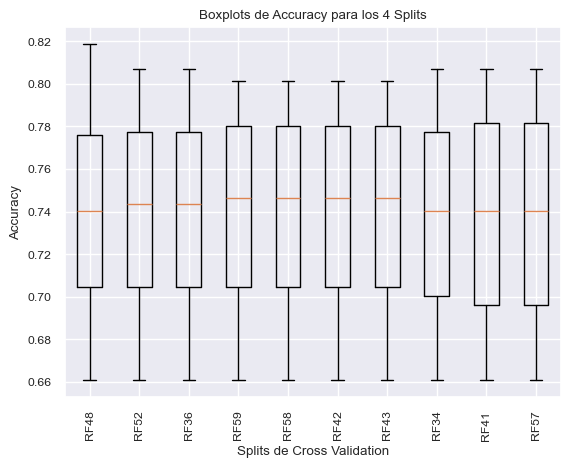

In [112]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

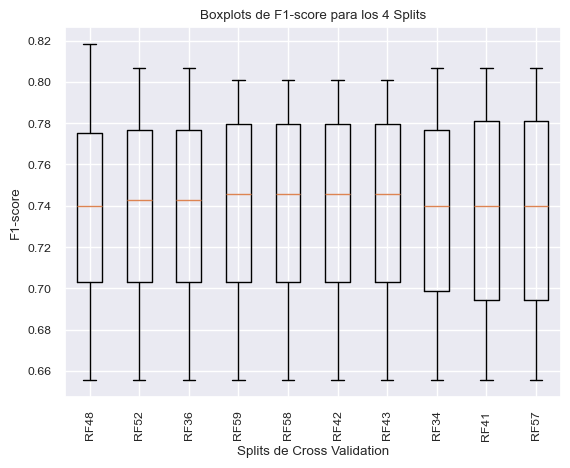

In [113]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [114]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7401145790833674 0.05779653942492316

0.7386440908472732 0.05462438033188301

0.7386440908472732 0.05462438033188301

0.7386355909152728 0.053708612686646055

0.7386355909152728 0.053708612686646055

0.7386355909152728 0.053708612686646055

0.7386355909152728 0.053708612686646055

0.7371821025431796 0.0551978437529377

0.7371736026111791 0.056755243863633856

0.7371736026111791 0.056755243863633856



In [115]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7384119491506108 0.05938720692307033

0.7370673959158702 0.056317846060737385

0.7370673959158702 0.056317846060737385

0.7370212049489394 0.055492804405842

0.7370212049489394 0.055492804405842

0.7370212049489394 0.055492804405842

0.7370212049489394 0.055492804405842

0.7356172124230931 0.05683129944483294

0.7355975220906539 0.05837797370457408

0.7355975220906539 0.05837797370457408



In [116]:
# Best overall
rf0 = RandomForestClassifier(**results.iloc[0].params, random_state=seed)
# Best in variability
rf3 = RandomForestClassifier(**results.iloc[3].params, random_state=seed)

In [122]:
rf0.fit(X_train, y_train)
rf3.fit(X_train, y_train)

RandomForestClassifier(max_depth=4, max_features=None, min_samples_split=180,
                       n_estimators=300, random_state=7764)

In [118]:
y_pred = rf0.predict(X_test)
y_pred_tr = rf0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7591
Precisión del modelo en test: 0.6570
F-score del modelo en train: 0.7579
F-score del modelo en test: 0.6507
Matriz de confusión:
[[45 39]
 [20 68]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.69      0.54      0.60        84
           1       0.64      0.77      0.70        88

    accuracy                           0.66       172
   macro avg       0.66      0.65      0.65       172
weighted avg       0.66      0.66      0.65       172



In [119]:
y_pred = rf3.predict(X_test)
y_pred_tr = rf3.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7577
Precisión del modelo en test: 0.6395
F-score del modelo en train: 0.7564
F-score del modelo en test: 0.6324
Matriz de confusión:
[[43 41]
 [21 67]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.67      0.51      0.58        84
           1       0.62      0.76      0.68        88

    accuracy                           0.64       172
   macro avg       0.65      0.64      0.63       172
weighted avg       0.65      0.64      0.63       172



In [120]:
rf0.get_params

<bound method BaseEstimator.get_params of RandomForestClassifier(max_depth=4, max_features=None, min_samples_split=140,
                       random_state=7764)>

In [237]:
# Testing chosen model over different seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    rf = RandomForestClassifier(**results.iloc[0].params, random_state=r_seed)
    rf.fit(X_train, y_train)
    
    y_pred = rf.predict(X_test)
    y_pred_tr = rf.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7562
Precisión del modelo en test: 0.6570
F-score del modelo en train: 0.7548
F-score del modelo en test: 0.6507
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.69      0.54      0.60        84
           1       0.64      0.77      0.70        88

    accuracy                           0.66       172
   macro avg       0.66      0.65      0.65       172
weighted avg       0.66      0.66      0.65       172

**************************************************
Precisión del modelo en train: 0.7606
Precisión del modelo en test: 0.6628
F-score del modelo en train: 0.7592
F-score del modelo en test: 0.6572
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.70      0.55      0.61        84
           1       0.64      0.77      0.70        88

    accuracy                           0.66       172
   macro avg       0.67      0.66      0.66       172
weight

In [238]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.6540697674418605
0.014306999089373423


In [239]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.6477550514809037
0.015491852154778033


##### SANOS VS DEPRESIÓN

In [305]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 2])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [306]:
rf = RandomForestClassifier(n_estimators = 60,bootstrap = True, max_depth = 7, 
                             min_samples_split=10, criterion='entropy', 
                             max_features= None, class_weight='balanced', random_state=seed)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

rf.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=7, max_features=None, min_samples_split=10,
                       n_estimators=60, random_state=7764)

In [307]:
print(f'La frecuencia de cada clase en train es: \n{y_train.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
0    328
2    269
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
0    86
2    64
Name: count, dtype: int64


In [308]:
y_pred = rf.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.7733
F-score del modelo en test: 0.7692
Matriz de confusión:
[[68 18]
 [16 48]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.81      0.79      0.80        86
           2       0.73      0.75      0.74        64

    accuracy                           0.77       150
   macro avg       0.77      0.77      0.77       150
weighted avg       0.77      0.77      0.77       150



In [309]:
y_pred_tr = rf.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(rf, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.9330
Precisión del modelo en test: 0.7733
F-score del modelo en train: 0.9325
F-score del modelo en test: 0.7692
Precisión promedio mediante validación cruzada: 0.7642


In [310]:
# Grid search
params = {
    'n_estimators' : [100,200,250,300],
    'max_depth': [3,4],
    'bootstrap': [True],
    'min_samples_split': [240, 250, 260],
    'criterion': ["entropy", "gini"],
    'max_features': [None],
    'class_weight': ['balanced']
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=rf, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

GridSearchCV(cv=4,
             estimator=RandomForestClassifier(class_weight='balanced',
                                              criterion='entropy', max_depth=7,
                                              max_features=None,
                                              min_samples_split=10,
                                              n_estimators=60,
                                              random_state=7764),
             param_grid={'bootstrap': [True], 'class_weight': ['balanced'],
                         'criterion': ['entropy', 'gini'], 'max_depth': [3, 4],
                         'max_features': [None],
                         'min_samples_split': [240, 250, 260],
                         'n_estimators': [100, 200, 250, 300]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [311]:
best_model_rf = grid_search.best_estimator_
best_model_rf.get_params

<bound method BaseEstimator.get_params of RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=3, max_features=None, min_samples_split=240,
                       n_estimators=200, random_state=7764)>

In [312]:
# Checking overfitting
best_model_rf = grid_search.best_estimator_

y_train_pred = best_model_rf.predict(X_train)
y_test_pred = best_model_rf.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.7571189279731994
Se tiene un accuracy para test de: 0.7666666666666667
F-score del modelo en train: 0.7533
F-score del modelo en test: 0.7610


In [313]:
# Results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                               params  mean_test_accuracy  \
9   {'bootstrap': True, 'class_weight': 'balanced'...            0.713591   
5   {'bootstrap': True, 'class_weight': 'balanced'...            0.713591   
17  {'bootstrap': True, 'class_weight': 'balanced'...            0.713591   
1   {'bootstrap': True, 'class_weight': 'balanced'...            0.713591   
13  {'bootstrap': True, 'class_weight': 'balanced'...            0.713591   
21  {'bootstrap': True, 'class_weight': 'balanced'...            0.713591   
39  {'bootstrap': True, 'class_weight': 'balanced'...            0.711913   
35  {'bootstrap': True, 'class_weight': 'balanced'...            0.711913   
31  {'bootstrap': True, 'class_weight': 'balanced'...            0.711913   
27  {'bootstrap': True, 'class_weight': 'balanced'...            0.711913   

    mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
9                    0.713292                0.70

In [314]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"RF{index}")

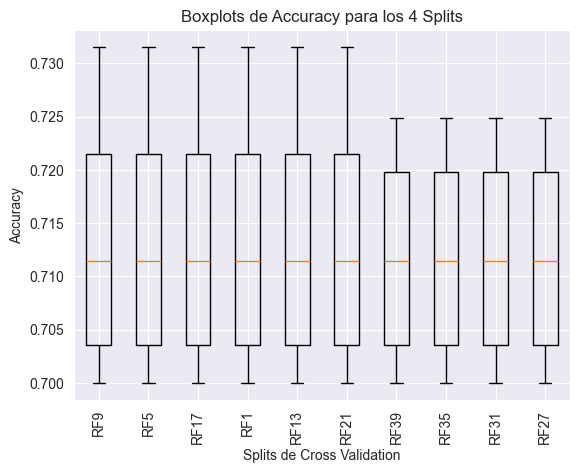

In [315]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

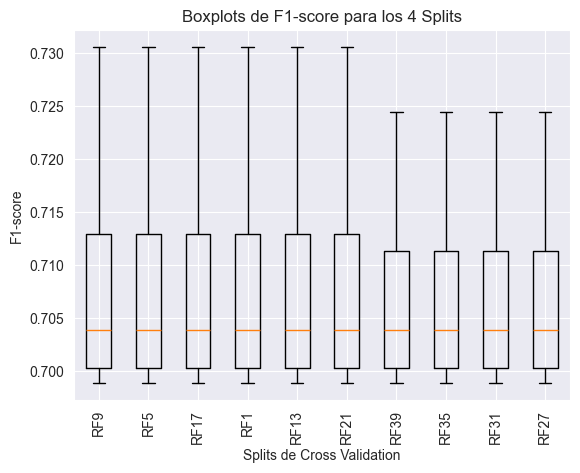

In [316]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [317]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7135906040268456 0.012314796172310441

0.7135906040268456 0.012314796172310441

0.7135906040268456 0.012314796172310441

0.7135906040268456 0.012314796172310441

0.7135906040268456 0.012314796172310441

0.7135906040268456 0.012314796172310441

0.7119127516778523 0.009992734174045698

0.7119127516778523 0.009992734174045698

0.7119127516778523 0.009992734174045698

0.7119127516778523 0.009992734174045698



In [318]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7093255903439979 0.012621584026497894

0.7093255903439979 0.012621584026497894

0.7093255903439979 0.012621584026497894

0.7093255903439979 0.012621584026497894

0.7093255903439979 0.012621584026497894

0.7093255903439979 0.012621584026497894

0.7077817687103437 0.010044325280305801

0.7077817687103437 0.010044325280305801

0.7077817687103437 0.010044325280305801

0.7077817687103437 0.010044325280305801



In [319]:
# Best overall
rf0 = RandomForestClassifier(**results.iloc[0].params, random_state=seed)
# Best in variability
rf6 = RandomForestClassifier(**results.iloc[6].params, random_state=seed)

In [320]:
rf0.fit(X_train, y_train)
rf6.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', max_depth=4, max_features=None,
                       min_samples_split=240, n_estimators=300,
                       random_state=7764)

In [321]:
y_pred = rf0.predict(X_test)
y_pred_tr = rf0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7303
Precisión del modelo en test: 0.7533
F-score del modelo en train: 0.7259
F-score del modelo en test: 0.7474
Matriz de confusión:
[[68 18]
 [19 45]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.78      0.79      0.79        86
           2       0.71      0.70      0.71        64

    accuracy                           0.75       150
   macro avg       0.75      0.75      0.75       150
weighted avg       0.75      0.75      0.75       150



In [322]:
y_pred = rf6.predict(X_test)
y_pred_tr = rf6.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7521
Precisión del modelo en test: 0.7800
F-score del modelo en train: 0.7481
F-score del modelo en test: 0.7747
Matriz de confusión:
[[70 16]
 [17 47]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.80      0.81      0.81        86
           2       0.75      0.73      0.74        64

    accuracy                           0.78       150
   macro avg       0.78      0.77      0.77       150
weighted avg       0.78      0.78      0.78       150



In [324]:
# Checking model performance
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    rf = RandomForestClassifier(**results.iloc[6].params, random_state=r_seed)
    rf.fit(X_train, y_train)
    
    y_pred = rf.predict(X_test)
    y_pred_tr = rf.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7471
Precisión del modelo en test: 0.7733
F-score del modelo en train: 0.7437
F-score del modelo en test: 0.7692
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.81      0.79      0.80        86
           2       0.73      0.75      0.74        64

    accuracy                           0.77       150
   macro avg       0.77      0.77      0.77       150
weighted avg       0.77      0.77      0.77       150

**************************************************
Precisión del modelo en train: 0.7521
Precisión del modelo en test: 0.7800
F-score del modelo en train: 0.7483
F-score del modelo en test: 0.7747
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.80      0.81      0.81        86
           2       0.75      0.73      0.74        64

    accuracy                           0.78       150
   macro avg       0.78      0.77      0.77       150
weight

In [325]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.7593333333333333
0.021186998109427604


In [326]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.7555773383321587
0.01993096735370774


##### SANOS VS TCA

In [142]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 3])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [143]:
rf = RandomForestClassifier(n_estimators = 60,bootstrap = True, max_depth = 7, 
                             min_samples_split=10, criterion='entropy', 
                             max_features= None, class_weight='balanced', random_state=seed)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

# Over-sampling
smote = SMOTE(sampling_strategy='minority',random_state=seed)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

rf.fit(X_resampled, y_resampled)

RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=7, max_features=None, min_samples_split=10,
                       n_estimators=60, random_state=7764)

In [145]:
print(f'La frecuencia de cada clase en train es: \n{y_resampled.value_counts()}')
print(f'\nLa frecuencia de cada clase en test es: \n{y_test.value_counts()}')

La frecuencia de cada clase en train es: 
label
0    320
3    320
Name: count, dtype: int64

La frecuencia de cada clase en test es: 
label
0    94
3    18
Name: count, dtype: int64


In [146]:
y_pred = rf.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.6161
F-score del modelo en test: 0.5497
Matriz de confusión:
[[56 38]
 [ 5 13]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.92      0.60      0.72        94
           3       0.25      0.72      0.38        18

    accuracy                           0.62       112
   macro avg       0.59      0.66      0.55       112
weighted avg       0.81      0.62      0.67       112



In [147]:
y_pred_tr = rf.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(rf, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.9109
Precisión del modelo en test: 0.6161
F-score del modelo en train: 0.9105
F-score del modelo en test: 0.5497
Precisión promedio mediante validación cruzada: 0.5689


Vamos a tirar por smote porque presenta menos overfitting y se predicen mejor los enfermos

In [148]:
# Grid search
params = {
    'n_estimators' : [100,150,200,250,300],
    'max_depth': [3,4],
    'bootstrap': [True],
    'min_samples_split': [90, 95, 110],
    'criterion': ["entropy", "gini"],
    'max_features': [None],
    'class_weight': ['balanced']
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=rf, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_resampled, y_resampled)

GridSearchCV(cv=4,
             estimator=RandomForestClassifier(class_weight='balanced',
                                              criterion='entropy', max_depth=7,
                                              max_features=None,
                                              min_samples_split=10,
                                              n_estimators=60,
                                              random_state=7764),
             param_grid={'bootstrap': [True], 'class_weight': ['balanced'],
                         'criterion': ['entropy', 'gini'], 'max_depth': [3, 4],
                         'max_features': [None],
                         'min_samples_split': [90, 95, 110],
                         'n_estimators': [100, 150, 200, 250, 300]},
             refit='f1_macro',
             scoring=['accuracy', 'precision_macro', 'recall_macro',
                      'f1_macro'])

In [149]:
best_model_rf = grid_search.best_estimator_
best_model_rf.get_params

<bound method BaseEstimator.get_params of RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=4, max_features=None, min_samples_split=90,
                       random_state=7764)>

In [150]:
# Checking overfitting
best_model_RF = grid_search.best_estimator_

y_train_pred = best_model_RF.predict(X_resampled)
y_test_pred = best_model_RF.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_resampled,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.7375
Se tiene un accuracy para test de: 0.6071428571428571
F-score del modelo en train: 0.7347
F-score del modelo en test: 0.5560


In [436]:
# Results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                               params  mean_test_accuracy  \
15  {'bootstrap': True, 'class_weight': 'balanced'...            0.671875   
24  {'bootstrap': True, 'class_weight': 'balanced'...            0.671875   
19  {'bootstrap': True, 'class_weight': 'balanced'...            0.671875   
10  {'bootstrap': True, 'class_weight': 'balanced'...            0.673438   
25  {'bootstrap': True, 'class_weight': 'balanced'...            0.670312   
22  {'bootstrap': True, 'class_weight': 'balanced'...            0.670313   
17  {'bootstrap': True, 'class_weight': 'balanced'...            0.670313   
20  {'bootstrap': True, 'class_weight': 'balanced'...            0.668750   
5   {'bootstrap': True, 'class_weight': 'balanced'...            0.670312   
26  {'bootstrap': True, 'class_weight': 'balanced'...            0.667188   

    mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
15                   0.677916                0.67

In [437]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"RF{index}")

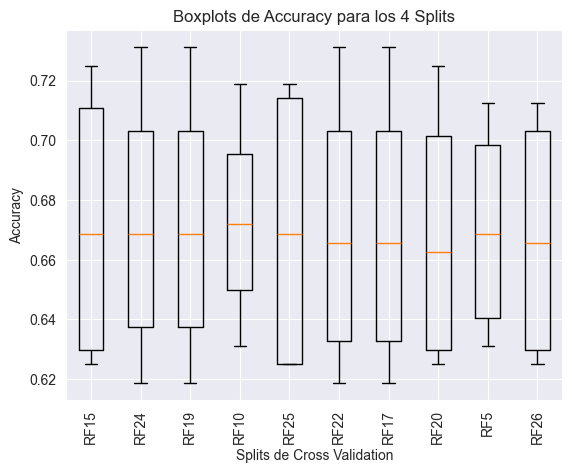

In [438]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

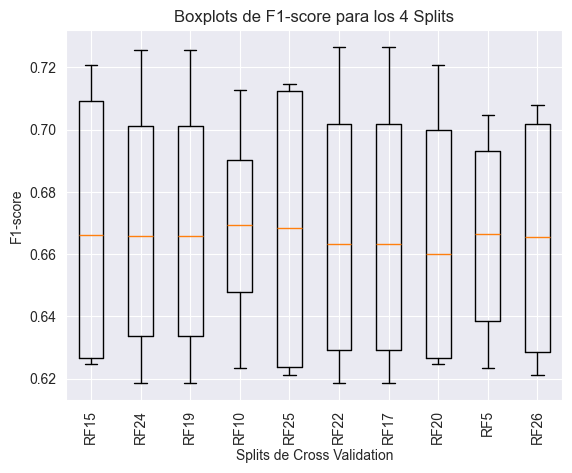

In [439]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [440]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.671875 0.04430452149611821

0.671875 0.043638250136777905

0.671875 0.043638250136777905

0.6734375 0.03288682059351436

0.6703125 0.045366347315493674

0.6703125000000001 0.04471590006641931

0.6703125000000001 0.04471590006641931

0.6687500000000001 0.042158554885100126

0.6703125 0.033765910601522356

0.6671875 0.039373759901106725



In [441]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.6694394081469613 0.04387974205153314

0.6690031079605155 0.042557215227005604

0.6690031079605155 0.042557215227005604

0.6687384352922684 0.03294524505370199

0.6681210640375593 0.045161772857167014

0.6678647663096364 0.04401300606367769

0.6678647663096364 0.04401300606367769

0.6663044890670601 0.04159284095069755

0.6652914950539315 0.03298298469528448

0.6649616189468655 0.0390651852653593



In [442]:
# Overall best
rf0 = RandomForestClassifier(**results.iloc[0].params, random_state=seed)
# Best in variability
rf4 = RandomForestClassifier(**results.iloc[3].params, random_state=seed)

In [443]:
rf0.fit(X_resampled, y_resampled)
rf4.fit(X_resampled, y_resampled)

RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=3, max_features=None, min_samples_split=110,
                       random_state=7764)

In [444]:
y_pred = rf0.predict(X_test)
y_pred_tr = rf0.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7375
Precisión del modelo en test: 0.6071
F-score del modelo en train: 0.7347
F-score del modelo en test: 0.5560
Matriz de confusión:
[[53 41]
 [ 3 15]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.95      0.56      0.71        94
           3       0.27      0.83      0.41        18

    accuracy                           0.61       112
   macro avg       0.61      0.70      0.56       112
weighted avg       0.84      0.61      0.66       112



In [445]:
y_pred = rf4.predict(X_test)
y_pred_tr = rf4.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7109
Precisión del modelo en test: 0.5268
F-score del modelo en train: 0.7039
F-score del modelo en test: 0.4976
Matriz de confusión:
[[43 51]
 [ 2 16]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.96      0.46      0.62        94
           3       0.24      0.89      0.38        18

    accuracy                           0.53       112
   macro avg       0.60      0.67      0.50       112
weighted avg       0.84      0.53      0.58       112



In [446]:
# Testing the model over several random seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    rf = RandomForestClassifier(**results.iloc[0].params, random_state=r_seed)
    rf.fit(X_resampled, y_resampled)
    
    y_pred = rf.predict(X_test)
    y_pred_tr = rf.predict(X_resampled)
    
    precision_tr = accuracy_score(y_resampled, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7469
Precisión del modelo en test: 0.6161
F-score del modelo en train: 0.7436
F-score del modelo en test: 0.5631
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.95      0.57      0.72        94
           3       0.27      0.83      0.41        18

    accuracy                           0.62       112
   macro avg       0.61      0.70      0.56       112
weighted avg       0.84      0.62      0.67       112

**************************************************
Precisión del modelo en train: 0.7297
Precisión del modelo en test: 0.6161
F-score del modelo en train: 0.7272
F-score del modelo en test: 0.5631
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.95      0.57      0.72        94
           3       0.27      0.83      0.41        18

    accuracy                           0.62       112
   macro avg       0.61      0.70      0.56       112
weight

In [447]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.6017857142857143
0.019379548328690124


In [448]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.5524411589336794
0.01618318245010215


#### Gradient boosting

##### SANOS VS ANSIEDAD

In [187]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 1])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [188]:
gb = GradientBoostingClassifier(n_estimators = 200, criterion='squared_error', 
                                learning_rate = 0.1, subsample = 1, 
                                random_state = seed,n_iter_no_change = 10, 
                                loss='log_loss', min_samples_split=100, min_samples_leaf=100, max_depth=4)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

gb.fit(X_train, y_train)

GradientBoostingClassifier(criterion='squared_error', max_depth=4,
                           min_samples_leaf=100, min_samples_split=100,
                           n_estimators=200, n_iter_no_change=10,
                           random_state=7764, subsample=1)

In [189]:
y_pred = gb.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.6860
F-score del modelo en test: 0.6850
Matriz de confusión:
[[54 30]
 [24 64]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.69      0.64      0.67        84
           1       0.68      0.73      0.70        88

    accuracy                           0.69       172
   macro avg       0.69      0.69      0.68       172
weighted avg       0.69      0.69      0.69       172



In [190]:
y_pred_tr = gb.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(gb, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.8336
Precisión del modelo en test: 0.6860
F-score del modelo en train: 0.8332
F-score del modelo en test: 0.6850
Precisión promedio mediante validación cruzada: 0.7338


In [191]:
# Hyperparameter search
start = time()

params = {
   'loss': ["log_loss", "exponential"],
   'n_estimators': [100, 150, 200, 300],
   'n_iter_no_change': [None,5,10],
   'criterion': ["friedman_mse", "squared_error"],
   'max_depth': [3,4],
   'subsample': [0.5, 0.75, 1],
   'min_samples_split': [223, 225, 230],
   'min_samples_leaf': [223],
   'learning_rate': [0.01, 0.1],
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=gb, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

>>>>>>>>>>>>> elapsed time: 7m


In [192]:
grid_search.best_estimator_.get_params

<bound method BaseEstimator.get_params of GradientBoostingClassifier(loss='exponential', min_samples_leaf=223,
                           min_samples_split=223, n_estimators=300,
                           random_state=7764, subsample=1)>

In [193]:
# Checking overfitting
best_model_gb = grid_search.best_estimator_

y_train_pred = best_model_gb.predict(X_train)
y_test_pred = best_model_gb.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.7970802919708029
Se tiene un accuracy para test de: 0.7209302325581395
F-score del modelo en train: 0.7968
F-score del modelo en test: 0.7203


In [194]:
# Showing results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                 params  mean_test_accuracy  \
677   {'criterion': 'friedman_mse', 'learning_rate':...            0.740123   
749   {'criterion': 'friedman_mse', 'learning_rate':...            0.740123   
1577  {'criterion': 'squared_error', 'learning_rate'...            0.740123   
821   {'criterion': 'friedman_mse', 'learning_rate':...            0.740123   
857   {'criterion': 'friedman_mse', 'learning_rate':...            0.740123   
1649  {'criterion': 'squared_error', 'learning_rate'...            0.740123   
713   {'criterion': 'friedman_mse', 'learning_rate':...            0.740123   
1541  {'criterion': 'squared_error', 'learning_rate'...            0.740123   
785   {'criterion': 'friedman_mse', 'learning_rate':...            0.740123   
1613  {'criterion': 'squared_error', 'learning_rate'...            0.740123   

      mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
677                     0

In [195]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"GB{index}")

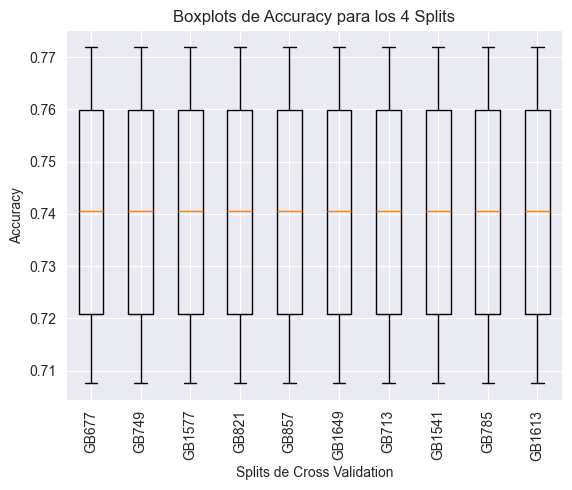

In [196]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

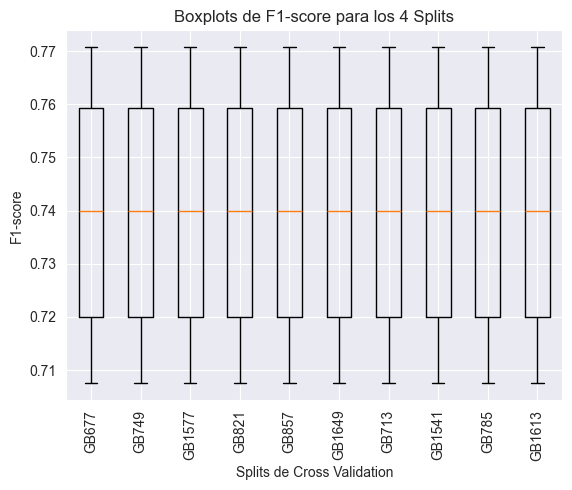

In [197]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [198]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7401230790153679 0.02519810540193666

0.7401230790153679 0.02519810540193666

0.7401230790153679 0.02519810540193666

0.7401230790153679 0.02519810540193666

0.7401230790153679 0.02519810540193666

0.7401230790153679 0.02519810540193666

0.7401230790153679 0.02519810540193666

0.7401230790153679 0.02519810540193666

0.7401230790153679 0.02519810540193666

0.7401230790153679 0.02519810540193666



In [199]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7395082223846547 0.024967457945609697

0.7395082223846547 0.024967457945609697

0.7395082223846547 0.024967457945609697

0.7395082223846547 0.024967457945609697

0.7395082223846547 0.024967457945609697

0.7395082223846547 0.024967457945609697

0.7395082223846547 0.024967457945609697

0.7395082223846547 0.024967457945609697

0.7395082223846547 0.024967457945609697

0.7395082223846547 0.024967457945609697



In [200]:
# Best overall
gb0 = GradientBoostingClassifier(**results.iloc[0].params, random_state=seed)
# Best in terms of variability
gb2 = GradientBoostingClassifier(**results.iloc[2].params, random_state=seed)

In [201]:
gb0.fit(X_train, y_train)
gb2.fit(X_train, y_train)

GradientBoostingClassifier(criterion='squared_error', loss='exponential',
                           min_samples_leaf=223, min_samples_split=225,
                           n_estimators=300, random_state=7764, subsample=1)

In [203]:
y_pred = gb0.predict(X_test)
y_pred_tr = gb0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7971
Precisión del modelo en test: 0.7209
F-score del modelo en train: 0.7968
F-score del modelo en test: 0.7203
Matriz de confusión:
[[58 26]
 [22 66]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.72      0.69      0.71        84
           1       0.72      0.75      0.73        88

    accuracy                           0.72       172
   macro avg       0.72      0.72      0.72       172
weighted avg       0.72      0.72      0.72       172



In [204]:
y_pred = gb2.predict(X_test)
y_pred_tr = gb2.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7971
Precisión del modelo en test: 0.7209
F-score del modelo en train: 0.7968
F-score del modelo en test: 0.7203
Matriz de confusión:
[[58 26]
 [22 66]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.72      0.69      0.71        84
           1       0.72      0.75      0.73        88

    accuracy                           0.72       172
   macro avg       0.72      0.72      0.72       172
weighted avg       0.72      0.72      0.72       172



In [205]:
# Best model being tested over several seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    gb = GradientBoostingClassifier(**results.iloc[0].params, random_state=r_seed)
    gb.fit(X_train, y_train)
    
    y_pred = gb.predict(X_test)
    y_pred_tr = gb.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7971
Precisión del modelo en test: 0.7209
F-score del modelo en train: 0.7968
F-score del modelo en test: 0.7203
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.72      0.69      0.71        84
           1       0.72      0.75      0.73        88

    accuracy                           0.72       172
   macro avg       0.72      0.72      0.72       172
weighted avg       0.72      0.72      0.72       172

**************************************************
Precisión del modelo en train: 0.7971
Precisión del modelo en test: 0.7209
F-score del modelo en train: 0.7968
F-score del modelo en test: 0.7203
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.72      0.69      0.71        84
           1       0.72      0.75      0.73        88

    accuracy                           0.72       172
   macro avg       0.72      0.72      0.72       172
weight

In [206]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.7209302325581395
0.0


In [207]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.7203252032520324
0.0


##### SANOS VS DEPRESIÓN

In [210]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 2])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [211]:
gb = GradientBoostingClassifier(n_estimators = 200, criterion='squared_error', 
                                learning_rate = 0.1, subsample = 1, 
                                random_state = seed,n_iter_no_change = 10, 
                                loss='log_loss', min_samples_split=100, min_samples_leaf=100, max_depth=4)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

gb.fit(X_train, y_train)

GradientBoostingClassifier(criterion='squared_error', max_depth=4,
                           min_samples_leaf=100, min_samples_split=100,
                           n_estimators=200, n_iter_no_change=10,
                           random_state=7764, subsample=1)

In [212]:
y_pred = gb.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.8067
F-score del modelo en test: 0.8011
Matriz de confusión:
[[73 13]
 [16 48]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.82      0.85      0.83        86
           2       0.79      0.75      0.77        64

    accuracy                           0.81       150
   macro avg       0.80      0.80      0.80       150
weighted avg       0.81      0.81      0.81       150



In [213]:
y_pred_tr = gb.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(gb, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.8224
Precisión del modelo en test: 0.8067
F-score del modelo en train: 0.8208
F-score del modelo en test: 0.8011
Precisión promedio mediante validación cruzada: 0.7617


In [214]:
# Grid search
start = time()

params = {
   'loss': ["log_loss", "exponential"],
   'n_estimators': [100, 150, 200, 300],
   'n_iter_no_change': [None,5,10],
   'criterion': ["friedman_mse", "squared_error"],
   'max_depth': [3,4],
   'subsample': [0.5, 0.75, 1],
   'min_samples_split': [50, 100, 150, 200],
   'min_samples_leaf': [50, 100, 150, 200],
   'learning_rate': [0.001, 0.01, 0.1, 0.5],
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=gb, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

>>>>>>>>>>>>> elapsed time: 112m


In [215]:
grid_search.best_estimator_.get_params

<bound method BaseEstimator.get_params of GradientBoostingClassifier(loss='exponential', min_samples_leaf=50,
                           min_samples_split=150, n_iter_no_change=10,
                           random_state=7764, subsample=0.5)>

In [216]:
# Checking overfitting
best_model_gb = grid_search.best_estimator_

y_train_pred = best_model_gb.predict(X_train)
y_test_pred = best_model_gb.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.7956448911222781
Se tiene un accuracy para test de: 0.8
F-score del modelo en train: 0.7933
F-score del modelo en test: 0.7947


In [217]:
# Results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                  params  mean_test_accuracy  \
15054  {'criterion': 'squared_error', 'learning_rate'...            0.782293   
15063  {'criterion': 'squared_error', 'learning_rate'...            0.782293   
5865   {'criterion': 'friedman_mse', 'learning_rate':...            0.782293   
5856   {'criterion': 'friedman_mse', 'learning_rate':...            0.782293   
6441   {'criterion': 'friedman_mse', 'learning_rate':...            0.782293   
5847   {'criterion': 'friedman_mse', 'learning_rate':...            0.782293   
6432   {'criterion': 'friedman_mse', 'learning_rate':...            0.782293   
15630  {'criterion': 'squared_error', 'learning_rate'...            0.782293   
6423   {'criterion': 'friedman_mse', 'learning_rate':...            0.782293   
6414   {'criterion': 'friedman_mse', 'learning_rate':...            0.782293   

       mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
15054        

In [218]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"GB{index}")

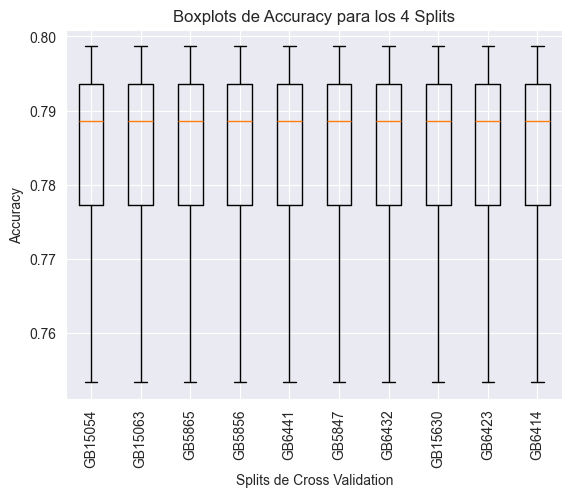

In [219]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

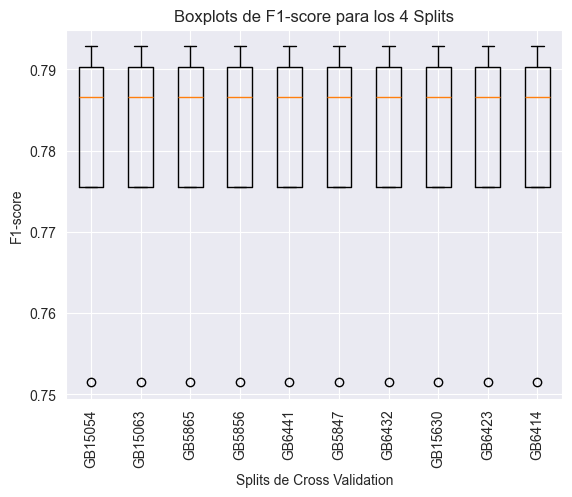

In [220]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [221]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7822930648769575 0.017380358408265684

0.7822930648769575 0.017380358408265684

0.7822930648769575 0.017380358408265684

0.7822930648769575 0.017380358408265684

0.7822930648769575 0.017380358408265684

0.7822930648769575 0.017380358408265684

0.7822930648769575 0.017380358408265684

0.7822930648769575 0.017380358408265684

0.7822930648769575 0.017380358408265684

0.7822930648769575 0.017380358408265684



In [222]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7793496736004856 0.016435032369745115

0.7793496736004856 0.016435032369745115

0.7793496736004856 0.016435032369745115

0.7793496736004856 0.016435032369745115

0.7793496736004856 0.016435032369745115

0.7793496736004856 0.016435032369745115

0.7793496736004856 0.016435032369745115

0.7793496736004856 0.016435032369745115

0.7793496736004856 0.016435032369745115

0.7793496736004856 0.016435032369745115



In [223]:
# Best overall
gb0 = GradientBoostingClassifier(**results.iloc[0].params, random_state=seed)

In [224]:
gb0.fit(X_train, y_train)

GradientBoostingClassifier(criterion='squared_error', loss='exponential',
                           min_samples_leaf=50, min_samples_split=150,
                           n_iter_no_change=10, random_state=7764,
                           subsample=0.5)

In [225]:
y_pred = gb0.predict(X_test)
y_pred_tr = gb0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7956
Precisión del modelo en test: 0.8000
F-score del modelo en train: 0.7933
F-score del modelo en test: 0.7947
Matriz de confusión:
[[72 14]
 [16 48]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.82      0.84      0.83        86
           2       0.77      0.75      0.76        64

    accuracy                           0.80       150
   macro avg       0.80      0.79      0.79       150
weighted avg       0.80      0.80      0.80       150



In [226]:
# Testing model's robustness over different seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    gb = GradientBoostingClassifier(**results.iloc[0].params, random_state=r_seed)
    gb.fit(X_train, y_train)
    
    y_pred = gb.predict(X_test)
    y_pred_tr = gb.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.8107
Precisión del modelo en test: 0.7867
F-score del modelo en train: 0.8073
F-score del modelo en test: 0.7801
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.80      0.84      0.82        86
           2       0.77      0.72      0.74        64

    accuracy                           0.79       150
   macro avg       0.78      0.78      0.78       150
weighted avg       0.79      0.79      0.79       150

**************************************************
Precisión del modelo en train: 0.7889
Precisión del modelo en test: 0.7533
F-score del modelo en train: 0.7852
F-score del modelo en test: 0.7451
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.77      0.81      0.79        86
           2       0.73      0.67      0.70        64

    accuracy                           0.75       150
   macro avg       0.75      0.74      0.75       150
weight

In [227]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.7866666666666666
0.01507184440694505


In [228]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.7811949750363726
0.015815596891996395


##### SANOS VS TCA

In [2]:
df = pd.read_csv('C:\\Users\\Pablo\\Desktop\\tfm\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 3])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [3]:
gb = GradientBoostingClassifier(n_estimators = 200, criterion='squared_error', 
                                learning_rate = 0.1, subsample = 1, 
                                random_state = seed,n_iter_no_change = 10, 
                                loss='log_loss', min_samples_split=100, min_samples_leaf=100, max_depth=4)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

# Resampling
smote = SMOTE(sampling_strategy='minority',random_state=seed)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

gb.fit(X_resampled, y_resampled)

GradientBoostingClassifier(criterion='squared_error', max_depth=4,
                           min_samples_leaf=100, min_samples_split=100,
                           n_estimators=200, n_iter_no_change=10,
                           random_state=7764, subsample=1)

In [4]:
y_pred = gb.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.6429
F-score del modelo en test: 0.5540
Matriz de confusión:
[[61 33]
 [ 7 11]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.90      0.65      0.75        94
           3       0.25      0.61      0.35        18

    accuracy                           0.64       112
   macro avg       0.57      0.63      0.55       112
weighted avg       0.79      0.64      0.69       112



In [5]:
y_pred_tr = gb.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(gb, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.8422
Precisión del modelo en test: 0.6429
F-score del modelo en train: 0.8422
F-score del modelo en test: 0.5540
Precisión promedio mediante validación cruzada: 0.4639


In [6]:
# Grid search
start = time()

params = {
   'loss': ["log_loss", "exponential"],
   'n_estimators': [200, 300, 400, 500],
   'n_iter_no_change': [None,5,10],
   'criterion': ["friedman_mse", "squared_error"],
   'max_depth': [3,4],
   'subsample': [0.5, 0.75, 1],
   'min_samples_split': [200, 250, 300],
   'min_samples_leaf': [200, 250, 300],
   'learning_rate': [0.01, 0.1, 0.5],
}
scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=gb, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_resampled, y_resampled)

end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

>>>>>>>>>>>>> elapsed time: 47m


In [7]:
grid_search.best_estimator_.get_params

<bound method BaseEstimator.get_params of GradientBoostingClassifier(learning_rate=0.5, loss='exponential',
                           min_samples_leaf=200, min_samples_split=200,
                           n_estimators=200, n_iter_no_change=5,
                           random_state=7764, subsample=1)>

In [8]:
# Checking overfitting
best_model_gb = grid_search.best_estimator_

y_train_pred = best_model_gb.predict(X_resampled)
y_test_pred = best_model_gb.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_resampled,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.70625
Se tiene un accuracy para test de: 0.6964285714285714
F-score del modelo en train: 0.7062
F-score del modelo en test: 0.5952


In [9]:
# Grid search results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                 params  mean_test_accuracy  \
3596  {'criterion': 'friedman_mse', 'learning_rate':...            0.639062   
7457  {'criterion': 'squared_error', 'learning_rate'...            0.639062   
7205  {'criterion': 'squared_error', 'learning_rate'...            0.639062   
7502  {'criterion': 'squared_error', 'learning_rate'...            0.639062   
3335  {'criterion': 'friedman_mse', 'learning_rate':...            0.639062   
7196  {'criterion': 'squared_error', 'learning_rate'...            0.639062   
3344  {'criterion': 'friedman_mse', 'learning_rate':...            0.639062   
7466  {'criterion': 'squared_error', 'learning_rate'...            0.639062   
3587  {'criterion': 'friedman_mse', 'learning_rate':...            0.639062   
7187  {'criterion': 'squared_error', 'learning_rate'...            0.639062   

      mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
3596                   0.

In [10]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"GB{index}")

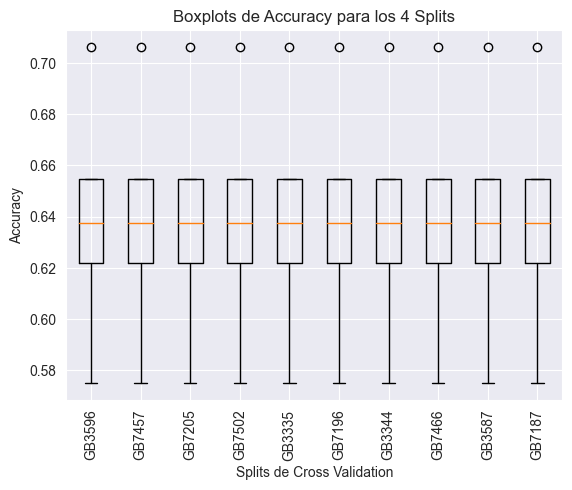

In [11]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

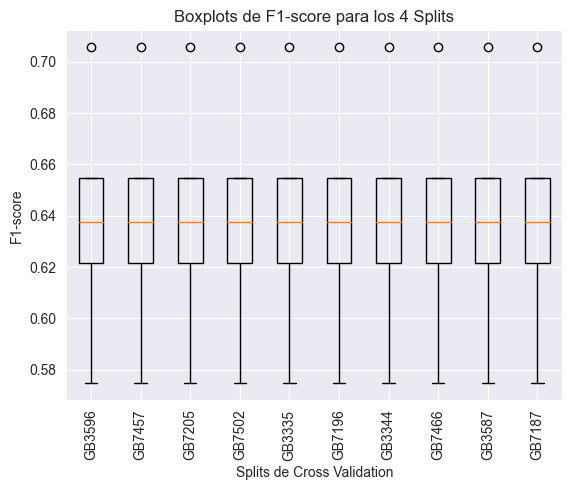

In [12]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [13]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.6390625 0.04643018111907386

0.6390625 0.04643018111907386

0.6390625 0.04643018111907386

0.6390625 0.04643018111907386

0.6390625 0.04643018111907386

0.6390625 0.04643018111907386

0.6390625 0.04643018111907386

0.6390625 0.04643018111907386

0.6390625 0.04643018111907386

0.6390625 0.04643018111907386



In [14]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.6387843802744673 0.04632068115974431

0.6387843802744673 0.04632068115974431

0.6387843802744673 0.04632068115974431

0.6387843802744673 0.04632068115974431

0.6387843802744673 0.04632068115974431

0.6387843802744673 0.04632068115974431

0.6387843802744673 0.04632068115974431

0.6387843802744673 0.04632068115974431

0.6387843802744673 0.04632068115974431

0.6387843802744673 0.04632068115974431



In [15]:
# Best overall
gb0 = GradientBoostingClassifier(**results.iloc[0].params, random_state=seed)

In [16]:
gb0.fit(X_resampled, y_resampled)

GradientBoostingClassifier(learning_rate=0.5, loss='exponential', max_depth=4,
                           min_samples_leaf=200, min_samples_split=200,
                           n_estimators=500, n_iter_no_change=5,
                           random_state=7764, subsample=1)

In [17]:
y_pred = gb0.predict(X_test)
y_pred_tr = gb0.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7063
Precisión del modelo en test: 0.6964
F-score del modelo en train: 0.7062
F-score del modelo en test: 0.5952
Matriz de confusión:
[[67 27]
 [ 7 11]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.91      0.71      0.80        94
           3       0.29      0.61      0.39        18

    accuracy                           0.70       112
   macro avg       0.60      0.66      0.60       112
weighted avg       0.81      0.70      0.73       112



In [18]:
# Testing over several seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    gb = GradientBoostingClassifier(**results.iloc[0].params, random_state=r_seed)
    gb.fit(X_train, y_train)
    
    y_pred = gb.predict(X_test)
    y_pred_tr = gb.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7169
Precisión del modelo en test: 0.8571
F-score del modelo en train: 0.4660
F-score del modelo en test: 0.5608
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.85      1.00      0.92        94
           3       1.00      0.11      0.20        18

    accuracy                           0.86       112
   macro avg       0.93      0.56      0.56       112
weighted avg       0.88      0.86      0.81       112

**************************************************
Precisión del modelo en train: 0.7169
Precisión del modelo en test: 0.8482
F-score del modelo en train: 0.4660
F-score del modelo en test: 0.5112
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.85      1.00      0.92        94
           3       1.00      0.06      0.11        18

    accuracy                           0.85       112
   macro avg       0.92      0.53      0.51       112
weight

In [19]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.85
0.014458283097013228


In [20]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.5159003473353481
0.07765641510155548


#### XGBoost

##### SANOS VS ANSIEDAD

In [3]:
df = pd.read_csv('C:\\Users\\Pablo\\Desktop\\tfm\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 1])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
seed=7764

In [30]:
xgb = XGBClassifier(booster = 'gbtree', n_estimators = 200, 
                               eta = 0.005, gamma = 1, random_state=seed, max_depth = 4, tree_method = 'hist')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

xgb.fit(X_train, y_train)

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.005, eval_metric=None,
              feature_types=None, gamma=1, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=4,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=200,
              n_jobs=None, num_parallel_tree=None, ...)

In [31]:
y_pred = xgb.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.6686
F-score del modelo en test: 0.6645
Matriz de confusión:
[[48 36]
 [21 67]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.70      0.57      0.63        84
           1       0.65      0.76      0.70        88

    accuracy                           0.67       172
   macro avg       0.67      0.67      0.66       172
weighted avg       0.67      0.67      0.67       172



In [32]:
y_pred_tr = xgb.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(xgb, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.8321
Precisión del modelo en test: 0.6686
F-score del modelo en train: 0.8315
F-score del modelo en test: 0.6645
Precisión promedio mediante validación cruzada: 0.7171


In [52]:
# Grid search
start = time()

params = {
    'n_estimators': [200, 300, 400],
    'eta' : [0.001, 0.003, 0.004, 0.005],
    'gamma' : [0.5, 0.7, 0.8, 0.9, 0.95],
    'max_depth': [2,3,4, 5]
}

scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=xgb, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

>>>>>>>>>>>>> elapsed time: 5m


In [53]:
grid_search.best_estimator_.get_params

<bound method XGBModel.get_params of XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.005, eval_metric=None,
              feature_types=None, gamma=0.5, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=2,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=300,
              n_jobs=None, num_parallel_tree=None, ...)>

In [54]:
# Checking overfitting
best_model_gb = grid_search.best_estimator_

y_train_pred = best_model_gb.predict(X_train)
y_test_pred = best_model_gb.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.8014598540145985
Se tiene un accuracy para test de: 0.6918604651162791
F-score del modelo en train: 0.8012
F-score del modelo en test: 0.6895


In [55]:
# Results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                params  mean_test_accuracy  \
217  {'eta': 0.005, 'gamma': 0.9, 'max_depth': 2, '...            0.747365   
181  {'eta': 0.005, 'gamma': 0.5, 'max_depth': 2, '...            0.747365   
229  {'eta': 0.005, 'gamma': 0.95, 'max_depth': 2, ...            0.747365   
193  {'eta': 0.005, 'gamma': 0.7, 'max_depth': 2, '...            0.747365   
205  {'eta': 0.005, 'gamma': 0.8, 'max_depth': 2, '...            0.747365   
206  {'eta': 0.005, 'gamma': 0.8, 'max_depth': 2, '...            0.745912   
182  {'eta': 0.005, 'gamma': 0.5, 'max_depth': 2, '...            0.745912   
230  {'eta': 0.005, 'gamma': 0.95, 'max_depth': 2, ...            0.745912   
194  {'eta': 0.005, 'gamma': 0.7, 'max_depth': 2, '...            0.745912   
218  {'eta': 0.005, 'gamma': 0.9, 'max_depth': 2, '...            0.745912   

     mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
217                   0.748578       

In [56]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"XGB{index}")

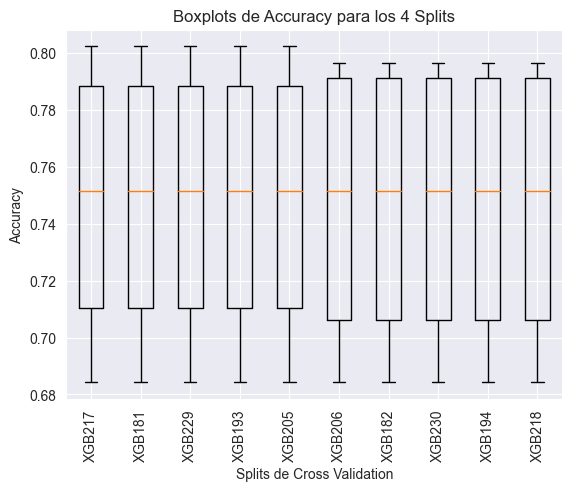

In [57]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

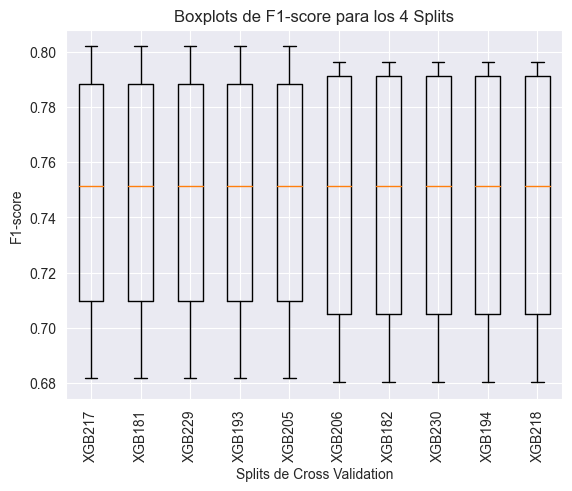

In [58]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [59]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7473650210798314 0.04772770780069728

0.7473650210798314 0.04772770780069728

0.7473650210798314 0.04772770780069728

0.7473650210798314 0.04772770780069728

0.7473650210798314 0.04772770780069728

0.7459115327077384 0.0482669063385353

0.7459115327077384 0.0482669063385353

0.7459115327077384 0.0482669063385353

0.7459115327077384 0.0482669063385353

0.7459115327077384 0.0482669063385353



In [60]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7466432955639182 0.04842148685154601

0.7466432955639182 0.04842148685154601

0.7466432955639182 0.04842148685154601

0.7466432955639182 0.04842148685154601

0.7466432955639182 0.04842148685154601

0.7448286904156889 0.049458695666901135

0.7448286904156889 0.049458695666901135

0.7448286904156889 0.049458695666901135

0.7448286904156889 0.049458695666901135

0.7448286904156889 0.049458695666901135



In [61]:
# Best overall
xgb0 = XGBClassifier(**results.iloc[0].params, random_state=seed)

In [62]:
xgb0.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.005, eval_metric=None,
              feature_types=None, gamma=0.9, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=2,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=300,
              n_jobs=None, num_parallel_tree=None, ...)

In [63]:
y_pred = xgb0.predict(X_test)
y_pred_tr = xgb0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.8015
Precisión del modelo en test: 0.6919
F-score del modelo en train: 0.8012
F-score del modelo en test: 0.6895
Matriz de confusión:
[[52 32]
 [21 67]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.71      0.62      0.66        84
           1       0.68      0.76      0.72        88

    accuracy                           0.69       172
   macro avg       0.69      0.69      0.69       172
weighted avg       0.69      0.69      0.69       172



In [64]:
# Testing model over several seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    xgb = XGBClassifier(**results.iloc[0].params, random_state=r_seed)
    xgb.fit(X_train, y_train)
    
    y_pred = xgb.predict(X_test)
    y_pred_tr = xgb.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.8015
Precisión del modelo en test: 0.6919
F-score del modelo en train: 0.8012
F-score del modelo en test: 0.6895
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.71      0.62      0.66        84
           1       0.68      0.76      0.72        88

    accuracy                           0.69       172
   macro avg       0.69      0.69      0.69       172
weighted avg       0.69      0.69      0.69       172

**************************************************
Precisión del modelo en train: 0.8015
Precisión del modelo en test: 0.6919
F-score del modelo en train: 0.8012
F-score del modelo en test: 0.6895
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.71      0.62      0.66        84
           1       0.68      0.76      0.72        88

    accuracy                           0.69       172
   macro avg       0.69      0.69      0.69       172
weight

In [65]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.6918604651162791
0.0


In [66]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.6894989611362785
0.0


##### SANOS VS DEPRESION

In [2]:
df = pd.read_csv('C:\\Users\\Pablo\\Desktop\\tfm\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 2])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
le = LabelEncoder()
y = le.fit_transform(y)
seed=7764

In [3]:
xgb = XGBClassifier(booster = 'gbtree', n_estimators = 200, 
                               eta = 0.005, gamma = 1, random_state=seed, max_depth = 4, tree_method = 'hist')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

xgb.fit(X_train, y_train)

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.005, eval_metric=None,
              feature_types=None, gamma=1, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=4,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=200,
              n_jobs=None, num_parallel_tree=None, ...)

In [4]:
y_pred = xgb.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.7667
F-score del modelo en test: 0.7589
Matriz de confusión:
[[71 15]
 [20 44]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.78      0.83      0.80        86
           1       0.75      0.69      0.72        64

    accuracy                           0.77       150
   macro avg       0.76      0.76      0.76       150
weighted avg       0.77      0.77      0.77       150



In [5]:
y_pred_tr = xgb.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(xgb, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.8543
Precisión del modelo en test: 0.7667
F-score del modelo en train: 0.8517
F-score del modelo en test: 0.7589
Precisión promedio mediante validación cruzada: 0.7463


In [23]:
# Grid search
start = time()

params = {
    'n_estimators': [200, 300, 400],
    'eta' : [0.001, 0.003, 0.004, 0.005],
    'gamma' : [0.5, 0.7, 0.8, 0.9, 0.95],
    'max_depth': [2,3,4,5]
}

scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=xgb, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_train, y_train)

end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

>>>>>>>>>>>>> elapsed time: 5m


In [24]:
grid_search.best_estimator_.get_params

<bound method XGBModel.get_params of XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.005, eval_metric=None,
              feature_types=None, gamma=0.5, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=2,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=400,
              n_jobs=None, num_parallel_tree=None, ...)>

In [25]:
# Looking for overfitting
best_model_gb = grid_search.best_estimator_

y_train_pred = best_model_gb.predict(X_train)
y_test_pred = best_model_gb.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_train,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.8023450586264657
Se tiene un accuracy para test de: 0.78
F-score del modelo en train: 0.7997
F-score del modelo en test: 0.7715


In [26]:
# Results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                                params  mean_test_accuracy  \
194  {'eta': 0.005, 'gamma': 0.7, 'max_depth': 2, '...            0.755481   
182  {'eta': 0.005, 'gamma': 0.5, 'max_depth': 2, '...            0.755481   
206  {'eta': 0.005, 'gamma': 0.8, 'max_depth': 2, '...            0.755481   
230  {'eta': 0.005, 'gamma': 0.95, 'max_depth': 2, ...            0.755481   
218  {'eta': 0.005, 'gamma': 0.9, 'max_depth': 2, '...            0.755481   
170  {'eta': 0.004, 'gamma': 0.95, 'max_depth': 2, ...            0.752114   
122  {'eta': 0.004, 'gamma': 0.5, 'max_depth': 2, '...            0.752114   
134  {'eta': 0.004, 'gamma': 0.7, 'max_depth': 2, '...            0.752114   
158  {'eta': 0.004, 'gamma': 0.9, 'max_depth': 2, '...            0.752114   
146  {'eta': 0.004, 'gamma': 0.8, 'max_depth': 2, '...            0.752114   

     mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
194                   0.755694       

In [27]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"XGB{index}")

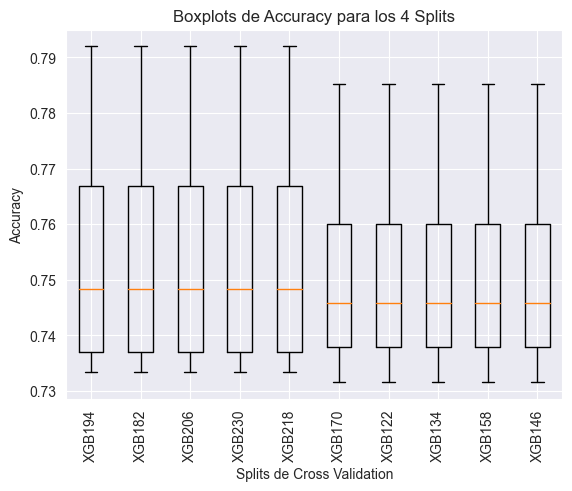

In [28]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

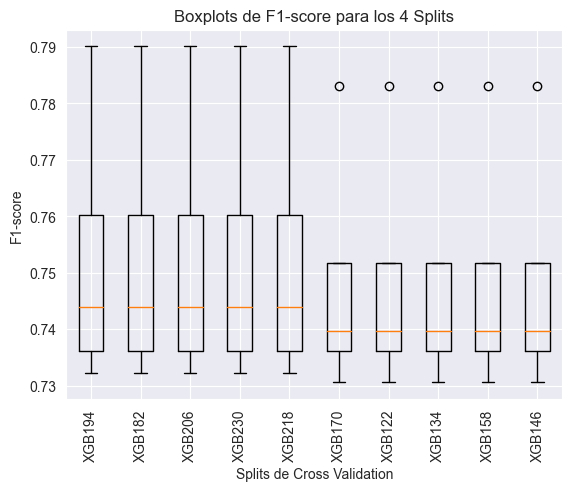

In [29]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [30]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7554809843400447 0.02305119186422417

0.7554809843400447 0.02305119186422417

0.7554809843400447 0.02305119186422417

0.7554809843400447 0.02305119186422417

0.7554809843400447 0.02305119186422417

0.7521140939597316 0.02041490604463596

0.7521140939597316 0.02041490604463596

0.7521140939597316 0.02041490604463596

0.7521140939597316 0.02041490604463596

0.7521140939597316 0.02041490604463596



In [31]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7524801532281009 0.022682931346220816

0.7524801532281009 0.022682931346220816

0.7524801532281009 0.022682931346220816

0.7524801532281009 0.022682931346220816

0.7524801532281009 0.022682931346220816

0.7482037023831002 0.020477294779334246

0.7482037023831002 0.020477294779334246

0.7482037023831002 0.020477294779334246

0.7482037023831002 0.020477294779334246

0.7482037023831002 0.020477294779334246



In [32]:
# Best in F1 score
xgb0 = XGBClassifier(**results.iloc[0].params, random_state=seed)
# Most balanced
xgb5 = XGBClassifier(**results.iloc[5].params, random_state=seed)

In [33]:
xgb0.fit(X_train, y_train)
xgb5.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.004, eval_metric=None,
              feature_types=None, gamma=0.95, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=2,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=400,
              n_jobs=None, num_parallel_tree=None, ...)

In [34]:
y_pred = xgb0.predict(X_test)
y_pred_tr = xgb0.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.8023
Precisión del modelo en test: 0.7800
F-score del modelo en train: 0.7997
F-score del modelo en test: 0.7715
Matriz de confusión:
[[73 13]
 [20 44]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.78      0.85      0.82        86
           1       0.77      0.69      0.73        64

    accuracy                           0.78       150
   macro avg       0.78      0.77      0.77       150
weighted avg       0.78      0.78      0.78       150



In [35]:
y_pred = xgb5.predict(X_test)
y_pred_tr = xgb5.predict(X_train)

precision_tr = accuracy_score(y_train, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7906
Precisión del modelo en test: 0.7800
F-score del modelo en train: 0.7877
F-score del modelo en test: 0.7715
Matriz de confusión:
[[73 13]
 [20 44]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.78      0.85      0.82        86
           1       0.77      0.69      0.73        64

    accuracy                           0.78       150
   macro avg       0.78      0.77      0.77       150
weighted avg       0.78      0.78      0.78       150



In [36]:
# Testing model performance over several seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    xgb = XGBClassifier(**results.iloc[5].params, random_state=r_seed)
    xgb.fit(X_train, y_train)
    
    y_pred = xgb.predict(X_test)
    y_pred_tr = xgb.predict(X_train)
    
    precision_tr = accuracy_score(y_train, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_train, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.7906
Precisión del modelo en test: 0.7800
F-score del modelo en train: 0.7877
F-score del modelo en test: 0.7715
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.78      0.85      0.82        86
           1       0.77      0.69      0.73        64

    accuracy                           0.78       150
   macro avg       0.78      0.77      0.77       150
weighted avg       0.78      0.78      0.78       150

**************************************************
Precisión del modelo en train: 0.7906
Precisión del modelo en test: 0.7800
F-score del modelo en train: 0.7877
F-score del modelo en test: 0.7715
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.78      0.85      0.82        86
           1       0.77      0.69      0.73        64

    accuracy                           0.78       150
   macro avg       0.78      0.77      0.77       150
weight

In [37]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.78
0.0


In [38]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.7714575926866429
0.0


##### SANOS VS TCA

In [78]:
df = pd.read_csv('C:\\Users\\Pablo\\Desktop\\tfm\\df_inputed.csv', index_col = 0)
users = df['subject']
messages = df['message']
df.drop(['message', 'subject'], inplace=True, axis=1)
df = df[df['label'].isin([0, 3])]
y = df['label']
X = df[['complexityILFW',
 'complexityhuerta',
 'stylometryTTR',
 'complexitymu',
 'emotionsurprise',
 'complexitynSyllabes',
 'complexitynSentences',
 'ironyNI',
 'polarityNEG',
 'complexitynPuntuationMarks',
 'emotionsadness',
 'emotionfear',
 'stylometryHerdan']]
le = LabelEncoder()
y = le.fit_transform(y)
seed=7764

In [79]:
xgb = XGBClassifier(booster = 'gbtree', n_estimators = 200, 
                               eta = 0.005, gamma = 1, random_state=seed, max_depth = 4, tree_method = 'hist')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

# Over-sampling
smote = SMOTE(sampling_strategy='minority',random_state=seed)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

xgb.fit(X_resampled, y_resampled)

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.005, eval_metric=None,
              feature_types=None, gamma=1, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=4,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=200,
              n_jobs=None, num_parallel_tree=None, ...)

In [80]:
y_pred = xgb.predict(X_test)

precision = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en test: 0.6250
F-score del modelo en test: 0.5702
Matriz de confusión:
[[55 39]
 [ 3 15]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.95      0.59      0.72        94
           1       0.28      0.83      0.42        18

    accuracy                           0.62       112
   macro avg       0.61      0.71      0.57       112
weighted avg       0.84      0.62      0.67       112



In [81]:
y_pred_tr = xgb.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
train_f1 = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)

print(f"Precisión del modelo en train: {precision_tr:.4f}")
print(f"Precisión del modelo en test: {precision:.4f}")
print(f"F-score del modelo en train: {train_f1:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

cv_scores = cross_val_score(xgb, X, y, cv=5, scoring='f1_macro')
cv_precision_mean = np.mean(cv_scores)

print(f'Precisión promedio mediante validación cruzada: {cv_precision_mean:.4f}')

Precisión del modelo en train: 0.8422
Precisión del modelo en test: 0.6250
F-score del modelo en train: 0.8404
F-score del modelo en test: 0.5702
Precisión promedio mediante validación cruzada: 0.4258


In [109]:
# Grid search
start = time()

params = {
    'n_estimators': [200, 300, 400, 500],
    'eta' : [0.001, 0.003],
    'gamma' : [0.5, 0.7, 0.8, 0.9, 0.95],
    'max_depth': [2,3]
}

scoring_metrics = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

grid_search = GridSearchCV(estimator=xgb, 
                           param_grid=params, 
                           cv=4, scoring = scoring_metrics, refit='f1_macro')

grid_search.fit(X_resampled, y_resampled)

end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

>>>>>>>>>>>>> elapsed time: 2m


In [110]:
grid_search.best_estimator_.get_params

<bound method XGBModel.get_params of XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.003, eval_metric=None,
              feature_types=None, gamma=0.7, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=3,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, ...)>

In [111]:
# Checking overfitting
best_model_xgb = grid_search.best_estimator_

y_train_pred = best_model_xgb.predict(X_resampled)
y_test_pred = best_model_xgb.predict(X_test)
print(f'Se tiene un accuracy para train de: {accuracy_score(y_resampled,y_train_pred)}')
print(f'Se tiene un accuracy para test de: {accuracy_score(y_test,y_test_pred)}')

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_train_pred)
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_test_pred)
print(f"F-score del modelo en train: {f1_tr:.4f}")
print(f"F-score del modelo en test: {f1_test:.4f}")

Se tiene un accuracy para train de: 0.8046875
Se tiene un accuracy para test de: 0.6696428571428571
F-score del modelo en train: 0.8017
F-score del modelo en test: 0.6060


In [112]:
# Results
results = pd.DataFrame(grid_search.cv_results_)
results = results.sort_values(by="mean_test_f1_macro", ascending=False).head(10)

print("Resultados de Grid Search:")
pd.set_option("display.max_columns", 200)
print(results[['params', 'mean_test_accuracy', 'mean_test_precision_macro', 'mean_test_recall_macro', 'mean_test_f1_macro']])

Resultados de Grid Search:
                                               params  mean_test_accuracy  \
55  {'eta': 0.003, 'gamma': 0.7, 'max_depth': 3, '...            0.701562   
63  {'eta': 0.003, 'gamma': 0.8, 'max_depth': 3, '...            0.698438   
47  {'eta': 0.003, 'gamma': 0.5, 'max_depth': 3, '...            0.696875   
71  {'eta': 0.003, 'gamma': 0.9, 'max_depth': 3, '...            0.696875   
79  {'eta': 0.003, 'gamma': 0.95, 'max_depth': 3, ...            0.696875   
70  {'eta': 0.003, 'gamma': 0.9, 'max_depth': 3, '...            0.692187   
54  {'eta': 0.003, 'gamma': 0.7, 'max_depth': 3, '...            0.692187   
78  {'eta': 0.003, 'gamma': 0.95, 'max_depth': 3, ...            0.692187   
62  {'eta': 0.003, 'gamma': 0.8, 'max_depth': 3, '...            0.692187   
46  {'eta': 0.003, 'gamma': 0.5, 'max_depth': 3, '...            0.690625   

    mean_test_precision_macro  mean_test_recall_macro  mean_test_f1_macro  
55                   0.712397                0.70

In [113]:
res_acc = []
res_f1 = []
labels_plot = []
for index, i in results.iterrows():
    res_acc.append(i[['split0_test_accuracy', 'split1_test_accuracy','split2_test_accuracy', 'split3_test_accuracy']])
    res_f1.append(i[['split0_test_f1_macro', 'split1_test_f1_macro','split2_test_f1_macro', 'split3_test_f1_macro']])
    labels_plot.append(f"GB{index}")

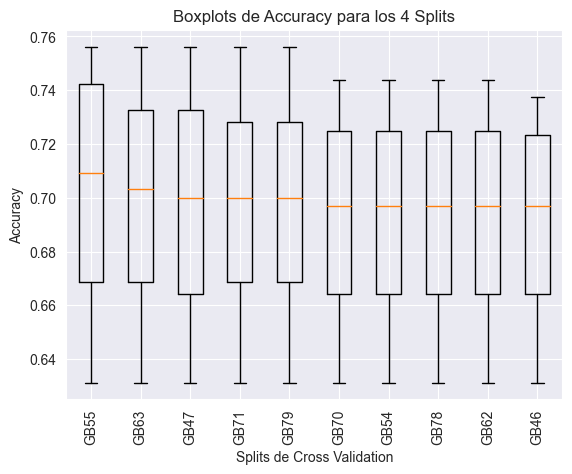

In [114]:
plt.boxplot(res_acc, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de Accuracy para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('Accuracy')
plt.show()

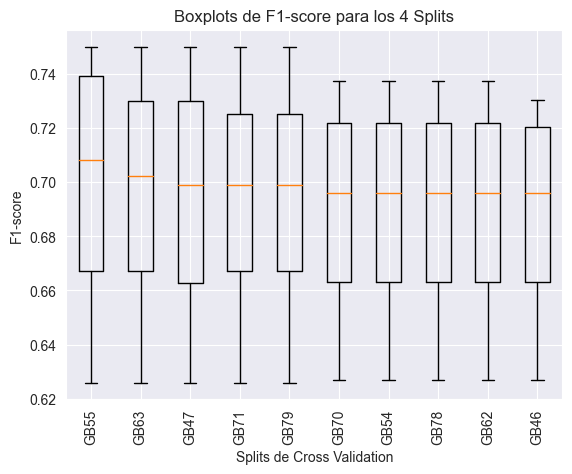

In [115]:
plt.boxplot(res_f1, labels = labels_plot)
plt.xticks(rotation=90)
plt.title('Boxplots de F1-score para los 4 Splits')
plt.xlabel('Splits de Cross Validation')
plt.ylabel('F1-score')
plt.show()

In [116]:
for i in res_acc:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.7015625 0.04908836897626566

0.6984375 0.04705693858242374

0.696875 0.047701054757730454

0.696875 0.04624577683421482

0.696875 0.04624577683421482

0.6921875 0.04293322395010653

0.6921875 0.04293322395010653

0.6921875 0.04293322395010653

0.6921875 0.04293322395010653

0.690625 0.04110295761864347



In [117]:
for i in res_f1:
    print(i.values.mean(), i.values.std())
    print('==============================\n')

0.6981846127881481 0.048978799642485395

0.695177024342632 0.04692284025465617

0.6935917363237559 0.04747425052560435

0.6935361737013396 0.04601157583072635

0.6935361737013396 0.04601157583072635

0.6890517868082875 0.04227986680888632

0.6890517868082875 0.04227986680888632

0.6890517868082875 0.04227986680888632

0.6890517868082875 0.04227986680888632

0.6873125415447283 0.04035717073241891



In [118]:
# Best scoring model
xgb0 = XGBClassifier(**results.iloc[0].params, random_state=seed)
# Most robust
xgb9 = XGBClassifier(**results.iloc[9].params, random_state=seed)
# Best overall
xgb5 = XGBClassifier(**results.iloc[5].params, random_state=seed)

In [121]:
xgb0.fit(X_resampled, y_resampled)
xgb9.fit(X_resampled, y_resampled)
xgb5.fit(X_resampled, y_resampled)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eta=0.003, eval_metric=None,
              feature_types=None, gamma=0.9, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=3,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=400,
              n_jobs=None, num_parallel_tree=None, ...)

In [122]:
y_pred = xgb0.predict(X_test)
y_pred_tr = xgb0.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.8047
Precisión del modelo en test: 0.6696
F-score del modelo en train: 0.8017
F-score del modelo en test: 0.6060
Matriz de confusión:
[[60 34]
 [ 3 15]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.95      0.64      0.76        94
           1       0.31      0.83      0.45        18

    accuracy                           0.67       112
   macro avg       0.63      0.74      0.61       112
weighted avg       0.85      0.67      0.71       112



In [123]:
y_pred = xgb9.predict(X_test)
y_pred_tr = xgb9.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7875
Precisión del modelo en test: 0.6339
F-score del modelo en train: 0.7840
F-score del modelo en test: 0.5773
Matriz de confusión:
[[56 38]
 [ 3 15]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.95      0.60      0.73        94
           1       0.28      0.83      0.42        18

    accuracy                           0.63       112
   macro avg       0.62      0.71      0.58       112
weighted avg       0.84      0.63      0.68       112



In [124]:
y_pred = xgb5.predict(X_test)
y_pred_tr = xgb5.predict(X_resampled)

precision_tr = accuracy_score(y_resampled, y_pred_tr)
print(f"Precisión del modelo en train: {precision_tr:.4f}")
precision_test = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo en test: {precision_test:.4f}")

f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
print(f"F-score del modelo en train: {f1_tr:.4f}")
f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
print(f"F-score del modelo en test: {f1_test:.4f}")

matriz_confusion = confusion_matrix(y_test, y_pred)
print("Matriz de confusión:")
print(matriz_confusion)

informe_clasificacion = classification_report(y_test, y_pred)
print("Informe de clasificación:")
print(informe_clasificacion)

Precisión del modelo en train: 0.7875
Precisión del modelo en test: 0.6339
F-score del modelo en train: 0.7840
F-score del modelo en test: 0.5773
Matriz de confusión:
[[56 38]
 [ 3 15]]
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.95      0.60      0.73        94
           1       0.28      0.83      0.42        18

    accuracy                           0.63       112
   macro avg       0.62      0.71      0.58       112
weighted avg       0.84      0.63      0.68       112



In [125]:
# Checking model performance over seeds
l_seeds = []
l_acc = []
l_f1 = []
for i in range(10):
    r_seed = random.randint(0,10000)
    l_seeds.append(r_seed)
    xgb = XGBClassifier(**results.iloc[0].params, random_state=r_seed)
    xgb.fit(X_resampled, y_resampled)
    
    y_pred = xgb.predict(X_test)
    y_pred_tr = xgb.predict(X_resampled)
    
    precision_tr = accuracy_score(y_resampled, y_pred_tr)
    print(f"Precisión del modelo en train: {precision_tr:.4f}")
    precision_test = accuracy_score(y_test, y_pred)
    print(f"Precisión del modelo en test: {precision_test:.4f}")
    
    f1_tr = f1_score(average='macro', y_true=y_resampled, y_pred=y_pred_tr)
    print(f"F-score del modelo en train: {f1_tr:.4f}")
    f1_test = f1_score(average='macro', y_true=y_test, y_pred=y_pred)
    print(f"F-score del modelo en test: {f1_test:.4f}")
    
    informe_clasificacion = classification_report(y_test, y_pred)
    print("Informe de clasificación:")
    print(informe_clasificacion)

    l_acc.append(precision_test)
    l_f1.append(f1_test)

    print('*'*50)

Precisión del modelo en train: 0.8047
Precisión del modelo en test: 0.6696
F-score del modelo en train: 0.8017
F-score del modelo en test: 0.6060
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.95      0.64      0.76        94
           1       0.31      0.83      0.45        18

    accuracy                           0.67       112
   macro avg       0.63      0.74      0.61       112
weighted avg       0.85      0.67      0.71       112

**************************************************
Precisión del modelo en train: 0.8047
Precisión del modelo en test: 0.6696
F-score del modelo en train: 0.8017
F-score del modelo en test: 0.6060
Informe de clasificación:
              precision    recall  f1-score   support

           0       0.95      0.64      0.76        94
           1       0.31      0.83      0.45        18

    accuracy                           0.67       112
   macro avg       0.63      0.74      0.61       112
weight

In [126]:
print(statistics.mean(l_acc))
print(statistics.stdev(l_acc))

0.6696428571428571
0.0


In [127]:
print(statistics.mean(l_f1))
print(statistics.stdev(l_f1))

0.6060462021104668
0.0


### TF.IDF CON SVC

In [3]:
def clean_text(txt):
    txt = txt.lower()
    txt = re.sub(r'^https?:\/\/.*[\r\n]*', '', txt)
    txt = re.sub(r'@\w+', '', txt)
    txt = re.sub(r'#\d+\b', '', txt)
    txt = re.sub(r'#\d+(\w+)', r'\1', txt)
    txt = re.sub(r'\s+', ' ', txt).strip()
    return txt

In [4]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\df_inputed.csv', index_col = 0)
df = df[['message', 'label']]
seed=7764
df

,message,label
0,buenos días a tod @s ! ! no sé si esta será la...,1
1,ola soi nuebo como estn ? a ustds los entimdm ...,0
2,de donde son .. yo de perú supongo q tb sigue ...,1
3,es lo que necesitas ? aaah pues perdón por no ...,1
4,ya perdí una xd siete seguidas no está mal . e...,1
...,...,...
1328,cuantoa kilos sr puede bajar vomitando ? ya vo...,3
1329,"holis grupo , porfis necesito perder 15 kilos ...",3
1330,quiero volver a bajar me pasan licuados detox ...,3
1331,hola . vengo de una dieta cetogenica xon la qu...,3


In [5]:
df['message'] = df['message'].apply(lambda x: clean_text(x))
df['message'].head()

0    buenos días a tod ! ! no sé si esta será la fi...
1    ola soi nuebo como estn ? a ustds los entimdm ...
2    de donde son .. yo de perú supongo q tb sigue ...
3    es lo que necesitas ? aaah pues perdón por no ...
4    ya perdí una xd siete seguidas no está mal . e...
Name: message, dtype: object

In [13]:
# Vectorizing with TF.IDF
vectorizer = TfidfVectorizer()
X_tf = vectorizer.fit_transform(df['message'])
X = X_tf
y = df['label']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

model = SVC(kernel='linear')
model.fit(X_train, y_train)

predictions = model.predict(X_test)
print(classification_report(y_test, predictions))
cm = confusion_matrix(y_test, predictions)
print(cm)
results = cross_val_score(estimator=model, X=X, y=y, cv=10)
print(results)

              precision    recall  f1-score   support

           0       0.70      0.90      0.79        82
           1       0.86      0.88      0.87        85
           2       0.88      0.61      0.72        75
           3       1.00      0.88      0.94        25

    accuracy                           0.81       267
   macro avg       0.86      0.82      0.83       267
weighted avg       0.83      0.81      0.81       267

[[74  5  3  0]
 [ 8 75  2  0]
 [22  7 46  0]
 [ 2  0  1 22]]
[0.82089552 0.7761194  0.82835821 0.81954887 0.76691729 0.83458647
 0.87969925 0.85714286 0.85714286 0.90225564]


In [15]:
res = [0.82089552, 0.7761194,  0.82835821, 0.81954887, 0.76691729, 0.83458647, 0.87969925, 0.85714286, 0.85714286, 0.90225564]

# Average
mean_res = statistics.mean(res)
print(mean_res)

# Calcular la desviación típica
std_res = statistics.stdev(res)
print(std_res)

0.834266637
0.04226992227281713


Fitting 10 folds for each of 11 candidates, totalling 110 fits
[CV 1/10] END ............................C=0.1;, score=0.561 total time=   2.1s
[CV 2/10] END ............................C=0.1;, score=0.551 total time=   2.1s
[CV 3/10] END ............................C=0.1;, score=0.533 total time=   2.1s
[CV 4/10] END ............................C=0.1;, score=0.589 total time=   2.2s
[CV 5/10] END ............................C=0.1;, score=0.570 total time=   2.2s
[CV 6/10] END ............................C=0.1;, score=0.533 total time=   2.1s
[CV 7/10] END ............................C=0.1;, score=0.575 total time=   2.3s
[CV 8/10] END ............................C=0.1;, score=0.585 total time=   2.1s
[CV 9/10] END ............................C=0.1;, score=0.538 total time=   2.1s
[CV 10/10] END ...........................C=0.1;, score=0.557 total time=   2.1s
[CV 1/10] END ............................C=0.2;, score=0.636 total time=   2.1s
[CV 2/10] END ............................C=0.

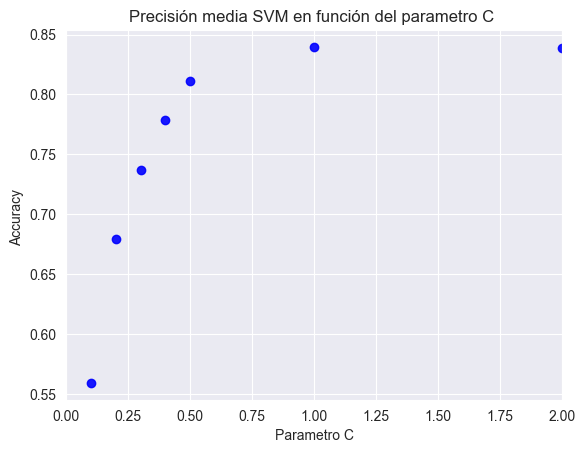

{'C': 1}
SVC(C=1, kernel='linear')
              precision    recall  f1-score   support

           0       0.70      0.90      0.79        82
           1       0.86      0.88      0.87        85
           2       0.88      0.61      0.72        75
           3       1.00      0.88      0.94        25

    accuracy                           0.81       267
   macro avg       0.86      0.82      0.83       267
weighted avg       0.83      0.81      0.81       267

[[74  5  3  0]
 [ 8 75  2  0]
 [22  7 46  0]
 [ 2  0  1 22]]


In [29]:
# Grid search
param_grid_lineal = {'C': [0.1, 0.2, 0.3, 0.4, 0.5, 1, 2, 5, 10, 100, 1000] } 
 
grid = GridSearchCV(SVC(kernel='linear'), param_grid_lineal, refit = True, cv=10, verbose = 3)
  
resultados = grid.fit(X_train, y_train)

aux=pd.DataFrame(resultados.cv_results_)

# Drawing performance scatter plot
plt.scatter(aux[['param_C']], aux[['mean_test_score']], color='b', alpha=0.9)
plt.xlabel('Parametro C')
plt.ylabel('Accuracy ')
plt.xlim(0, 2)
plt.title('Precisión media SVM en función del parametro C ')
plt.show()

# Best configuration
print(grid.best_params_)
print(grid.best_estimator_)

# Testing model
grid_predictions = grid.predict(X_test)
print(classification_report(y_test, grid_predictions))
cm = confusion_matrix(y_test, grid_predictions)
print(cm)

## LLMs

### Clasificación multiclase

In [4]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\dataset_no_joined.csv', index_col = 0)
df['message'].replace(np.nan, '', inplace=True)
df['message'] = [re.sub(r'^https?:\/\/.*[\r\n]*', '', text, flags=re.MULTILINE) for text in df['message']]
df['message'] = df['message'].apply(lambda x: remove_emoji(x))
df.drop(['subject'], inplace=True, axis=1)
y = df['label']
X = df['message']
seed=7764

In [5]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

In [6]:
df_train = pd.concat([pd.DataFrame(X_train), pd.DataFrame(y_train)], axis=1)
df_test = pd.concat([pd.DataFrame(X_test), pd.DataFrame(y_test)], axis=1)

In [50]:
# Mean number of tokens per dataset

df_train['num_tokens'] = df_train['message'].apply(lambda x: len(word_tokenize(x)))
l = []
for i in df_train['num_tokens']:
    l.append(i)

print(len(l))
o = [li for li in l if li > 512]
print(len(o))
print(df_train['num_tokens'].describe())

df_test['num_tokens'] = df_test['message'].apply(lambda x: len(word_tokenize(x)))
l = []
for i in df_test['num_tokens']:
    l.append(i)

print(len(l))
o = [li for li in l if li > 512]
print(len(o))
print(df_test['num_tokens'].describe())

37067
14
count    37067.000000
mean        14.569401
std         23.582359
min          0.000000
25%          6.000000
50%          9.000000
75%         16.000000
max        873.000000
Name: num_tokens, dtype: float64
9267
3
count    9267.000000
mean       14.298694
std        23.976847
min         0.000000
25%         6.000000
50%         9.000000
75%        15.500000
max       881.000000
Name: num_tokens, dtype: float64


In [9]:
# Loss function calculation for multiclass classification 
class CustomTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs=False):
        labels = inputs.get("labels")
        outputs = model(**inputs)
        logits = outputs.get('logits')
        loss_fct = nn.CrossEntropyLoss(weight=torch.tensor(weights, device=model.device))
        loss = loss_fct(logits.view(-1, self.model.config.num_labels), labels.view(-1))
        return (loss, outputs) if return_outputs else loss

# Calculation of class weights for imbalance problems
def get_weights(df):
    unique_values = df['label'].unique()
    total_num_rows = len(df)
    weights = []

    for i in range(len(unique_values)):
        num_rows_i = len(df[df['label'] == i])
        print("NUM_LABELS DE", i,":",num_rows_i)
        weight_i = total_num_rows/(len(unique_values) * num_rows_i)
        print("PESO DE", i, ":", weight_i)
        weights.append(float(weight_i))

    print("LOS PESOS SON:", weights)
    return weights

# Text cleansing function, it removes URLs, mentions and contiguous whitespaces (plus the done pre-processing at the begining of the project)
def clean_text(txt):
    txt = txt.lower()
    txt = re.sub(r'^https?:\/\/.*[\r\n]*', '', txt)
    txt = re.sub(r'@\w+', '', txt)
    txt = re.sub(r'\s+', ' ', txt).strip()
    return txt

# Hyperparameter search with Optuna library
def optuna_hp_space(trial):
    return {
        "learning_rate": trial.suggest_float("learning_rate", 1e-6, 1e-4, log=True),
        "per_device_train_batch_size": trial.suggest_categorical("per_device_train_batch_size", [4, 8, 16]),
        "per_device_test_batch_size": trial.suggest_categorical("per_device_test_batch_size", [4, 8, 16]),
        "weight_decay": trial.suggest_float("weight_decay", 1e-12, 1e-1, log=True),
        "adam_epsilon": trial.suggest_float("adam_epsilon", 1e-10, 1e-6, log=True),
        "gradient_accumulation_steps": trial.suggest_categorical("gradient_accumulation_steps", [1, 2]),
    }

# Objective metric
def compute_objective(metrics):
    return metrics["eval_macro_f1"]

# Compute metrics function during evaluation, returns dictionary with metrics names as keys and score as values
def compute_metrics(eval_pred):
    logits, labels = eval_pred
    predictions = np.argmax(logits, axis=-1)

    # Average metrics
    micro_precision = precision_score(y_true=labels, y_pred=predictions, average='micro')
    macro_precision = precision_score(y_true=labels, y_pred=predictions, average='macro')
    micro_recall = recall_score(y_true=labels, y_pred=predictions, average='micro')
    macro_recall = recall_score(y_true=labels, y_pred=predictions, average='macro')
    micro_f1 = f1_score(y_true=labels, y_pred=predictions, average='micro')
    macro_f1 = f1_score(y_true=labels, y_pred=predictions, average='macro')
    
    # Class-wise metrics
    precision_per_class = precision_score(y_true=labels, y_pred=predictions, average=None)
    recall_per_class = recall_score(y_true=labels, y_pred=predictions, average=None)
    f1_per_class = f1_score(y_true=labels, y_pred=predictions, average= None)

    precision = {f"precision_class_{i}": value for i, value in enumerate(precision_per_class)}
    recall = {f"recall_class_{i}": value for i, value in enumerate(recall_per_class)}
    f1 = {f"f1_class_{i}": value for i, value in enumerate(f1_per_class)}

    return {
        "micro_precision": micro_precision,
        "macro_precision": macro_precision,
        "micro_recall": micro_recall,
        "macro_recall": macro_recall,
        "micro_f1": micro_f1,
        "macro_f1": macro_f1,
        **precision,
        **recall,
        **f1
    }

df_train = df_train.rename(columns={'message':'text'})
df_test = df_test.rename(columns={'message':'text'})

df_train['text'] = df_train['text'].apply(lambda x: clean_text(x))
df_test['text'] = df_test['text'].apply(lambda x: clean_text(x))

print(df_train)
print(df_test)

weights = get_weights(df_train)

train_ds = Dataset.from_pandas(df_train, split="train")
test_ds = Dataset.from_pandas(df_test, split="test")

dataset_mc = DatasetDict({
    'train': train_ds,
    'test': test_ds
})

device = torch.device("cuda")

model_name = 'pysentimiento/robertuito-base-uncased'

model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels = 4).to(device)

tokenizer = AutoTokenizer.from_pretrained(model_name)

preprocessed_ds = dataset_mc.map(lambda x: {"text": preprocess_tweet(x['text'], lang='es')})

tokenized_ds = preprocessed_ds.map(lambda batch: tokenizer(batch['text'], padding=False, truncation=True, max_length=64))

def model_init():
    return model

args = TrainingArguments(
    output_dir='./fine_tuning_mclass',
    eval_strategy = "epoch",
    save_strategy = "epoch",
    num_train_epochs = 10,
    per_device_train_batch_size = 16,
    per_device_eval_batch_size = 16,
    # gradient_accumulation_steps=2,
    do_train = True,
    logging_strategy='steps',
    logging_steps=10,
    report_to="tensorboard",
    logging_dir="./fine_tuning_mclass/logs",
    load_best_model_at_end=True,
    metric_for_best_model='eval_macro_f1',
    save_total_limit=5,
    weight_decay=2.7918994673912303e-05,
    adam_epsilon=4.2720088845219206e-10,
    learning_rate=6.08418236794875e-06,
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = CustomTrainer(
    model=model,
    # model_init = model_init, # hp search
    args=args,
    train_dataset=tokenized_ds["train"],
    eval_dataset=tokenized_ds["test"],
    data_collator=data_collator,
    # tokenizer=tokenizer,
    compute_metrics=compute_metrics,
    callbacks=[EarlyStoppingCallback(early_stopping_patience = 3)]
)

# best_trials = trainer.hyperparameter_search(
#     direction = "maximize",
#     backend = "optuna",
#     hp_space = optuna_hp_space,
#     n_trials = 20,
#     compute_objective= compute_objective
# )

start = time()
trainer.train()
end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

print(trainer.evaluate(tokenized_ds["test"]))

                                                    text  label
42156                     voy subiendo peso gradualmente      0
41984                          los partidos son mañana !      0
13293  sabes cómo se puede uno crear una cuenta nueva...      1
26633          gracias por las recomendaciones muchachos      2
10998     genial , muchísimas gracias , le echaré un ojo      1
...                                                  ...    ...
6311   es verdad que el tema de los pensamientos intr...      1
43254                             o no era de factor x ?      0
8855   anda , entonces ya tienes más anticuerpos toda...      1
4159   así que esta noche intentaré explicar cómo yo ...      1
7009   pasta para algunos , y jugadas que cuestan mas...      0

[37067 rows x 2 columns]
                                                    text  label
16656  no tengo motivos pa no ser feliz pero me afect...      1
13686                  ostia en plan multiorgasmo jajaja      1
32231         

Map: 100%|██████████| 9267/9267 [00:02<00:00, 4564.03 examples/s]


{'loss': 1.4252, 'grad_norm': 6.426193714141846, 'learning_rate': 6.081556480004017e-06, 'epoch': 0.0043159257660768235}
{'loss': 1.4153, 'grad_norm': 5.857951641082764, 'learning_rate': 6.078930592059282e-06, 'epoch': 0.008631851532153647}
{'loss': 1.4085, 'grad_norm': 11.005553245544434, 'learning_rate': 6.076304704114548e-06, 'epoch': 0.01294777729823047}
{'loss': 1.3863, 'grad_norm': 5.9803571701049805, 'learning_rate': 6.073678816169813e-06, 'epoch': 0.017263703064307294}
{'loss': 1.3898, 'grad_norm': 5.452221393585205, 'learning_rate': 6.07105292822508e-06, 'epoch': 0.02157962883038412}
{'loss': 1.3501, 'grad_norm': 5.689366817474365, 'learning_rate': 6.068427040280346e-06, 'epoch': 0.02589555459646094}
{'loss': 1.3655, 'grad_norm': 5.238720417022705, 'learning_rate': 6.065801152335612e-06, 'epoch': 0.030211480362537766}
{'loss': 1.3701, 'grad_norm': 5.642536640167236, 'learning_rate': 6.063175264390878e-06, 'epoch': 0.03452740612861459}
{'loss': 1.3776, 'grad_norm': 6.3260040283

### Clasificación binaria, sanos vs ansiedad

In [59]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\dataset_no_joined.csv', index_col = 0)
df = df[df['label'].isin([0, 1])]
df['message'].replace(np.nan, '', inplace=True)
df['message'] = [re.sub(r'^https?:\/\/.*[\r\n]*', '', text, flags=re.MULTILINE) for text in df['message']]
df['message'] = df['message'].apply(lambda x: remove_emoji(x))
df.drop(['subject'], inplace=True, axis=1)
y = df['label']
X = df['message']
seed=7764

In [60]:
df['label'].value_counts()

label
1    16293
0    15045
Name: count, dtype: int64

In [61]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

In [62]:
df_train = pd.concat([pd.DataFrame(X_train), pd.DataFrame(y_train)], axis=1)
df_test = pd.concat([pd.DataFrame(X_test), pd.DataFrame(y_test)], axis=1)

In [32]:
df_train

,message,label
44830,"En plan , un ejercicio de 3 series , en la últ...",0
41635,Muy bien disfruatando de labplaya jejeje,0
16057,"Estoy de acuerdo contigo , al igual que hacer ...",1
13962,"Sí , lo compré , y me lo enviaron en los 3 for...",1
12077,"Woow ! ! Pronto saldremos de esto , no hay qu...",1
...,...,...
17714,Igual No tomo nada Pero a veces son tantas q m...,1
10486,Vivo con miedo constante a equivocarme y falla...,1
8855,"Anda , entonces ya tienes más anticuerpos toda...",1
4159,Así que esta noche intentaré explicar cómo yo ...,1


In [25]:
# Mean number of tokens per dataset

df_train['num_tokens'] = df_train['message'].apply(lambda x: len(word_tokenize(x)))
l = []
for i in df_train['num_tokens']:
    l.append(i)

print(len(l))
o = [li for li in l if li > 64]
print(len(o))
print(df_train['num_tokens'].describe())

df_test['num_tokens'] = df_test['message'].apply(lambda x: len(word_tokenize(x)))
l = []
for i in df_test['num_tokens']:
    l.append(i)

print(len(l))
o = [li for li in l if li > 64]
print(len(o))
print(df_test['num_tokens'].describe())

25070
495
count    25070.000000
mean        14.697846
std         23.307988
min          0.000000
25%          6.000000
50%          9.000000
75%         16.000000
max        825.000000
Name: num_tokens, dtype: float64
6268
110
count    6268.000000
mean       14.068602
std        18.149181
min         0.000000
25%         6.000000
50%         9.000000
75%        16.000000
max       432.000000
Name: num_tokens, dtype: float64


In [63]:
# Loss function calculation for binary classification 
class CustomTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs = False):
        labels = inputs.get('labels')
        outputs = model(**inputs)
        logits = outputs.get('logits')
        loss_cel = torch.nn.BCEWithLogitsLoss(pos_weight = torch.tensor(pos_weight).to('cuda')) #CON PESOS
        loss = loss_cel(logits.view(-1, self.model.config.num_labels).float().squeeze(), labels.view(-1).float())#Squeeze elimina las dimensiones que tienen una longitud de uno, logits tiene shape [4,1] y se quedará en [4]
        return (loss, outputs) if return_outputs else loss

# # Calculation of class weights
def get_weights(df):
    array_label = df['label'].values
    unique_values, counts = np.unique(array_label, return_counts = True)
    pos_weight = counts[0]/counts[1] # nºnegativos/nºpositivos
    print("EL POS_WEIGHT A APLICAR ES:", pos_weight)
    return pos_weight

# Text cleansing function, it removes URLs, mentions and contiguous whitespaces (plus the done pre-processing at the begining of the project)
def clean_text(txt):
    txt = txt.lower()
    txt = re.sub(r'^https?:\/\/.*[\r\n]*', '', txt)
    txt = re.sub(r'@\w+', '', txt)
    txt = re.sub(r'#\d+\b', '', txt)
    txt = re.sub(r'#\d+(\w+)', r'\1', txt)
    txt = re.sub(r'\s+', ' ', txt).strip()
    return txt
    
# Hyperparameter search with Optuna library
def optuna_hp_space(trial):
    return {
        "learning_rate": trial.suggest_float("learning_rate", 1e-6, 1e-4, log=True),
        "per_device_train_batch_size": trial.suggest_categorical("per_device_train_batch_size", [4, 8]),
        "per_device_test_batch_size": trial.suggest_categorical("per_device_test_batch_size", [4, 8]),
        "weight_decay": trial.suggest_float("weight_decay", 1e-12, 1e-1, log=True),
        "adam_epsilon": trial.suggest_float("adam_epsilon", 1e-10, 1e-6, log=True),
        "gradient_accumulation_steps": trial.suggest_categorical("gradient_accumulation_steps", [1, 2]),
    }

# Objective metric
def compute_objective(metrics):
    return metrics["eval_macro_f1"]

# Compute metrics function during evaluation, returns dictionary with metrics names as keys and score as values
def compute_metrics(eval_pred):
    logits, labels = eval_pred
    probs = torch.sigmoid(torch.from_numpy(logits)).numpy()
    predictions = (probs>0.5).astype(np.float32)

    #Average metrics
    micro_precision = precision_score(y_true=labels, y_pred=predictions, average='micro')
    macro_precision = precision_score(y_true=labels, y_pred=predictions, average='macro')
    micro_recall = recall_score(y_true=labels, y_pred=predictions, average='micro')
    macro_recall = recall_score(y_true=labels, y_pred=predictions, average='macro')
    micro_f1 = f1_score(y_true=labels, y_pred=predictions, average='micro')
    macro_f1 = f1_score(y_true=labels, y_pred=predictions, average='macro')
    #Class-wise metrics
    precision_per_class = precision_score(y_true=labels, y_pred=predictions, average=None)
    recall_per_class = recall_score(y_true=labels, y_pred=predictions, average=None)
    f1_per_class = f1_score(y_true=labels, y_pred=predictions, average= None)

    precision = {f"precision_class_{i}": value for i, value in enumerate(precision_per_class)}
    recall = {f"recall_class_{i}": value for i, value in enumerate(recall_per_class)}
    f1 = {f"f1_class_{i}": value for i, value in enumerate(f1_per_class)}

    all_labels = [0,1]
    confusion_matrix_classes = confusion_matrix(y_true = labels, y_pred = predictions, labels = all_labels)

    return {
        "micro_precision": micro_precision,
        "macro_precision": macro_precision,
        "micro_recall": micro_recall,
        "macro_recall": macro_recall,
        "micro_f1": micro_f1,
        "macro_f1": macro_f1,
        **precision,
        **recall,
        **f1
    }

df_train = df_train.rename(columns={'message':'text'})
df_test = df_test.rename(columns={'message':'text'})

df_train['text'] = df_train['text'].apply(lambda x: clean_text(x))
df_test['text'] = df_test['text'].apply(lambda x: clean_text(x))

pos_weight = get_weights(df_train)

train_ds = Dataset.from_pandas(df_train, split="train")
test_ds = Dataset.from_pandas(df_test, split="test")

dataset_mc = DatasetDict({
    'train': train_ds,
    'test': test_ds
})

model_name = 'pysentimiento/robertuito-base-uncased'

device = torch.device("cuda")

model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels = 1).to(device)

tokenizer = AutoTokenizer.from_pretrained(model_name)

preprocessed_ds = dataset_mc.map(lambda x: {"text": preprocess_tweet(x['text'], lang='es')}) # robertuito

tokenized_ds = preprocessed_ds.map(lambda batch: tokenizer(batch['text'], padding=False, truncation=True, max_length=64))

def model_init():
    return model

args = TrainingArguments(
    output_dir='./fine_tuning_mc',
    eval_strategy = "epoch",
    save_strategy = "epoch",
    num_train_epochs = 10,
    per_device_train_batch_size = 64,
    per_device_eval_batch_size = 64,
    # gradient_accumulation_steps=2,
    do_train = True,
    logging_strategy='steps',
    logging_steps=10,
    report_to="tensorboard",
    logging_dir="./fine_tuning_mc/logs",
    load_best_model_at_end=True,
    metric_for_best_model='eval_macro_f1',
    save_total_limit=5,
    weight_decay=5.168557239261748e-06,
    adam_epsilon=1.7993743625030213e-07,
    learning_rate=5.947394190544852e-06,
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = CustomTrainer(
    model=model,
    # model_init = model_init, # hp search
    args=args,
    train_dataset=tokenized_ds["train"],
    eval_dataset=tokenized_ds["test"],
    data_collator=data_collator,
    #tokenizer=tokenizer,
    compute_metrics=compute_metrics,
    callbacks=[EarlyStoppingCallback(early_stopping_patience = 3)]
)

# best_trials = trainer.hyperparameter_search(
#     direction = "maximize",
#     backend = "optuna",
#     hp_space = optuna_hp_space,
#     n_trials = 20,
#     compute_objective= compute_objective
# )

start = time()
trainer.train()
end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

print(trainer.evaluate(tokenized_ds["test"]))

EL POS_WEIGHT A APLICAR ES: 0.9187203428746364


Map: 100%|██████████| 6268/6268 [00:00<00:00, 9908.67 examples/s] 


{'loss': 0.6704, 'grad_norm': 1.316873550415039, 'learning_rate': 5.932222266589381e-06, 'epoch': 0.025510204081632654}
{'loss': 0.6638, 'grad_norm': 1.3770239353179932, 'learning_rate': 5.917050342633909e-06, 'epoch': 0.05102040816326531}
{'loss': 0.6551, 'grad_norm': 1.5892895460128784, 'learning_rate': 5.901878418678437e-06, 'epoch': 0.07653061224489796}
{'loss': 0.6465, 'grad_norm': 1.7816622257232666, 'learning_rate': 5.8867064947229654e-06, 'epoch': 0.10204081632653061}
{'loss': 0.636, 'grad_norm': 1.5938884019851685, 'learning_rate': 5.871534570767494e-06, 'epoch': 0.12755102040816327}
{'loss': 0.6306, 'grad_norm': 1.4767483472824097, 'learning_rate': 5.856362646812022e-06, 'epoch': 0.15306122448979592}
{'loss': 0.6381, 'grad_norm': 1.8416837453842163, 'learning_rate': 5.84119072285655e-06, 'epoch': 0.17857142857142858}
{'loss': 0.6294, 'grad_norm': 1.6397173404693604, 'learning_rate': 5.826018798901079e-06, 'epoch': 0.20408163265306123}
{'loss': 0.6301, 'grad_norm': 1.476794123

### Clasificación binaria, sanos vs depresión

In [12]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\dataset_no_joined.csv', index_col = 0)
df = df[df['label'].isin([0, 2])]
df['message'].replace(np.nan, '', inplace=True)
df['message'] = [re.sub(r'^https?:\/\/.*[\r\n]*', '', text, flags=re.MULTILINE) for text in df['message']]
df['message'] = df['message'].apply(lambda x: remove_emoji(x))
df.drop(['subject'], inplace=True, axis=1)
y = df['label']
X = df['message']
seed=7764

In [13]:
df['label'].value_counts()

label
0    15045
2    11083
Name: count, dtype: int64

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

In [15]:
df_train = pd.concat([pd.DataFrame(X_train), pd.DataFrame(y_train)], axis=1)
df_test = pd.concat([pd.DataFrame(X_test), pd.DataFrame(y_test)], axis=1)

In [16]:
df_train

,message,label
43091,Pero esto es para los obesos que consumen gras...,0
19771,Va para ambos lados,2
34801,Pues ahí la llevo,2
43313,Con agua va de lujo toque de canela o vainilla,0
1206,Pero tú estás muy bn,0
...,...,...
34007,anda un poco mal de la vista entonces,0
26779,Aveses se sienten tristes pero ... no saben pq ?,0
25148,Y pues es algo cierto . Argentina y mexico tie...,2
20452,"Seguir , ganar la batalla",0


In [16]:
# Mean number of tokens per dataset

df_train['num_tokens'] = df_train['message'].apply(lambda x: len(word_tokenize(x)))
l = []
for i in df_train['num_tokens']:
    l.append(i)

print(len(l))
o = [li for li in l if li > 64]
print(len(o))
print(df_train['num_tokens'].describe())

df_test['num_tokens'] = df_test['message'].apply(lambda x: len(word_tokenize(x)))
l = []
for i in df_test['num_tokens']:
    l.append(i)

print(len(l))
o = [li for li in l if li > 64]
print(len(o))
print(df_test['num_tokens'].describe())

20902
354
count    20902.000000
mean        13.336379
std         21.600739
min          0.000000
25%          5.000000
50%          8.000000
75%         14.000000
max        780.000000
Name: num_tokens, dtype: float64
5226
79
count    5226.000000
mean       12.917910
std        17.617324
min         0.000000
25%         6.000000
50%         8.000000
75%        14.000000
max       341.000000
Name: num_tokens, dtype: float64


In [21]:
# Loss function calculation for binary classification 
class CustomTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs = False):
        labels = inputs.get('labels')
        outputs = model(**inputs)
        logits = outputs.get('logits')
        loss_cel = torch.nn.BCEWithLogitsLoss(pos_weight = torch.tensor(pos_weight).to('cuda')) #CON PESOS
        loss = loss_cel(logits.view(-1, self.model.config.num_labels).float().squeeze(), labels.view(-1).float())#Squeeze elimina las dimensiones que tienen una longitud de uno, logits tiene shape [4,1] y se quedará en [4]
        return (loss, outputs) if return_outputs else loss

# Calculation of class weights
def get_weights(df):
    array_label = df['label'].values
    unique_values, counts = np.unique(array_label, return_counts = True)
    pos_weight = counts[0]/counts[1] # nºnegativos/nºpositivos
    print("EL POS_WEIGHT A APLICAR ES:", pos_weight)
    return pos_weight

# Text cleansing function, it removes URLs, mentions and contiguous whitespaces (plus the done pre-processing at the begining of the project)
def clean_text(txt):
    txt = txt.lower()
    txt = re.sub(r'^https?:\/\/.*[\r\n]*', '', txt)
    txt = re.sub(r'@\w+', '', txt)
    txt = re.sub(r'#\d+\b', '', txt)
    txt = re.sub(r'#\d+(\w+)', r'\1', txt)
    txt = re.sub(r'\s+', ' ', txt).strip()
    return txt

# Hyperparameter search with Optuna library
def optuna_hp_space(trial):
    return {
        "learning_rate": trial.suggest_float("learning_rate", 1e-6, 1e-4, log=True),
        "per_device_train_batch_size": trial.suggest_categorical("per_device_train_batch_size", [4, 8]),
        "per_device_test_batch_size": trial.suggest_categorical("per_device_test_batch_size", [4, 8]),
        "weight_decay": trial.suggest_float("weight_decay", 1e-12, 1e-1, log=True),
        "adam_epsilon": trial.suggest_float("adam_epsilon", 1e-10, 1e-6, log=True),
        "gradient_accumulation_steps": trial.suggest_categorical("gradient_accumulation_steps", [1, 2]),
    }

# Objective metric
def compute_objective(metrics):
    return metrics["eval_macro_f1"]

# Compute metrics function during evaluation, returns dictionary with metrics names as keys and score as values
def compute_metrics(eval_pred):
    logits, labels = eval_pred
    probs = torch.sigmoid(torch.from_numpy(logits)).numpy()
    predictions = (probs>0.5).astype(np.float32)
    # predictions = np.argmax(logits, axis=-1)

    #Average metrics
    micro_precision = precision_score(y_true=labels, y_pred=predictions, average='micro')
    macro_precision = precision_score(y_true=labels, y_pred=predictions, average='macro')
    micro_recall = recall_score(y_true=labels, y_pred=predictions, average='micro')
    macro_recall = recall_score(y_true=labels, y_pred=predictions, average='macro')
    micro_f1 = f1_score(y_true=labels, y_pred=predictions, average='micro')
    macro_f1 = f1_score(y_true=labels, y_pred=predictions, average='macro')
    #Class-wise metrics
    precision_per_class = precision_score(y_true=labels, y_pred=predictions, average=None)
    recall_per_class = recall_score(y_true=labels, y_pred=predictions, average=None)
    f1_per_class = f1_score(y_true=labels, y_pred=predictions, average= None)

    precision = {f"precision_class_{i}": value for i, value in enumerate(precision_per_class)}
    recall = {f"recall_class_{i}": value for i, value in enumerate(recall_per_class)}
    f1 = {f"f1_class_{i}": value for i, value in enumerate(f1_per_class)}

    all_labels = [0,1]
    confusion_matrix_classes = confusion_matrix(y_true = labels, y_pred = predictions, labels = all_labels)

    return {
        "micro_precision": micro_precision,
        "macro_precision": macro_precision,
        "micro_recall": micro_recall,
        "macro_recall": macro_recall,
        "micro_f1": micro_f1,
        "macro_f1": macro_f1,
        **precision,
        **recall,
        **f1
    }

df_train = df_train.rename(columns={'message':'text'})
df_test = df_test.rename(columns={'message':'text'})

df_train['label'] = df_train['label'].replace({2:1})
df_test['label'] = df_test['label'].replace({2:1})

df_train['text'] = df_train['text'].apply(lambda x: clean_text(x))
df_test['text'] = df_test['text'].apply(lambda x: clean_text(x))

pos_weight = get_weights(df_train)

train_ds = Dataset.from_pandas(df_train, split="train")
test_ds = Dataset.from_pandas(df_test, split="test")

dataset_mc = DatasetDict({
    'train': train_ds,
    'test': test_ds
})

model_name = 'pysentimiento/robertuito-base-uncased'

device = torch.device("cuda")

model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels = 1).to(device)

tokenizer = AutoTokenizer.from_pretrained(model_name)

preprocessed_ds = dataset_mc.map(lambda x: {"text": preprocess_tweet(x['text'], lang='es')}) # robertuito

tokenized_ds = preprocessed_ds.map(lambda batch: tokenizer(batch['text'], padding=False, truncation=True, max_length=64))

def model_init():
    return model

args = TrainingArguments(
    output_dir='./fine_tuning_mc',
    eval_strategy = "epoch",
    save_strategy = "epoch",
    num_train_epochs = 10,
    per_device_train_batch_size = 64,
    per_device_eval_batch_size = 32,
    gradient_accumulation_steps=2,
    do_train = True,
    logging_strategy='steps',
    logging_steps=10,
    report_to="tensorboard",
    logging_dir="./fine_tuning_mc/logs",
    load_best_model_at_end=True,
    metric_for_best_model='eval_macro_f1',
    save_total_limit=5,
    weight_decay=0.0015423696235498134,
    adam_epsilon=6.20165626650515e-10,
    learning_rate=1.1238999777104196e-05,
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = CustomTrainer(
    model=model,
    # model_init = model_init, # hp search
    args=args,
    train_dataset=tokenized_ds["train"],
    eval_dataset=tokenized_ds["test"],
    data_collator=data_collator,
    #tokenizer=tokenizer,
    compute_metrics=compute_metrics,
    callbacks=[EarlyStoppingCallback(early_stopping_patience = 3)]
)

# best_trials = trainer.hyperparameter_search(
#     direction = "maximize",
#     backend = "optuna",
#     hp_space = optuna_hp_space,
#     n_trials = 20,
#     compute_objective= compute_objective
# )

start = time()
trainer.train()
end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

print(trainer.evaluate(tokenized_ds["test"]))

EL POS_WEIGHT A APLICAR ES: 1.3604743083003952


Map: 100%|██████████| 5226/5226 [00:00<00:00, 10274.10 examples/s]


{'loss': 0.792, 'grad_norm': 1.3746845722198486, 'learning_rate': 1.1170048858226257e-05, 'epoch': 0.06116207951070336}
{'loss': 0.7725, 'grad_norm': 1.3065251111984253, 'learning_rate': 1.1101097939348317e-05, 'epoch': 0.12232415902140673}
{'loss': 0.7474, 'grad_norm': 1.5045621395111084, 'learning_rate': 1.1032147020470377e-05, 'epoch': 0.1834862385321101}
{'loss': 0.7168, 'grad_norm': 1.4581077098846436, 'learning_rate': 1.0963196101592438e-05, 'epoch': 0.24464831804281345}
{'loss': 0.7012, 'grad_norm': 2.1027252674102783, 'learning_rate': 1.0894245182714496e-05, 'epoch': 0.3058103975535168}
{'loss': 0.6871, 'grad_norm': 1.6628984212875366, 'learning_rate': 1.0825294263836558e-05, 'epoch': 0.3669724770642202}
{'loss': 0.685, 'grad_norm': 1.9160372018814087, 'learning_rate': 1.0756343344958618e-05, 'epoch': 0.42813455657492355}
{'loss': 0.6753, 'grad_norm': 1.6383904218673706, 'learning_rate': 1.0687392426080678e-05, 'epoch': 0.4892966360856269}
{'loss': 0.6637, 'grad_norm': 2.172456

### Clasificación binaria, sanos vs TCA

In [35]:
df = pd.read_csv('C:\\Users\\pablo\\OneDrive\\Escritorio\\Master\\TFM\\dataset_no_joined.csv', index_col = 0)
df = df[df['label'].isin([0, 3])]
df['message'].replace(np.nan, '', inplace=True)
df['message'] = [re.sub(r'^https?:\/\/.*[\r\n]*', '', text, flags=re.MULTILINE) for text in df['message']]
df['message'] = df['message'].apply(lambda x: remove_emoji(x))
df.drop(['subject'], inplace=True, axis=1)
y = df['label']
X = df['message']
seed=7764

In [36]:
df['label'].value_counts()

label
0    15045
3     3913
Name: count, dtype: int64

In [37]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

In [38]:
df_train = pd.concat([pd.DataFrame(X_train), pd.DataFrame(y_train)], axis=1)
df_test = pd.concat([pd.DataFrame(X_test), pd.DataFrame(y_test)], axis=1)

In [39]:
df_train

,message,label
30716,"bueno , si a veces hay gente que se va del gru...",0
23311,"Hola a todos , voy a leerlos",0
21415,una mujer q disfruta libremente no se conviert...,0
39680,Empezaré por lo básico,0
42174,Creo que me recuperaré pronto,0
...,...,...
45090,Me estan dando unas ganas de comer,3
37862,Si lo es Lu si mira en España,0
36231,hi,3
23290,Me perdí de muchas cosas,0


In [55]:
# Mean number of tokens per dataset

df_train['num_tokens'] = df_train['message'].apply(lambda x: len(word_tokenize(x)))
l = []
for i in df_train['num_tokens']:
    l.append(i)

print(len(l))
o = [li for li in l if li > 64]
print(len(o))
print(df_train['num_tokens'].describe())

df_test['num_tokens'] = df_test['message'].apply(lambda x: len(word_tokenize(x)))
l = []
for i in df_test['num_tokens']:
    l.append(i)

print(len(l))
o = [li for li in l if li > 64]
print(len(o))
print(df_test['num_tokens'].describe())

15166
229
count    15166.000000
mean        13.384017
std         27.953625
min          0.000000
25%          5.000000
50%          8.000000
75%         14.000000
max        881.000000
Name: num_tokens, dtype: float64
3792
48
count    3792.000000
mean       12.788766
std        23.711467
min         0.000000
25%         5.000000
50%         8.000000
75%        14.000000
max       867.000000
Name: num_tokens, dtype: float64


In [46]:
# Loss function calculation for binary classification
class CustomTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs = False):
        labels = inputs.get('labels')
        outputs = model(**inputs)
        logits = outputs.get('logits')
        loss_cel = torch.nn.BCEWithLogitsLoss(pos_weight = torch.tensor(pos_weight).to('cuda')) #CON PESOS
        loss = loss_cel(logits.view(-1, self.model.config.num_labels).float().squeeze(), labels.view(-1).float())#Squeeze elimina las dimensiones que tienen una longitud de uno, logits tiene shape [4,1] y se quedará en [4]
        return (loss, outputs) if return_outputs else loss

# Calculation of class weights
def get_weights(df):
    array_label = df['label'].values
    unique_values, counts = np.unique(array_label, return_counts = True)
    pos_weight = counts[0]/counts[1] # nºnegativos/nºpositivos
    print("EL POS_WEIGHT A APLICAR ES:", pos_weight)
    return pos_weight

# Text cleansing function, it removes URLs, mentions and contiguous whitespaces (plus the done pre-processing at the begining of the project)
def clean_text(txt):
    txt = txt.lower()
    txt = re.sub(r'^https?:\/\/.*[\r\n]*', '', txt)
    txt = re.sub(r'@\w+', '', txt)
    txt = re.sub(r'#\d+\b', '', txt)
    txt = re.sub(r'#\d+(\w+)', r'\1', txt)
    txt = re.sub(r'\s+', ' ', txt).strip()
    return txt

# Hyperparameter search with Optuna library
def optuna_hp_space(trial):
    return {
        "learning_rate": trial.suggest_float("learning_rate", 1e-6, 1e-4, log=True),
        "per_device_train_batch_size": trial.suggest_categorical("per_device_train_batch_size", [4, 8]),
        "per_device_test_batch_size": trial.suggest_categorical("per_device_test_batch_size", [4, 8]),
        "weight_decay": trial.suggest_float("weight_decay", 1e-12, 1e-1, log=True),
        "adam_epsilon": trial.suggest_float("adam_epsilon", 1e-10, 1e-6, log=True),
        "gradient_accumulation_steps": trial.suggest_categorical("gradient_accumulation_steps", [1, 2]),
    }

# Objective metric
def compute_objective(metrics):
    return metrics["eval_macro_f1"]

# Compute metrics function during evaluation, returns dictionary with metrics names as keys and score as values
def compute_metrics(eval_pred):
    logits, labels = eval_pred
    probs = torch.sigmoid(torch.from_numpy(logits)).numpy()
    predictions = (probs>0.5).astype(np.float32)
    # predictions = np.argmax(logits, axis=-1)

    #Average metrics
    micro_precision = precision_score(y_true=labels, y_pred=predictions, average='micro')
    macro_precision = precision_score(y_true=labels, y_pred=predictions, average='macro')
    micro_recall = recall_score(y_true=labels, y_pred=predictions, average='micro')
    macro_recall = recall_score(y_true=labels, y_pred=predictions, average='macro')
    micro_f1 = f1_score(y_true=labels, y_pred=predictions, average='micro')
    macro_f1 = f1_score(y_true=labels, y_pred=predictions, average='macro')
    #Class-wise metrics
    precision_per_class = precision_score(y_true=labels, y_pred=predictions, average=None)
    recall_per_class = recall_score(y_true=labels, y_pred=predictions, average=None)
    f1_per_class = f1_score(y_true=labels, y_pred=predictions, average= None)

    precision = {f"precision_class_{i}": value for i, value in enumerate(precision_per_class)}
    recall = {f"recall_class_{i}": value for i, value in enumerate(recall_per_class)}
    f1 = {f"f1_class_{i}": value for i, value in enumerate(f1_per_class)}

    all_labels = [0,1]
    confusion_matrix_classes = confusion_matrix(y_true = labels, y_pred = predictions, labels = all_labels)

    return {
        "micro_precision": micro_precision,
        "macro_precision": macro_precision,
        "micro_recall": micro_recall,
        "macro_recall": macro_recall,
        "micro_f1": micro_f1,
        "macro_f1": macro_f1,
        **precision,
        **recall,
        **f1
    }

df_train = df_train.rename(columns={'message':'text'})
df_test = df_test.rename(columns={'message':'text'})

df_train['label'] = df_train['label'].replace({3:1})
df_test['label'] = df_test['label'].replace({3:1})

df_train['text'] = df_train['text'].apply(lambda x: clean_text(x))
df_test['text'] = df_test['text'].apply(lambda x: clean_text(x))

pos_weight = get_weights(df_train)

train_ds = Dataset.from_pandas(df_train, split="train")
test_ds = Dataset.from_pandas(df_test, split="test")

dataset_mc = DatasetDict({
    'train': train_ds,
    'test': test_ds
})

model_name = 'pysentimiento/robertuito-base-uncased'

device = torch.device("cuda")

model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels = 1).to(device)

tokenizer = AutoTokenizer.from_pretrained(model_name)

preprocessed_ds = dataset_mc.map(lambda x: {"text": preprocess_tweet(x['text'], lang='es')}) # robertuito

tokenized_ds = preprocessed_ds.map(lambda batch: tokenizer(batch['text'], padding=False, truncation=True, max_length=64))

def model_init():
    return model

args = TrainingArguments(
    output_dir='./fine_tuning_mc',
    eval_strategy = "epoch",
    save_strategy = "epoch",
    num_train_epochs = 10,
    per_device_train_batch_size = 16,
    per_device_eval_batch_size = 16,
    #gradient_accumulation_steps=2,
    do_train = True,
    logging_strategy='steps',
    logging_steps=10,
    report_to="tensorboard",
    logging_dir="./fine_tuning_mc/logs",
    load_best_model_at_end=True,
    metric_for_best_model='eval_macro_f1',
    save_total_limit=5,
    #weight_decay=0.005356961461873696,
    adam_epsilon=3.5322417625164665e-08,
    learning_rate=3.4038028632678188e-06,
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

trainer = CustomTrainer(
    model=model,
    #model_init = model_init, # hp search
    args=args,
    train_dataset=tokenized_ds["train"],
    eval_dataset=tokenized_ds["test"],
    data_collator=data_collator,
    #tokenizer=tokenizer,
    compute_metrics=compute_metrics,
    callbacks=[EarlyStoppingCallback(early_stopping_patience = 3)]
)

# best_trials = trainer.hyperparameter_search(
#     direction = "maximize",
#     backend = "optuna",
#     hp_space = optuna_hp_space,
#     n_trials = 20,
#     compute_objective= compute_objective
# )

start = time()
trainer.train()
end = time()
print(f">>>>>>>>>>>>> elapsed time: {(end-start)/60:.0f}m")

print(trainer.evaluate(tokenized_ds["test"]))

EL POS_WEIGHT A APLICAR ES: 3.893836721523072


Map: 100%|██████████| 3792/3792 [00:00<00:00, 10489.45 examples/s]


{'loss': 1.1865, 'grad_norm': 5.454186916351318, 'learning_rate': 3.40021235391838e-06, 'epoch': 0.010548523206751054}
{'loss': 1.1885, 'grad_norm': 5.690347194671631, 'learning_rate': 3.3966218445689417e-06, 'epoch': 0.02109704641350211}
{'loss': 1.1348, 'grad_norm': 6.711838245391846, 'learning_rate': 3.393031335219503e-06, 'epoch': 0.03164556962025317}
{'loss': 1.14, 'grad_norm': 6.381051063537598, 'learning_rate': 3.3894408258700645e-06, 'epoch': 0.04219409282700422}
{'loss': 1.0521, 'grad_norm': 5.419470310211182, 'learning_rate': 3.3858503165206257e-06, 'epoch': 0.052742616033755275}
{'loss': 1.0889, 'grad_norm': 5.675324440002441, 'learning_rate': 3.3822598071711873e-06, 'epoch': 0.06329113924050633}
{'loss': 1.1457, 'grad_norm': 5.580809116363525, 'learning_rate': 3.378669297821749e-06, 'epoch': 0.07383966244725738}
{'loss': 1.1463, 'grad_norm': 5.78346586227417, 'learning_rate': 3.37507878847231e-06, 'epoch': 0.08438818565400844}
{'loss': 1.1353, 'grad_norm': 4.951426506042480